In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime, date, timedelta
import numpy as np

df = pd.read_csv(r'C:\Users\willi\Desktop\EE4211\dataport-export_gas_oct2015-mar2016.csv')
df['localminute'] = df['localminute'].map(lambda x: str(x)[:-3])
df['localminute'] = pd.to_datetime(df['localminute'], infer_datetime_format=True)



In [129]:
##### df_oct = df[df['localminute']<=datetime(2015,10,31,23,59,59)]
##### identifying negative or large values and replacing with NaN

def slicer_vectorized(a,start,end):
    b = a.view((str,1)).reshape(len(a),-1)[:,start:end]
    return np.fromstring(b.tostring(),dtype=(str,end-start))

for item in set(df_oct.dataid):
    house = df.loc[df['dataid']==item]
    index_list = house.index[0:len(house)]
    mean_change = np.mean(np.diff(np.array(house['meter_value'])))
    std_change = np.std(np.diff(np.array(house['meter_value'])))
    time_diff = np.diff(house['localminute'])
    time_diff = time_diff.astype(str)
    time_diff = slicer_vectorized(time_diff,0,3)
    time_diff = time_diff.astype(int)
    meter_diff = np.diff(house['meter_value'])
    test = np.diff(house['meter_value'])/time_diff
    average_change = np.sum(np.diff(house['meter_value']))/np.sum(time_diff)
    test_sd = np.std(test)
    for i in range(len(meter_diff)-1):
        if meter_diff[i] < 0:
            if meter_diff[i+1] - meter_diff[i] < 0:
                house.loc[index_list[i], 'meter_value'] = np.nan
        elif test[i] > 20*average_change:
            house.loc[index_list[i], 'meter_value'] = np.nan
                         
df_oct_hour = df_oct.set_index('localminute').groupby('dataid').resample('H').mean().interpolate()

C:\Users\willi\Anaconda3\lib\site-packages\pandas\core\indexing.py:517: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s
C:\Users\willi\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
C:\Users\willi\Anaconda3\lib\site-packages\numpy\core\_methods.py:112: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


In [61]:
#df_oct_hour.index[i][1] => Time
#ddf_oct_hour.index[i][0] => index
#df_oct_hour.iloc[i]['meter_value'] => meter_value
#Converting dataframe to a dictionary of key meter id
#i.e. {key: [time1, time2, time3, time4, time5]}
measure = datetime(2015,10,1,0,0,0)
month_reading_by_hour = {}
timelines = {}
repeat = datetime(2015,1,1,0,0,0)
i = 0
while i < len(df_oct_hour):
    if repeat == measure:
        print('repeat error')
        break
    if measure > datetime(2015,10,31,23,0,0):
        print('datetime out error')
        break
    if df_oct_hour.index[i][0] not in month_reading_by_hour:
        month_reading_by_hour[df_oct_hour.index[i][0]] = np.array([])
        timelines[df_oct_hour.index[i][0]] = np.array([])
    if measure != df_oct_hour.index[i][1]: #missing time or negative time, add nan
        new_array = np.append(month_reading_by_hour[df_oct_hour.index[i][0]], [np.nan])
        new_time = np.append(timelines[df_oct_hour.index[i][0]], [measure])
        measure = measure + timedelta(hours=1)
        if measure > datetime(2015,10,31,23,0,0):
            measure = datetime(2015,10,1,0,0,0)
        month_reading_by_hour[df_oct_hour.index[i][0]] = new_array
        timelines[df_oct_hour.index[i][0]] = new_time
        continue
    #add meter_value
    new_array = np.append(month_reading_by_hour[df_oct_hour.index[i][0]], [df_oct_hour.iloc[i]['meter_value']])
    new_time = np.append(timelines[df_oct_hour.index[i][0]], [measure])
    month_reading_by_hour[df_oct_hour.index[i][0]] = new_array
    timelines[df_oct_hour.index[i][0]] = new_time
    i=i+1
    repeat = measure
    measure = measure + timedelta(hours=1)
    if measure > datetime(2015,10,31,23,0,0):
        measure = datetime(2015,10,1,0,0,0)

In [84]:
#Manually adding filling in meter values

#df_oct_hour.index[i][1] => Time
#ddf_oct_hour.index[i][0] => index
#df_oct_hour.iloc[i]['meter_value'] => meter_value
all_id = list(set(df_oct_hour.index.get_level_values(0)))
all_id.sort()
df_oct_hour.index.get_level_values(0)
new_timings = {}
measure = datetime(2015, 10, 1, 1, 0, 0)
for key in all_id:
    q = 'dataid ==' + str(key)
    a = df_oct_hour.query(q)
    new_timings[key] = np.array([])
    while measure < datetime(2015,10,31,23,0,0):
        measure_str = str(measure)
        q2 = 'localminute == datetime(' + str(measure.year) + ',' + str(measure.month) + ',' + str(measure.day) + ',' + str(measure.hour) + ',' + str(measure.minute) + ',' + str(measure.second) + ')'
        x = a.query(q2)
        test = a.query('localminute == datetime(2015,11,1,23,0,0)')
        #x.index.get_level_values(1)[0] #get datetime
        if x.index.get_level_values(1).empty: #no existing time
            readings = np.append(new_timings[key], [np.nan])
            new_timings[key] = readings
        elif measure == x.index.get_level_values(1)[0]: #match time
            readings = np.append(new_timings[key], [x['meter_value'][0]])
            new_timings[key] = readings
        measure = measure + timedelta(hours=1)
    measure = datetime(2015, 10, 1, 1, 0, 0)

In [95]:
#removing all datasets with insufficient reading
all_list_length = []
for item in new_timings:
    all_list_length.append(np.count_nonzero(~np.isnan(new_timings[item])))
all_list_length_mean = np.mean(np.array(all_list_length))
all_list_length_std = np.std(np.array(all_list_length))
insuff_reading = np.where(all_list_length < all_list_length_mean - 3*all_list_length_std)
for i in range(len(insuff_reading[0])):
    del new_timings[all_id[insuff_reading[0][i]]]

In [96]:
#Backfilling and forward filling all 'nan' values 

idx=np.where(np.isfinite(new_timings[44]))
x = np.diff(new_timings[44])
x2 = x[~np.isnan(x)]
hourly_change = np.sum(x2)/len(x2)

for key in new_timings:
    idx=np.where(np.isfinite(new_timings[key]))
    if len(idx[0]) == 0:
        temp = np.zeros(742)
        new_timings[key] = temp
        continue
        
    x = np.diff(new_timings[key])
    x2 = x[~np.isnan(x)]
    hourly_change = np.sum(x2)/len(x2)
    first_idx = idx[0][0] - 1
    last_idx = idx[0][-1] + 1
    while first_idx >= 0:
        new_timings[key][first_idx] = new_timings[key][first_idx + 1] - hourly_change
        first_idx = first_idx - 1
    while last_idx <= 741:
        new_timings[key][last_idx] = new_timings[key][last_idx - 1] + hourly_change
        last_idx = last_idx + 1

In [97]:
hourly_reading_final = np.zeros(742)
for key in new_timings:
    hourly_reading_final = np.sum([hourly_reading_final, new_timings[key]], axis=0)

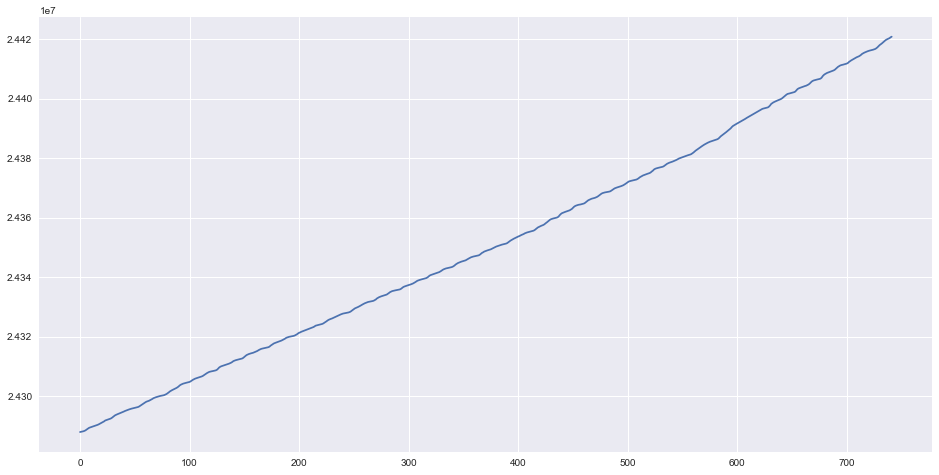

In [98]:
#Question 1.2: Hourly Plot
fig = plt.figure(figsize=(16,8))
plt.plot(hourly_reading_final)
plt.show()

In [99]:

correlation_matrix = np.zeros((len(new_timings), len(new_timings)))
new_timings_copy = new_timings
x = 1
y = 0
for key in new_timings:
    for key_2 in new_timings_copy:
        if key==key_2:
            continue
        correlation = np.corrcoef(new_timings[key], new_timings_copy[key_2])
        correlation_matrix[y][x] = correlation[0][1]
        x = x+1
        if x>=len(new_timings_copy):
            x = 0
    
    y = y + 1



In [68]:
#Question 1.3: Top 5 Correlation
i = 0
all_id = list(new_timings.keys())
for key in new_timings:
    top_5_index = correlation_matrix[i].argsort()[-5:][::-1]
    print("The 5 most correlated houses with house", key, ":")
    #print(top_5_index)
    for item in top_5_index:
        print(all_id[item])
    print("+++++++++++++++++++++++")
    i = i+1

The 5 most correlated houses with house 35 :
1042
9052
4356
6412
739
+++++++++++++++++++++++
The 5 most correlated houses with house 44 :
2818
3893
3134
7965
8890
+++++++++++++++++++++++
The 5 most correlated houses with house 77 :
4447
1507
9766
3893
7739
+++++++++++++++++++++++
The 5 most correlated houses with house 94 :
4421
2461
7794
5131
484
+++++++++++++++++++++++
The 5 most correlated houses with house 114 :
3918
5484
1103
1042
6412
+++++++++++++++++++++++
The 5 most correlated houses with house 187 :
8386
2470
7741
3635
6578
+++++++++++++++++++++++
The 5 most correlated houses with house 222 :
5484
4356
1415
4031
187
+++++++++++++++++++++++
The 5 most correlated houses with house 252 :
4732
3134
3778
2129
1697
+++++++++++++++++++++++
The 5 most correlated houses with house 370 :
4352
9631
2072
9134
6836
+++++++++++++++++++++++
The 5 most correlated houses with house 483 :
4421
3039
4373
6836
7682
+++++++++++++++++++++++
The 5 most correlated houses with house 484 :
739
8386
74

Plotting for Meter 35
Time series plot of the actual and predicted hourly meter readings


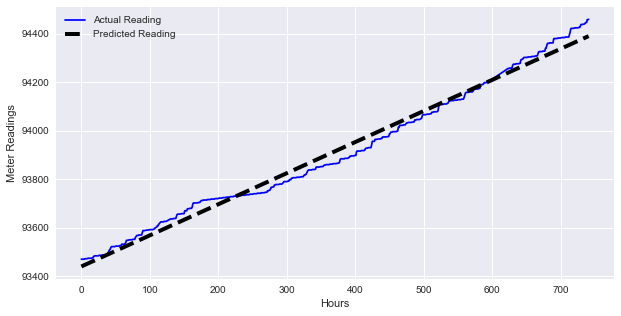

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


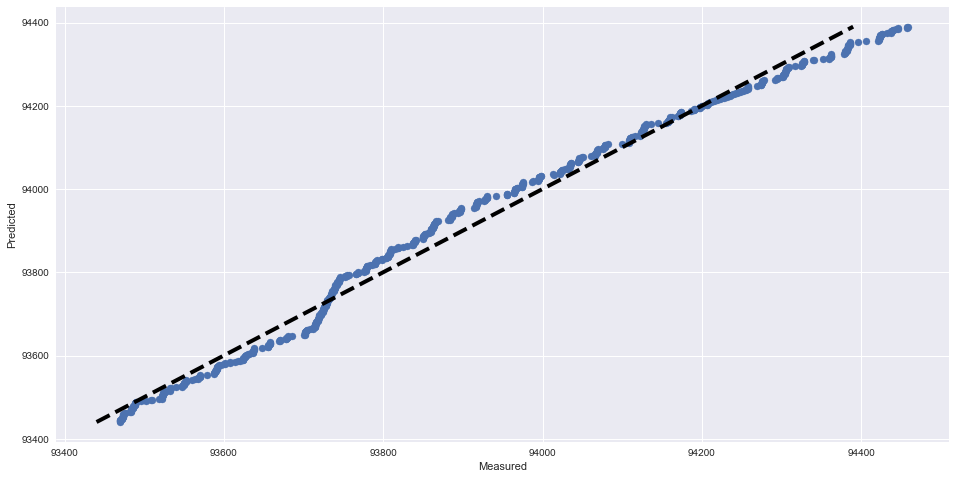

RMSE score: 31.1777809669
R2 score: 0.987274312463
---------------------------------------------------------------------------
Plotting for Meter 44
Time series plot of the actual and predicted hourly meter readings


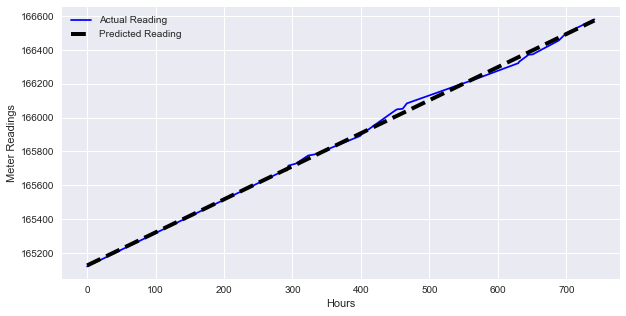

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


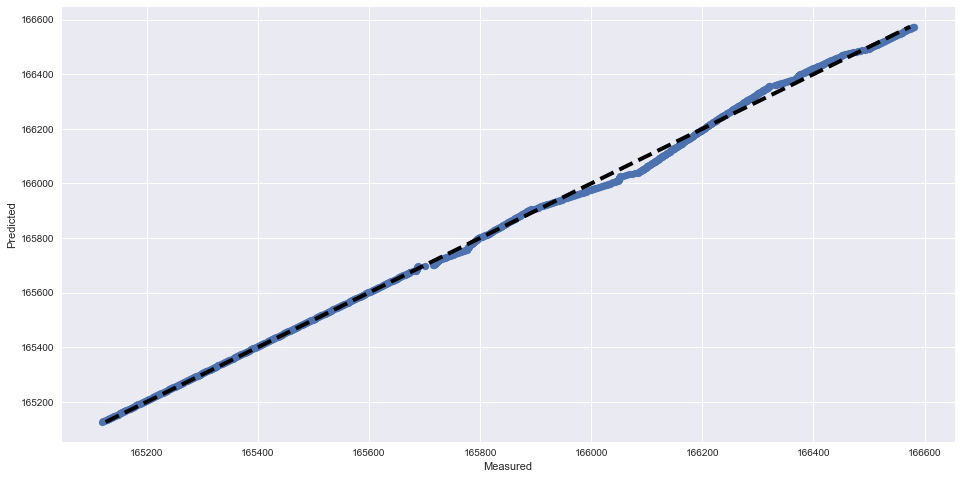

RMSE score: 15.2386347449
R2 score: 0.998675457825
---------------------------------------------------------------------------
Plotting for Meter 77
Time series plot of the actual and predicted hourly meter readings


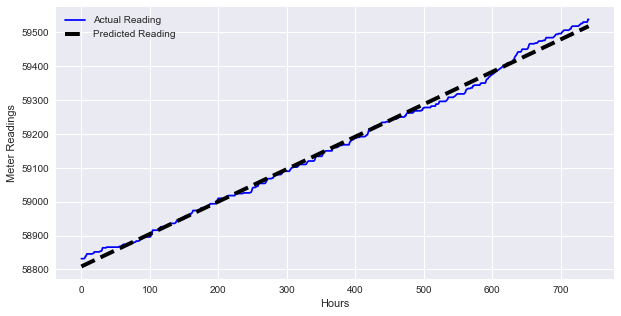

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


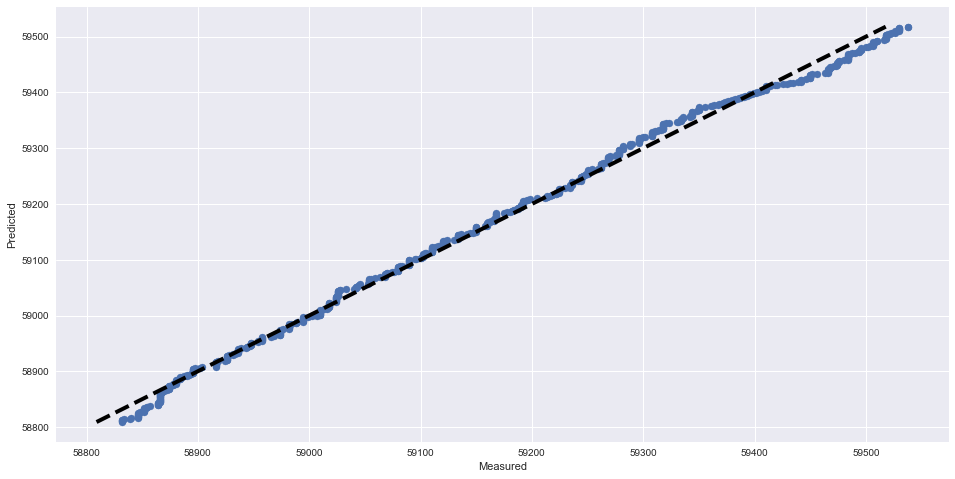

RMSE score: 12.7344320742
R2 score: 0.996154312834
---------------------------------------------------------------------------
Plotting for Meter 94
Time series plot of the actual and predicted hourly meter readings


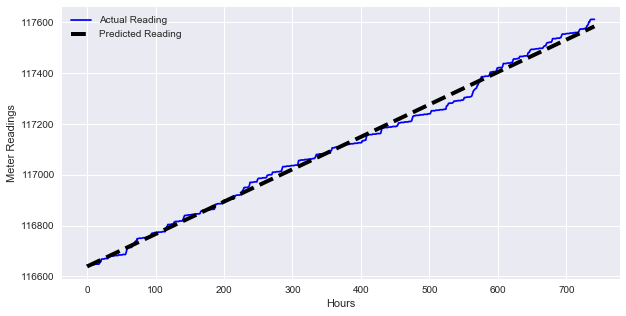

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


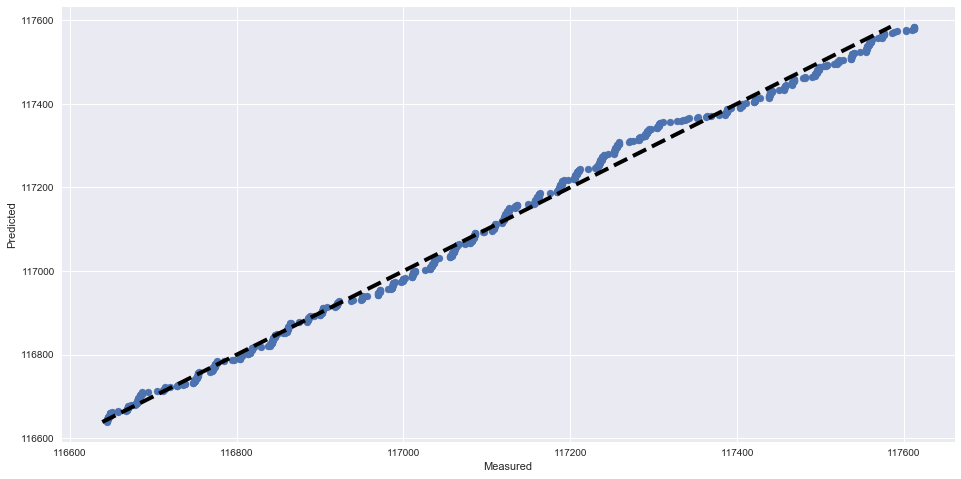

RMSE score: 18.7284152355
R2 score: 0.995335321124
---------------------------------------------------------------------------
Plotting for Meter 114
Time series plot of the actual and predicted hourly meter readings


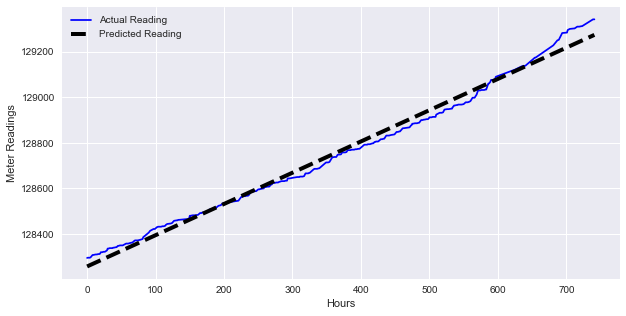

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


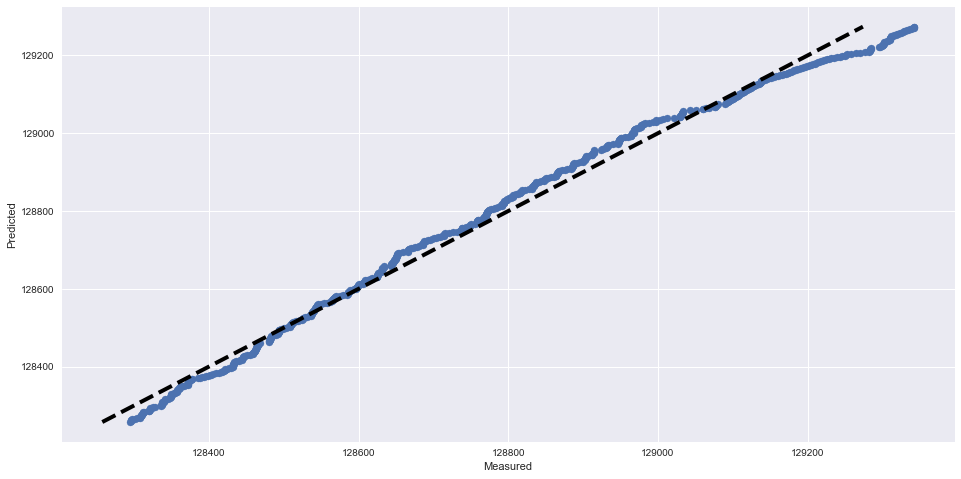

RMSE score: 29.6581770593
R2 score: 0.989913338207
---------------------------------------------------------------------------
Plotting for Meter 187
Time series plot of the actual and predicted hourly meter readings


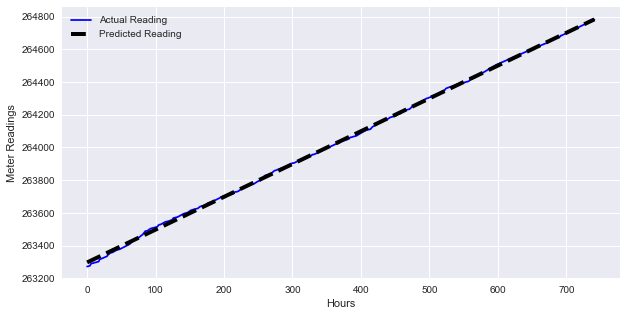

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


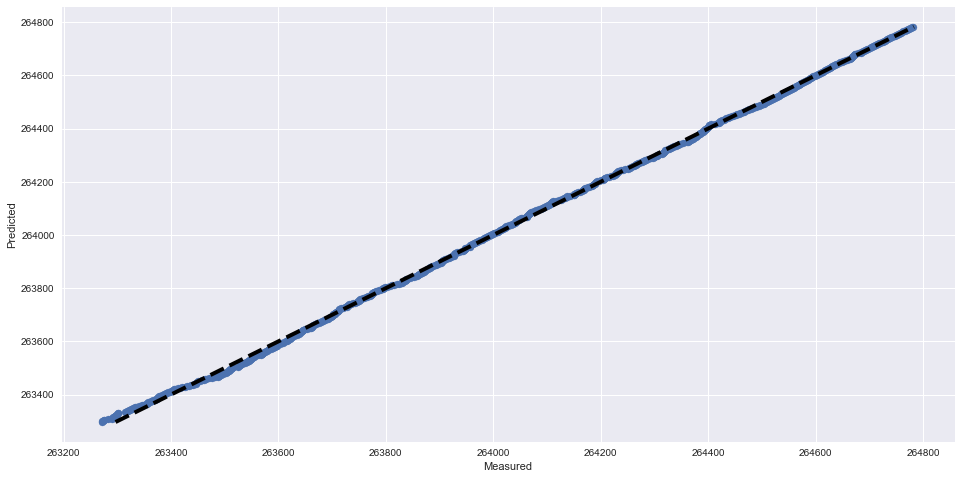

RMSE score: 8.94057262312
R2 score: 0.999567969872
---------------------------------------------------------------------------
Plotting for Meter 222
Time series plot of the actual and predicted hourly meter readings


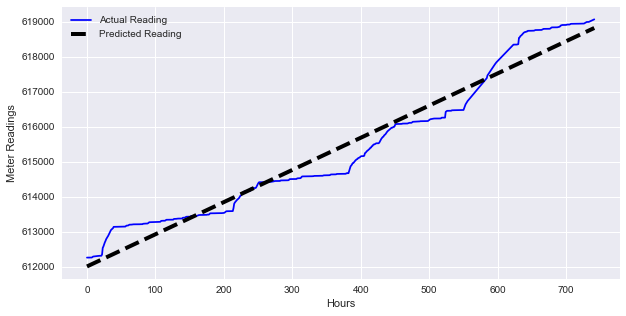

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


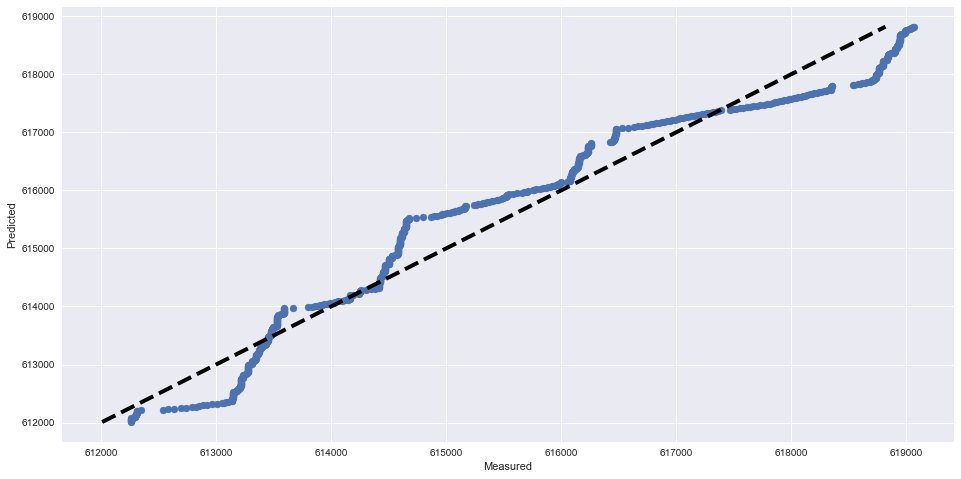

RMSE score: 425.650490945
R2 score: 0.955518915087
---------------------------------------------------------------------------
Plotting for Meter 252
Time series plot of the actual and predicted hourly meter readings


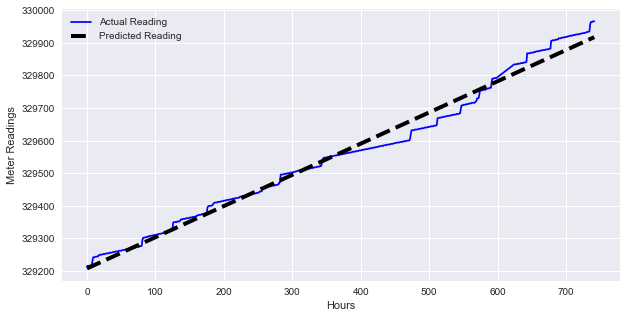

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


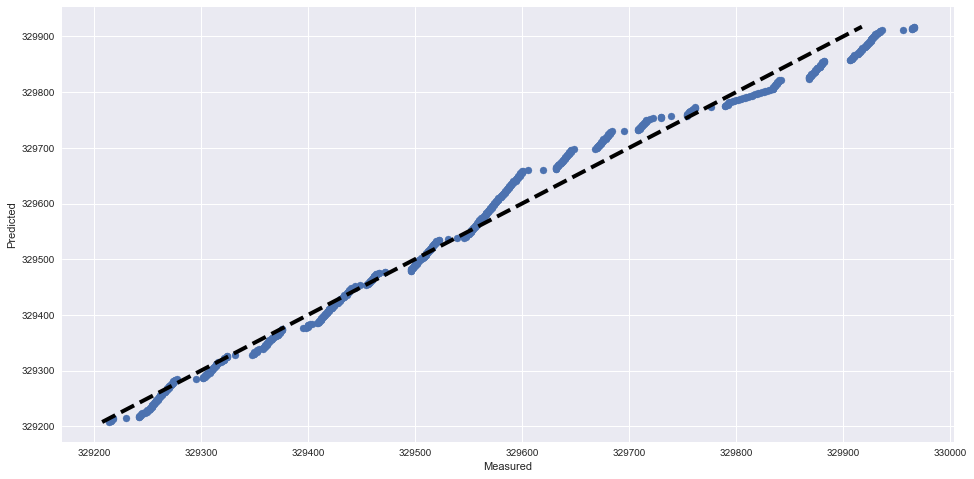

RMSE score: 25.2450266381
R2 score: 0.985126181855
---------------------------------------------------------------------------
Plotting for Meter 370
Time series plot of the actual and predicted hourly meter readings


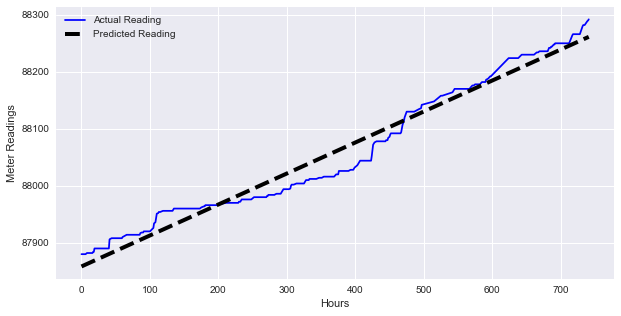

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


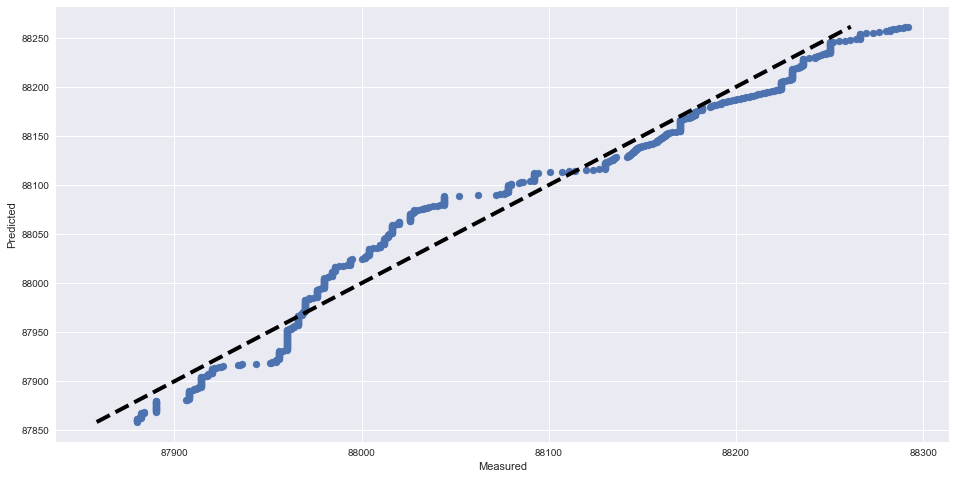

RMSE score: 21.2645082555
R2 score: 0.967879648361
---------------------------------------------------------------------------
Plotting for Meter 483
Time series plot of the actual and predicted hourly meter readings


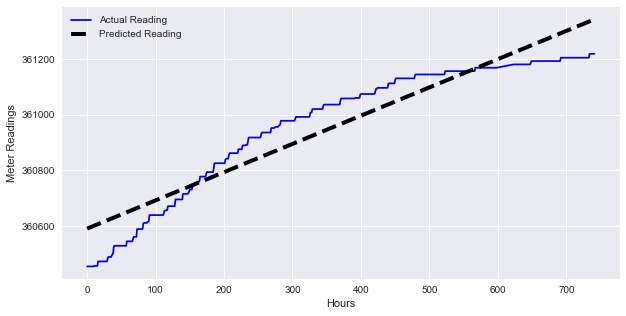

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


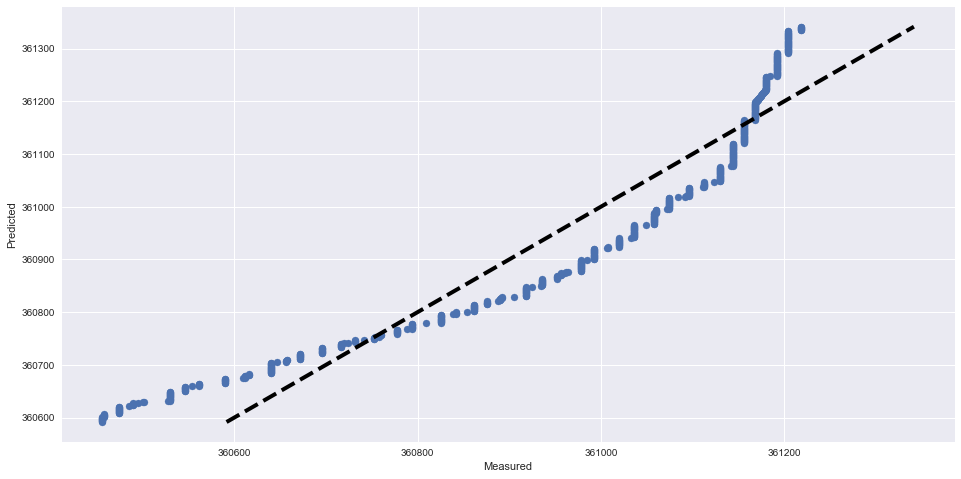

RMSE score: 74.6448278241
R2 score: 0.894009282035
---------------------------------------------------------------------------
Plotting for Meter 484
Time series plot of the actual and predicted hourly meter readings


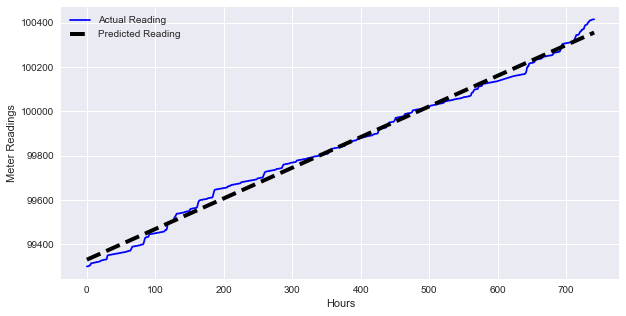

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


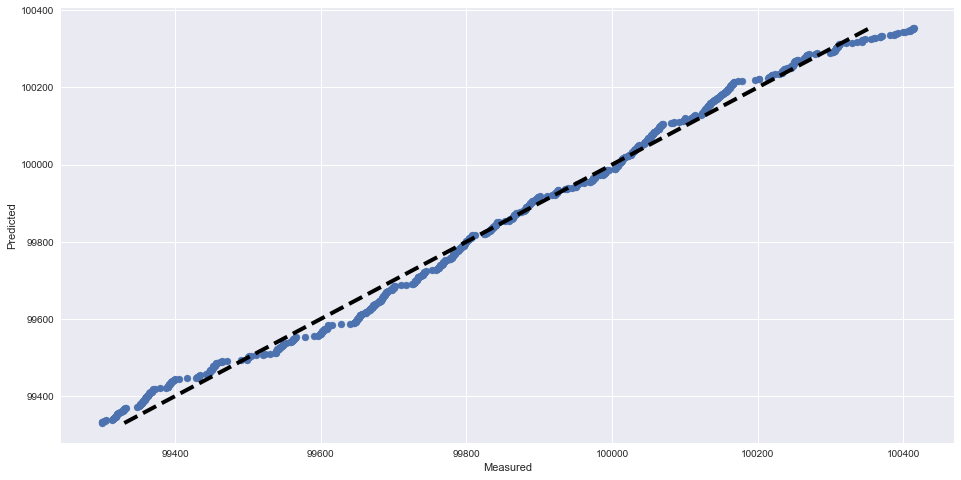

RMSE score: 25.3238023916
R2 score: 0.992738780534
---------------------------------------------------------------------------
Plotting for Meter 661
Time series plot of the actual and predicted hourly meter readings


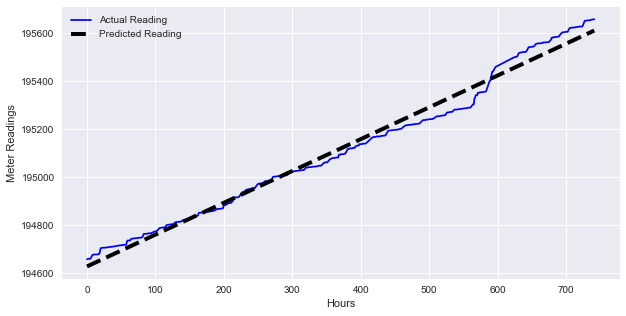

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


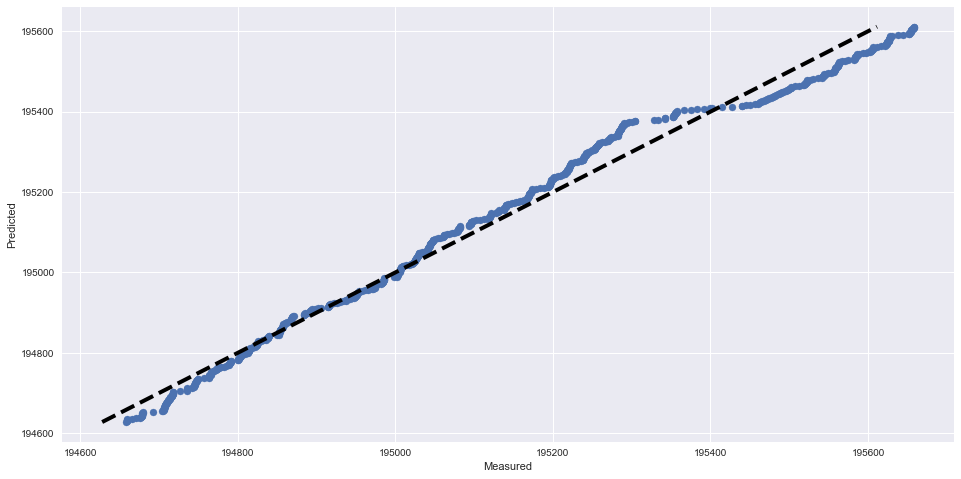

RMSE score: 34.9740718284
R2 score: 0.985120674633
---------------------------------------------------------------------------
Plotting for Meter 739
Time series plot of the actual and predicted hourly meter readings


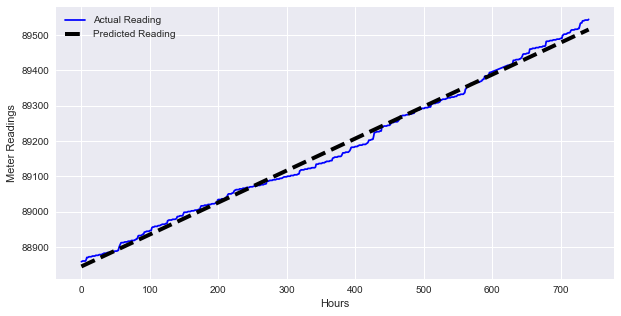

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


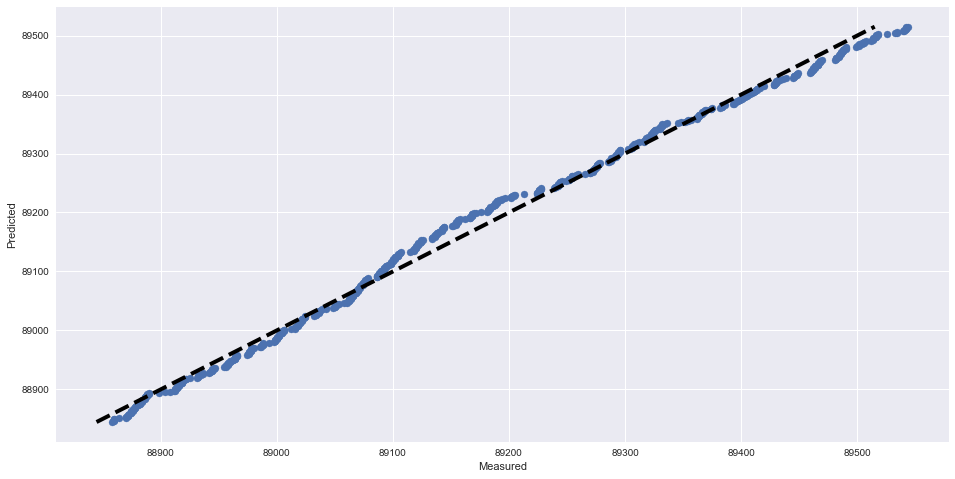

RMSE score: 14.5988588893
R2 score: 0.994374211811
---------------------------------------------------------------------------
Plotting for Meter 744
Time series plot of the actual and predicted hourly meter readings


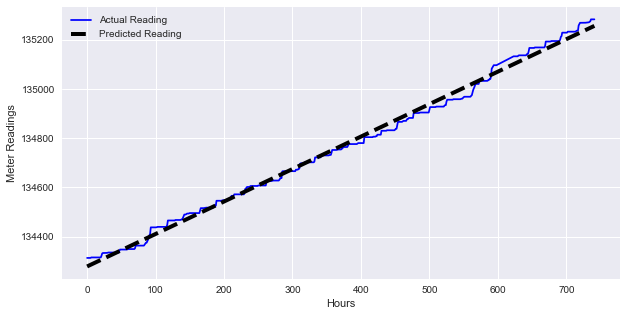

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


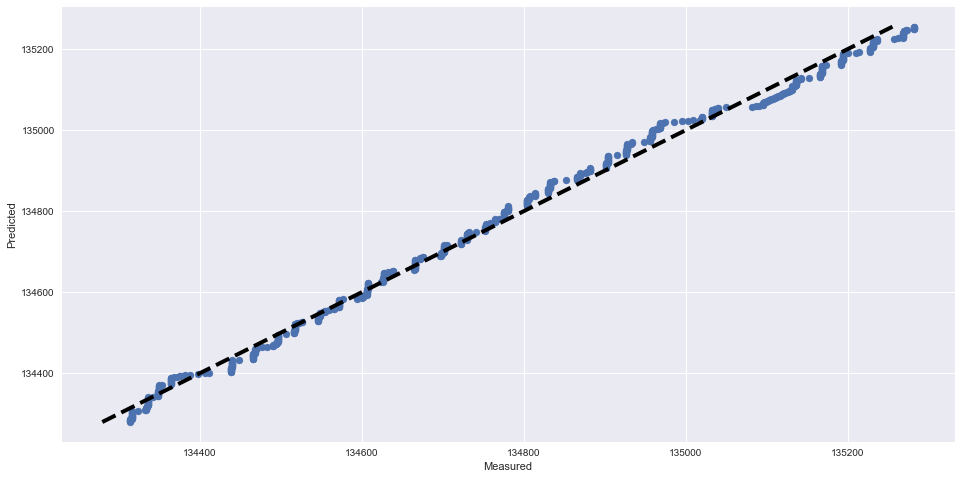

RMSE score: 20.2732270125
R2 score: 0.99486918024
---------------------------------------------------------------------------
Plotting for Meter 871
Time series plot of the actual and predicted hourly meter readings


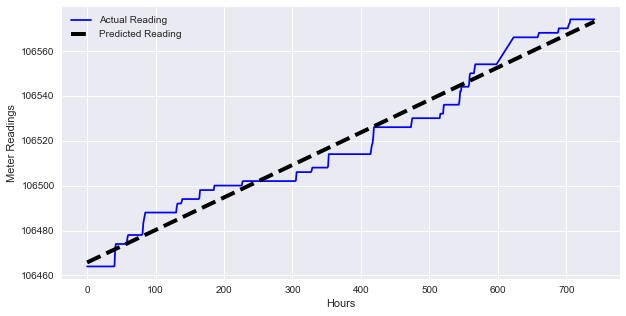

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


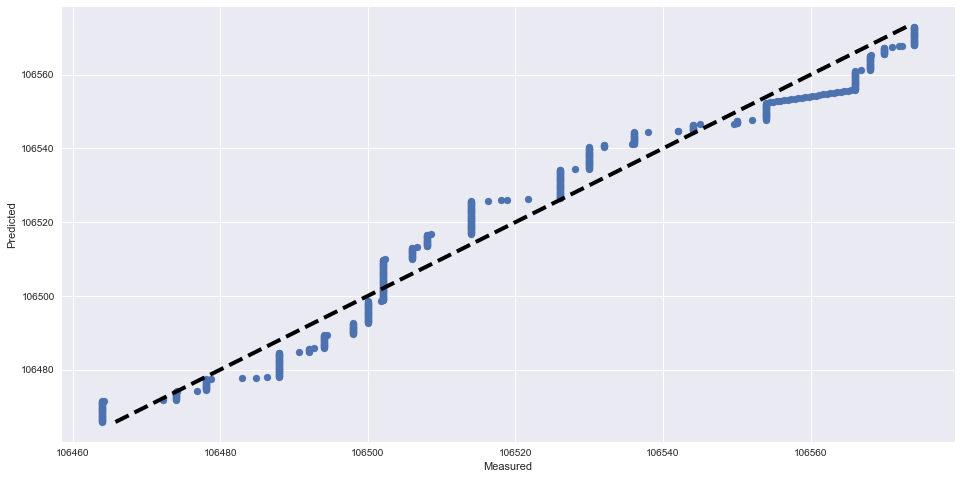

RMSE score: 5.7436971103
R2 score: 0.966976332186
---------------------------------------------------------------------------
Plotting for Meter 1042
Time series plot of the actual and predicted hourly meter readings


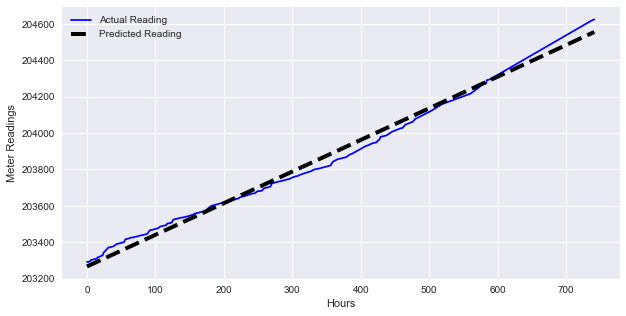

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


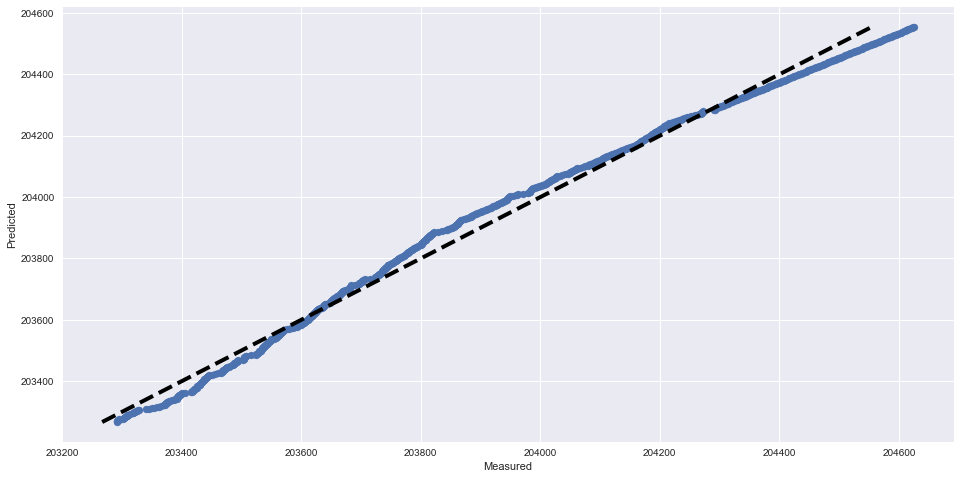

RMSE score: 35.1793884625
R2 score: 0.991168558667
---------------------------------------------------------------------------
Plotting for Meter 1086
Time series plot of the actual and predicted hourly meter readings


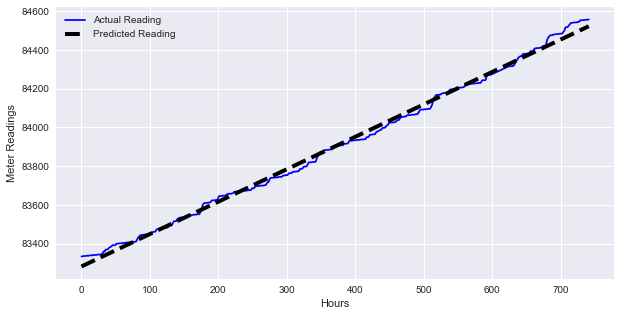

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


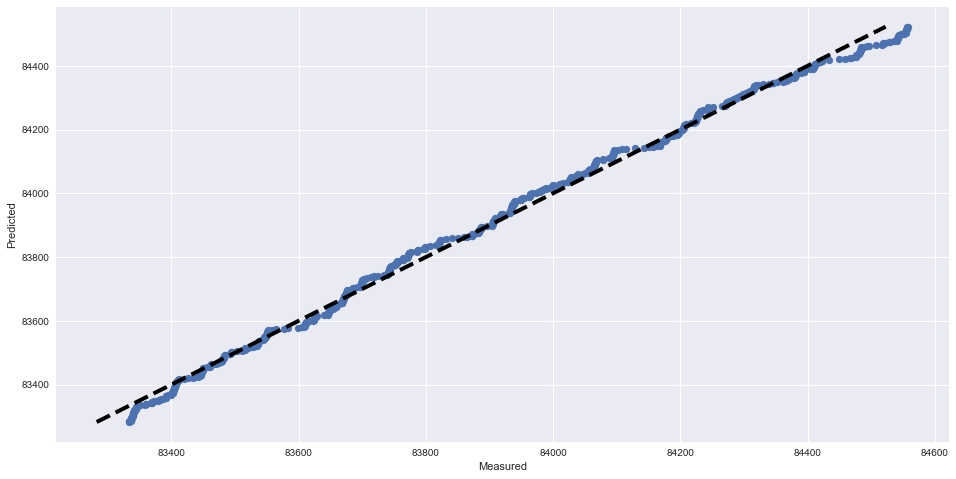

RMSE score: 22.4189821885
R2 score: 0.996096682417
---------------------------------------------------------------------------
Plotting for Meter 1185
Time series plot of the actual and predicted hourly meter readings


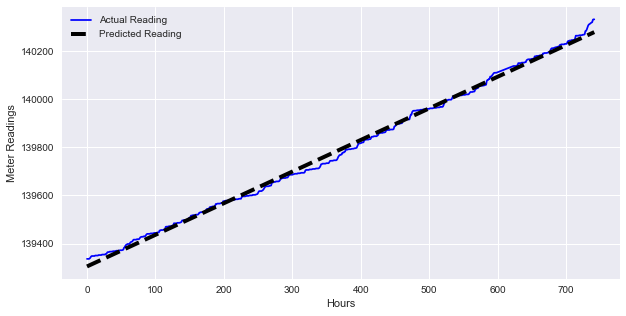

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


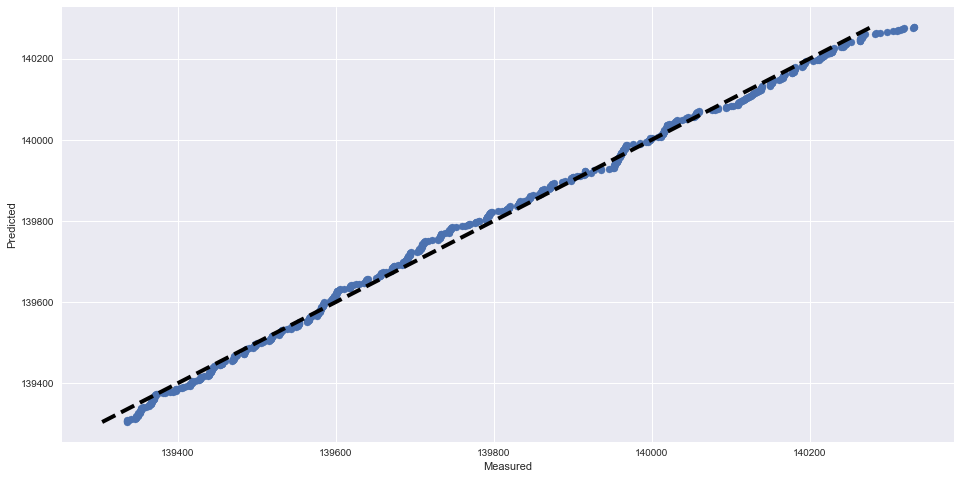

RMSE score: 15.9775325226
R2 score: 0.996795781473
---------------------------------------------------------------------------
Plotting for Meter 1283
Time series plot of the actual and predicted hourly meter readings


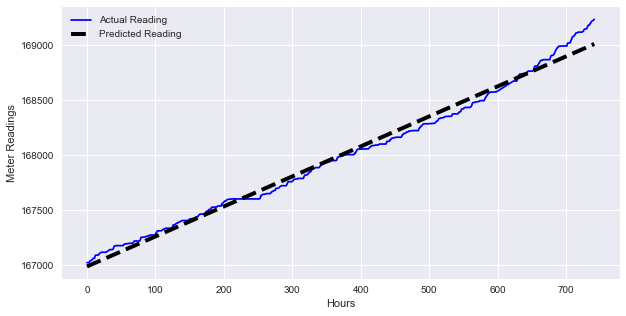

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


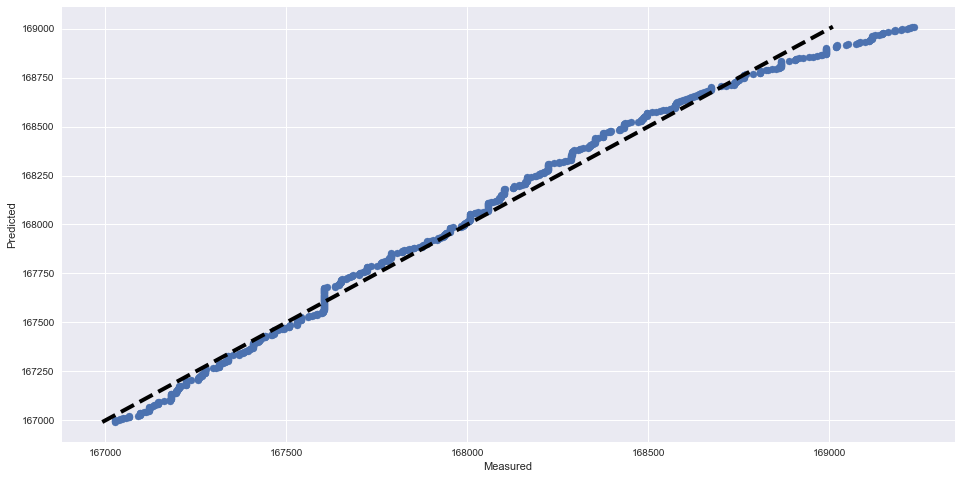

RMSE score: 61.9722442529
R2 score: 0.988837168849
---------------------------------------------------------------------------
Plotting for Meter 1415
Time series plot of the actual and predicted hourly meter readings


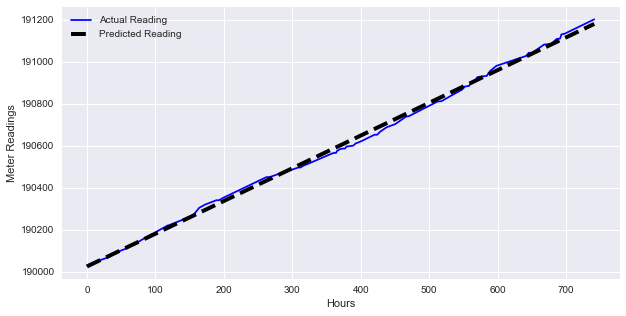

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


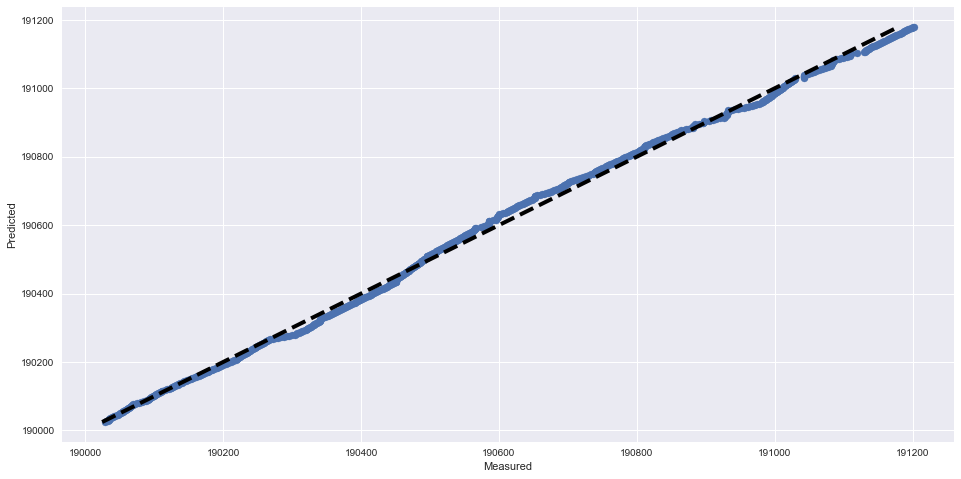

RMSE score: 15.6204313515
R2 score: 0.997817648053
---------------------------------------------------------------------------
Plotting for Meter 1507
Time series plot of the actual and predicted hourly meter readings


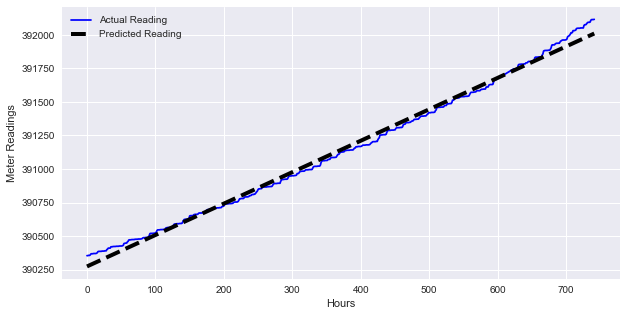

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


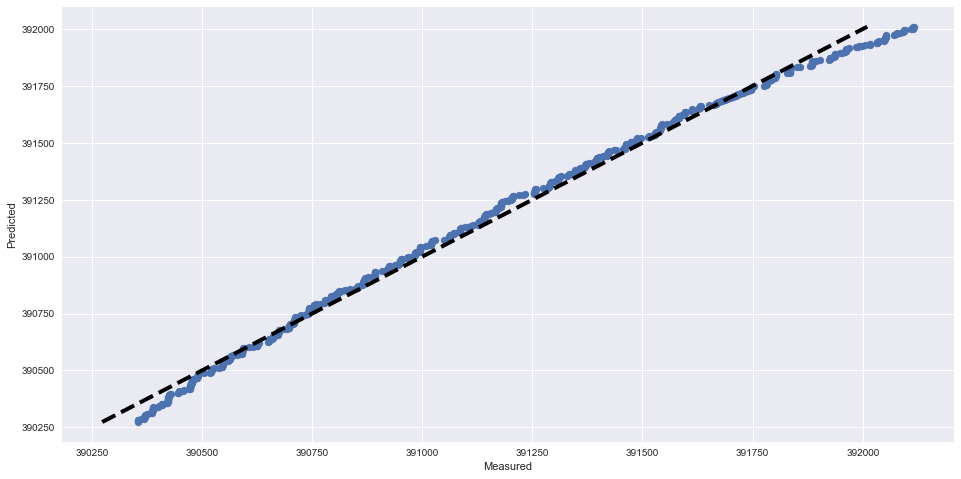

RMSE score: 38.3419973946
R2 score: 0.994193743308
---------------------------------------------------------------------------
Plotting for Meter 1556
Time series plot of the actual and predicted hourly meter readings


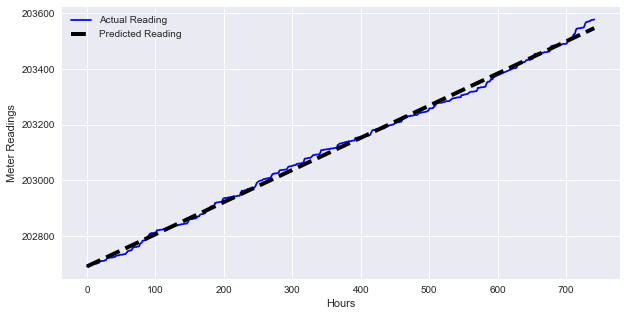

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


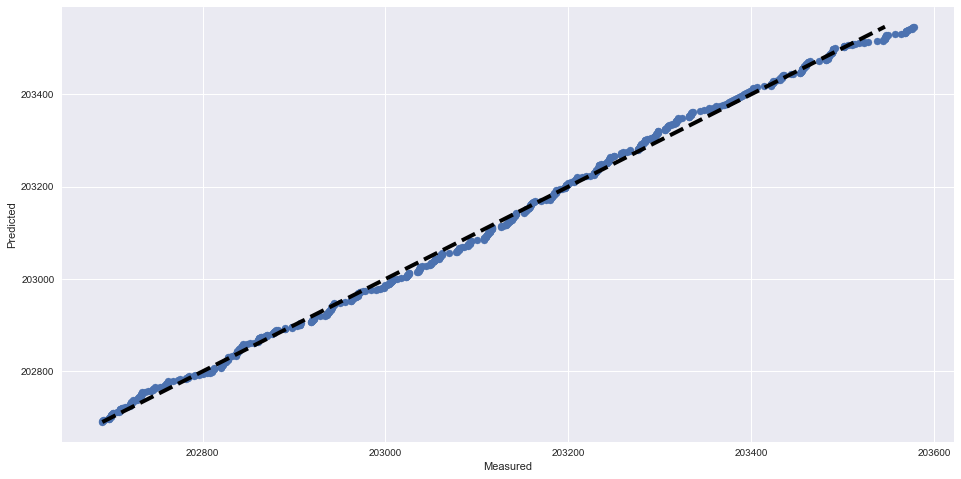

RMSE score: 12.1133718908
R2 score: 0.997610212306
---------------------------------------------------------------------------
Plotting for Meter 1589
Time series plot of the actual and predicted hourly meter readings


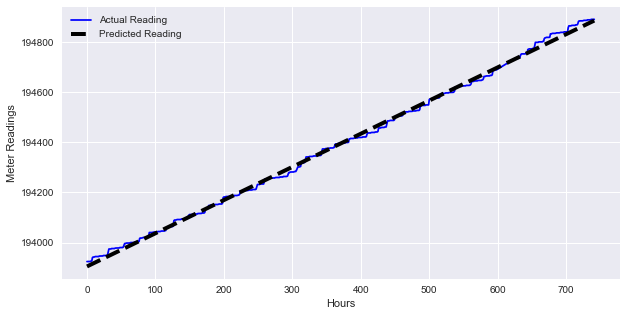

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


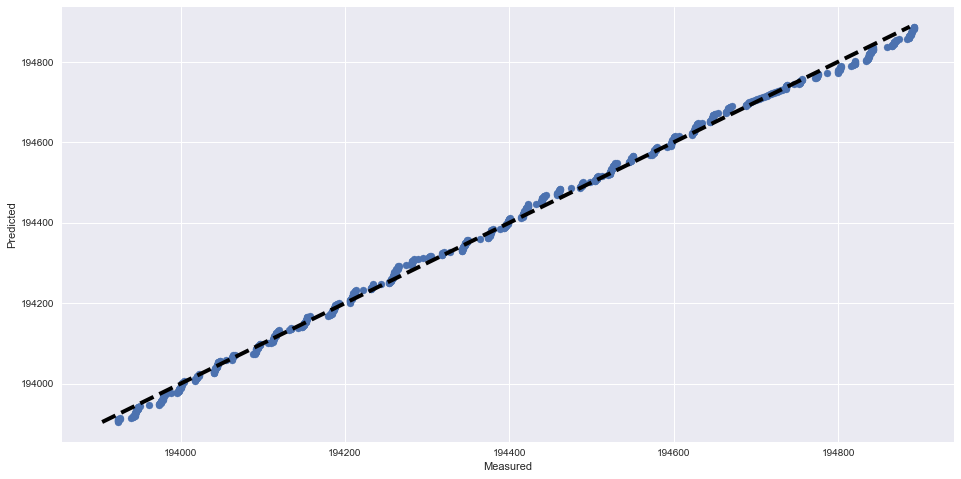

RMSE score: 12.4364866675
R2 score: 0.998088007779
---------------------------------------------------------------------------
Plotting for Meter 1619
Time series plot of the actual and predicted hourly meter readings


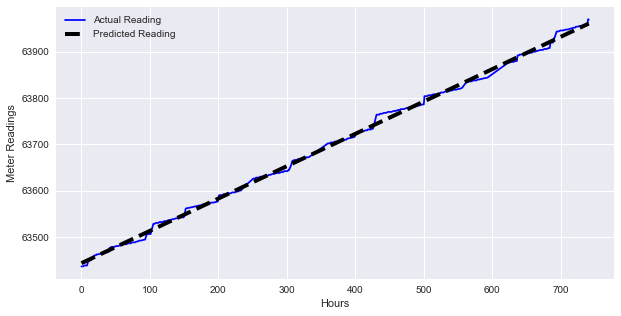

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


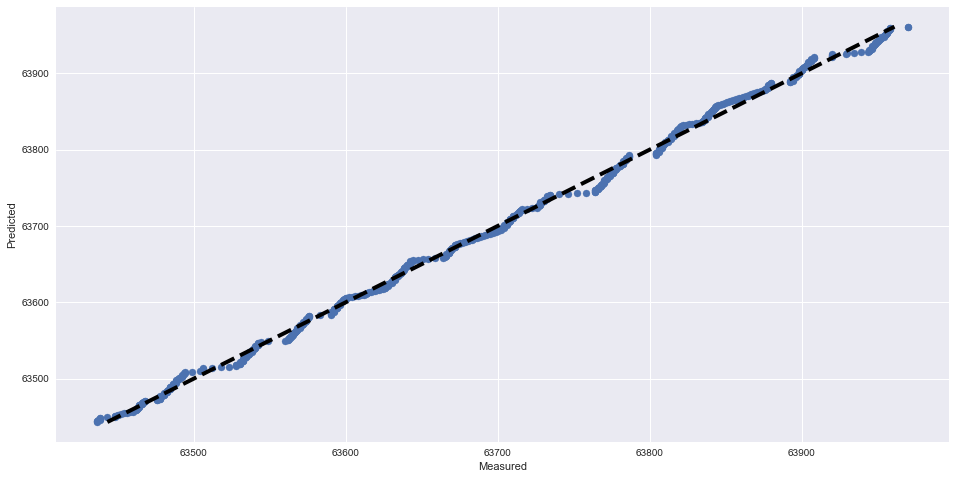

RMSE score: 6.54783618898
R2 score: 0.998088535119
---------------------------------------------------------------------------
Plotting for Meter 1697
Time series plot of the actual and predicted hourly meter readings


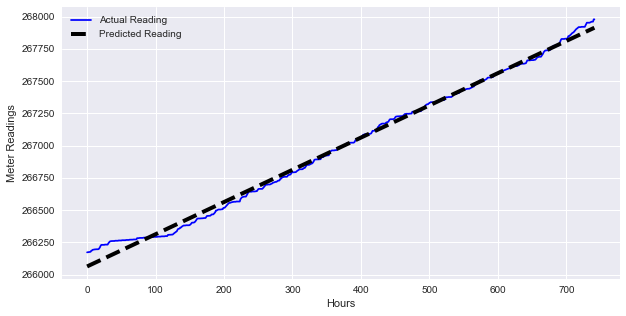

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


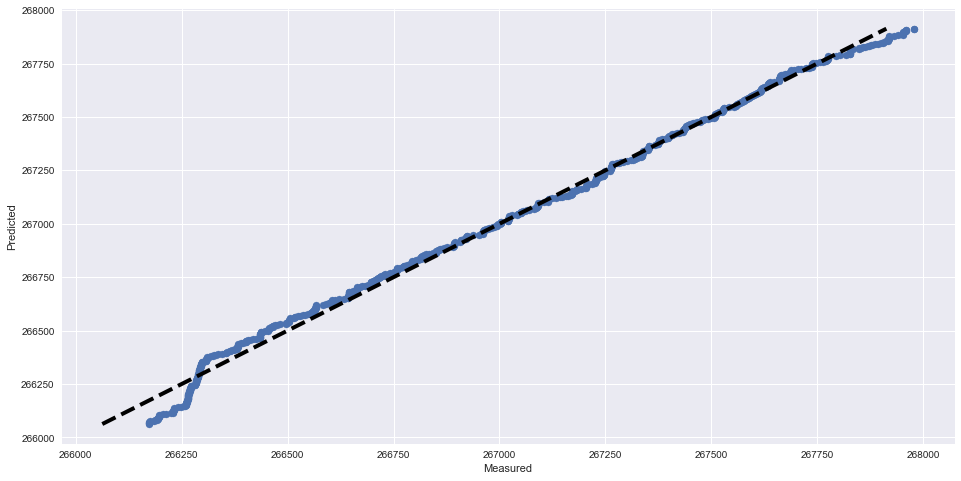

RMSE score: 38.5968251717
R2 score: 0.994795952596
---------------------------------------------------------------------------
Plotting for Meter 1714
Time series plot of the actual and predicted hourly meter readings


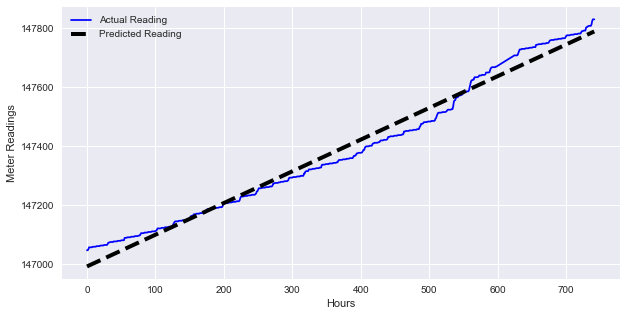

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


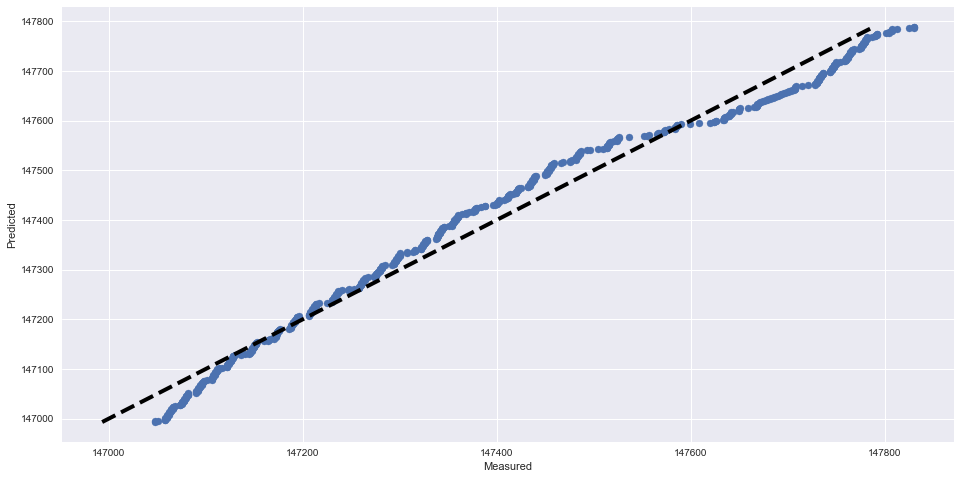

RMSE score: 31.9397402576
R2 score: 0.981098447618
---------------------------------------------------------------------------
Plotting for Meter 1718
Time series plot of the actual and predicted hourly meter readings


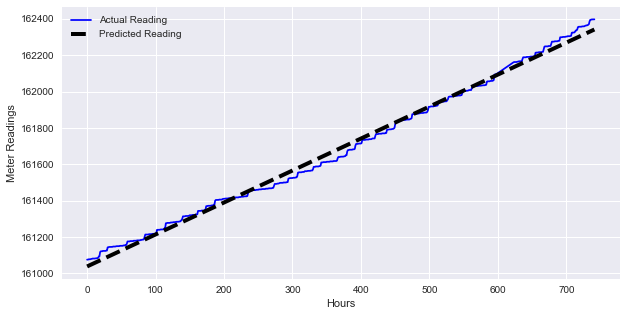

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


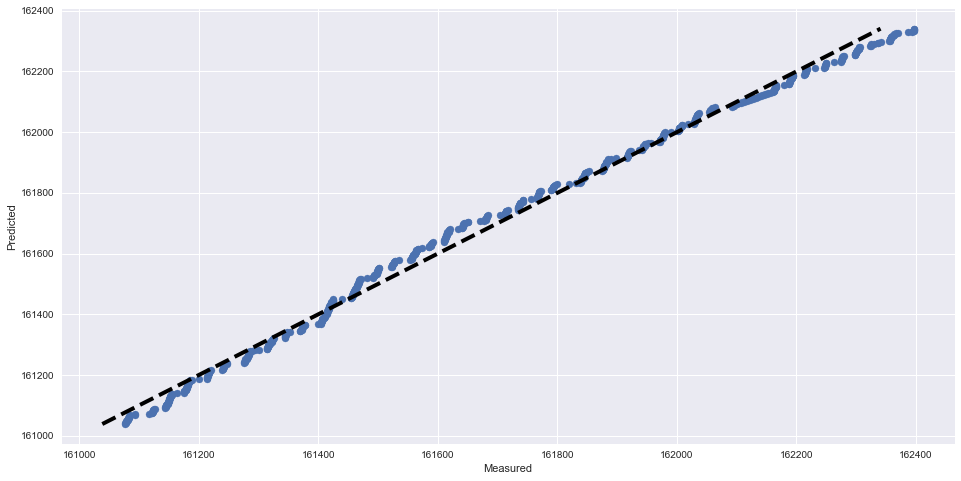

RMSE score: 27.9795629923
R2 score: 0.994508392128
---------------------------------------------------------------------------
Plotting for Meter 1790
Time series plot of the actual and predicted hourly meter readings


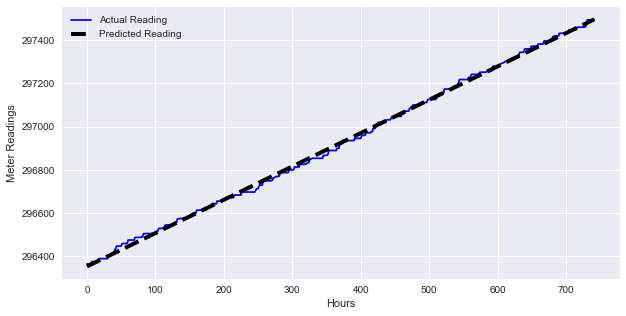

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


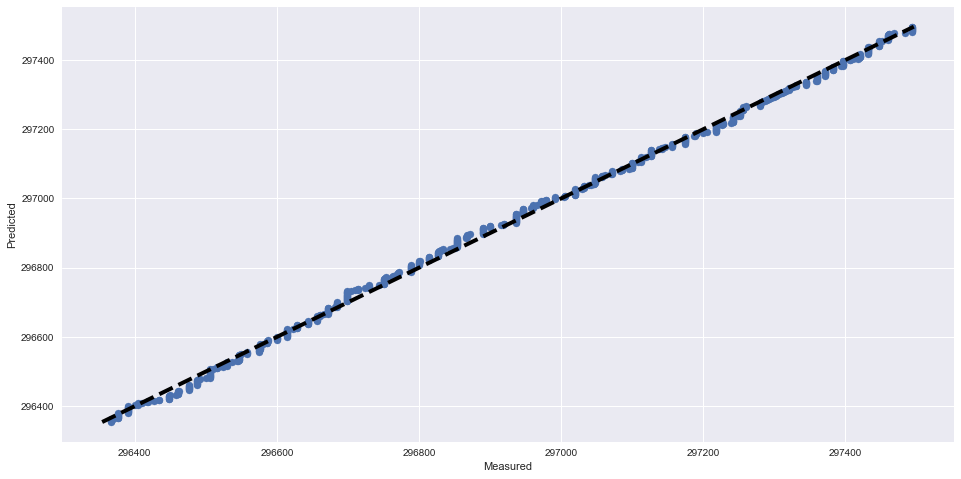

RMSE score: 11.9066057494
R2 score: 0.998701988026
---------------------------------------------------------------------------
Plotting for Meter 1791
Time series plot of the actual and predicted hourly meter readings


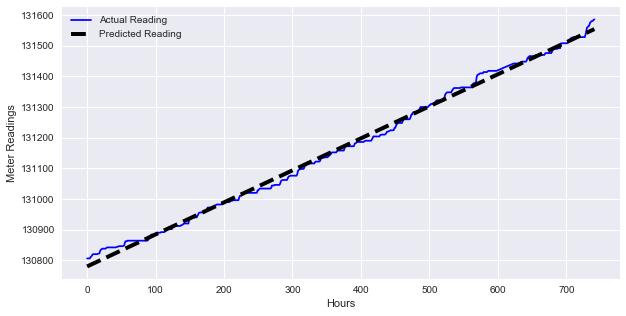

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


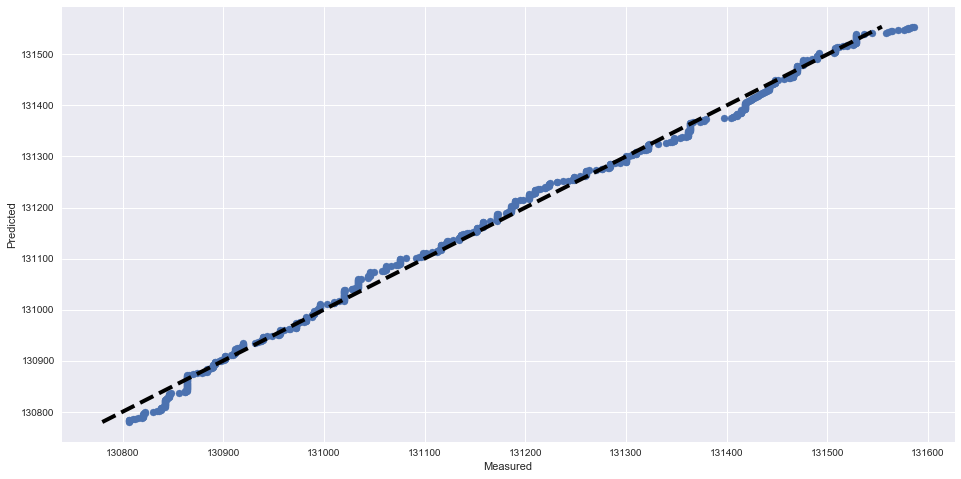

RMSE score: 13.6627998671
R2 score: 0.996287049247
---------------------------------------------------------------------------
Plotting for Meter 1792
Time series plot of the actual and predicted hourly meter readings


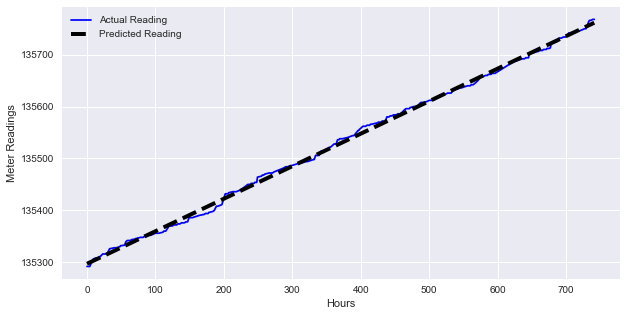

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


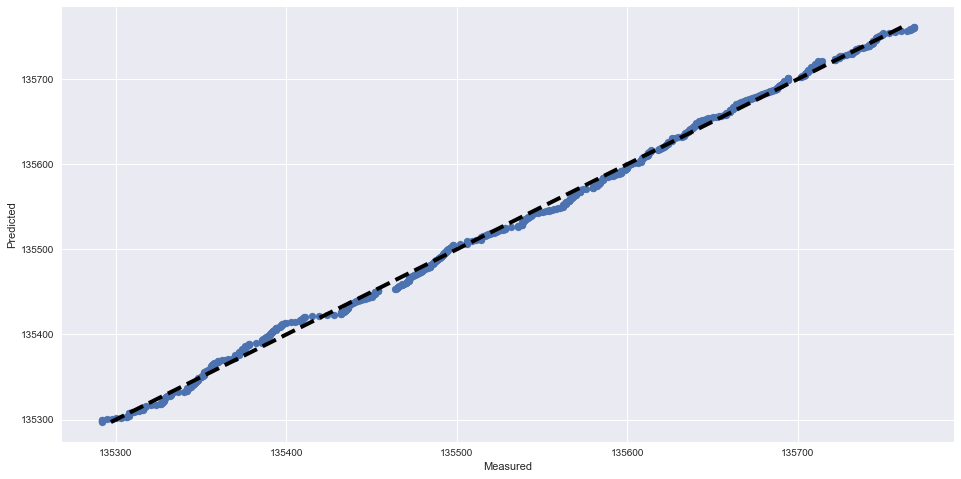

RMSE score: 5.54977475486
R2 score: 0.998289875333
---------------------------------------------------------------------------
Plotting for Meter 1800
Time series plot of the actual and predicted hourly meter readings


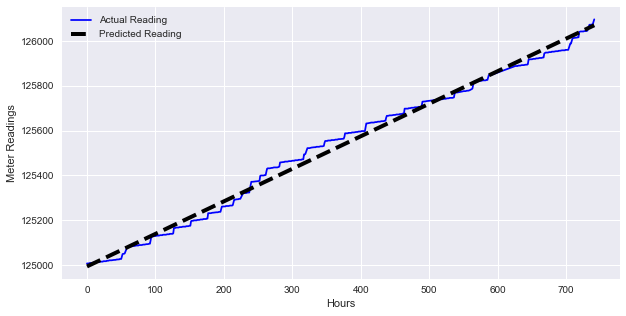

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


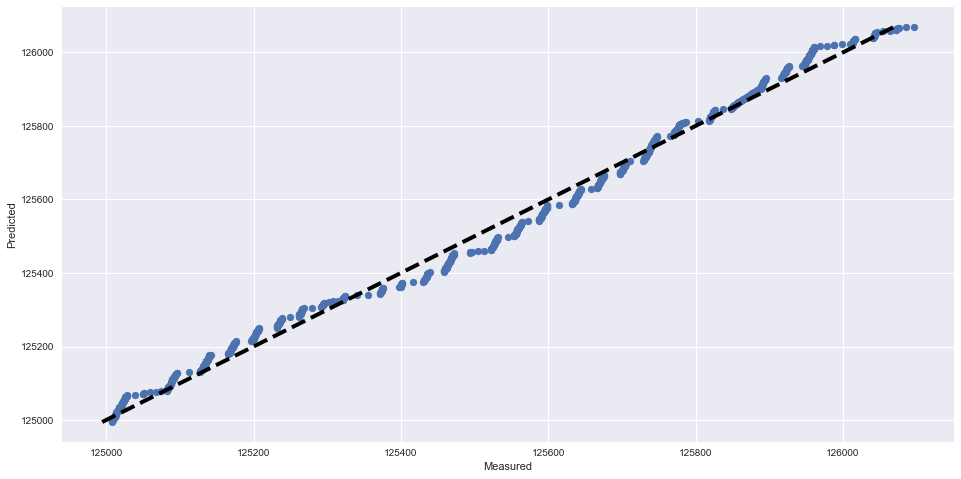

RMSE score: 27.3311702228
R2 score: 0.992311632348
---------------------------------------------------------------------------
Plotting for Meter 1801
Time series plot of the actual and predicted hourly meter readings


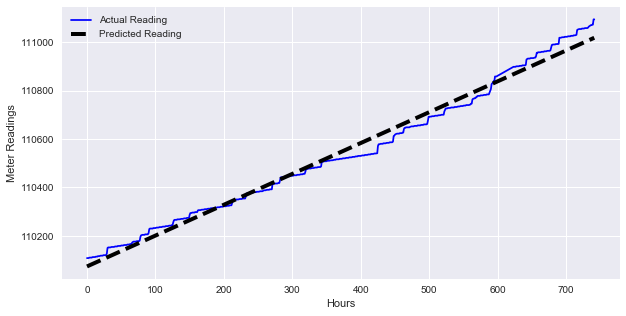

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


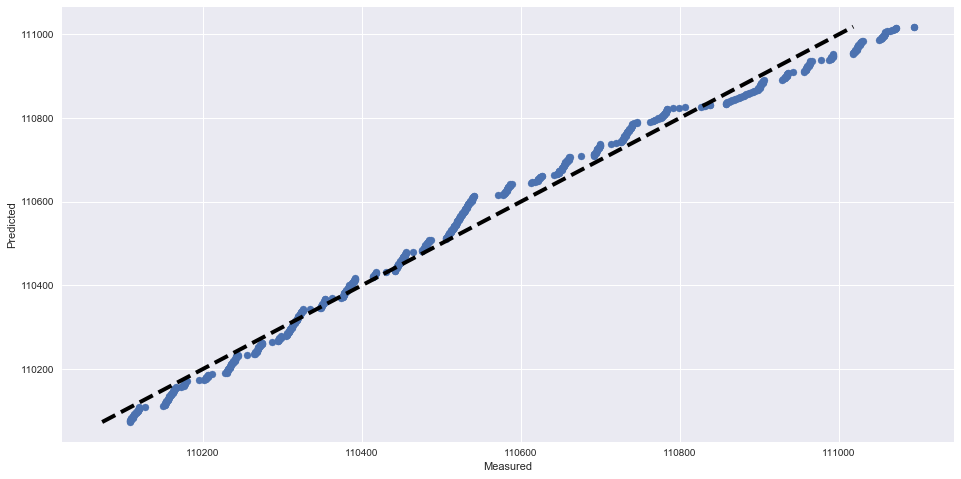

RMSE score: 31.5422626949
R2 score: 0.986846420159
---------------------------------------------------------------------------
Plotting for Meter 2018
Time series plot of the actual and predicted hourly meter readings


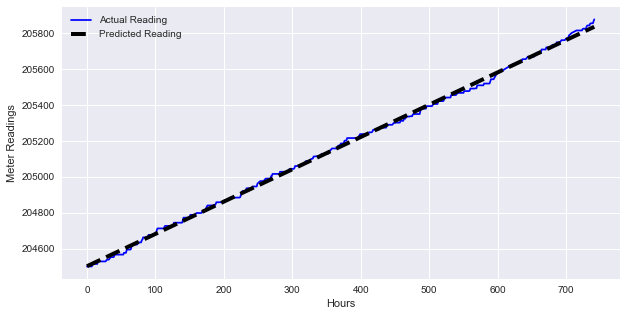

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


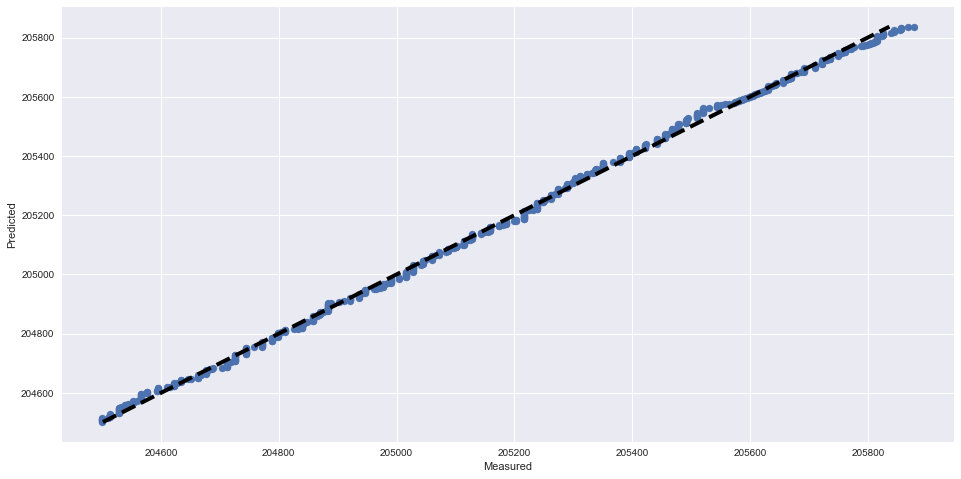

RMSE score: 13.516293188
R2 score: 0.998776411592
---------------------------------------------------------------------------
Plotting for Meter 2034
Time series plot of the actual and predicted hourly meter readings


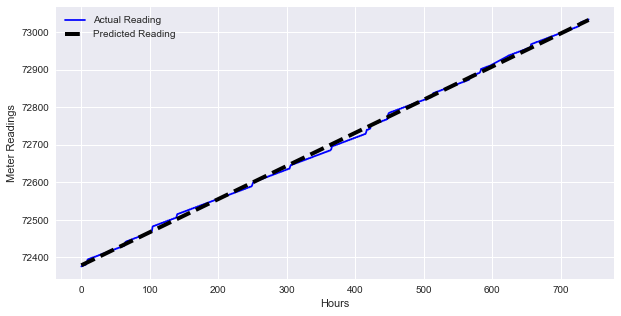

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


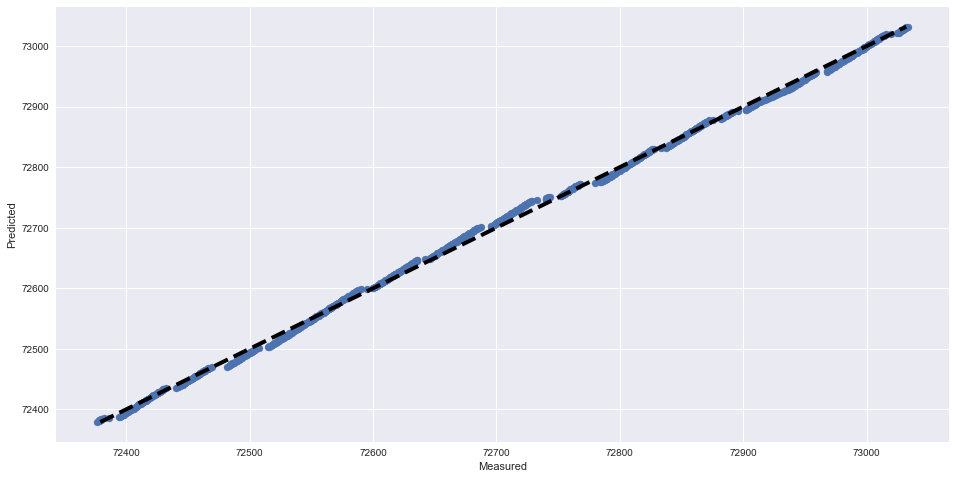

RMSE score: 6.34215541284
R2 score: 0.998874293769
---------------------------------------------------------------------------
Plotting for Meter 2072
Time series plot of the actual and predicted hourly meter readings


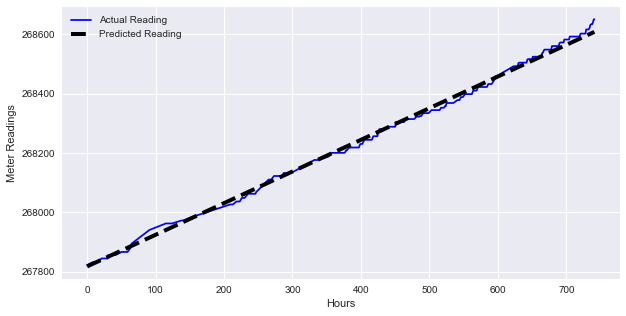

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


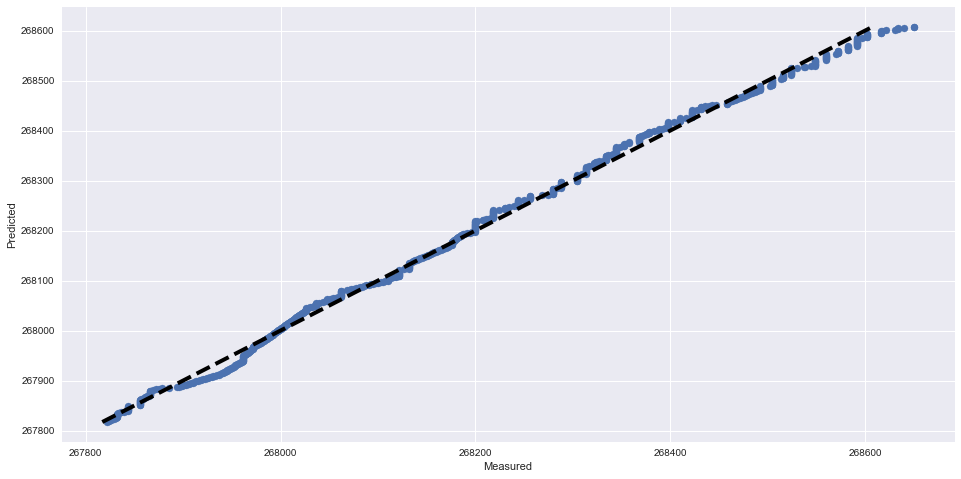

RMSE score: 11.9565069181
R2 score: 0.997274622692
---------------------------------------------------------------------------
Plotting for Meter 2094
Time series plot of the actual and predicted hourly meter readings


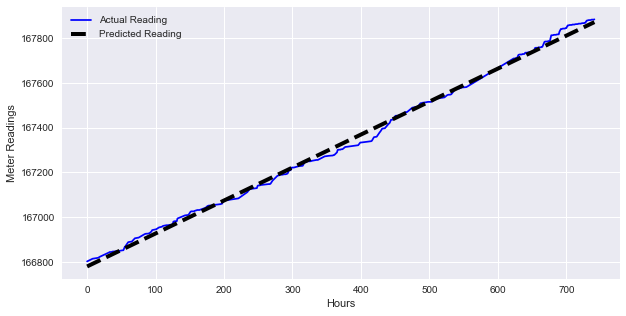

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


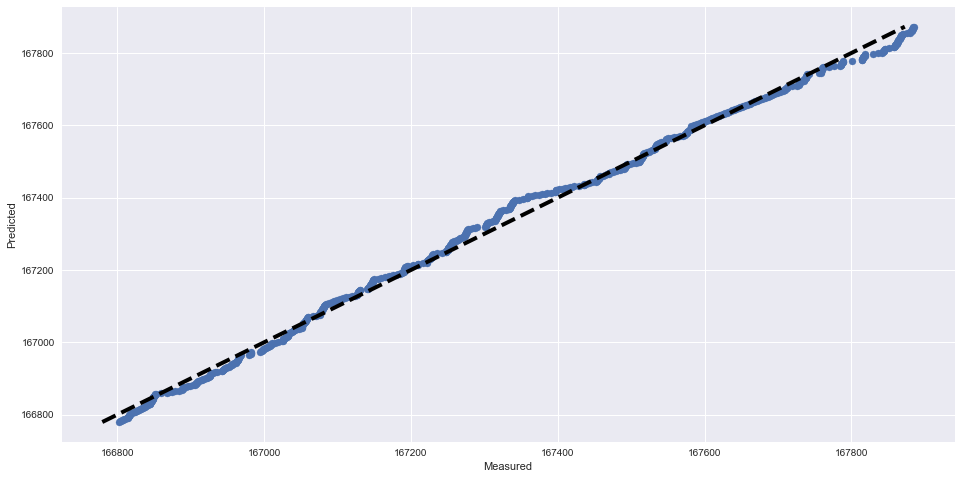

RMSE score: 18.2551299598
R2 score: 0.996681300133
---------------------------------------------------------------------------
Plotting for Meter 2129
Time series plot of the actual and predicted hourly meter readings


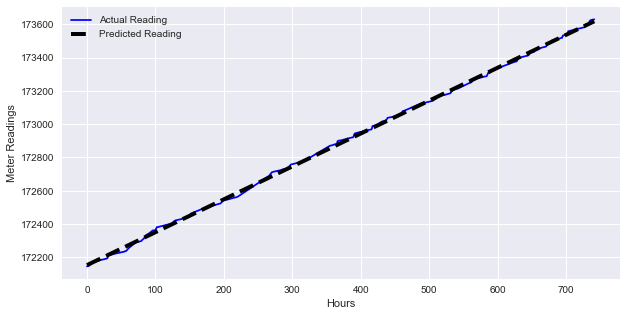

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


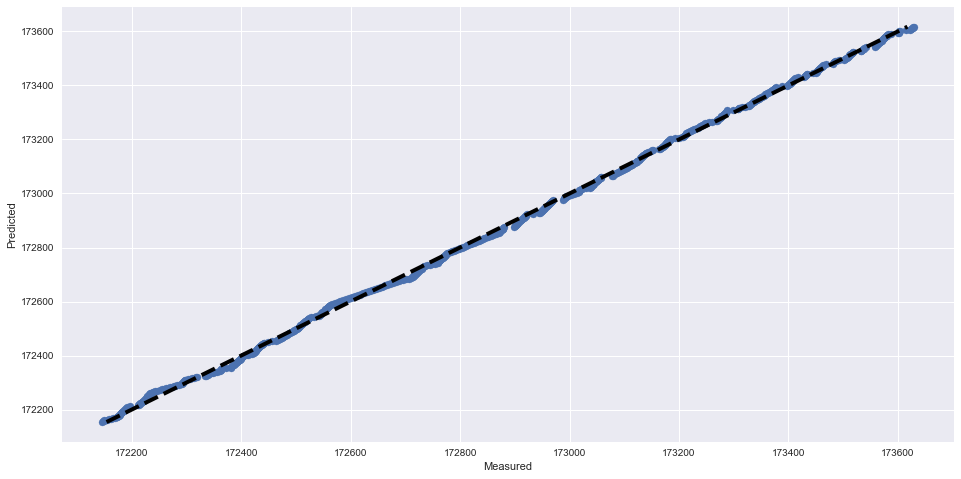

RMSE score: 10.5637125784
R2 score: 0.999377184862
---------------------------------------------------------------------------
Plotting for Meter 2233
Time series plot of the actual and predicted hourly meter readings


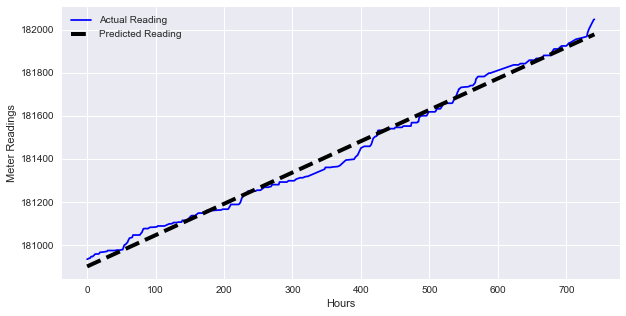

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


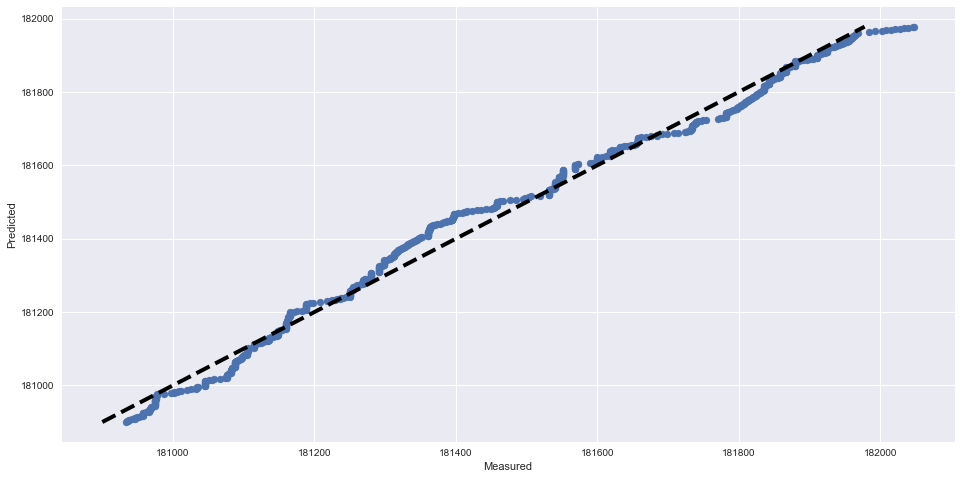

RMSE score: 30.8626379362
R2 score: 0.990294266499
---------------------------------------------------------------------------
Plotting for Meter 2335
Time series plot of the actual and predicted hourly meter readings


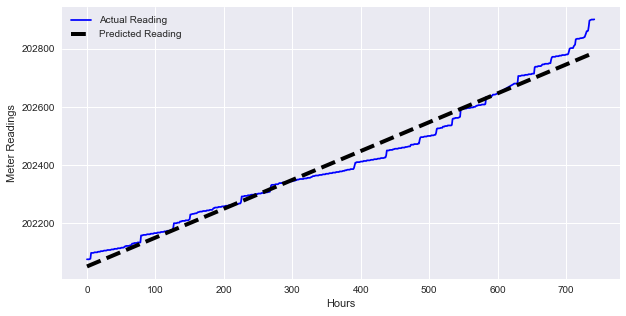

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


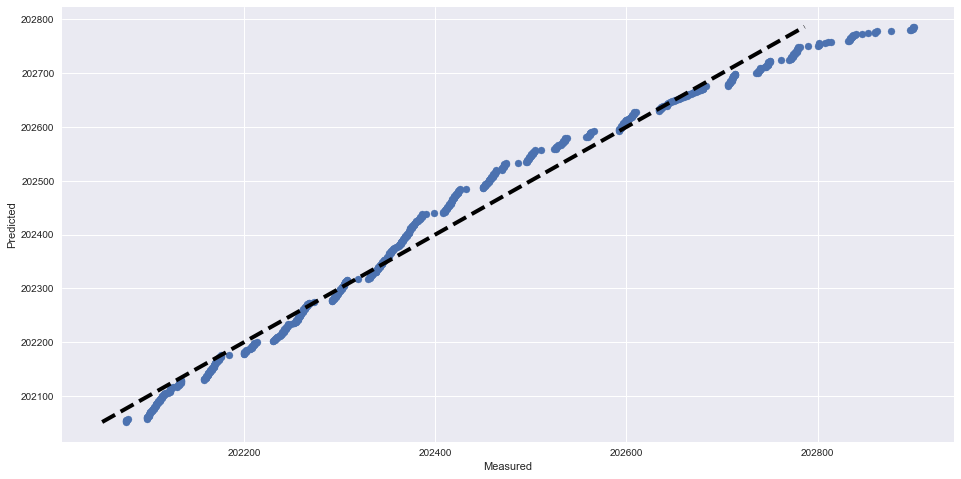

RMSE score: 32.8520199349
R2 score: 0.97663784001
---------------------------------------------------------------------------
Plotting for Meter 2378
Time series plot of the actual and predicted hourly meter readings


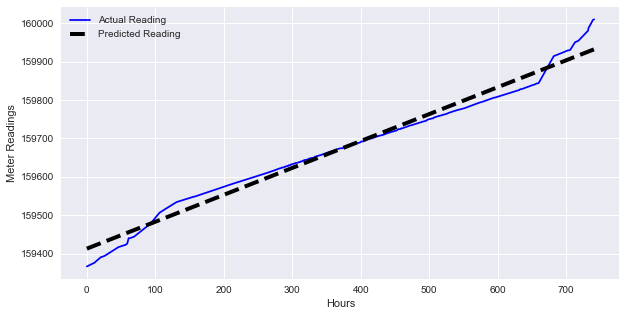

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


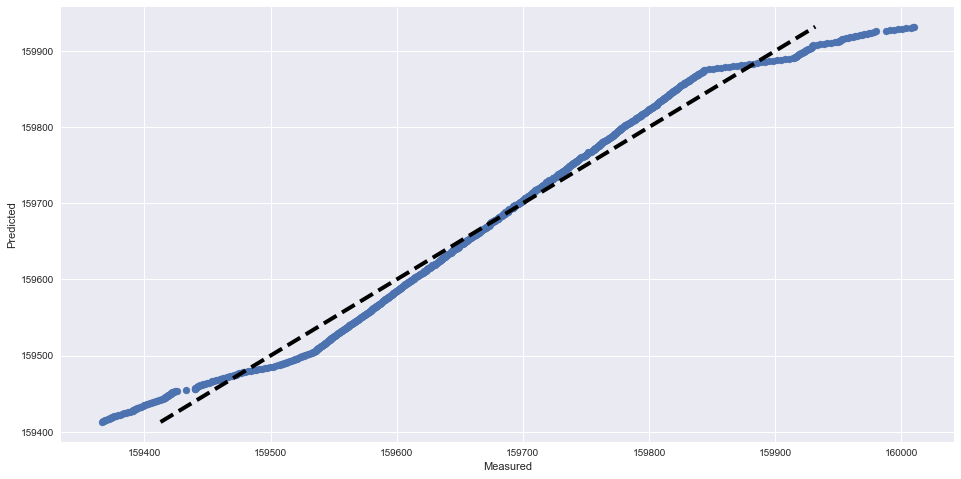

RMSE score: 22.5124458682
R2 score: 0.977979559125
---------------------------------------------------------------------------
Plotting for Meter 2449
Time series plot of the actual and predicted hourly meter readings


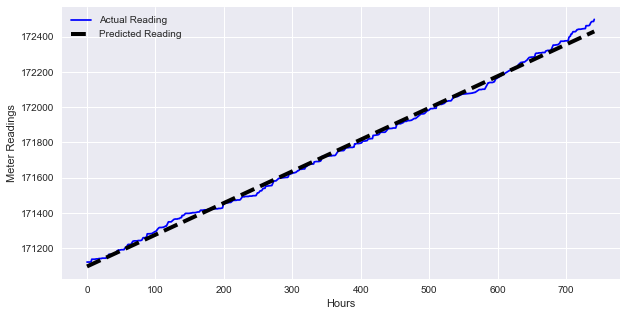

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


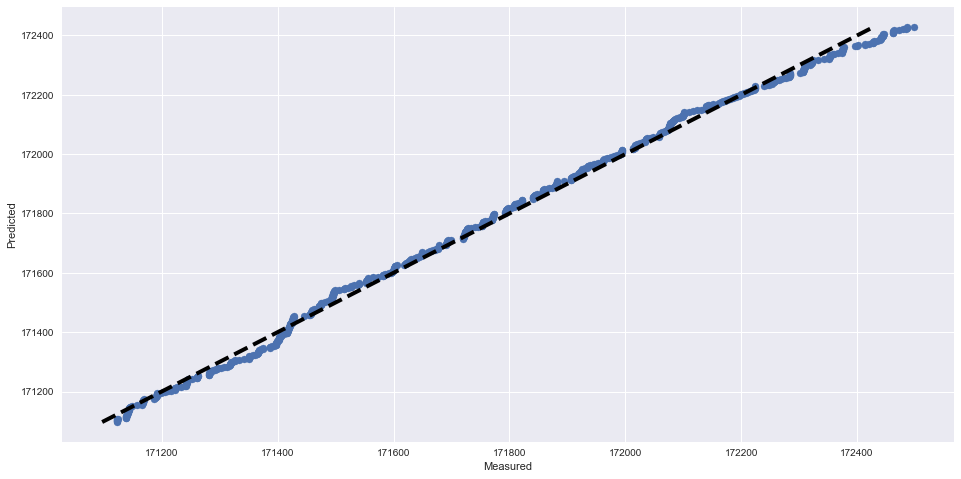

RMSE score: 21.3694020158
R2 score: 0.996936183245
---------------------------------------------------------------------------
Plotting for Meter 2461
Time series plot of the actual and predicted hourly meter readings


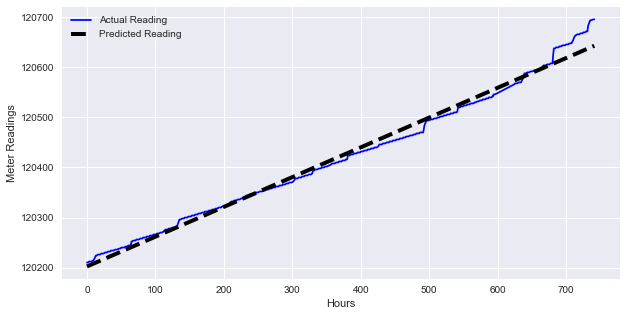

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


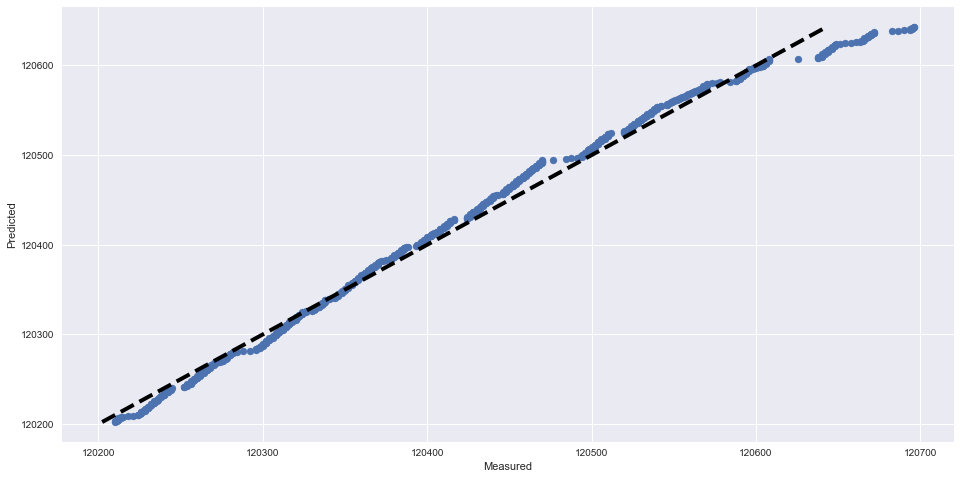

RMSE score: 13.5152072032
R2 score: 0.988875577742
---------------------------------------------------------------------------
Plotting for Meter 2470
Time series plot of the actual and predicted hourly meter readings


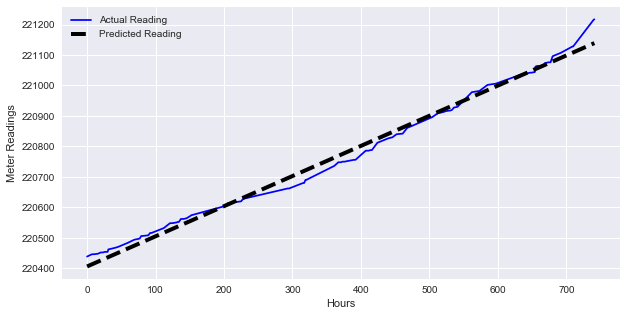

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


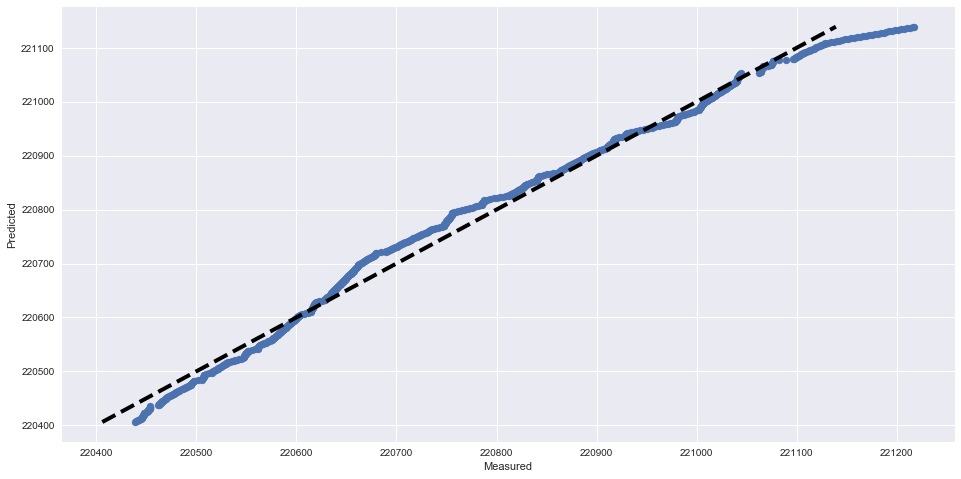

RMSE score: 21.5622587378
R2 score: 0.989738551517
---------------------------------------------------------------------------
Plotting for Meter 2575
Time series plot of the actual and predicted hourly meter readings


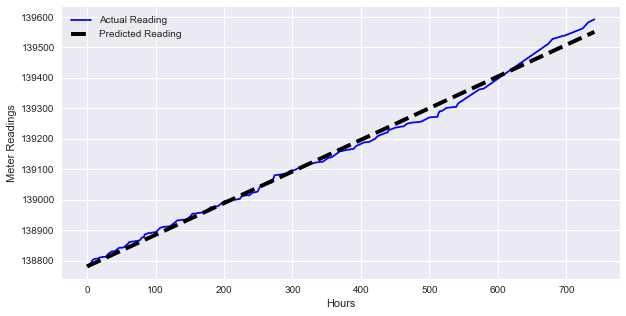

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


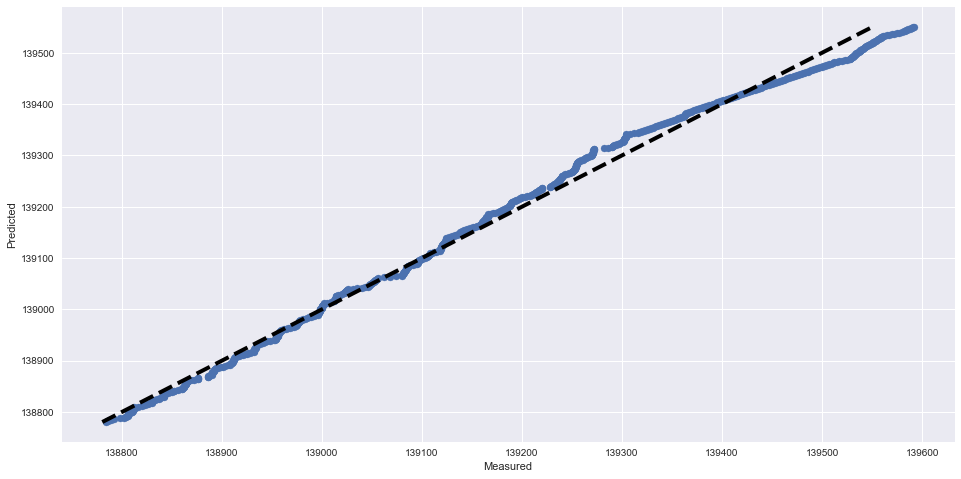

RMSE score: 17.8371074767
R2 score: 0.993626981727
---------------------------------------------------------------------------
Plotting for Meter 2638
Time series plot of the actual and predicted hourly meter readings


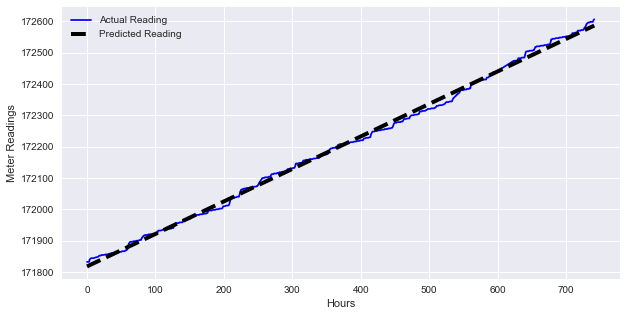

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


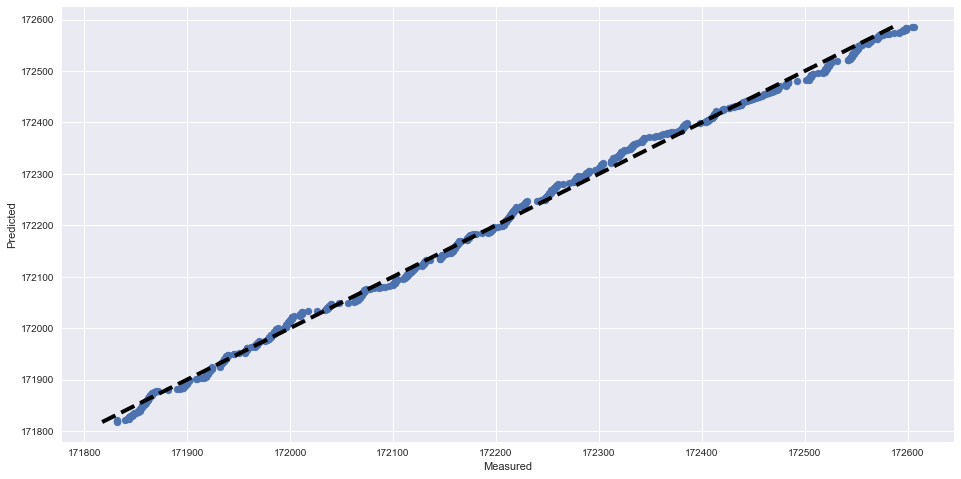

RMSE score: 10.7557002671
R2 score: 0.997664423517
---------------------------------------------------------------------------
Plotting for Meter 2645
Time series plot of the actual and predicted hourly meter readings


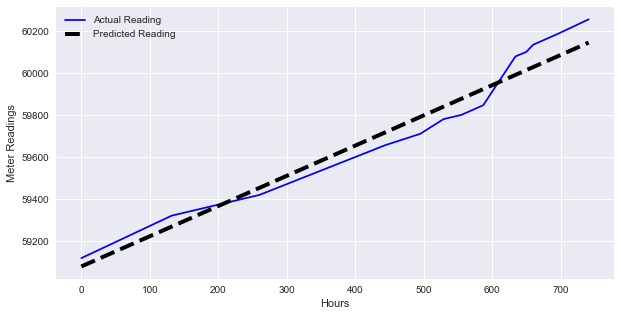

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


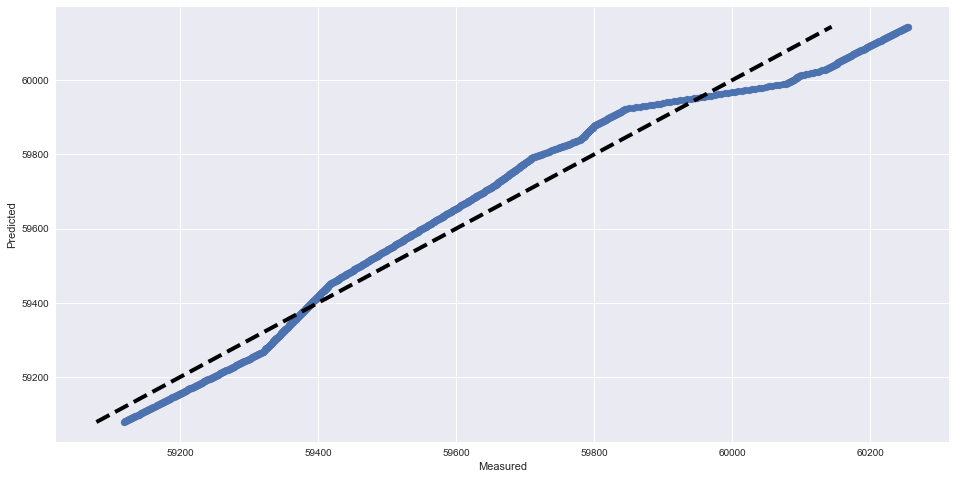

RMSE score: 61.2804936242
R2 score: 0.961998281405
---------------------------------------------------------------------------
Plotting for Meter 2965
Time series plot of the actual and predicted hourly meter readings


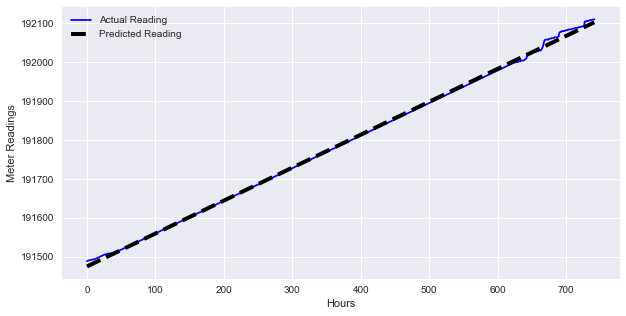

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


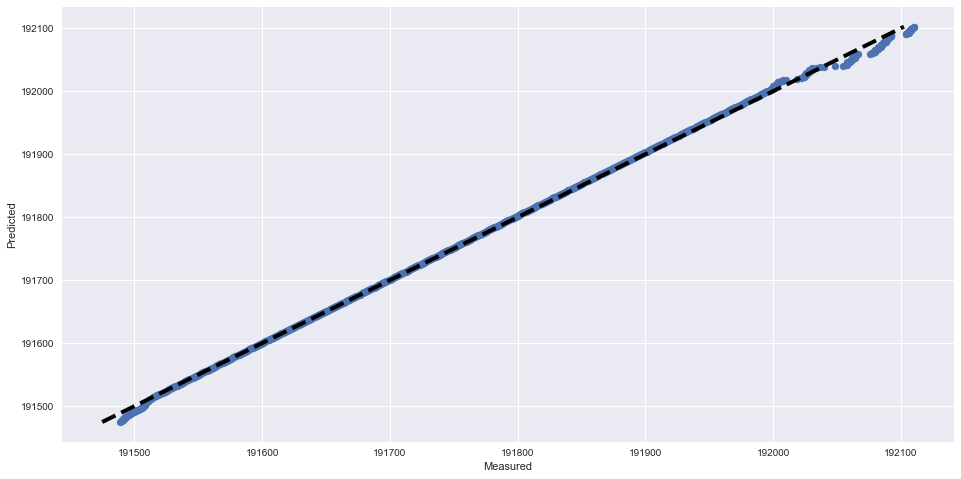

RMSE score: 4.90558900609
R2 score: 0.99926860734
---------------------------------------------------------------------------
Plotting for Meter 2980
Time series plot of the actual and predicted hourly meter readings


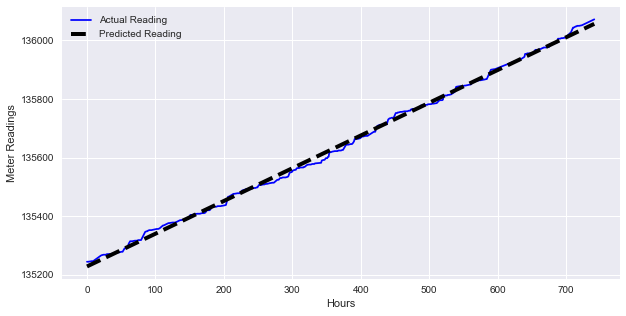

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


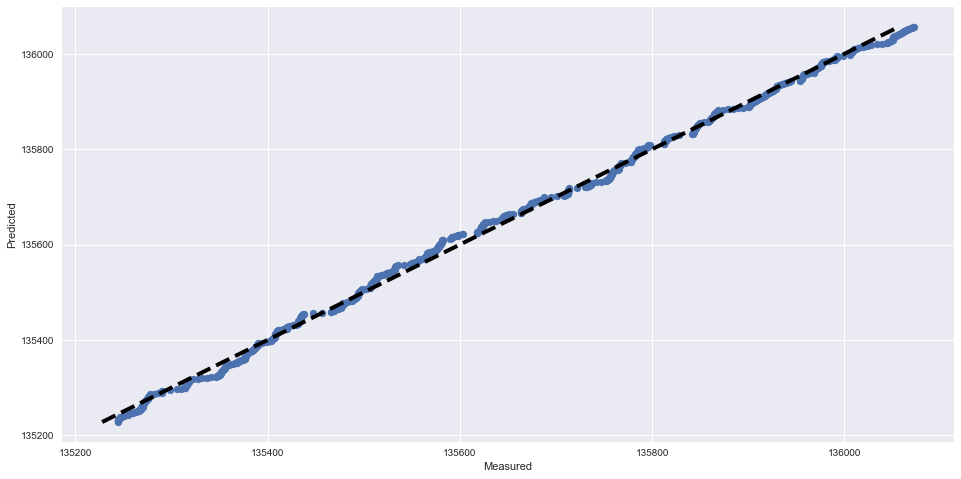

RMSE score: 10.6345165218
R2 score: 0.998035544781
---------------------------------------------------------------------------
Plotting for Meter 3039
Time series plot of the actual and predicted hourly meter readings


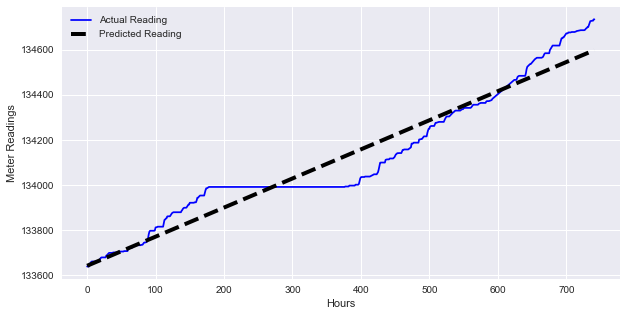

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


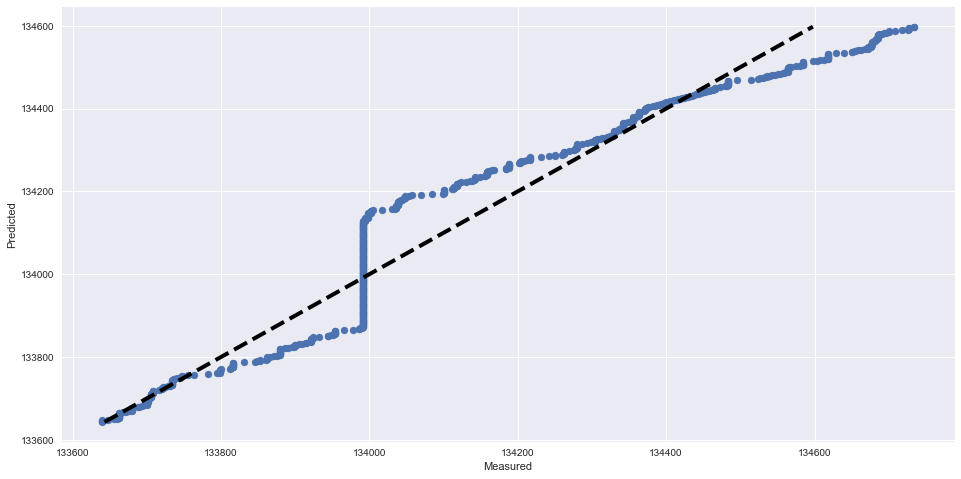

RMSE score: 74.2505198833
R2 score: 0.932804876596
---------------------------------------------------------------------------
Plotting for Meter 3134
Time series plot of the actual and predicted hourly meter readings


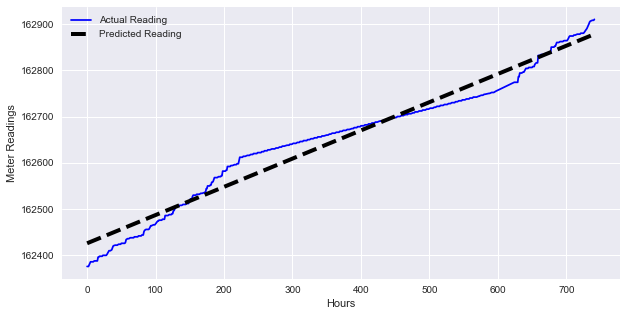

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


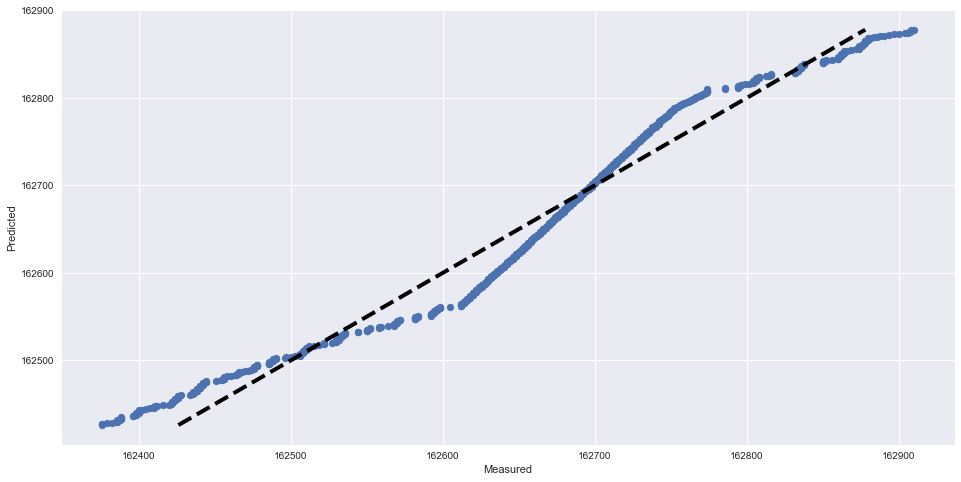

RMSE score: 25.5205242064
R2 score: 0.963192381088
---------------------------------------------------------------------------
Plotting for Meter 3367
Time series plot of the actual and predicted hourly meter readings


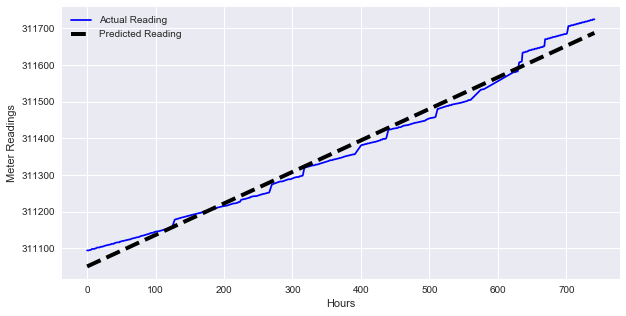

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


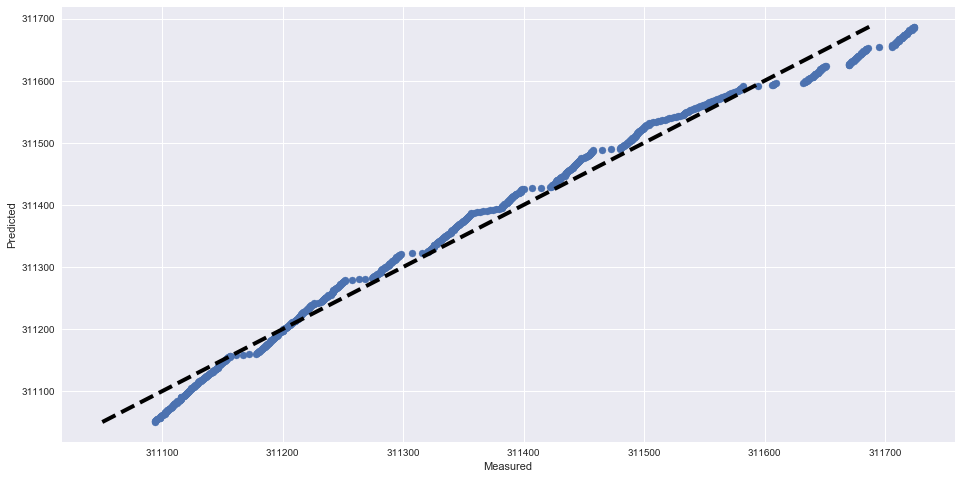

RMSE score: 22.6032495481
R2 score: 0.985173749522
---------------------------------------------------------------------------
Plotting for Meter 3527
Time series plot of the actual and predicted hourly meter readings


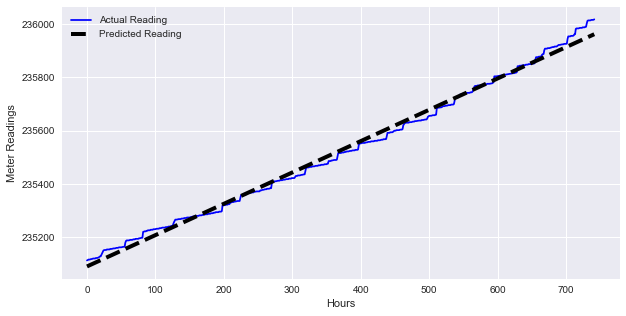

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


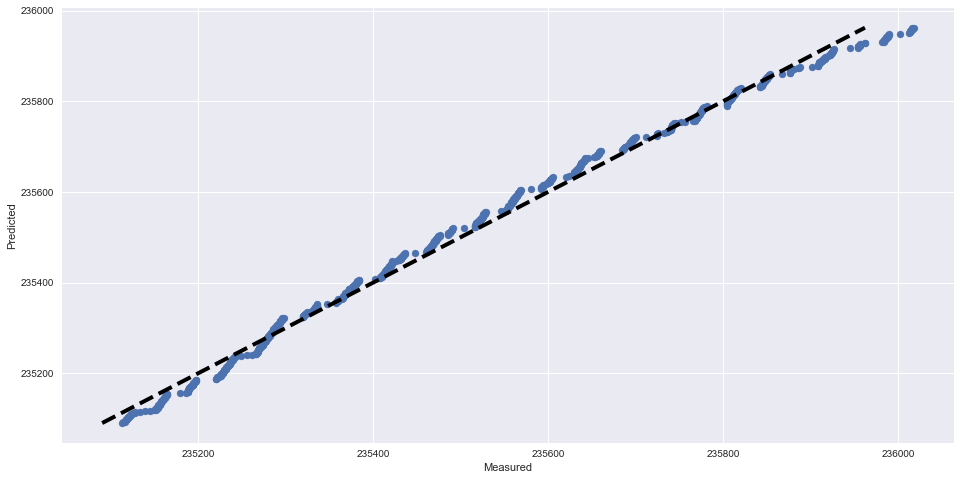

RMSE score: 20.0858344764
R2 score: 0.993694001914
---------------------------------------------------------------------------
Plotting for Meter 3544
Time series plot of the actual and predicted hourly meter readings


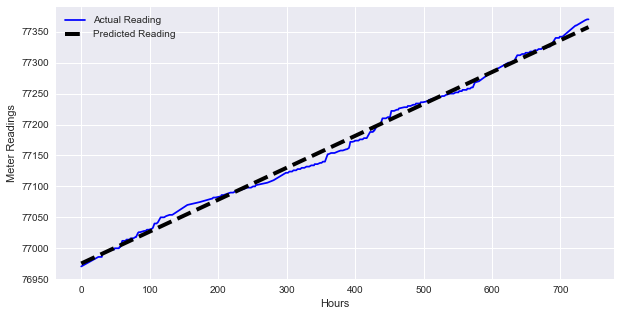

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


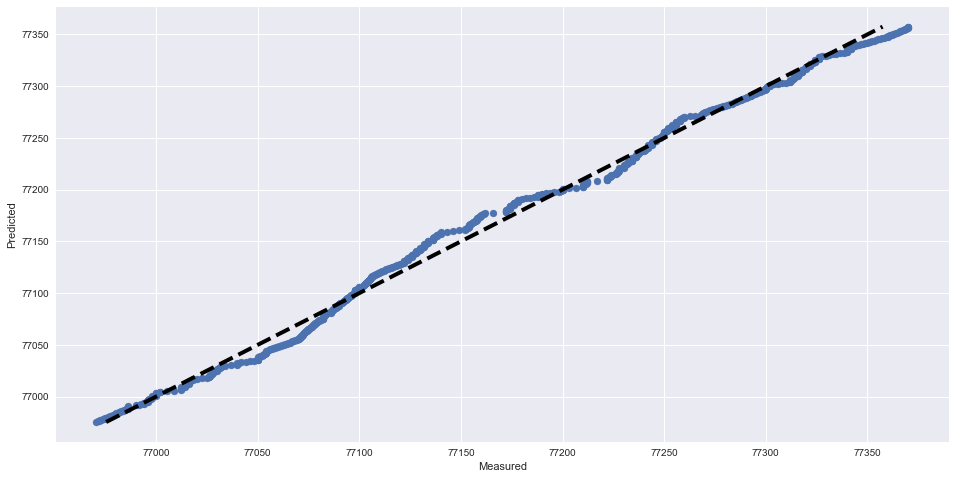

RMSE score: 8.09088419849
R2 score: 0.994676920184
---------------------------------------------------------------------------
Plotting for Meter 3577
Time series plot of the actual and predicted hourly meter readings


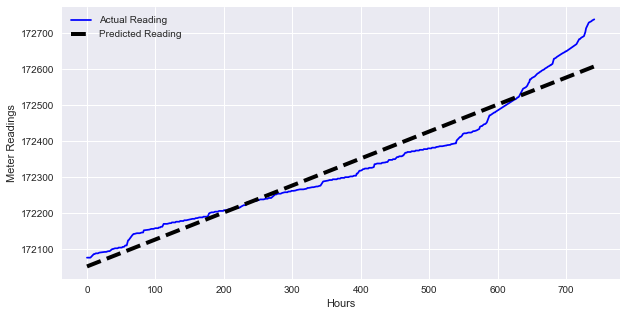

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


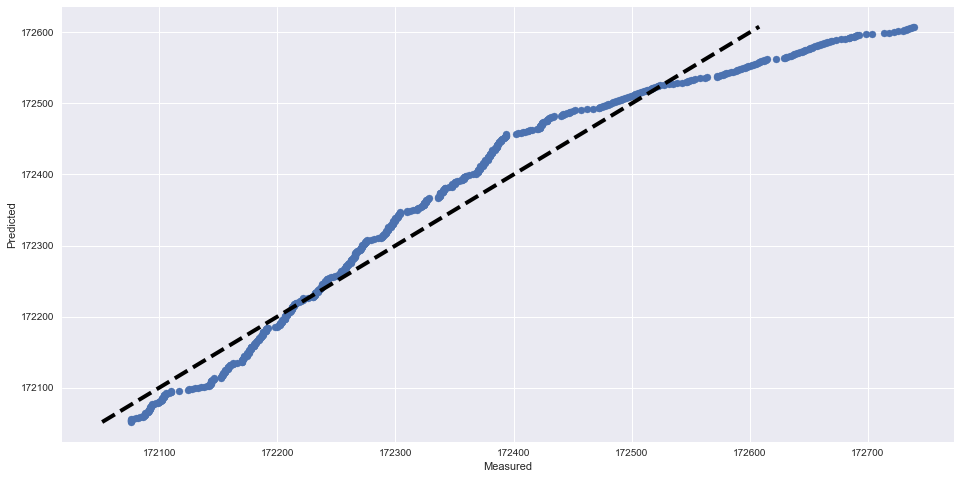

RMSE score: 39.5188593166
R2 score: 0.943112606159
---------------------------------------------------------------------------
Plotting for Meter 3635
Time series plot of the actual and predicted hourly meter readings


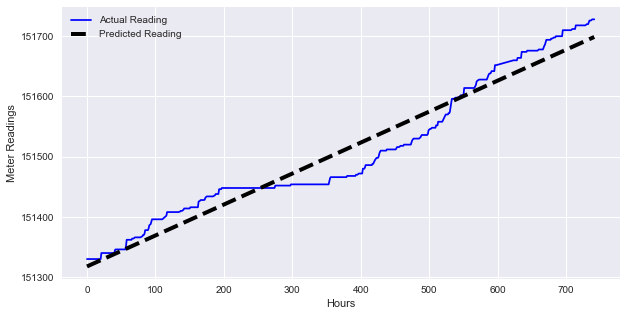

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


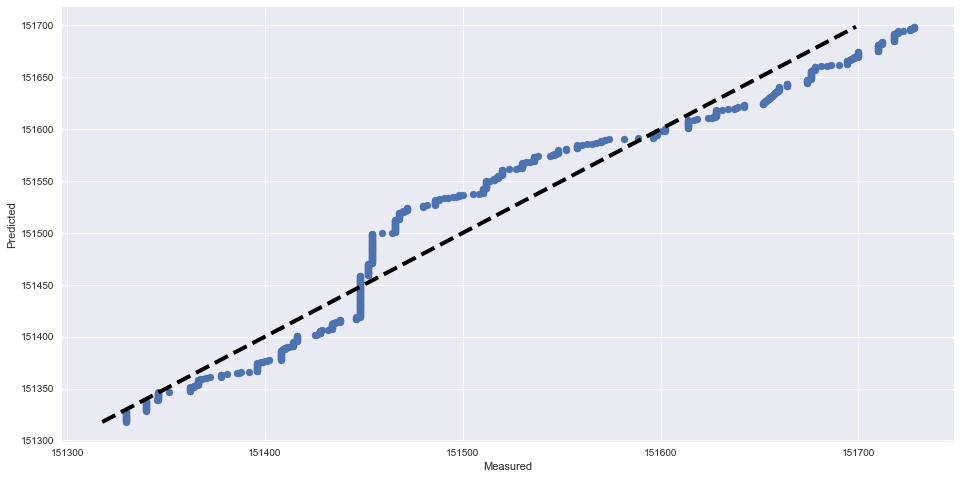

RMSE score: 26.2100831167
R2 score: 0.94673147482
---------------------------------------------------------------------------
Plotting for Meter 3723
Time series plot of the actual and predicted hourly meter readings


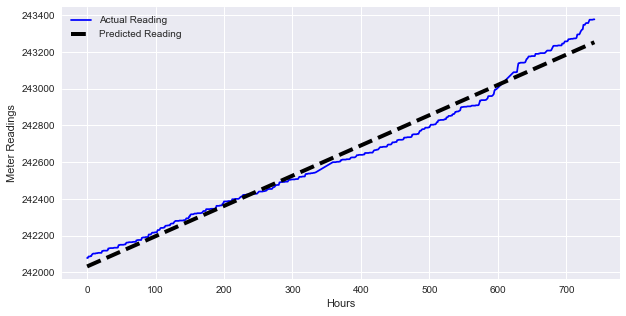

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


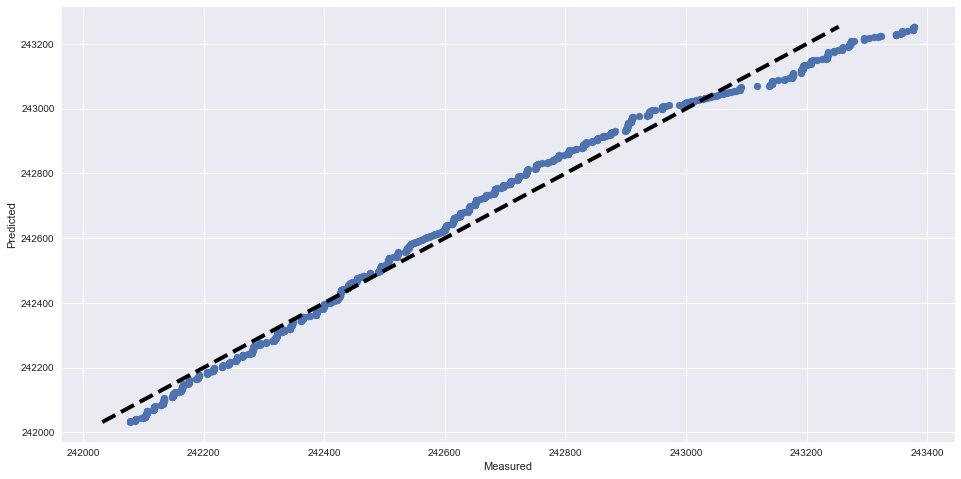

RMSE score: 48.5080709285
R2 score: 0.981479197394
---------------------------------------------------------------------------
Plotting for Meter 3778
Time series plot of the actual and predicted hourly meter readings


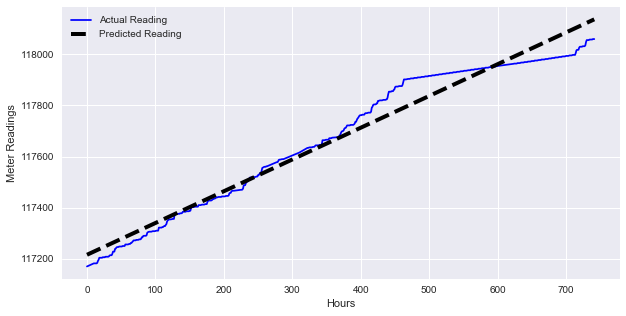

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


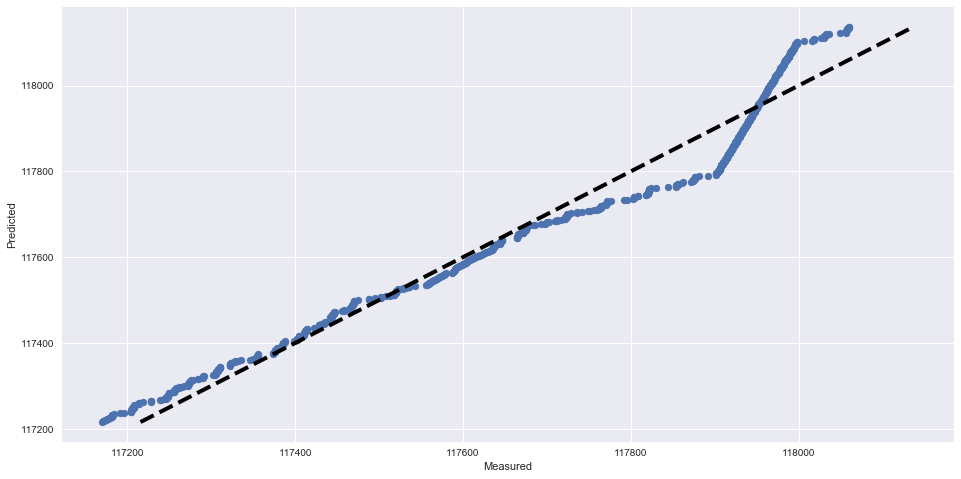

RMSE score: 47.9968991514
R2 score: 0.968548445027
---------------------------------------------------------------------------
Plotting for Meter 3849
Time series plot of the actual and predicted hourly meter readings


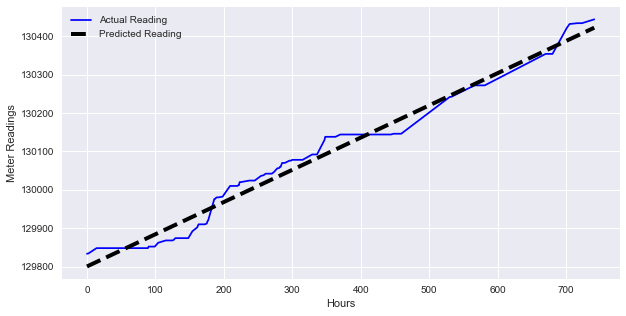

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


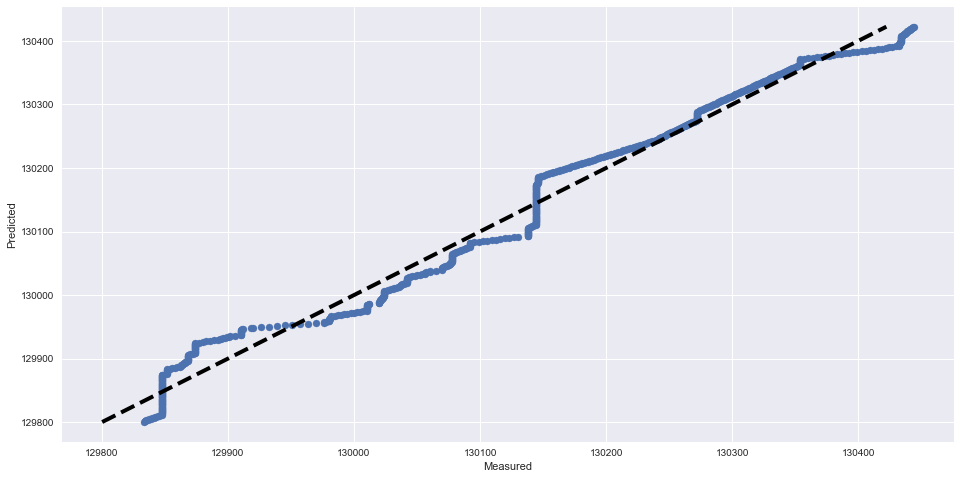

RMSE score: 23.5243979501
R2 score: 0.983026541236
---------------------------------------------------------------------------
Plotting for Meter 3893
Time series plot of the actual and predicted hourly meter readings


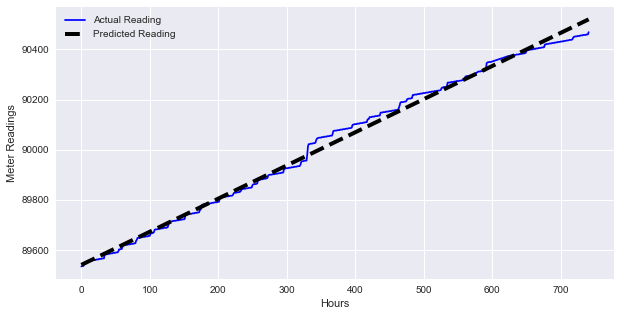

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


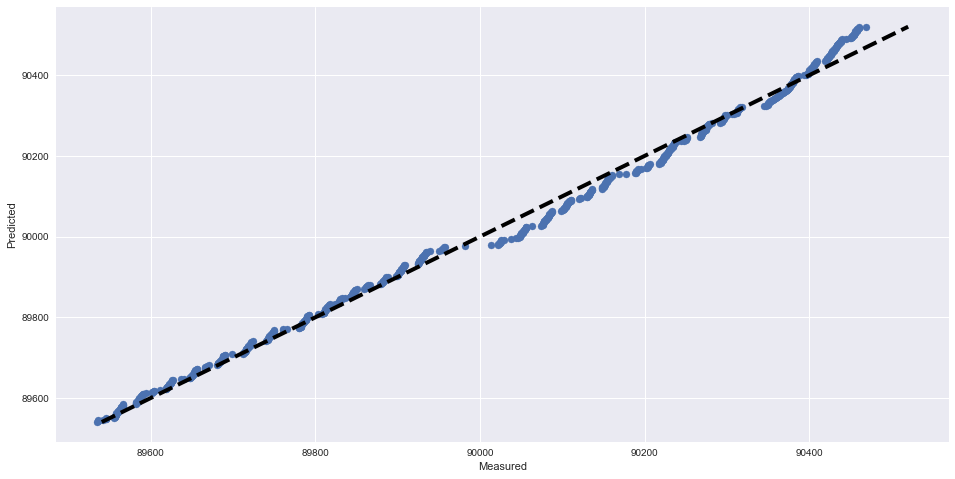

RMSE score: 21.6558509065
R2 score: 0.994193219458
---------------------------------------------------------------------------
Plotting for Meter 4029
Time series plot of the actual and predicted hourly meter readings


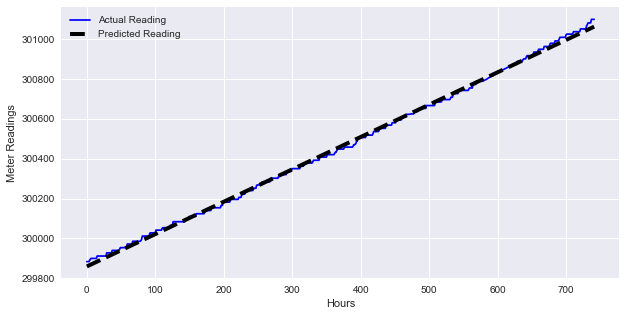

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


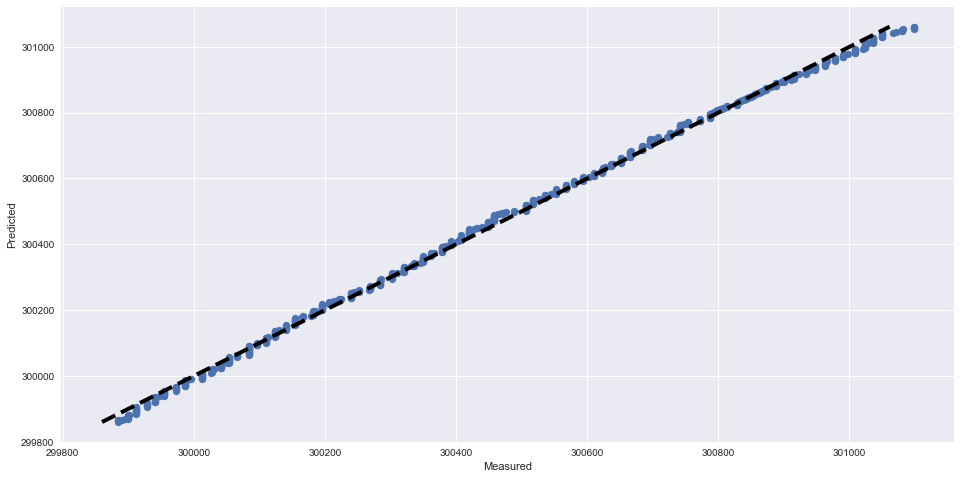

RMSE score: 12.4791369219
R2 score: 0.998710651698
---------------------------------------------------------------------------
Plotting for Meter 4031
Time series plot of the actual and predicted hourly meter readings


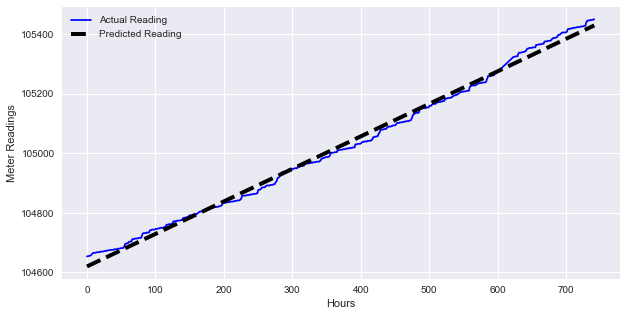

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


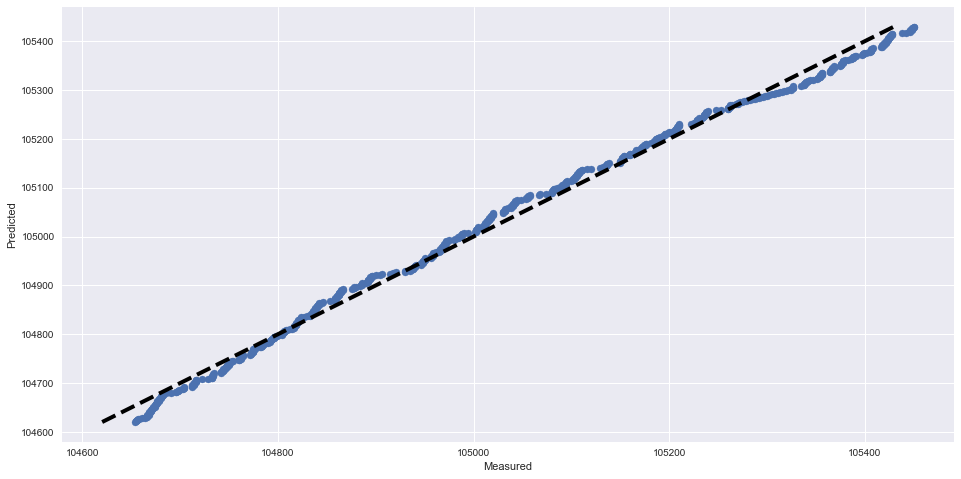

RMSE score: 16.7976746093
R2 score: 0.994882360227
---------------------------------------------------------------------------
Plotting for Meter 4193
Time series plot of the actual and predicted hourly meter readings


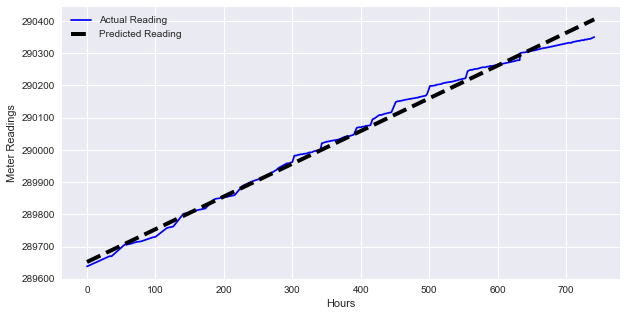

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


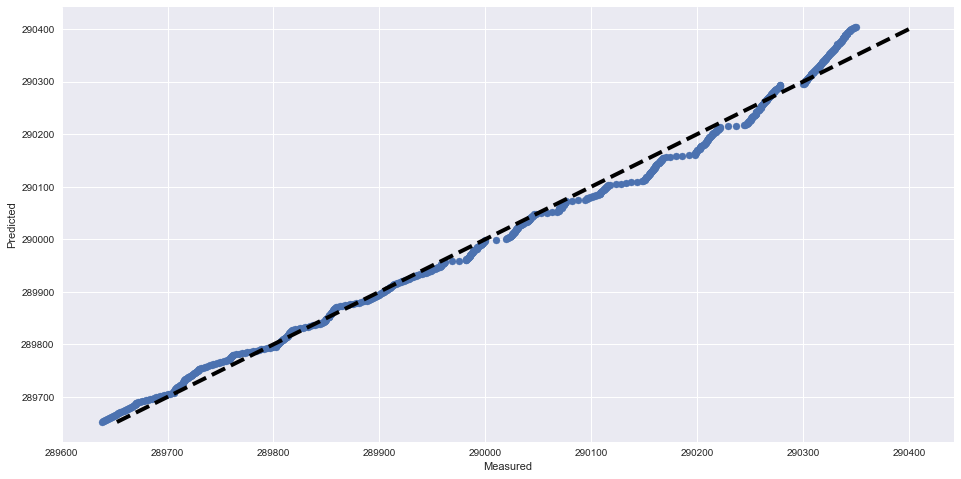

RMSE score: 18.472394353
R2 score: 0.992853922938
---------------------------------------------------------------------------
Plotting for Meter 4228
Time series plot of the actual and predicted hourly meter readings


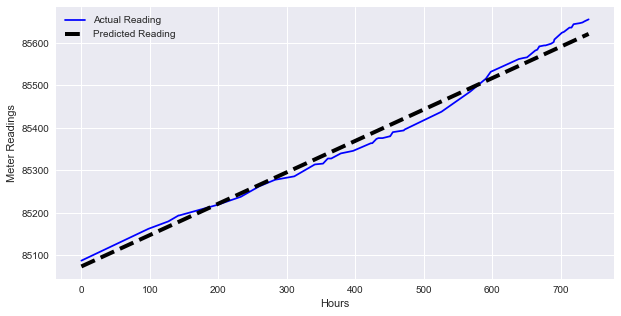

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


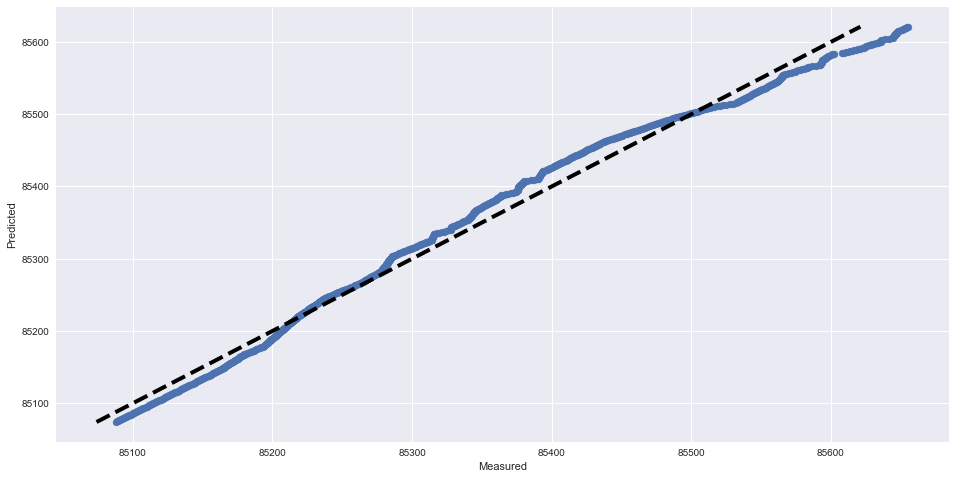

RMSE score: 17.6625919996
R2 score: 0.987691394693
---------------------------------------------------------------------------
Plotting for Meter 4296
Time series plot of the actual and predicted hourly meter readings


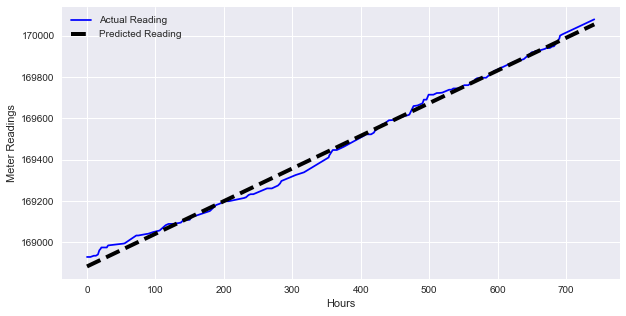

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


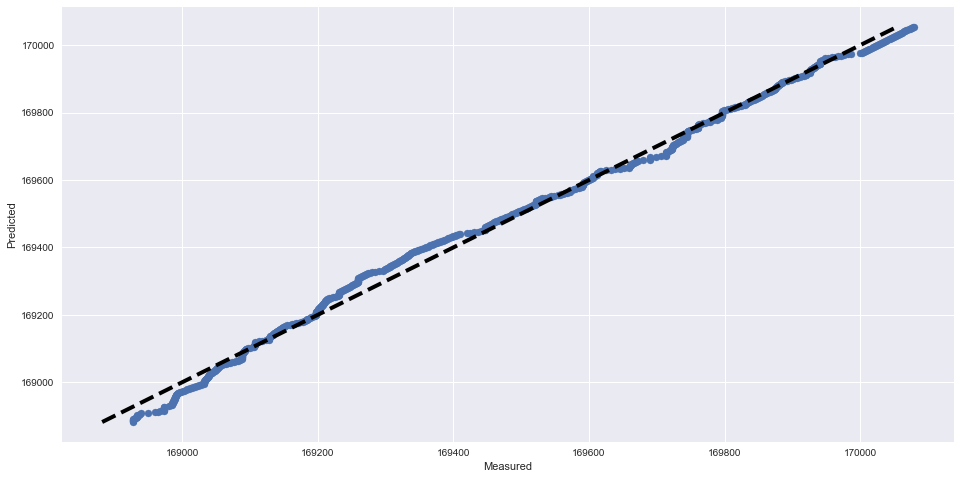

RMSE score: 23.8830580923
R2 score: 0.995055363364
---------------------------------------------------------------------------
Plotting for Meter 4352
Time series plot of the actual and predicted hourly meter readings


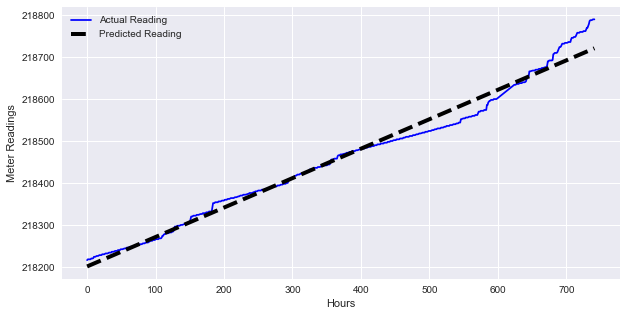

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


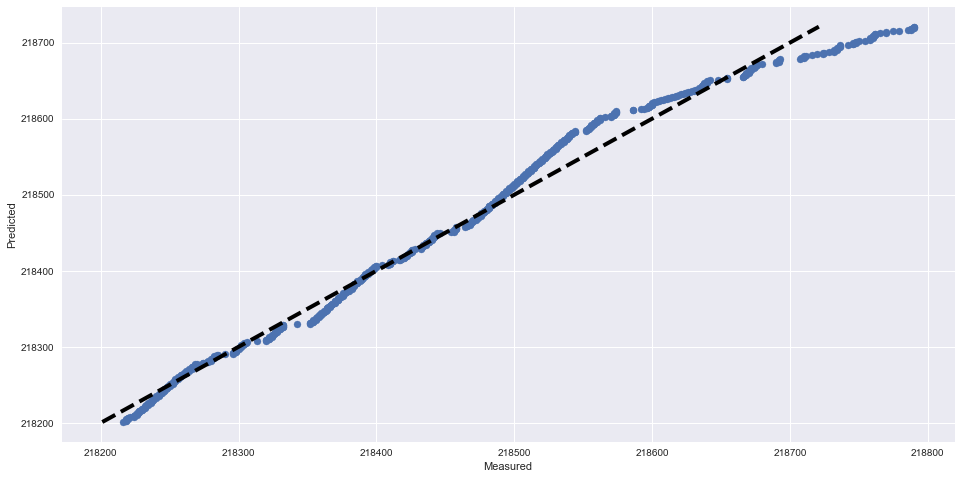

RMSE score: 20.6488639456
R2 score: 0.981384587524
---------------------------------------------------------------------------
Plotting for Meter 4356
Time series plot of the actual and predicted hourly meter readings


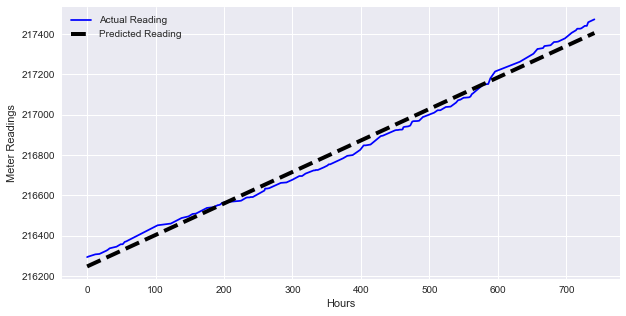

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


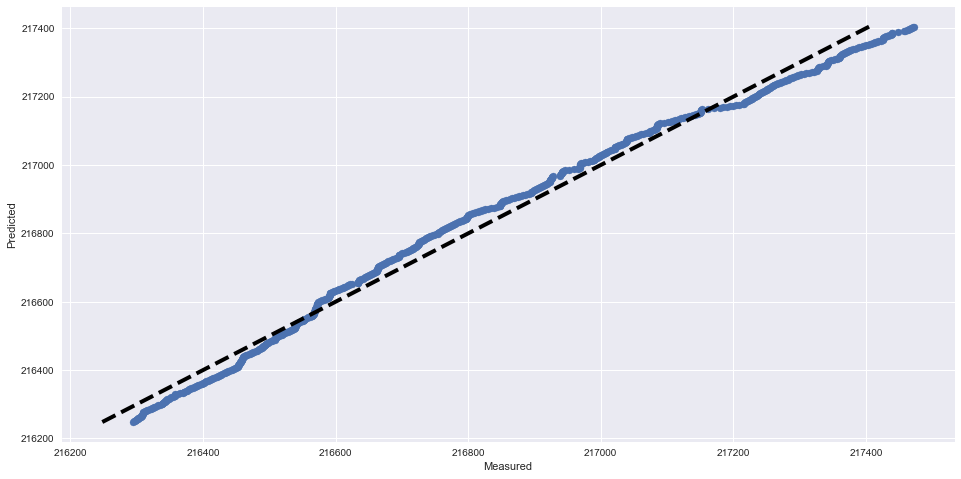

RMSE score: 35.0876597337
R2 score: 0.989129452226
---------------------------------------------------------------------------
Plotting for Meter 4373
Time series plot of the actual and predicted hourly meter readings


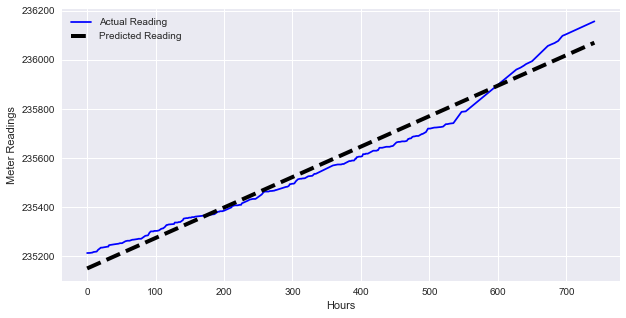

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


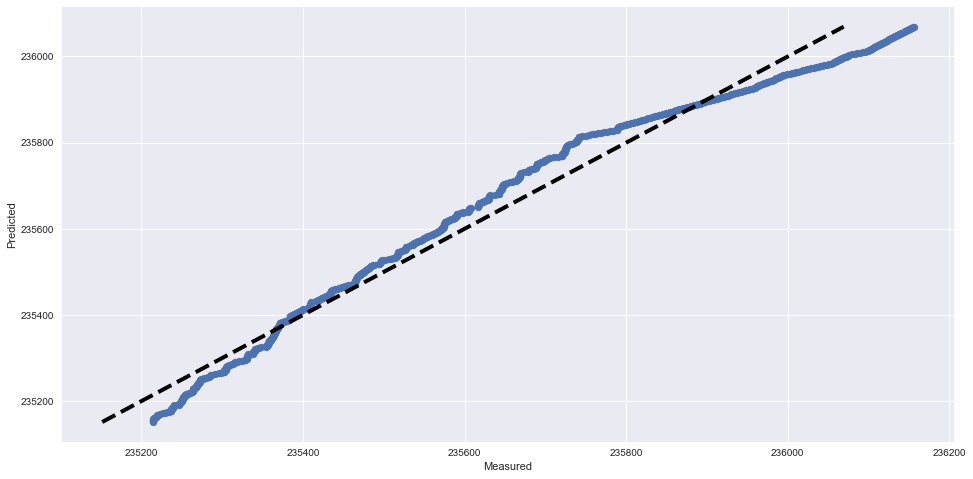

RMSE score: 43.6250634715
R2 score: 0.973688935002
---------------------------------------------------------------------------
Plotting for Meter 4421
Time series plot of the actual and predicted hourly meter readings


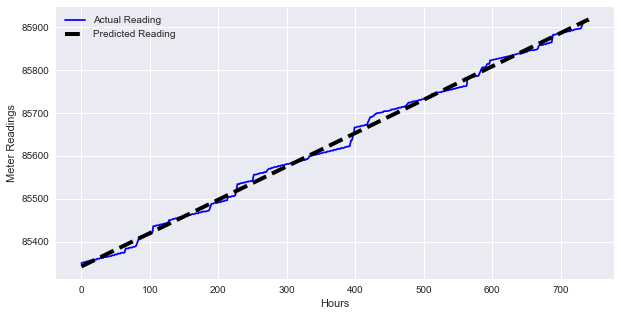

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


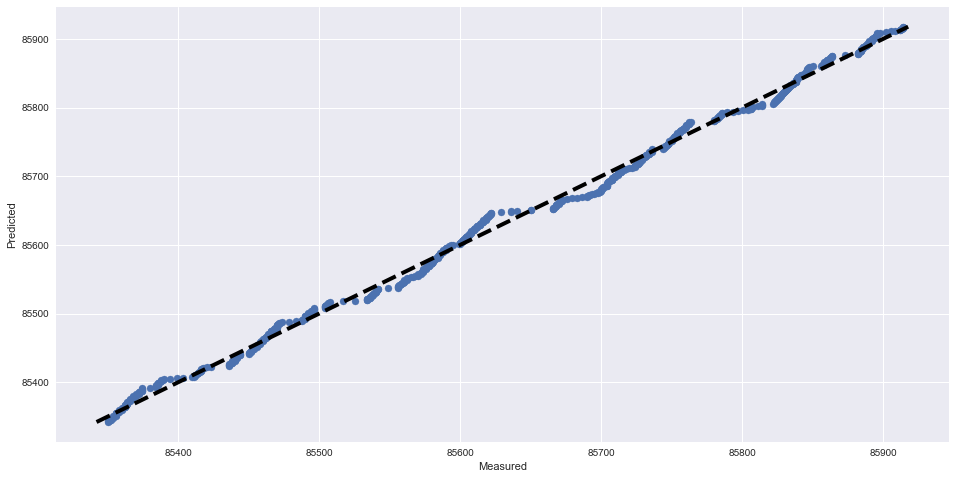

RMSE score: 9.50882663982
R2 score: 0.996751233609
---------------------------------------------------------------------------
Plotting for Meter 4447
Time series plot of the actual and predicted hourly meter readings


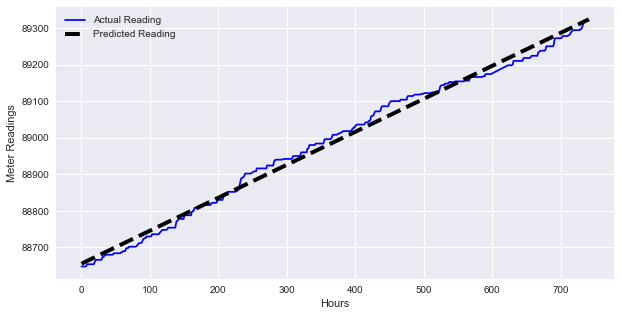

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


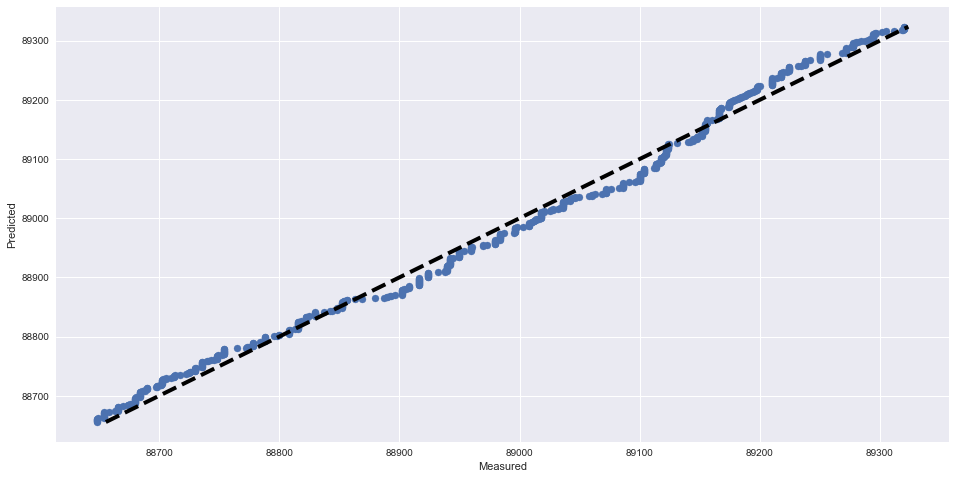

RMSE score: 17.5342127813
R2 score: 0.991789491534
---------------------------------------------------------------------------
Plotting for Meter 4514
Time series plot of the actual and predicted hourly meter readings


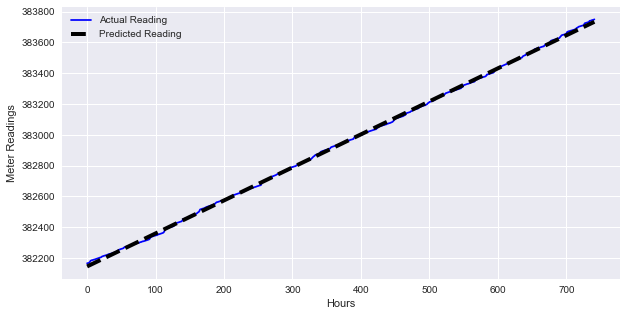

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


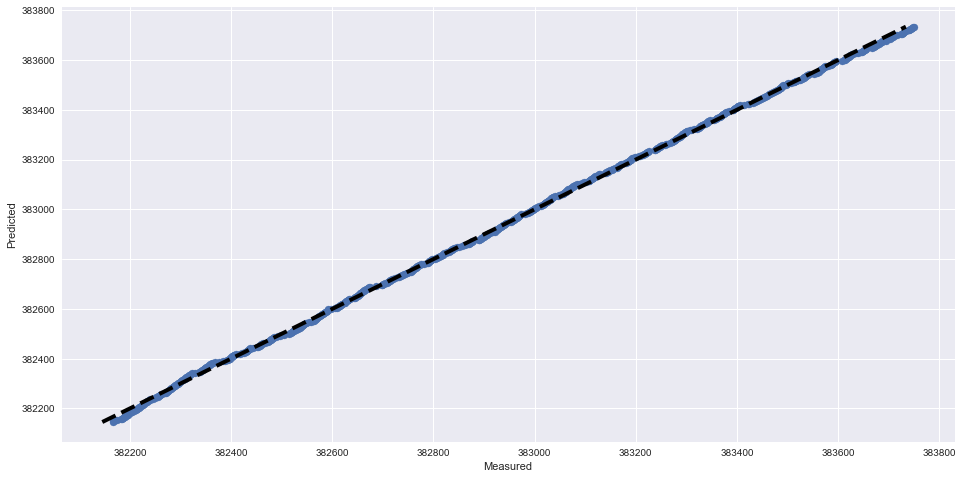

RMSE score: 9.0899750982
R2 score: 0.99960817874
---------------------------------------------------------------------------
Plotting for Meter 4671
Time series plot of the actual and predicted hourly meter readings


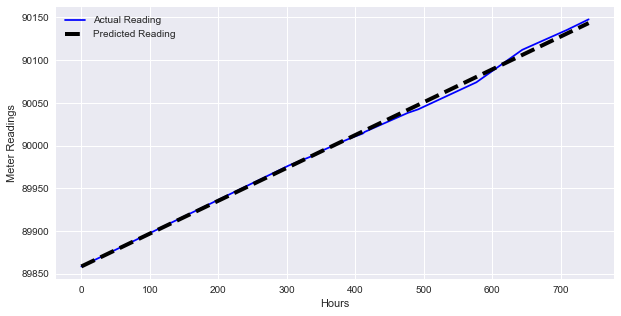

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


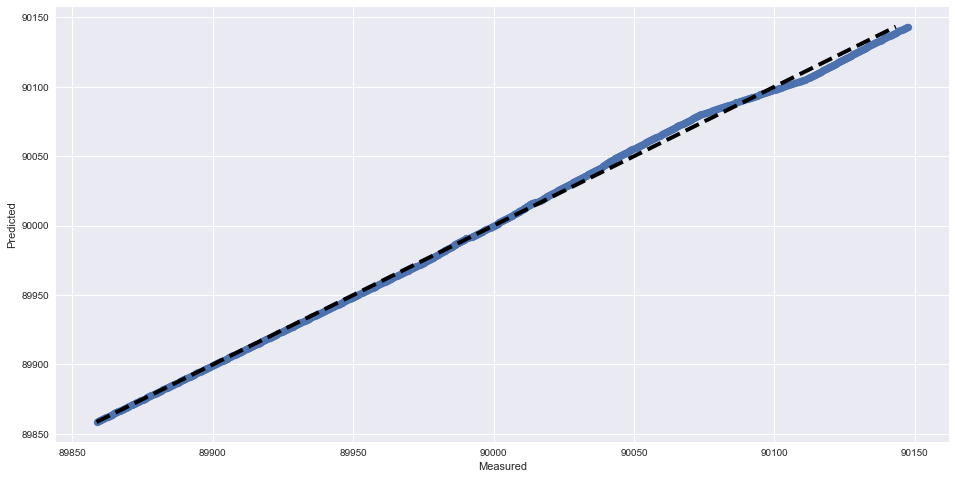

RMSE score: 3.09807254548
R2 score: 0.998585464097
---------------------------------------------------------------------------
Plotting for Meter 4732
Time series plot of the actual and predicted hourly meter readings


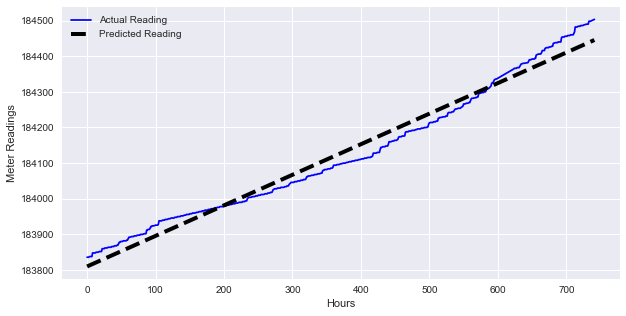

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


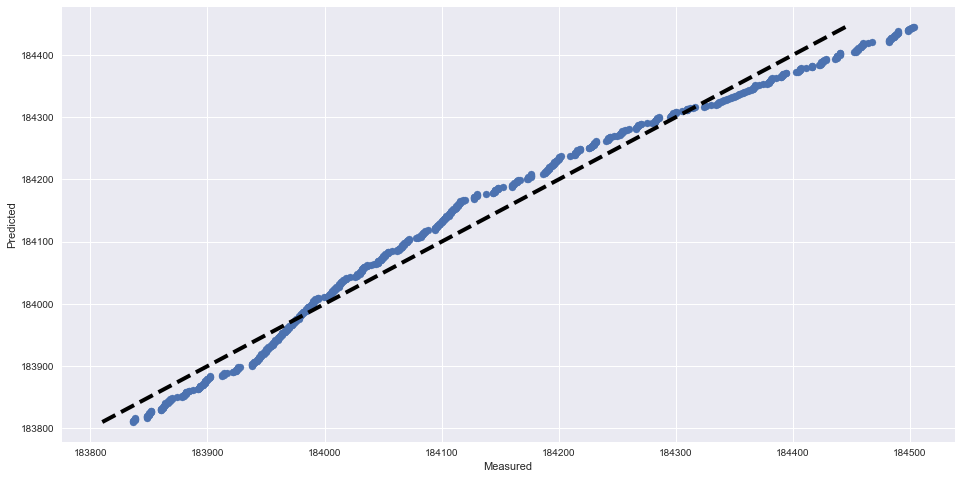

RMSE score: 28.4306145374
R2 score: 0.976636300494
---------------------------------------------------------------------------
Plotting for Meter 4767
Time series plot of the actual and predicted hourly meter readings


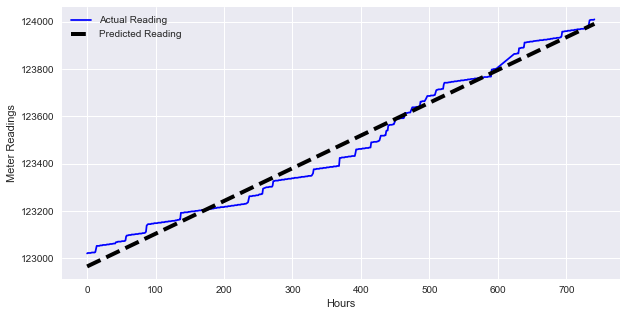

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


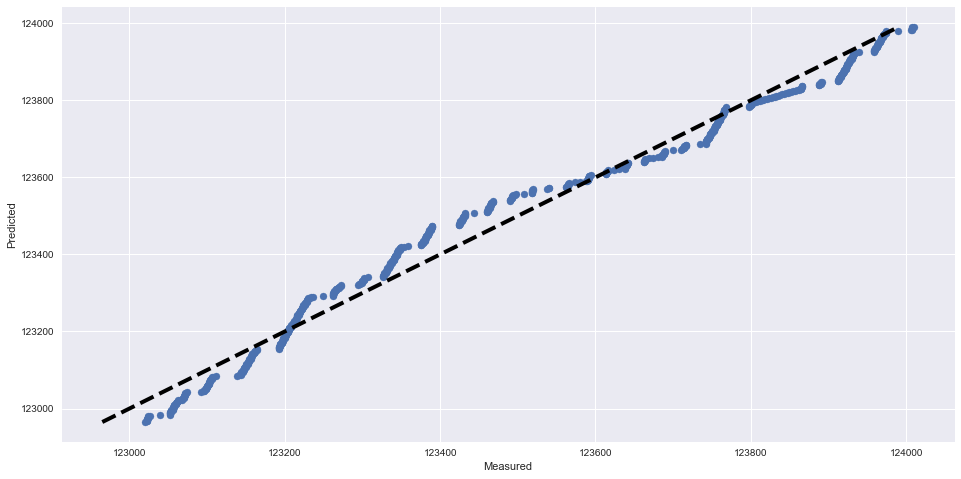

RMSE score: 39.3182488205
R2 score: 0.982812609074
---------------------------------------------------------------------------
Plotting for Meter 4998
Time series plot of the actual and predicted hourly meter readings


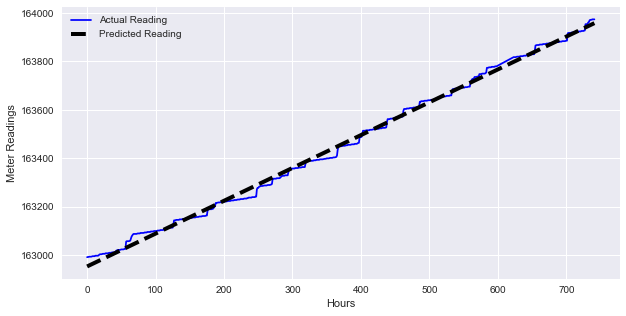

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


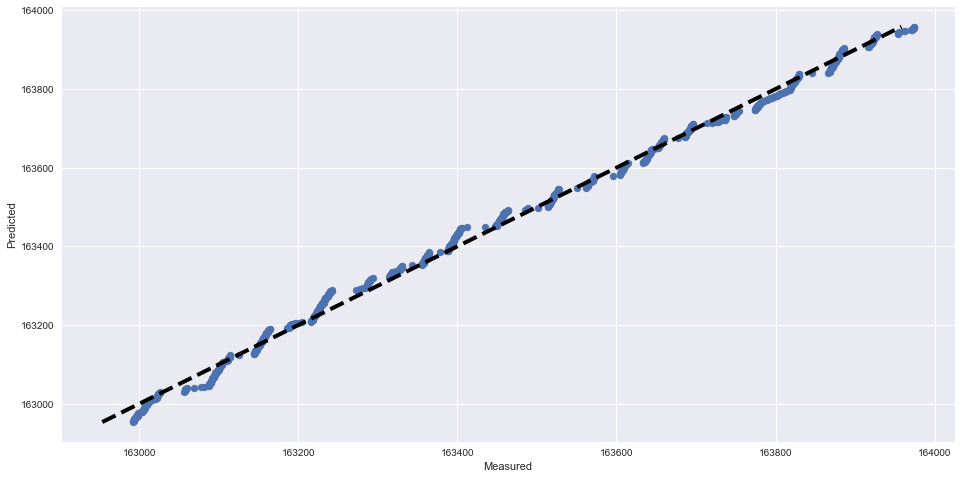

RMSE score: 16.9492645804
R2 score: 0.996613379292
---------------------------------------------------------------------------
Plotting for Meter 5129
Time series plot of the actual and predicted hourly meter readings


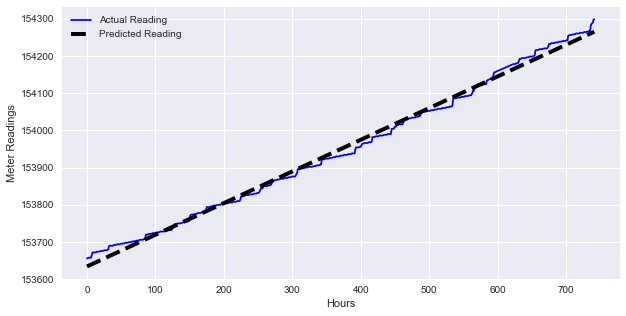

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


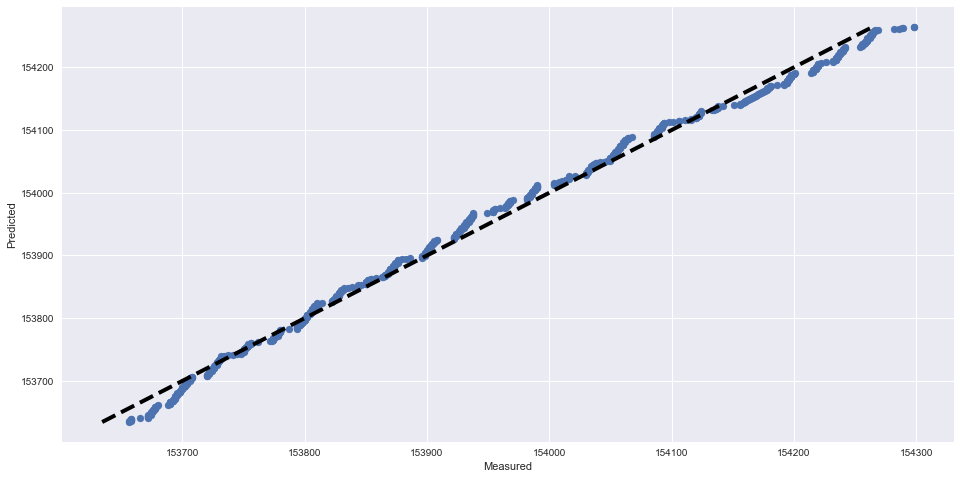

RMSE score: 13.4343097641
R2 score: 0.994600258443
---------------------------------------------------------------------------
Plotting for Meter 5131
Time series plot of the actual and predicted hourly meter readings


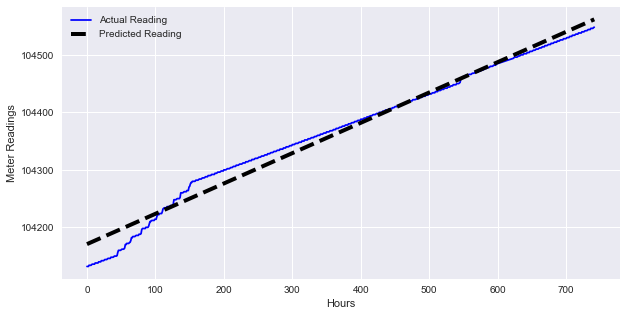

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


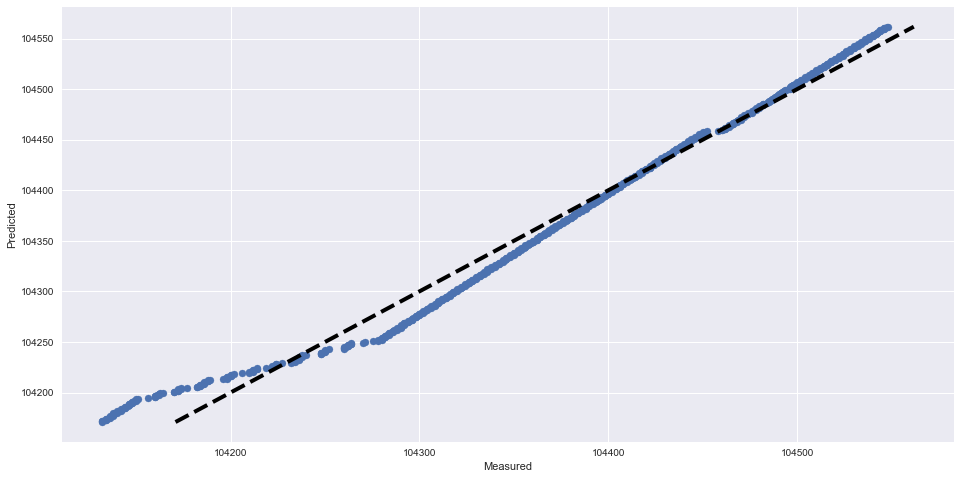

RMSE score: 16.644395376
R2 score: 0.978825670059
---------------------------------------------------------------------------
Plotting for Meter 5193
Time series plot of the actual and predicted hourly meter readings


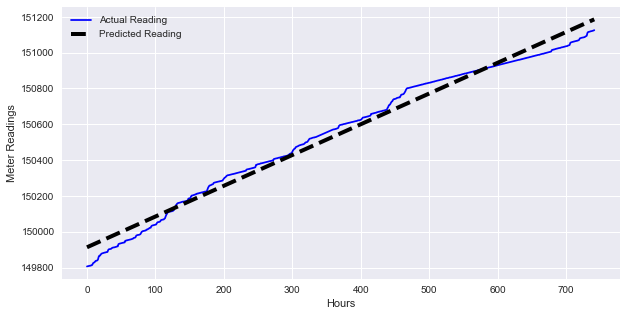

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


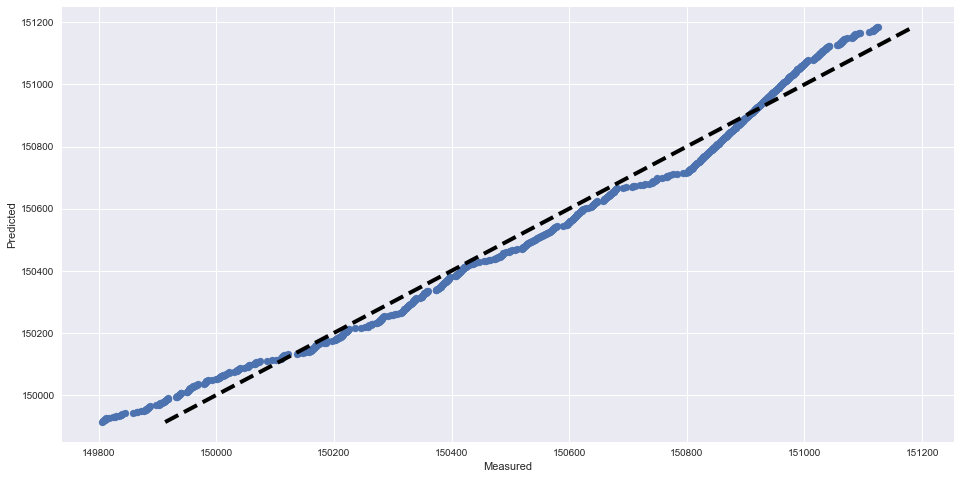

RMSE score: 47.9779826218
R2 score: 0.983301329747
---------------------------------------------------------------------------
Plotting for Meter 5275
Time series plot of the actual and predicted hourly meter readings


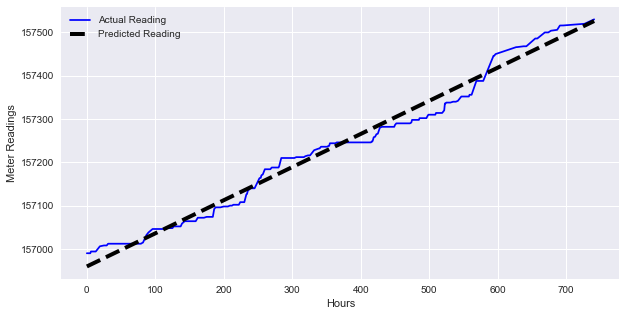

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


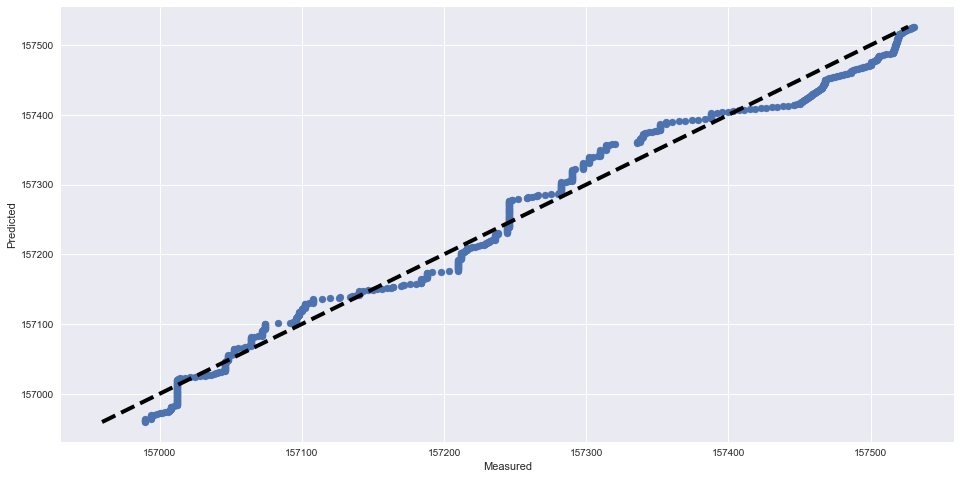

RMSE score: 20.768351187
R2 score: 0.98420631741
---------------------------------------------------------------------------
Plotting for Meter 5395
Time series plot of the actual and predicted hourly meter readings


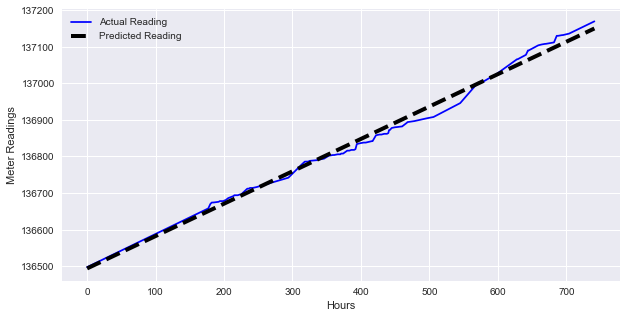

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


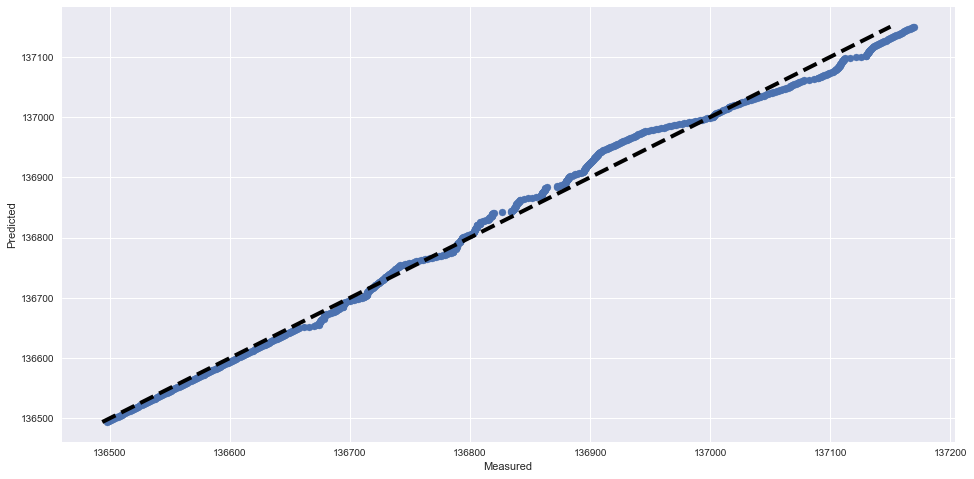

RMSE score: 15.0099305728
R2 score: 0.993778769975
---------------------------------------------------------------------------
Plotting for Meter 5403
Time series plot of the actual and predicted hourly meter readings


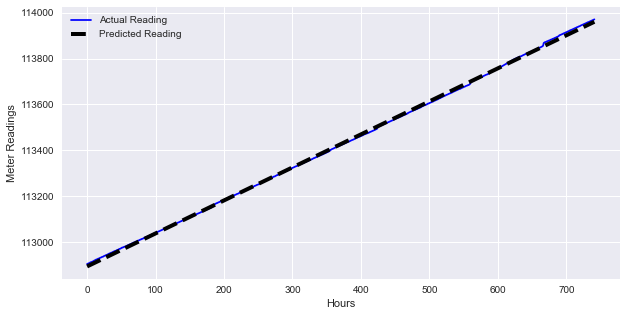

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


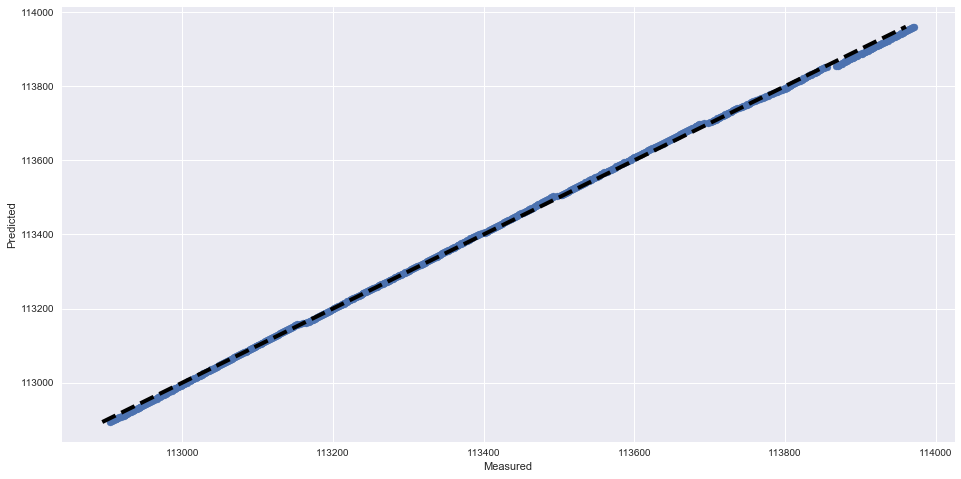

RMSE score: 6.58990962258
R2 score: 0.999543204089
---------------------------------------------------------------------------
Plotting for Meter 5439
Time series plot of the actual and predicted hourly meter readings


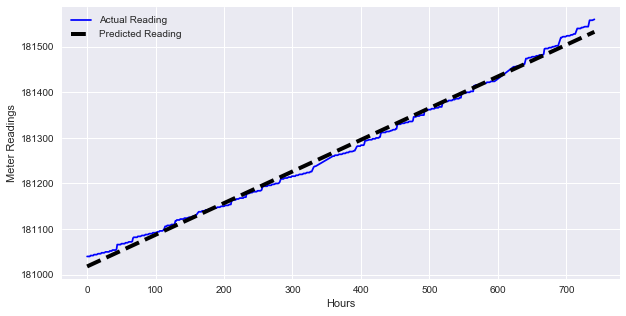

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


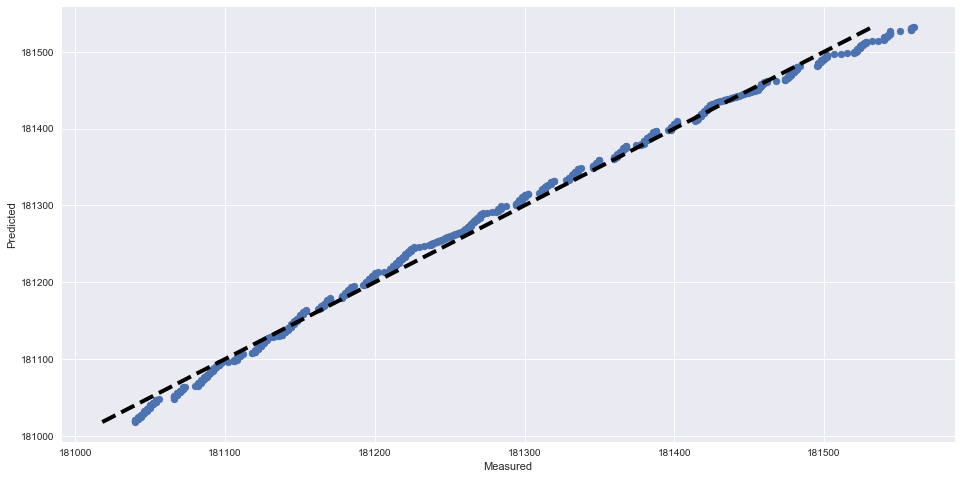

RMSE score: 10.4275006912
R2 score: 0.995099718908
---------------------------------------------------------------------------
Plotting for Meter 5484
Time series plot of the actual and predicted hourly meter readings


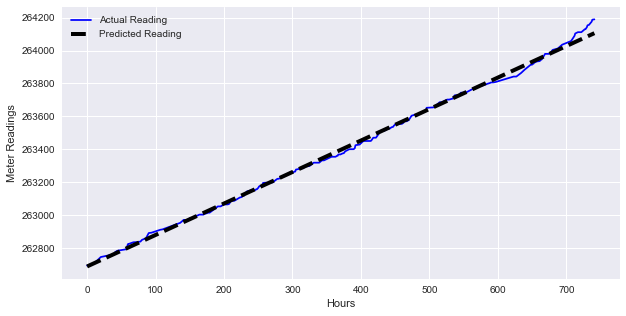

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


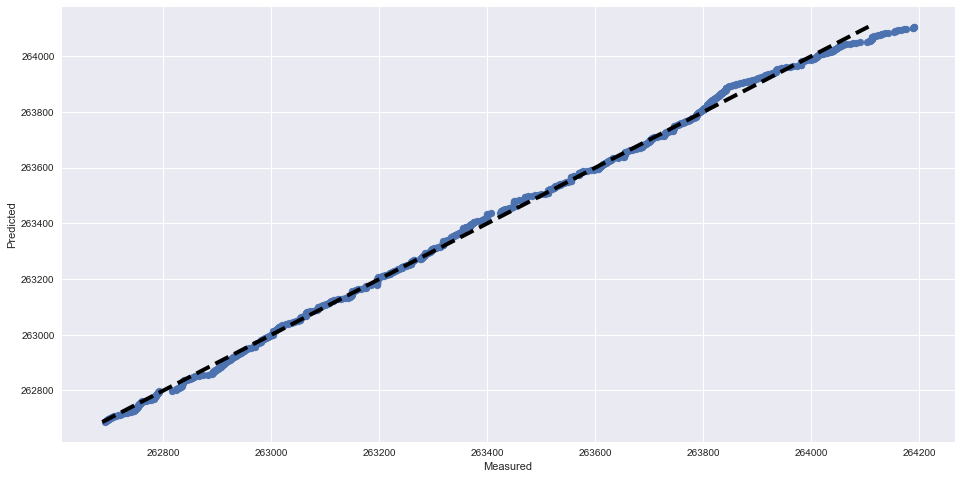

RMSE score: 18.6467426025
R2 score: 0.997937787578
---------------------------------------------------------------------------
Plotting for Meter 5636
Time series plot of the actual and predicted hourly meter readings


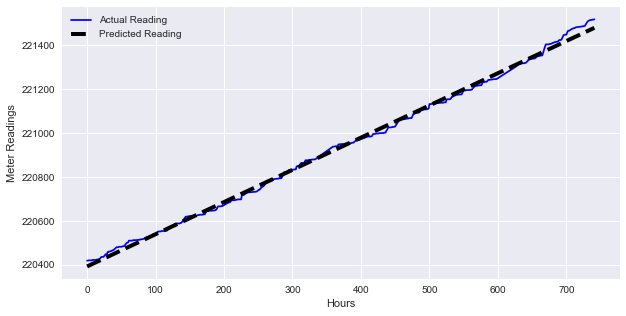

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


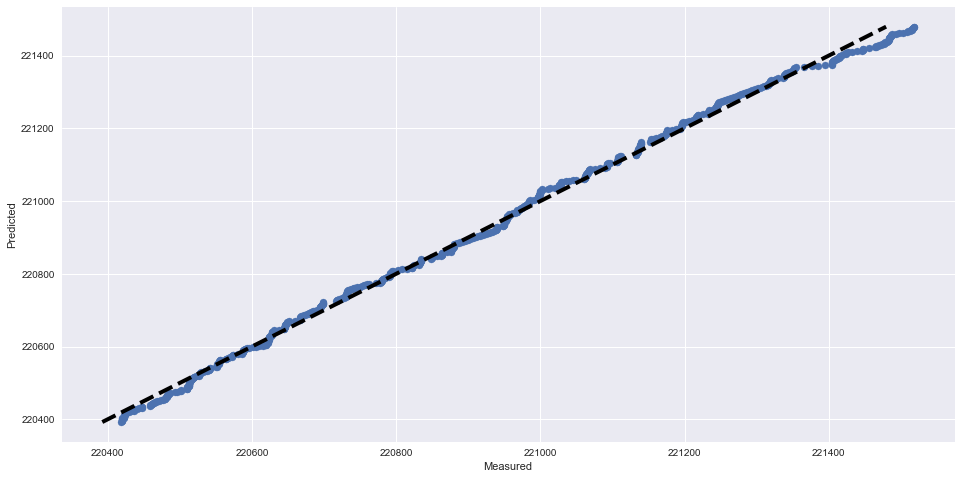

RMSE score: 15.8138207317
R2 score: 0.997470727259
---------------------------------------------------------------------------
Plotting for Meter 5785
Time series plot of the actual and predicted hourly meter readings


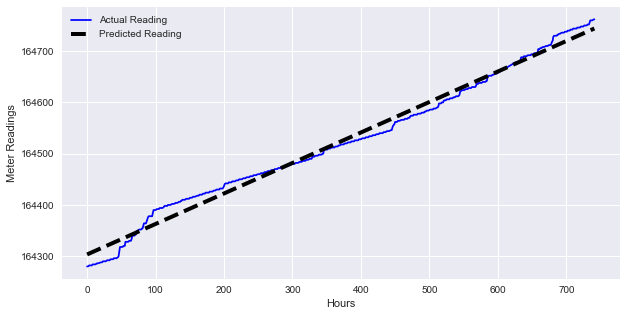

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


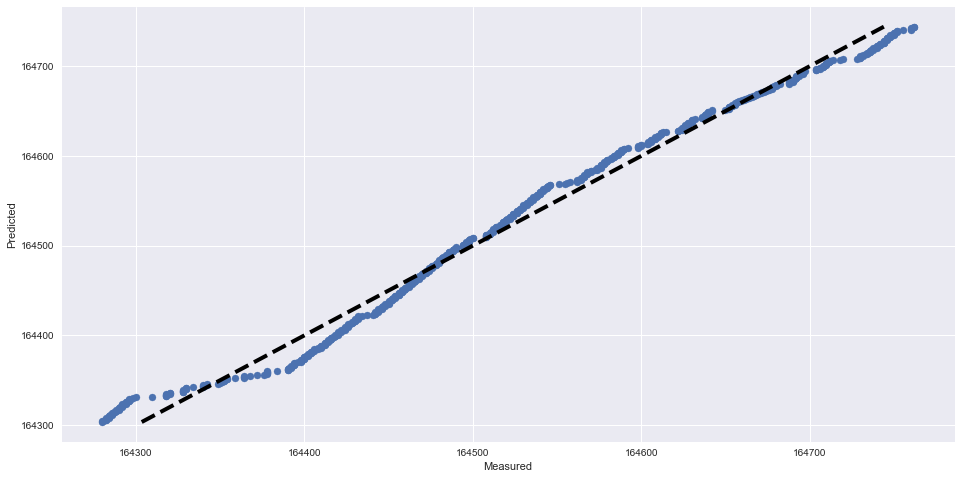

RMSE score: 14.7055478562
R2 score: 0.986918492338
---------------------------------------------------------------------------
Plotting for Meter 5810
Time series plot of the actual and predicted hourly meter readings


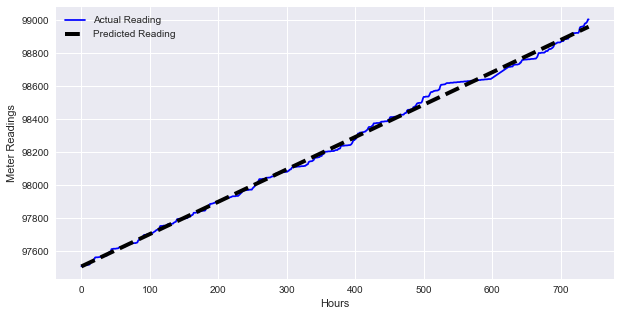

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


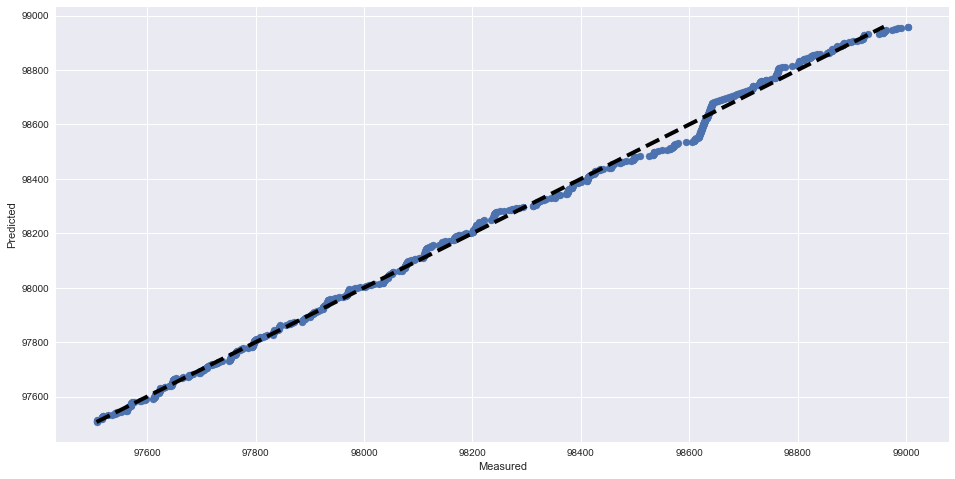

RMSE score: 20.837487422
R2 score: 0.997540501415
---------------------------------------------------------------------------
Plotting for Meter 5814
Time series plot of the actual and predicted hourly meter readings


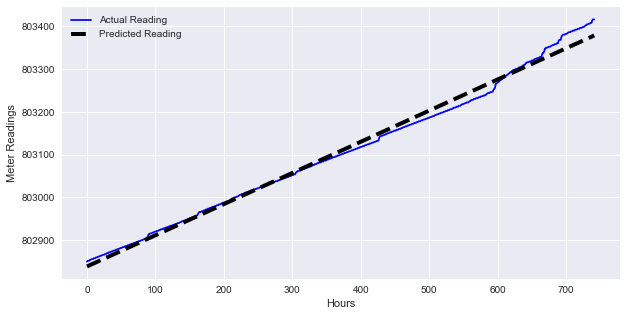

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


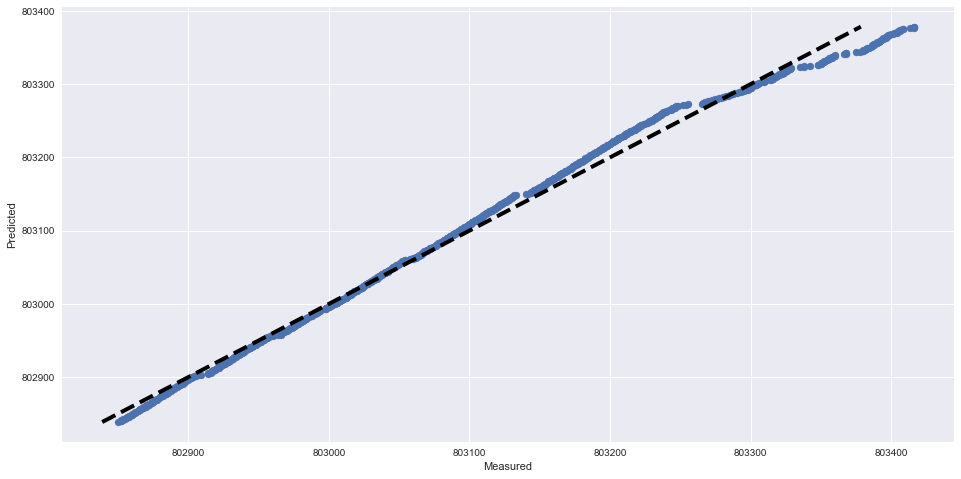

RMSE score: 13.8229983135
R2 score: 0.992197294401
---------------------------------------------------------------------------
Plotting for Meter 5892
Time series plot of the actual and predicted hourly meter readings


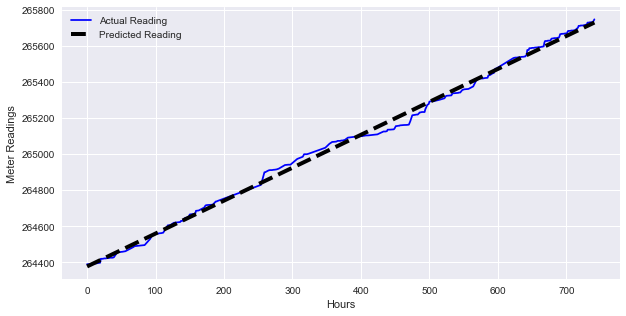

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


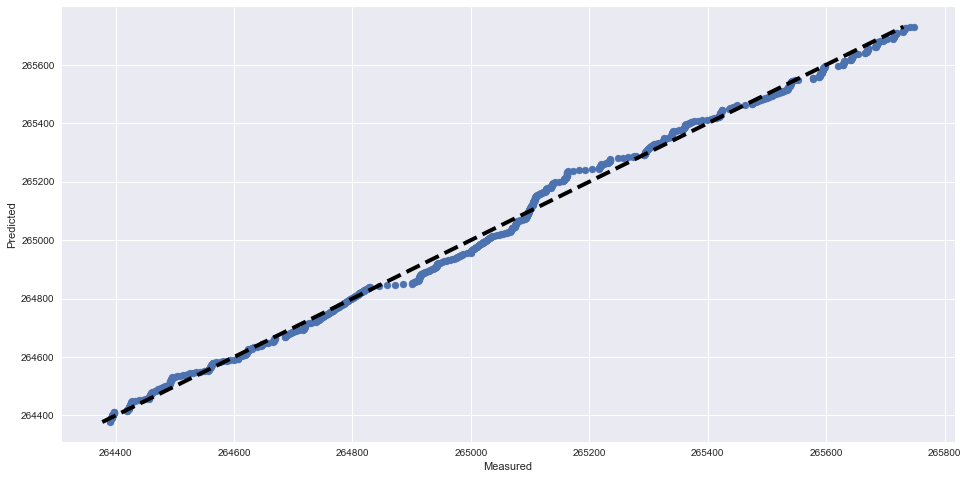

RMSE score: 24.074638526
R2 score: 0.996226164064
---------------------------------------------------------------------------
Plotting for Meter 5972
Time series plot of the actual and predicted hourly meter readings


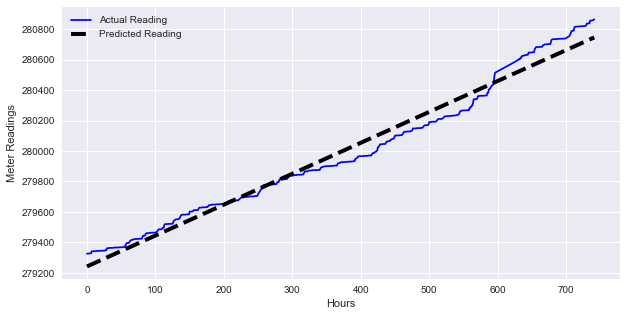

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


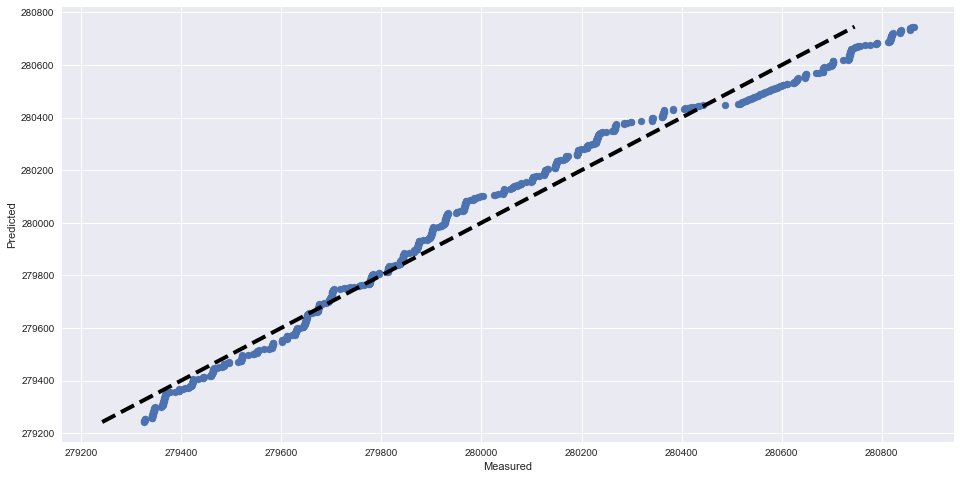

RMSE score: 66.3400230754
R2 score: 0.977335173145
---------------------------------------------------------------------------
Plotting for Meter 6412
Time series plot of the actual and predicted hourly meter readings


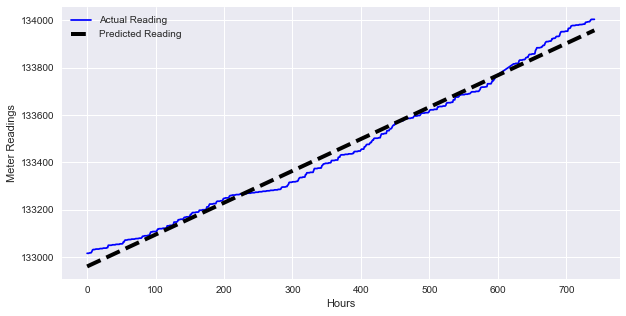

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


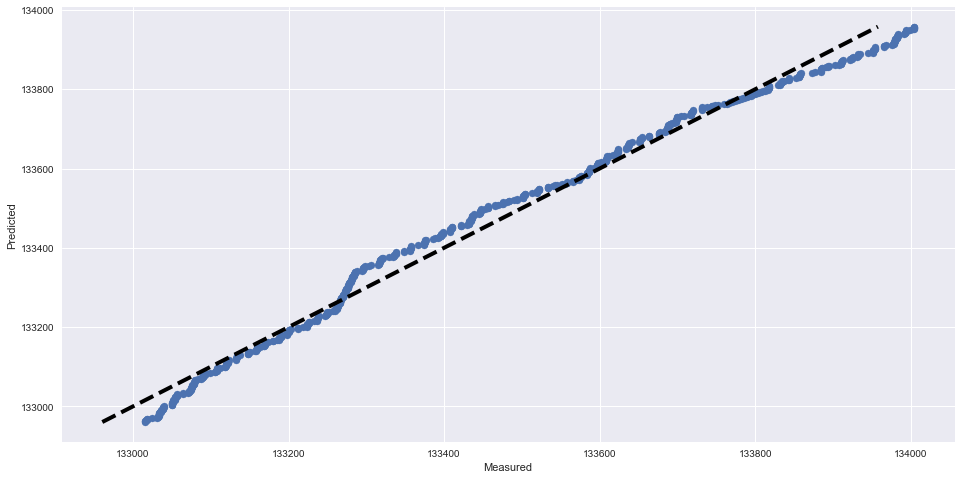

RMSE score: 31.391083637
R2 score: 0.988275436841
---------------------------------------------------------------------------
Plotting for Meter 6505
Time series plot of the actual and predicted hourly meter readings


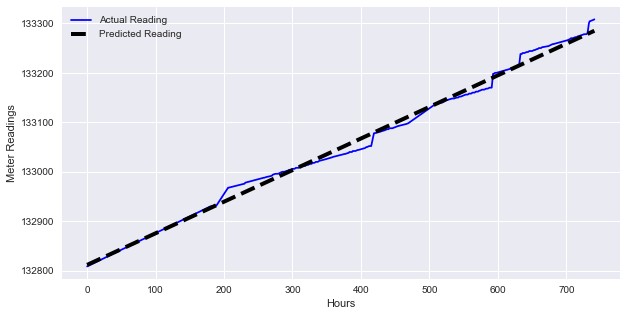

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


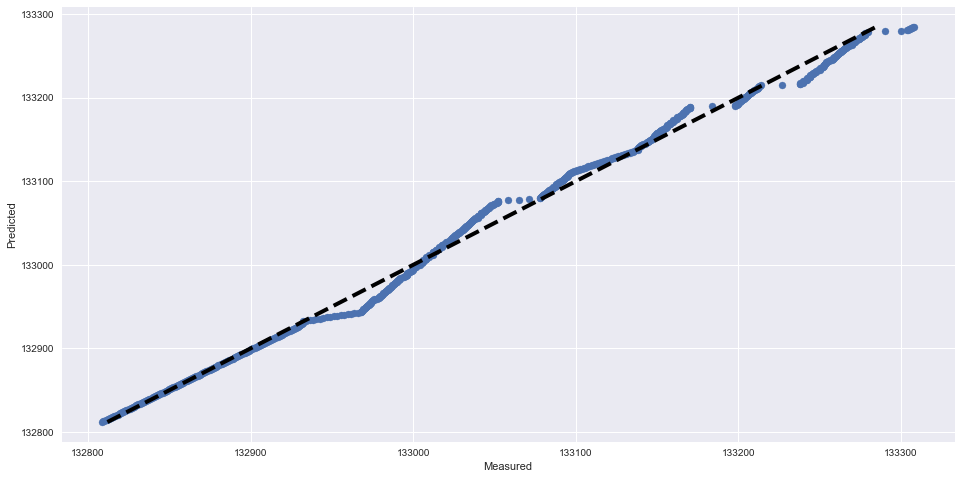

RMSE score: 10.5140836343
R2 score: 0.994142709217
---------------------------------------------------------------------------
Plotting for Meter 6578
Time series plot of the actual and predicted hourly meter readings


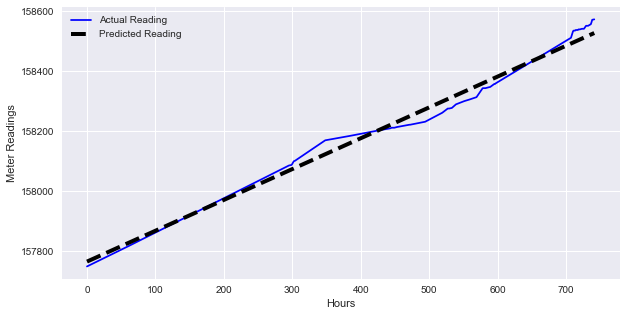

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


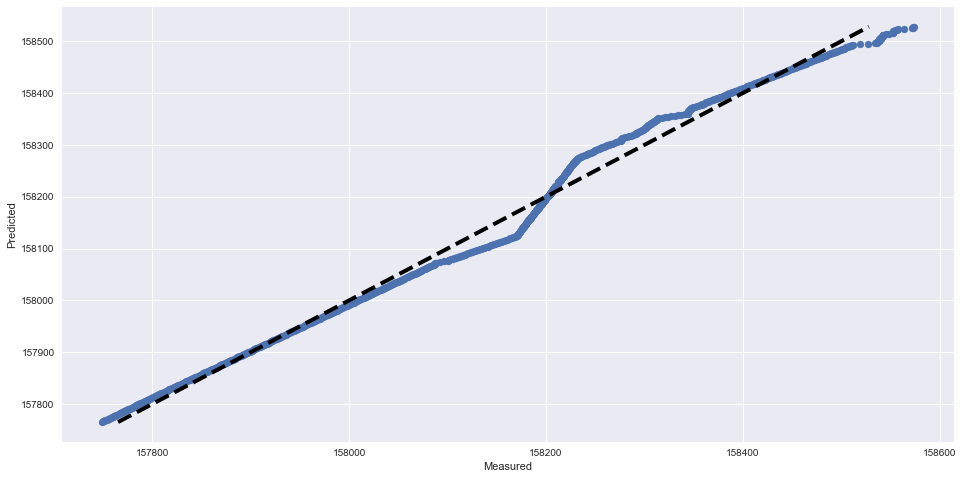

RMSE score: 21.7741262694
R2 score: 0.990311568489
---------------------------------------------------------------------------
Plotting for Meter 6830
Time series plot of the actual and predicted hourly meter readings


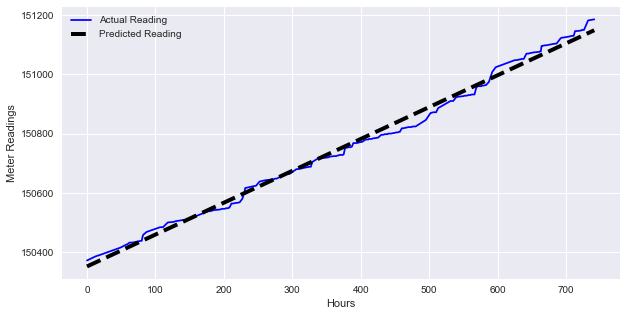

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


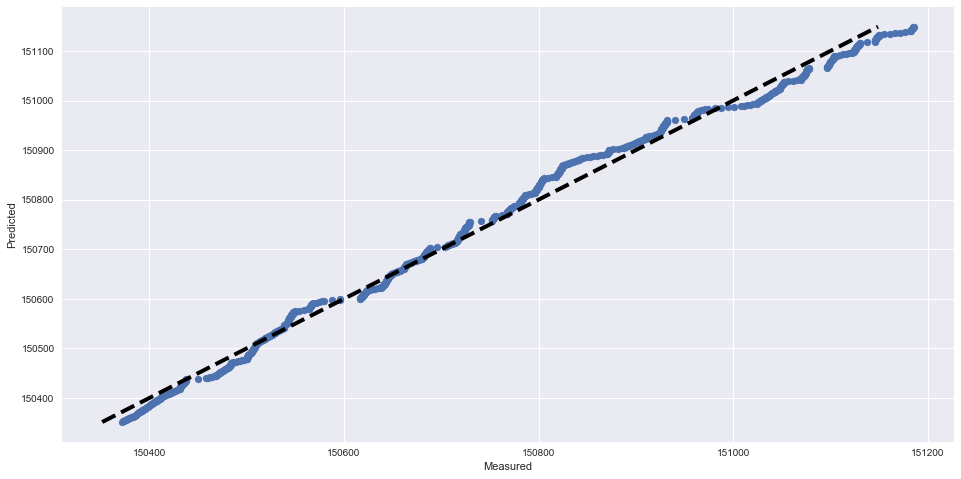

RMSE score: 19.2683510501
R2 score: 0.993070396924
---------------------------------------------------------------------------
Plotting for Meter 6836
Time series plot of the actual and predicted hourly meter readings


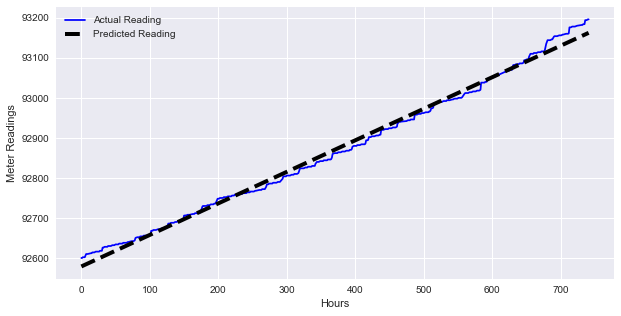

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


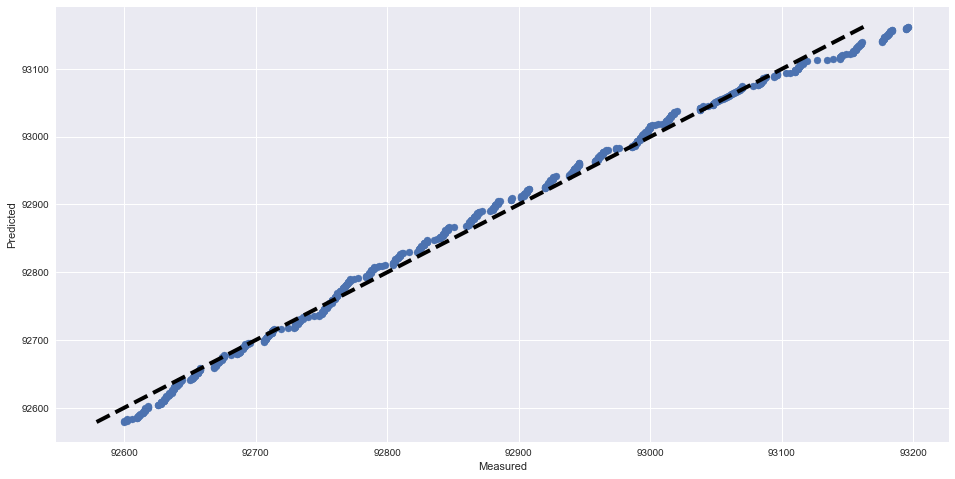

RMSE score: 13.5120964381
R2 score: 0.993615530369
---------------------------------------------------------------------------
Plotting for Meter 6863
Time series plot of the actual and predicted hourly meter readings


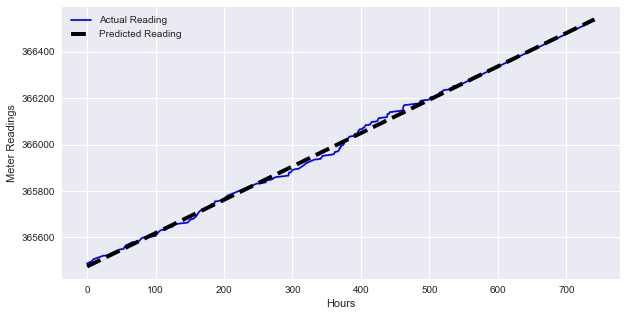

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


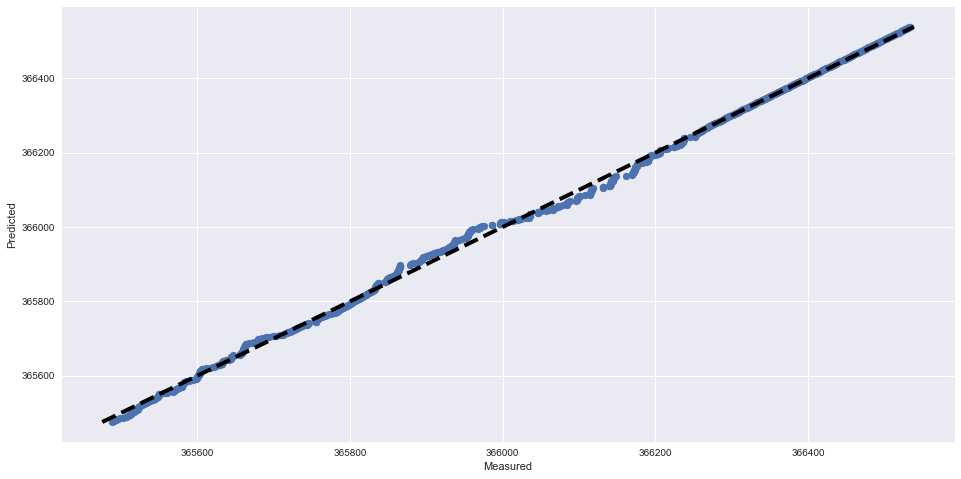

RMSE score: 12.1583033414
R2 score: 0.998437164027
---------------------------------------------------------------------------
Plotting for Meter 6910
Time series plot of the actual and predicted hourly meter readings


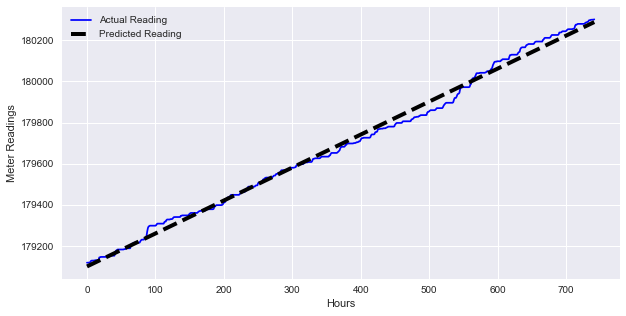

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


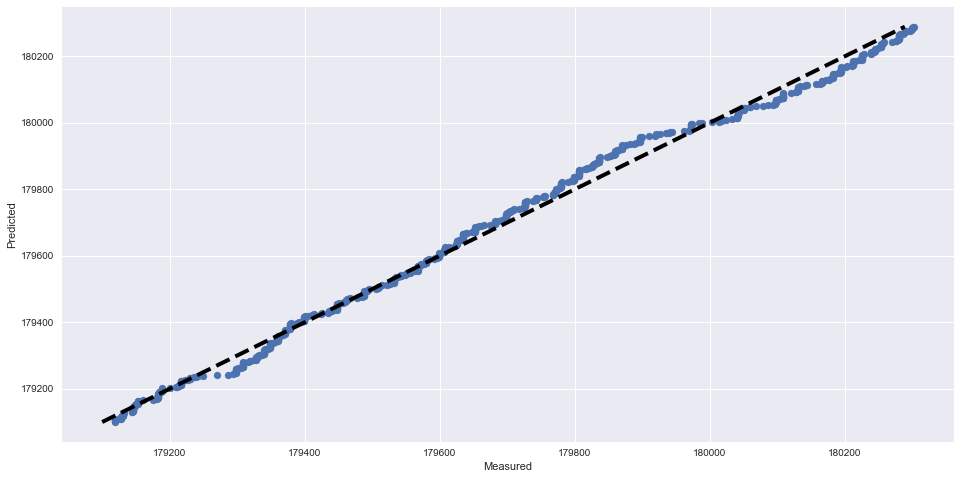

RMSE score: 26.7515857699
R2 score: 0.99399539821
---------------------------------------------------------------------------
Plotting for Meter 7017
Time series plot of the actual and predicted hourly meter readings


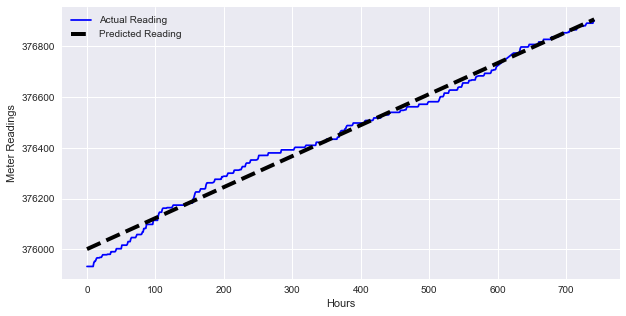

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


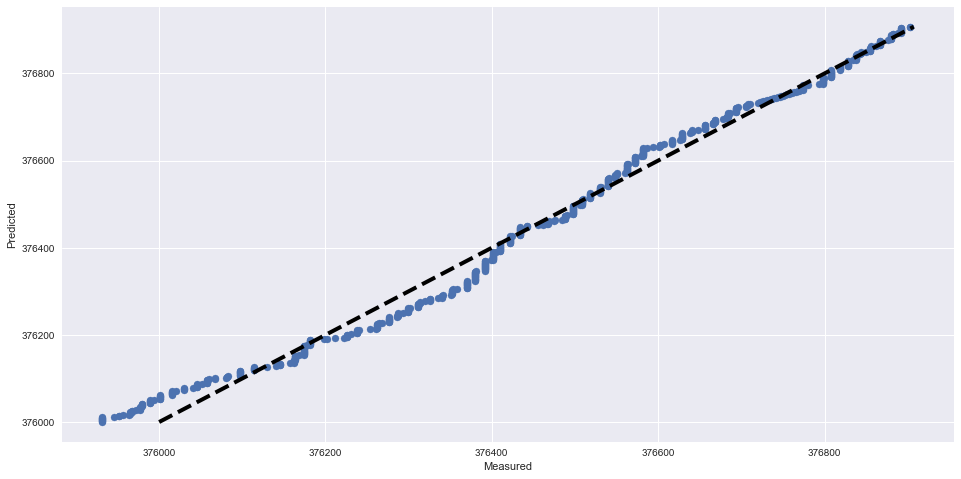

RMSE score: 29.7693120352
R2 score: 0.987284735929
---------------------------------------------------------------------------
Plotting for Meter 7030
Time series plot of the actual and predicted hourly meter readings


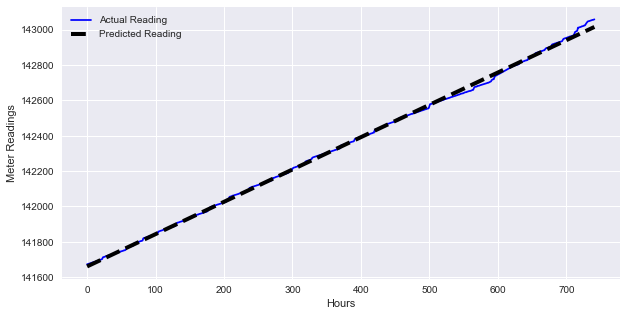

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


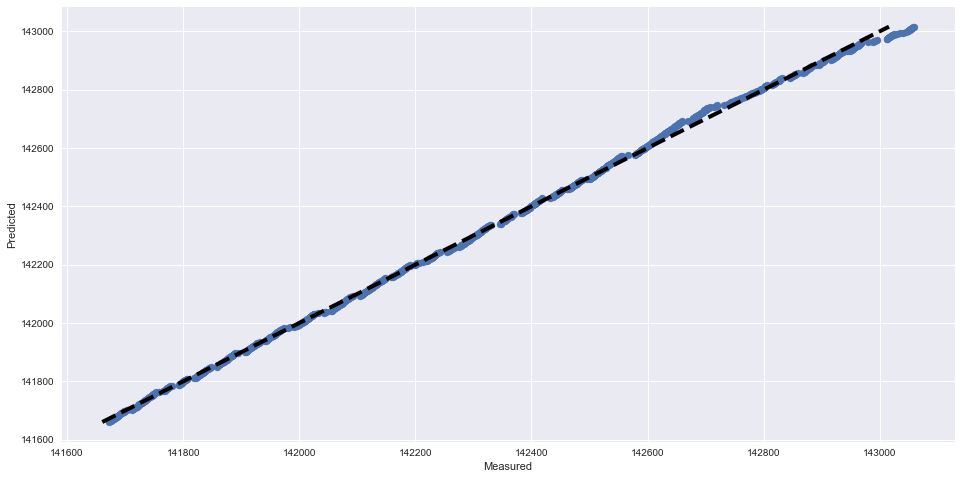

RMSE score: 12.3459533402
R2 score: 0.999007673499
---------------------------------------------------------------------------
Plotting for Meter 7117
Time series plot of the actual and predicted hourly meter readings


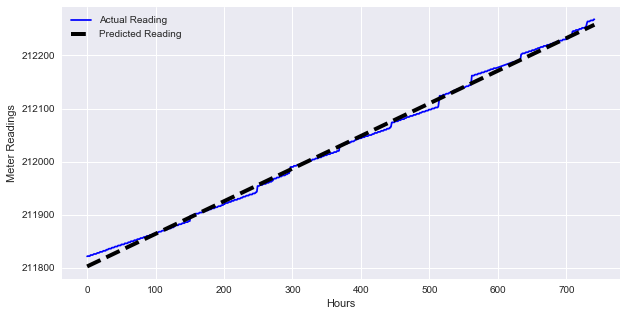

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


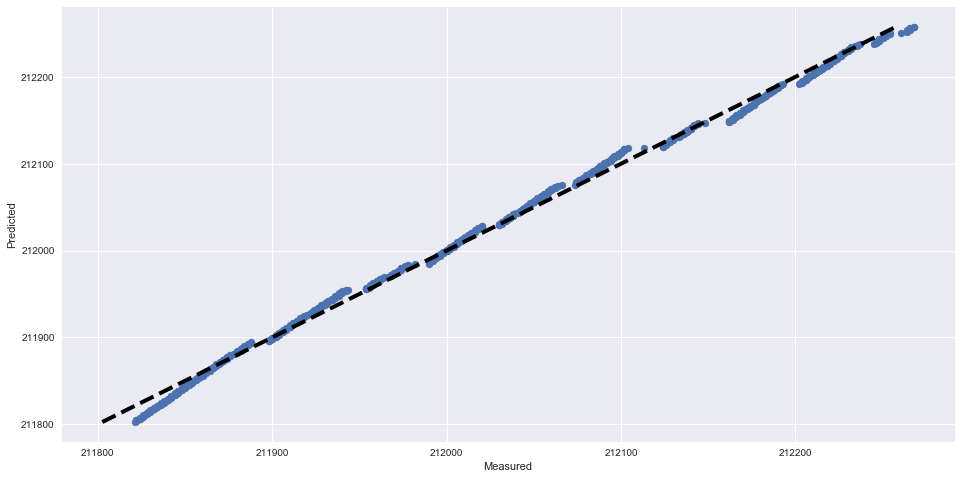

RMSE score: 7.11778211904
R2 score: 0.997081556261
---------------------------------------------------------------------------
Plotting for Meter 7287
Time series plot of the actual and predicted hourly meter readings


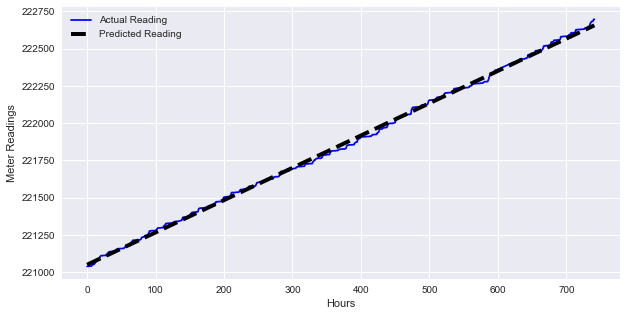

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


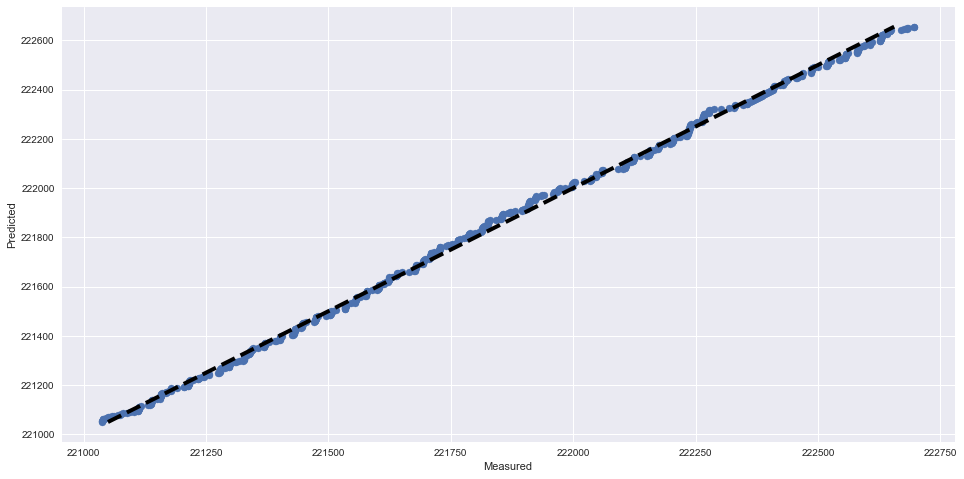

RMSE score: 16.2886758847
R2 score: 0.998772941557
---------------------------------------------------------------------------
Plotting for Meter 7429
Time series plot of the actual and predicted hourly meter readings


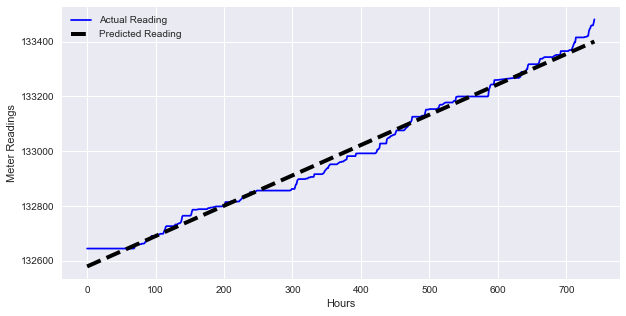

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


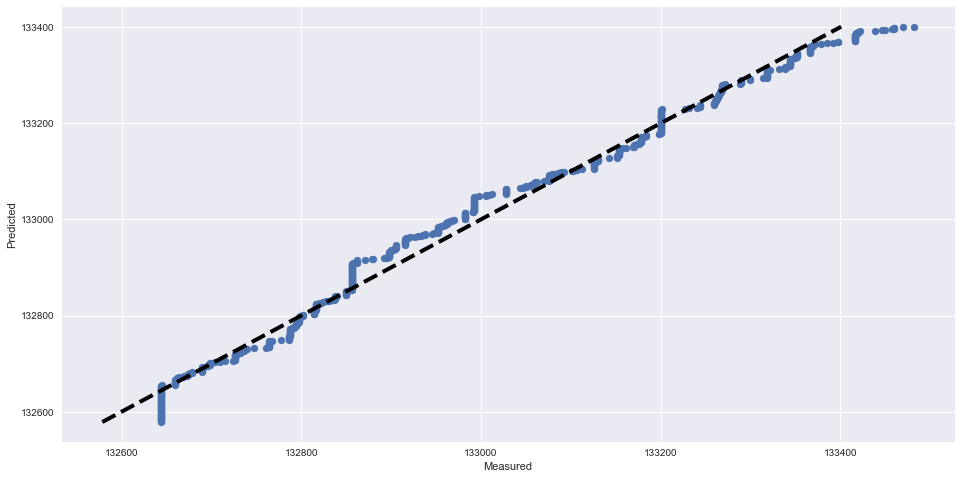

RMSE score: 24.6679611417
R2 score: 0.989369858095
---------------------------------------------------------------------------
Plotting for Meter 7460
Time series plot of the actual and predicted hourly meter readings


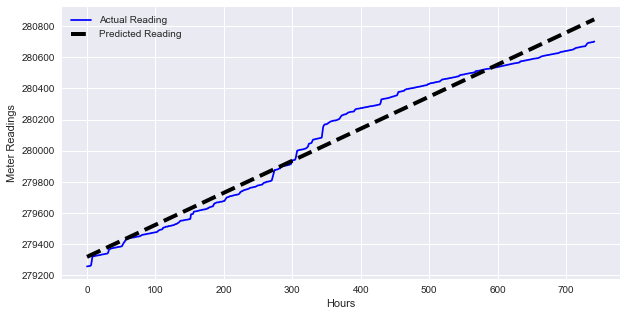

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


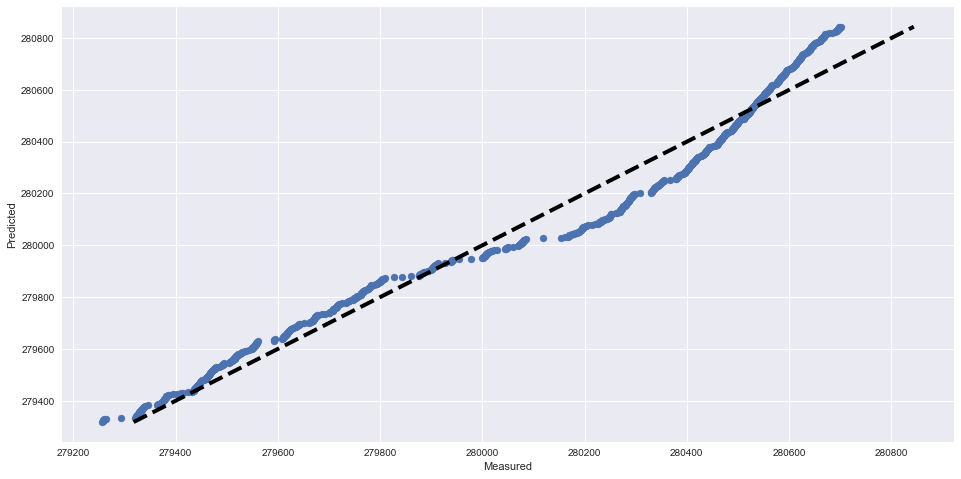

RMSE score: 76.8280020333
R2 score: 0.970519221937
---------------------------------------------------------------------------
Plotting for Meter 7674
Time series plot of the actual and predicted hourly meter readings


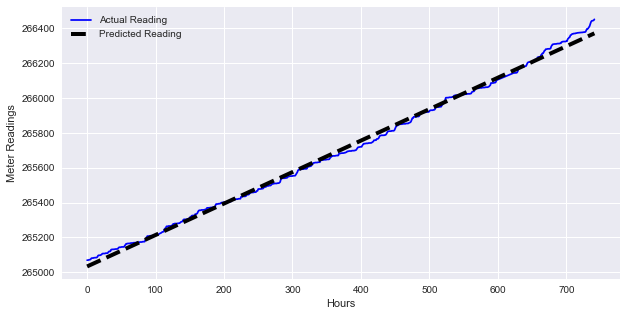

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


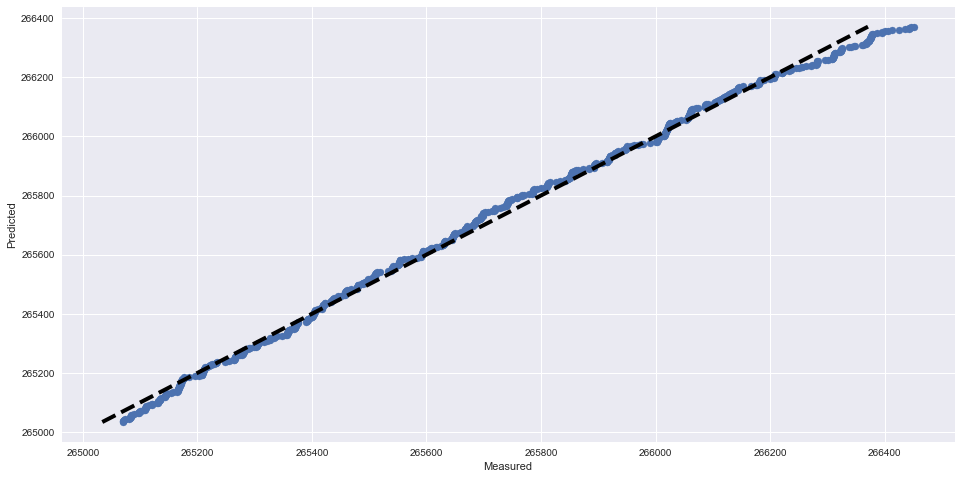

RMSE score: 22.3419609742
R2 score: 0.996669887495
---------------------------------------------------------------------------
Plotting for Meter 7682
Time series plot of the actual and predicted hourly meter readings


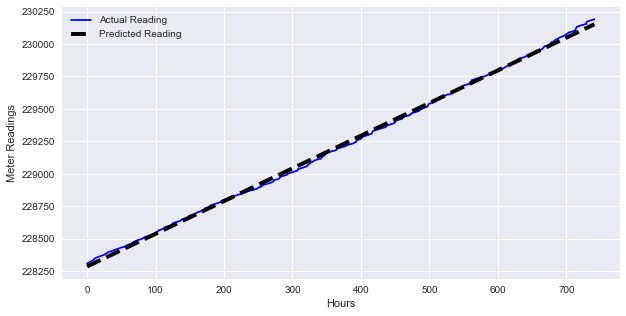

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


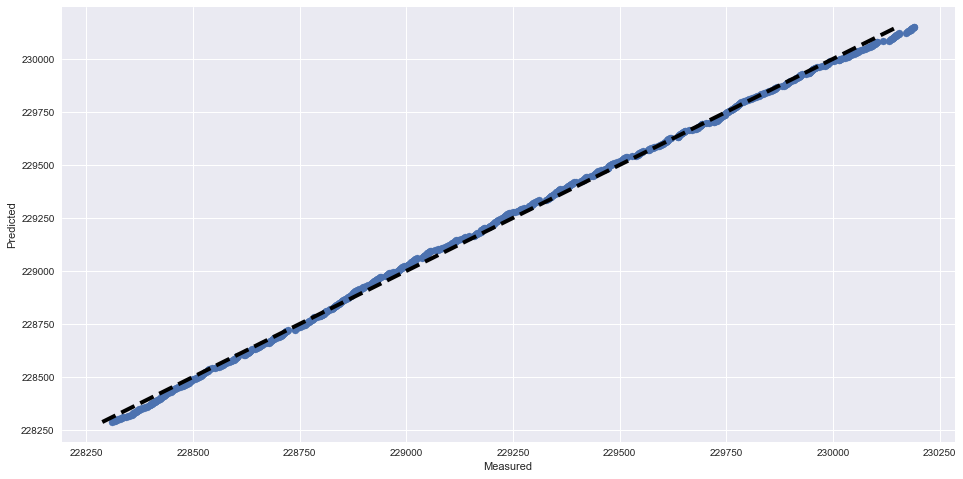

RMSE score: 19.1718678174
R2 score: 0.998736070866
---------------------------------------------------------------------------
Plotting for Meter 7739
Time series plot of the actual and predicted hourly meter readings


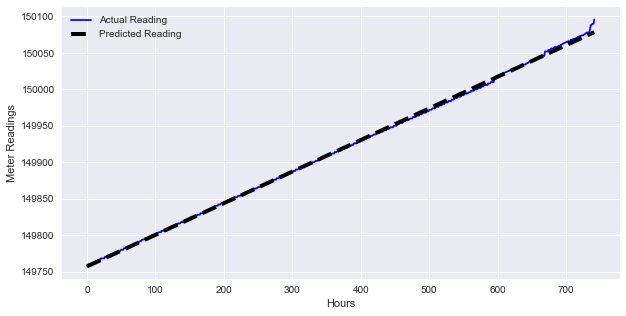

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


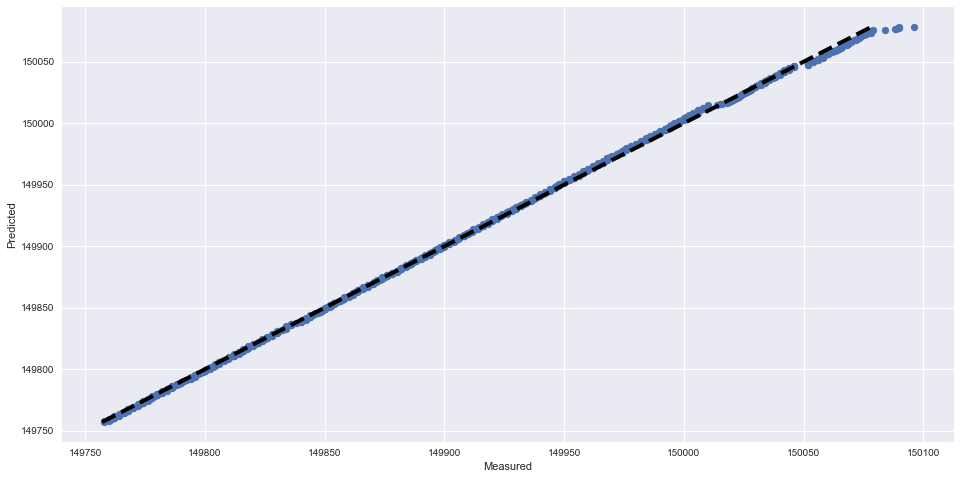

RMSE score: 2.27878036064
R2 score: 0.999398650315
---------------------------------------------------------------------------
Plotting for Meter 7741
Time series plot of the actual and predicted hourly meter readings


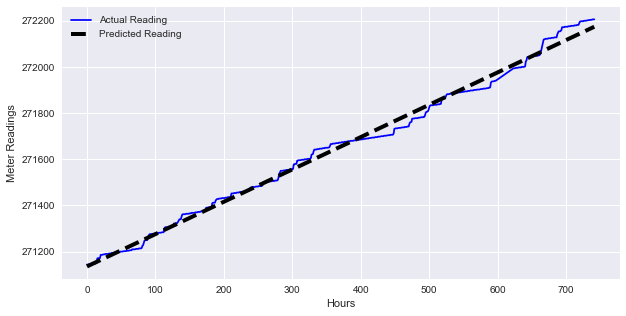

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


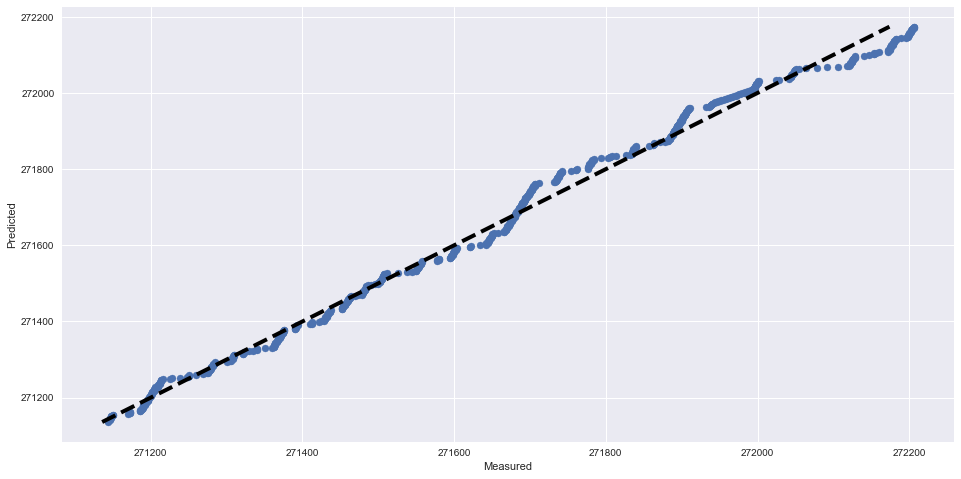

RMSE score: 25.4240899468
R2 score: 0.992871570415
---------------------------------------------------------------------------
Plotting for Meter 7794
Time series plot of the actual and predicted hourly meter readings


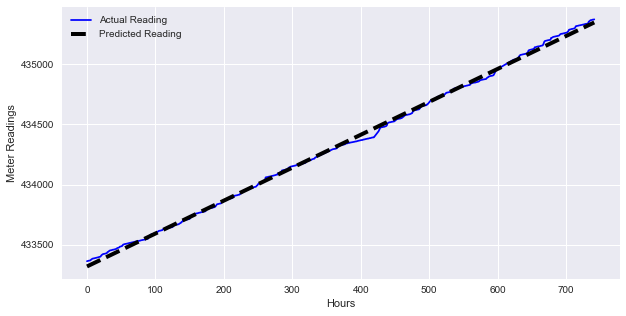

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


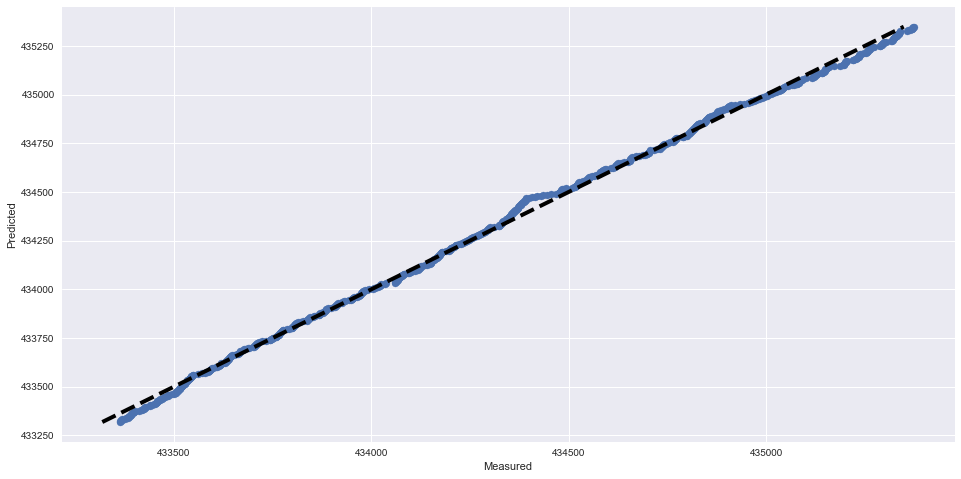

RMSE score: 22.8221582897
R2 score: 0.998489275445
---------------------------------------------------------------------------
Plotting for Meter 7900
Time series plot of the actual and predicted hourly meter readings


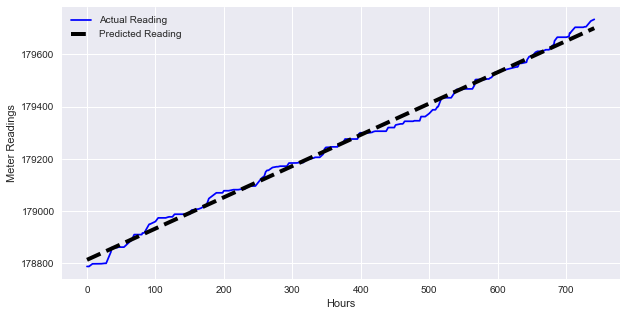

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


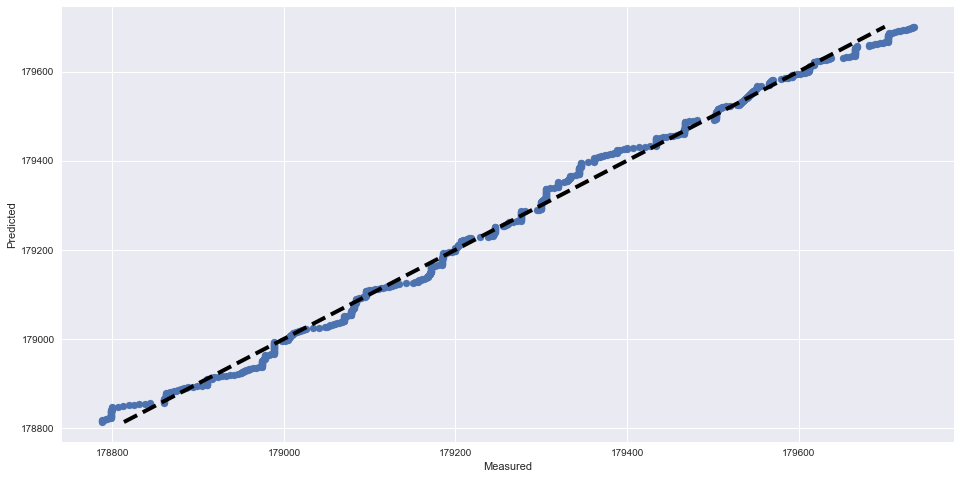

RMSE score: 18.9709653142
R2 score: 0.994559846587
---------------------------------------------------------------------------
Plotting for Meter 7919
Time series plot of the actual and predicted hourly meter readings


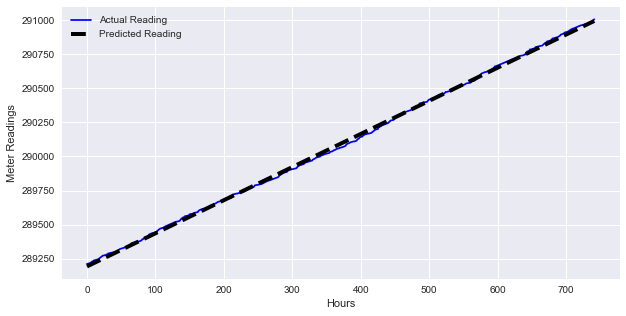

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


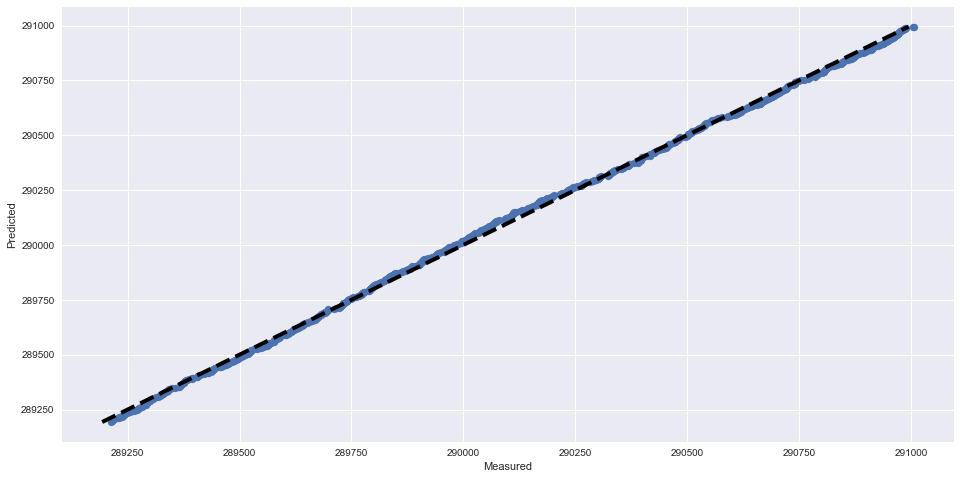

RMSE score: 14.1571154107
R2 score: 0.99926245254
---------------------------------------------------------------------------
Plotting for Meter 7965
Time series plot of the actual and predicted hourly meter readings


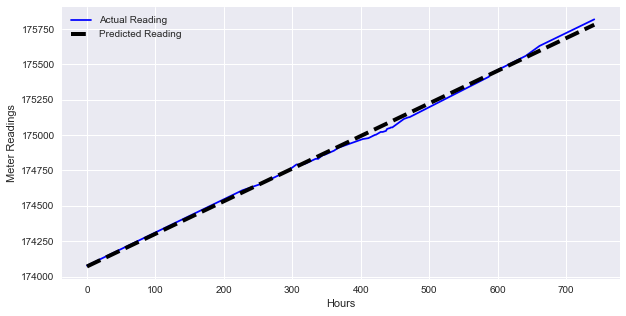

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


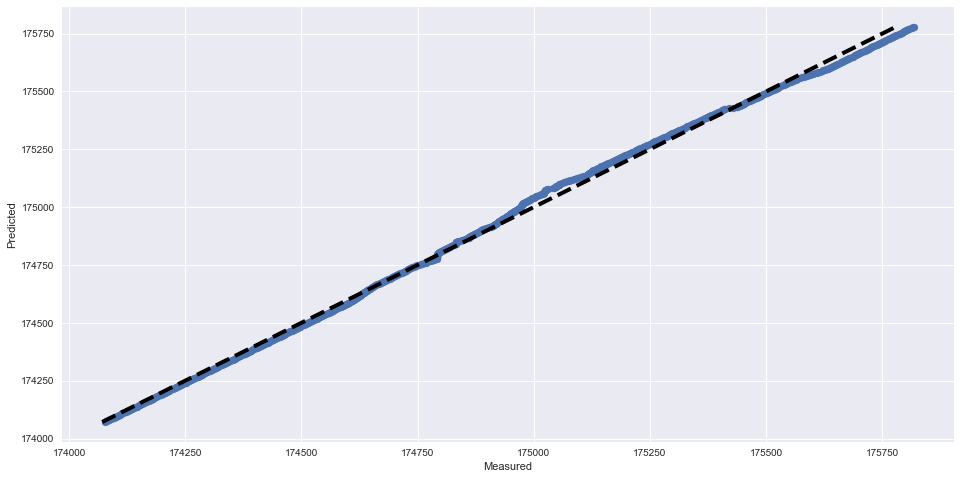

RMSE score: 21.0854741737
R2 score: 0.998182260695
---------------------------------------------------------------------------
Plotting for Meter 8059
Time series plot of the actual and predicted hourly meter readings


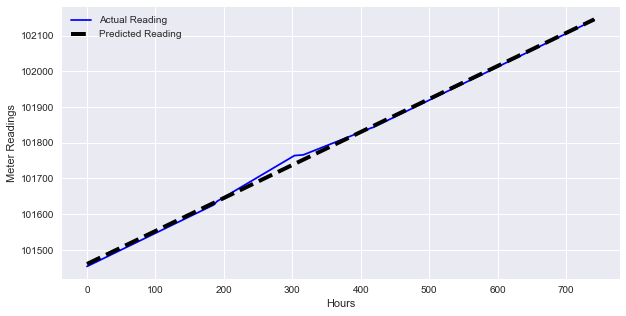

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


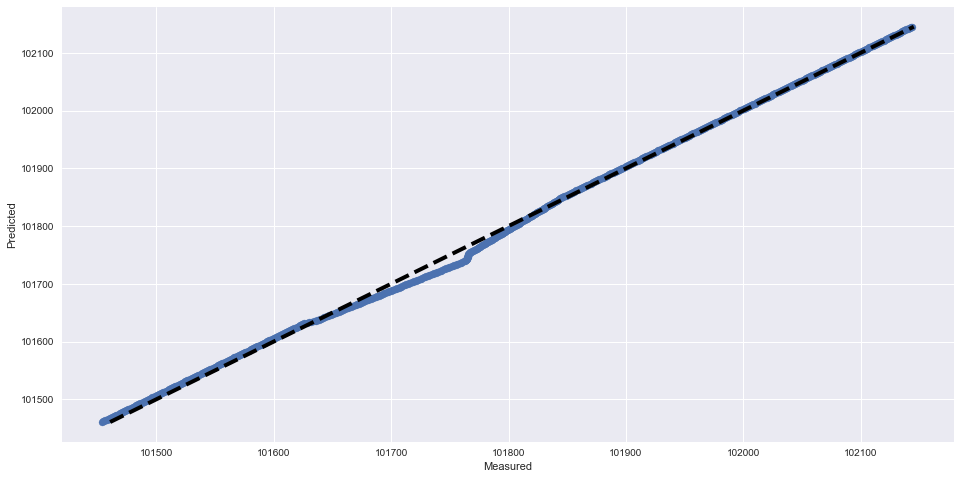

RMSE score: 7.32856416084
R2 score: 0.998629890347
---------------------------------------------------------------------------
Plotting for Meter 8084
Time series plot of the actual and predicted hourly meter readings


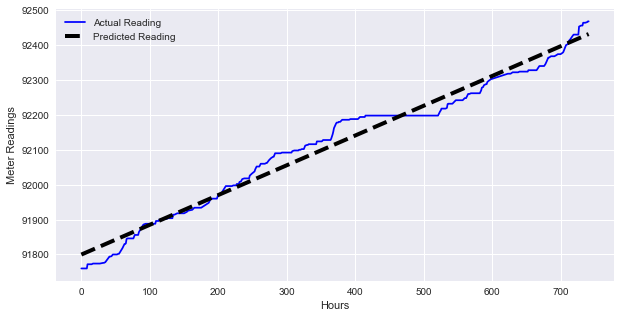

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


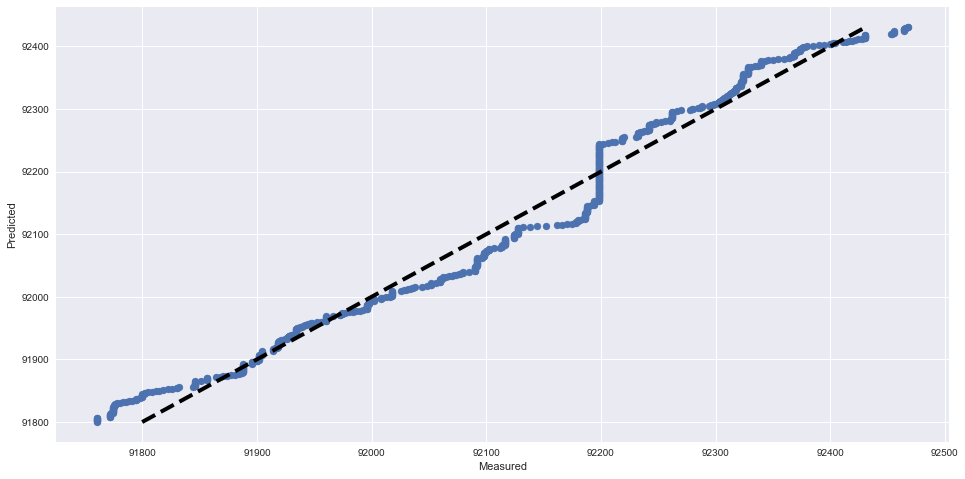

RMSE score: 28.4352665087
R2 score: 0.976240476873
---------------------------------------------------------------------------
Plotting for Meter 8086
Time series plot of the actual and predicted hourly meter readings


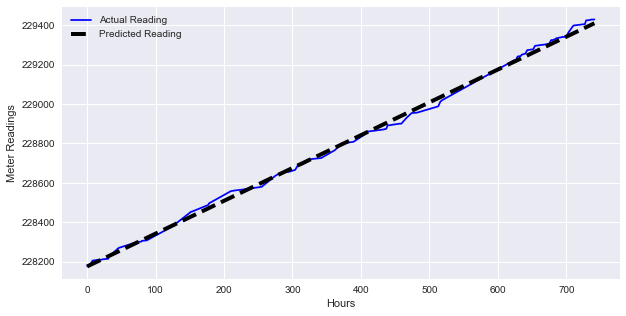

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


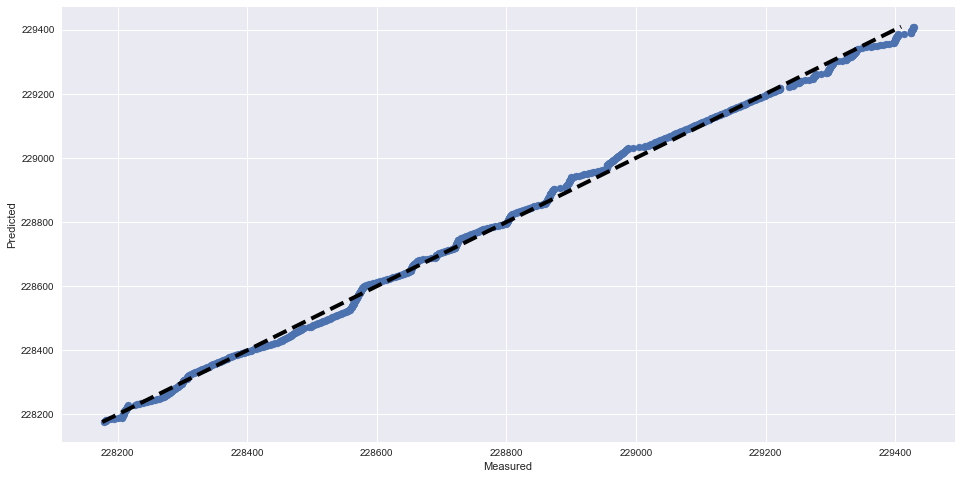

RMSE score: 17.1161942874
R2 score: 0.997697058907
---------------------------------------------------------------------------
Plotting for Meter 8155
Time series plot of the actual and predicted hourly meter readings


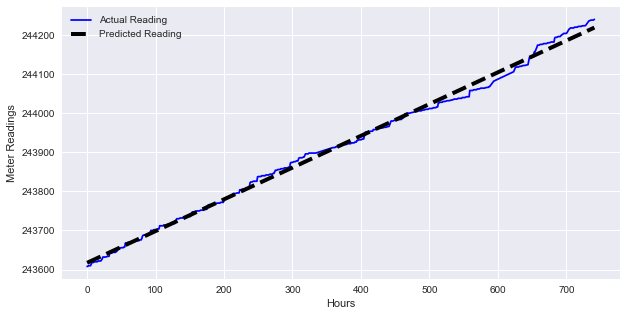

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


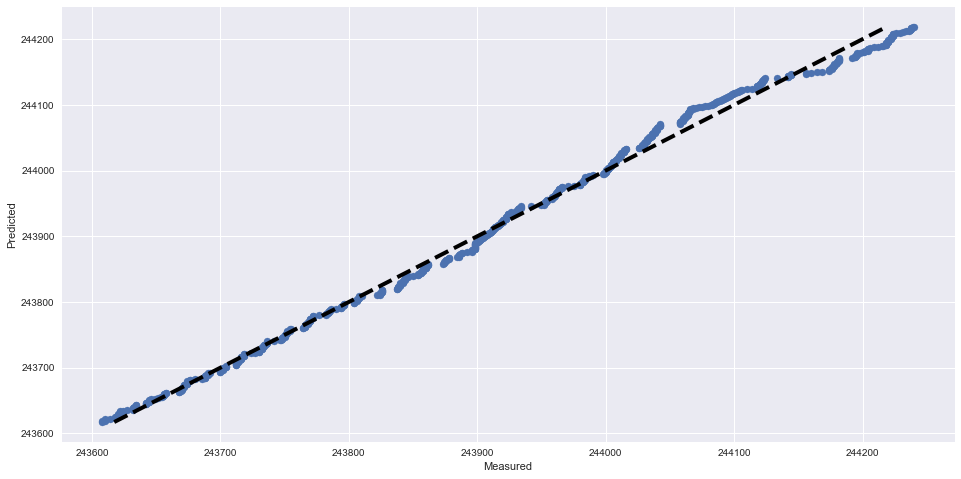

RMSE score: 11.9607658412
R2 score: 0.995294251295
---------------------------------------------------------------------------
Plotting for Meter 8156
Time series plot of the actual and predicted hourly meter readings


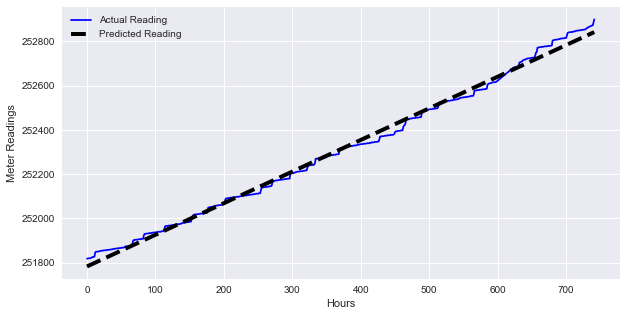

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


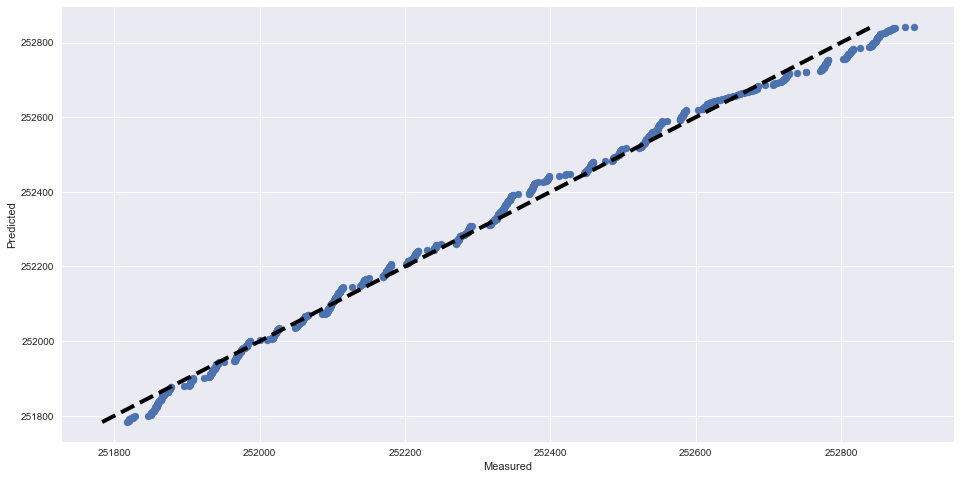

RMSE score: 22.4926160211
R2 score: 0.994642294702
---------------------------------------------------------------------------
Plotting for Meter 8467
Time series plot of the actual and predicted hourly meter readings


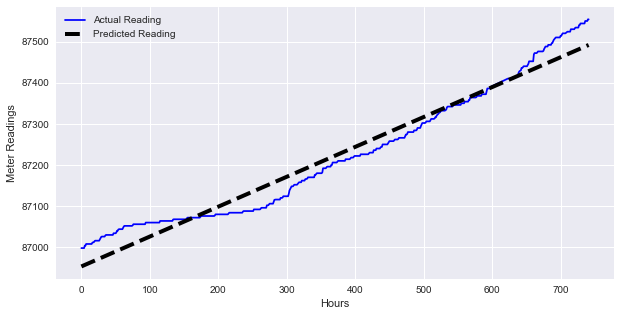

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


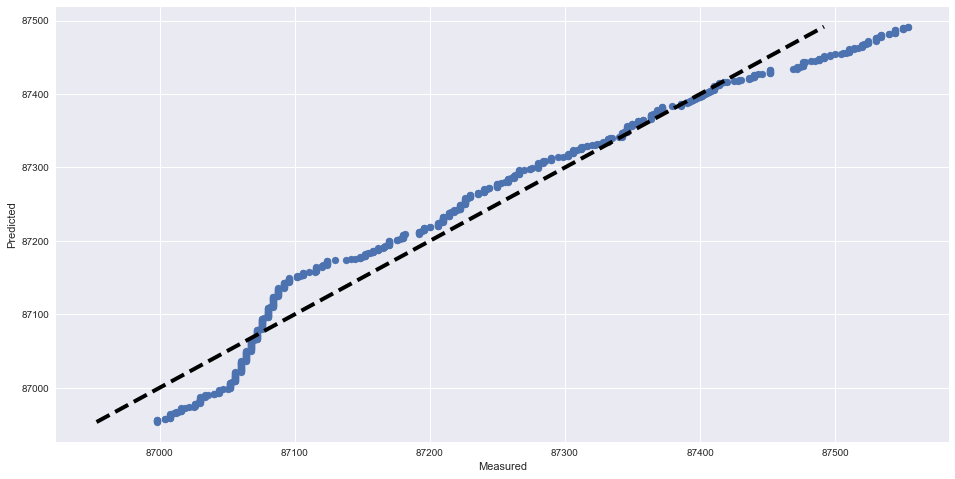

RMSE score: 31.9059437158
R2 score: 0.959648650006
---------------------------------------------------------------------------
Plotting for Meter 8703
Time series plot of the actual and predicted hourly meter readings


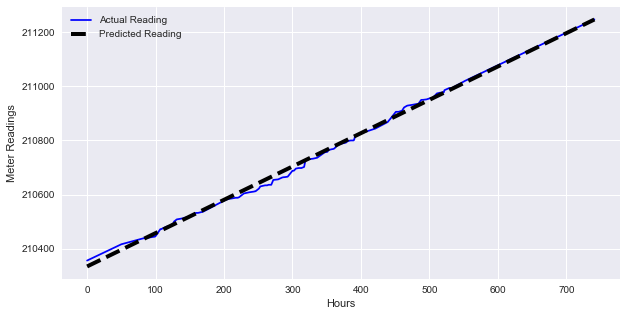

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


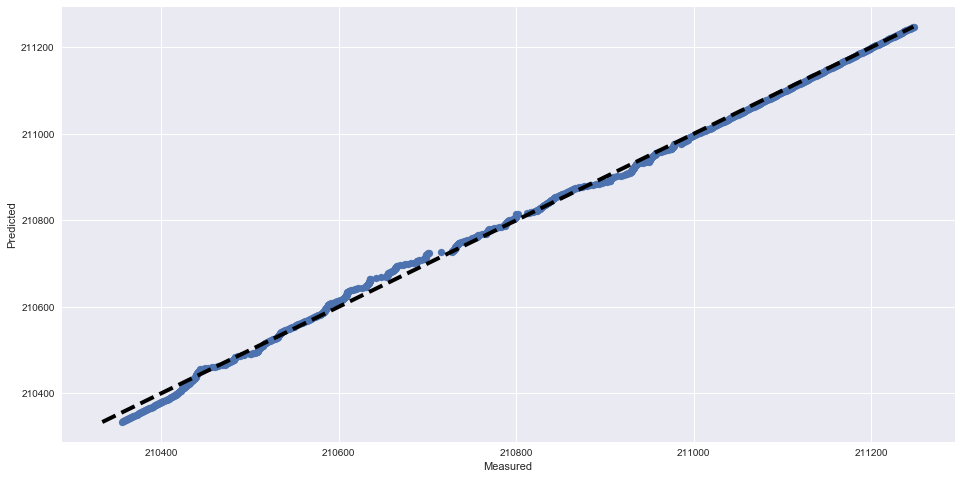

RMSE score: 11.1869210396
R2 score: 0.998208260425
---------------------------------------------------------------------------
Plotting for Meter 8829
Time series plot of the actual and predicted hourly meter readings


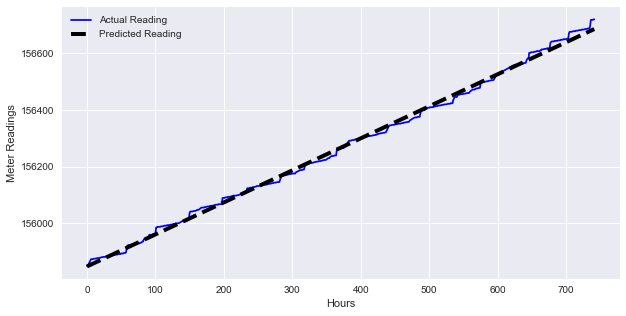

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


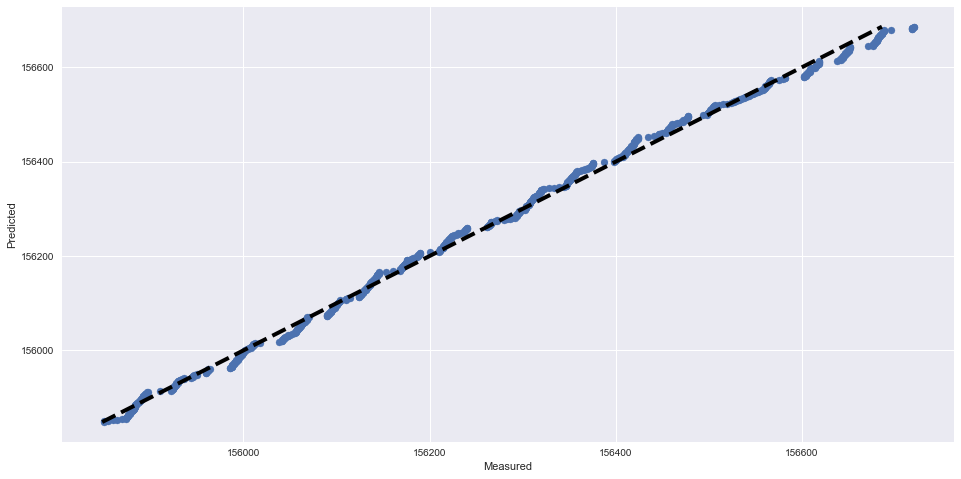

RMSE score: 12.6213565615
R2 score: 0.997293320927
---------------------------------------------------------------------------
Plotting for Meter 8890
Time series plot of the actual and predicted hourly meter readings


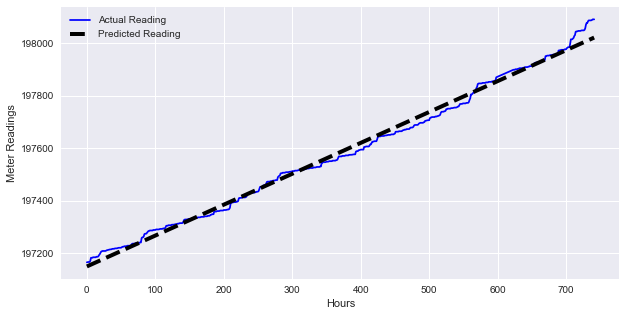

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


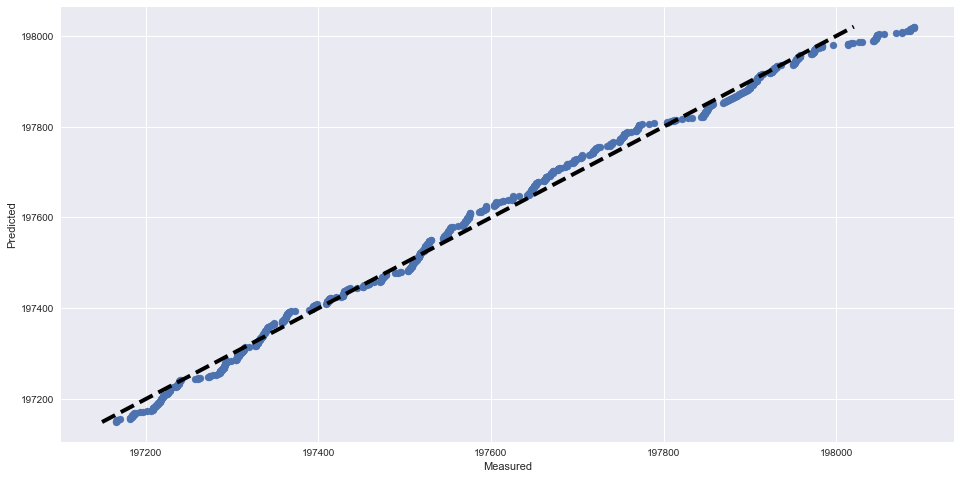

RMSE score: 20.9918667858
R2 score: 0.993095819409
---------------------------------------------------------------------------
Plotting for Meter 9052
Time series plot of the actual and predicted hourly meter readings


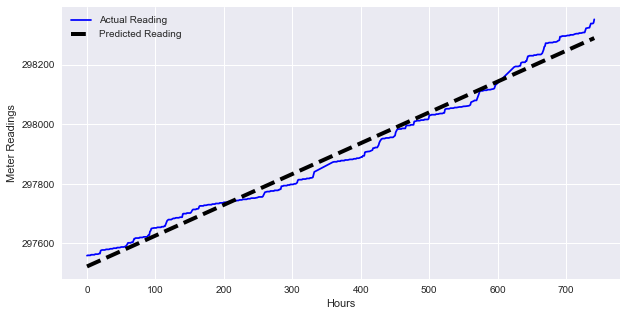

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


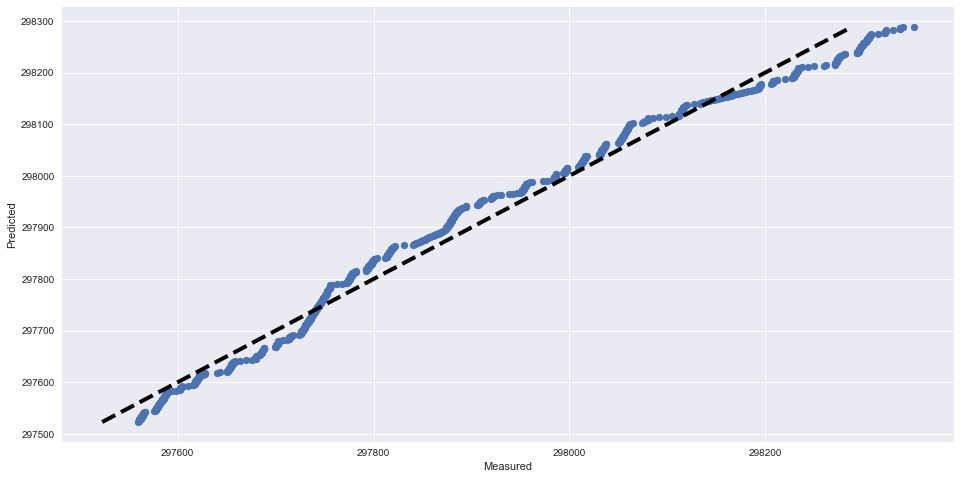

RMSE score: 28.2782859828
R2 score: 0.984023406469
---------------------------------------------------------------------------
Plotting for Meter 9121
Time series plot of the actual and predicted hourly meter readings


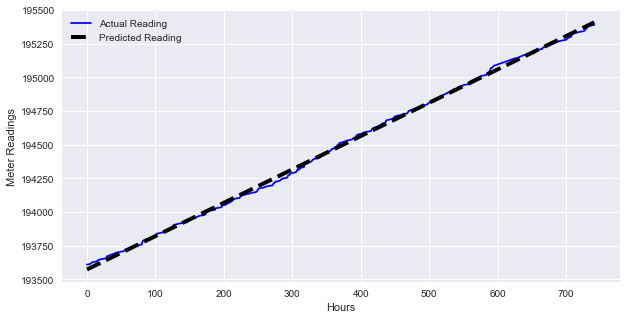

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


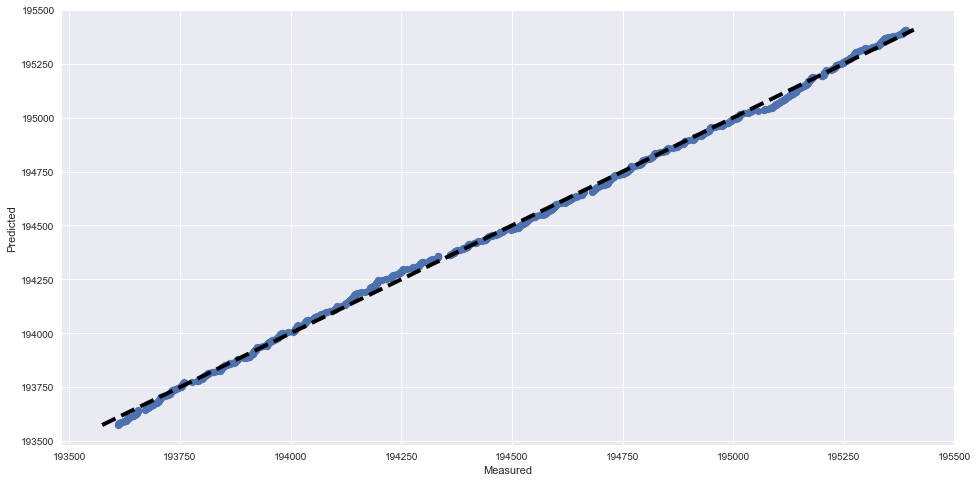

RMSE score: 17.4038080868
R2 score: 0.998924074453
---------------------------------------------------------------------------
Plotting for Meter 9134
Time series plot of the actual and predicted hourly meter readings


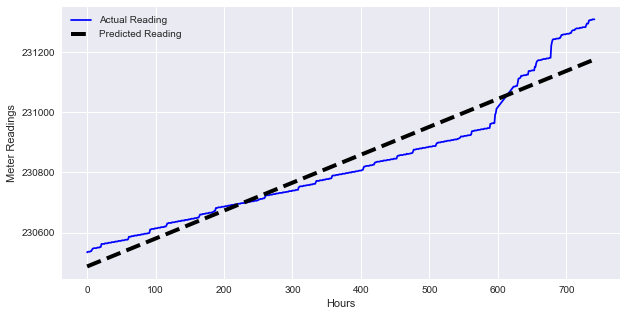

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


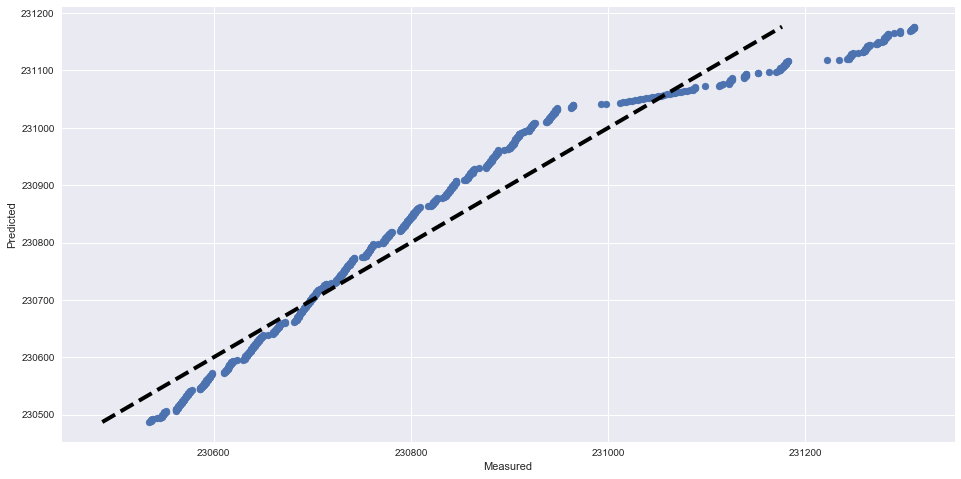

RMSE score: 56.8113503497
R2 score: 0.924812984617
---------------------------------------------------------------------------
Plotting for Meter 9278
Time series plot of the actual and predicted hourly meter readings


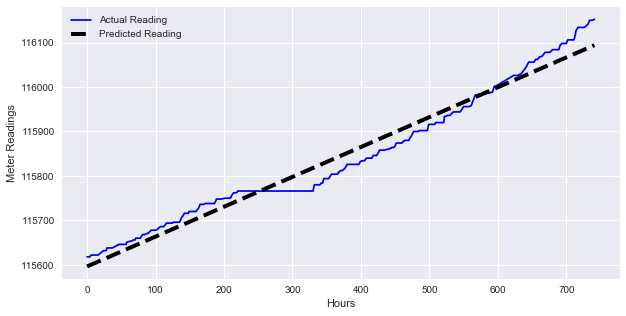

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


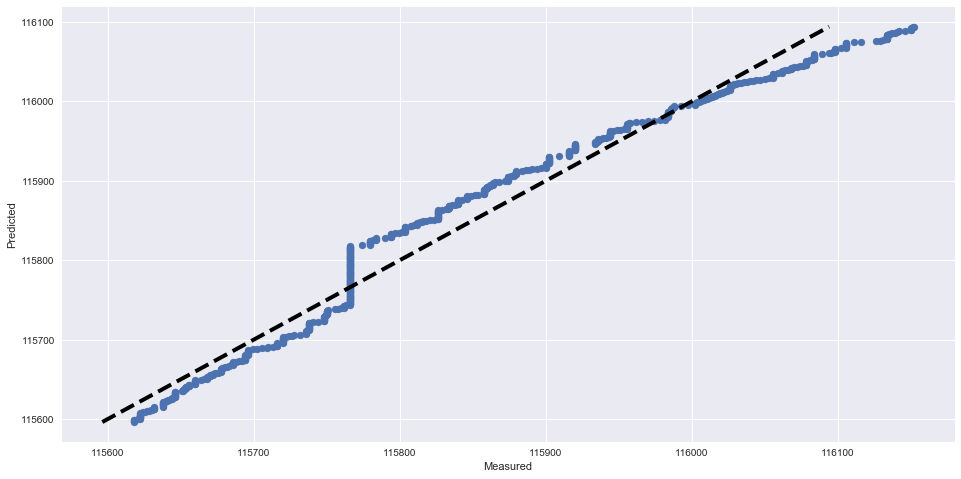

RMSE score: 25.708546049
R2 score: 0.969070162882
---------------------------------------------------------------------------
Plotting for Meter 9295
Time series plot of the actual and predicted hourly meter readings


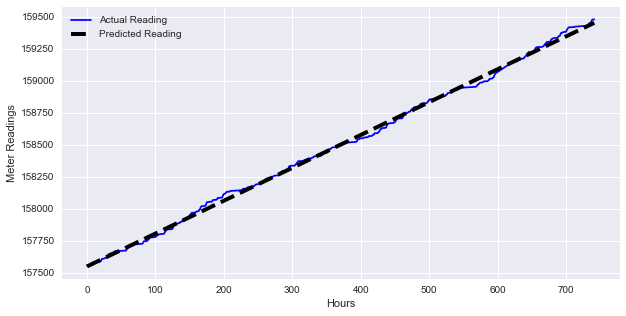

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


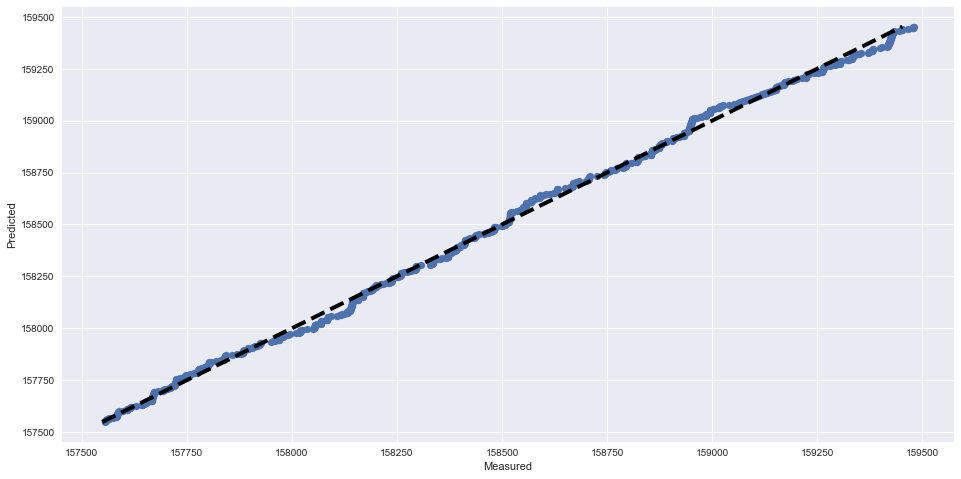

RMSE score: 23.9566382621
R2 score: 0.998110001167
---------------------------------------------------------------------------
Plotting for Meter 9474
Time series plot of the actual and predicted hourly meter readings


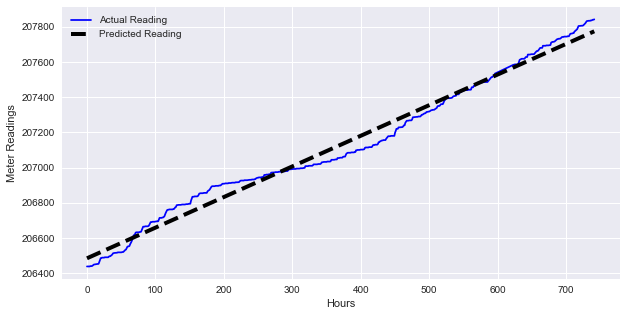

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


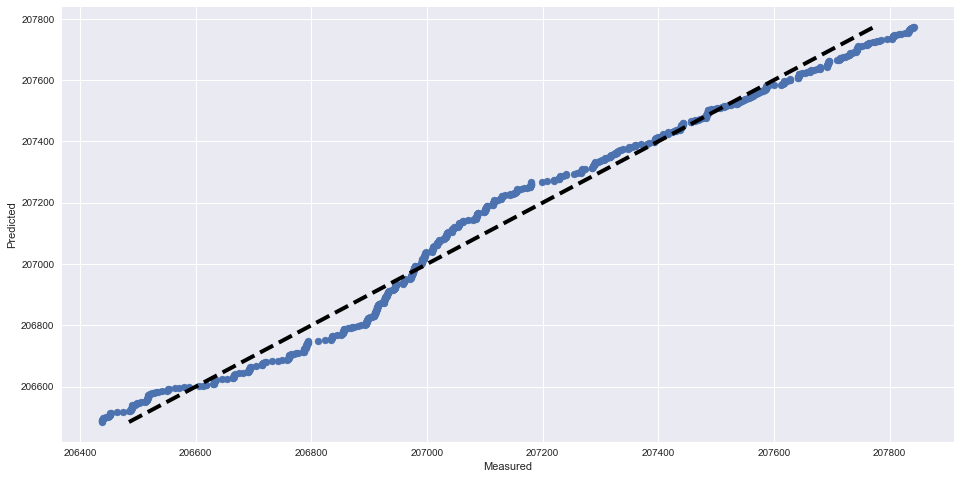

RMSE score: 49.6246180294
R2 score: 0.982679215695
---------------------------------------------------------------------------
Plotting for Meter 9631
Time series plot of the actual and predicted hourly meter readings


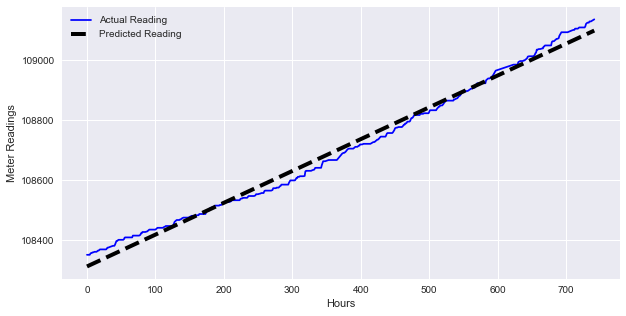

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


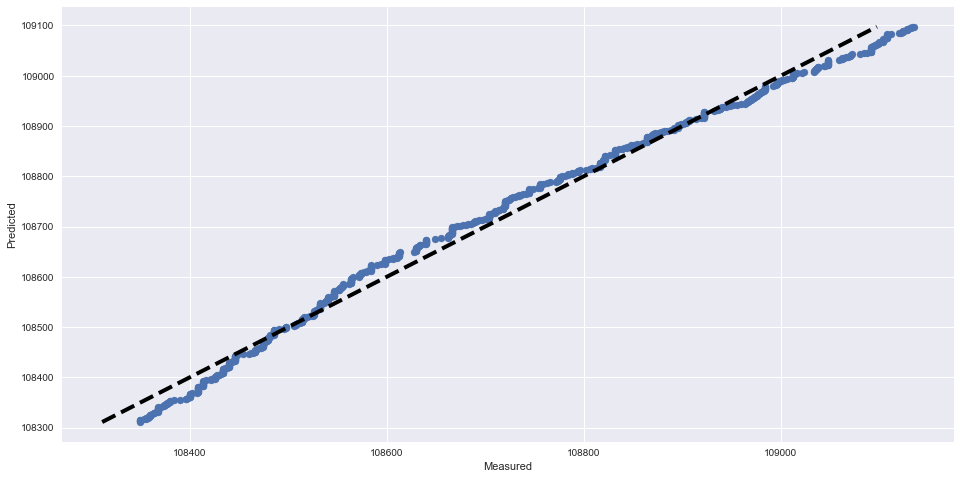

RMSE score: 22.5660656128
R2 score: 0.990248166092
---------------------------------------------------------------------------
Plotting for Meter 9639
Time series plot of the actual and predicted hourly meter readings


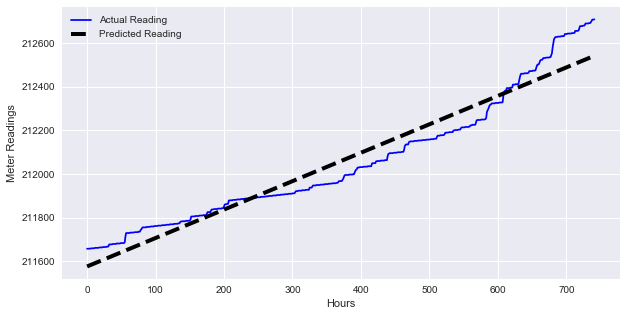

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


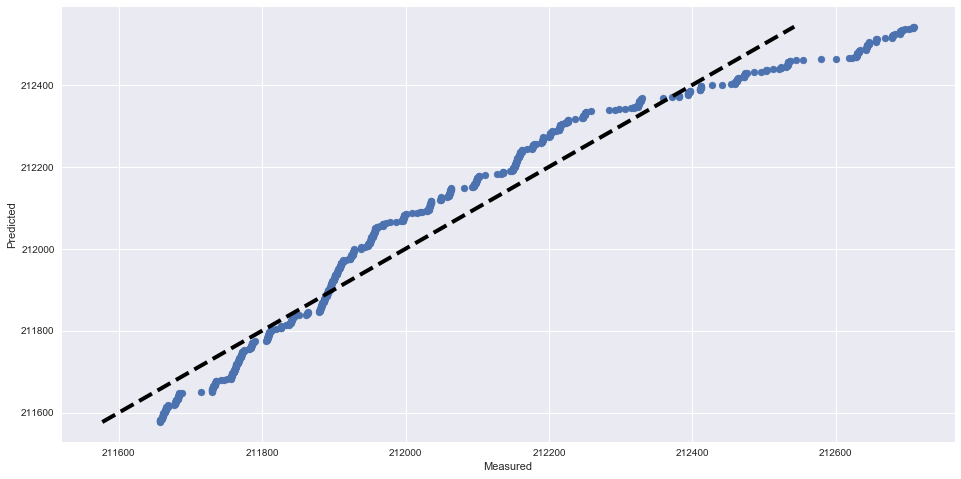

RMSE score: 71.0650411597
R2 score: 0.939163840024
---------------------------------------------------------------------------
Plotting for Meter 9729
Time series plot of the actual and predicted hourly meter readings


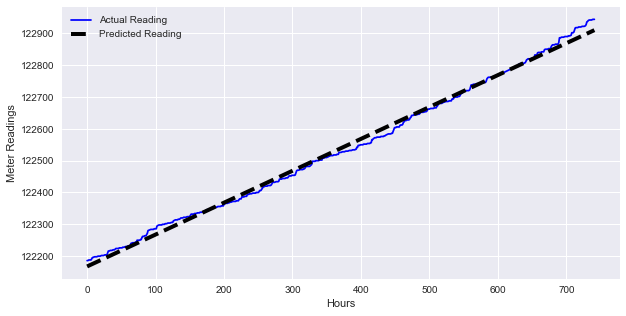

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


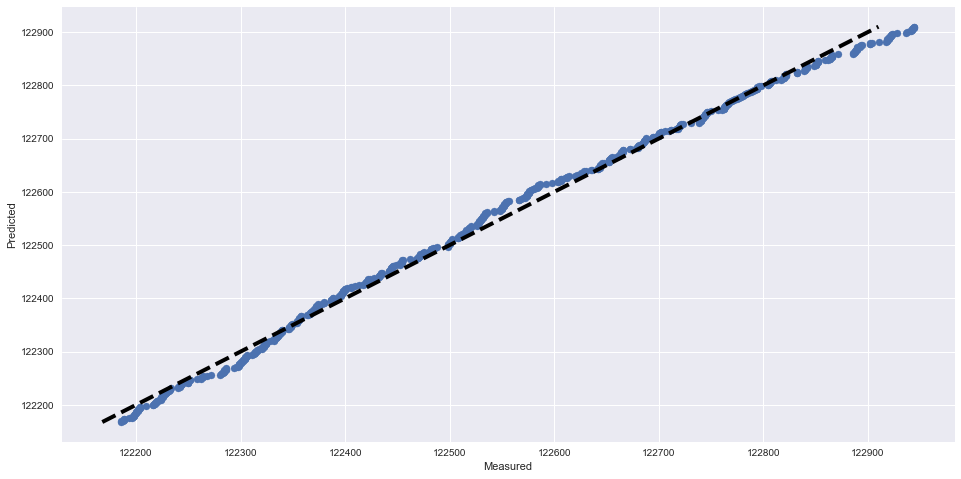

RMSE score: 14.1744245564
R2 score: 0.995658745254
---------------------------------------------------------------------------
Plotting for Meter 9766
Time series plot of the actual and predicted hourly meter readings


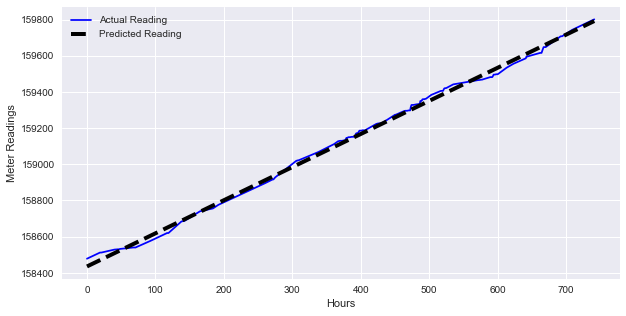

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


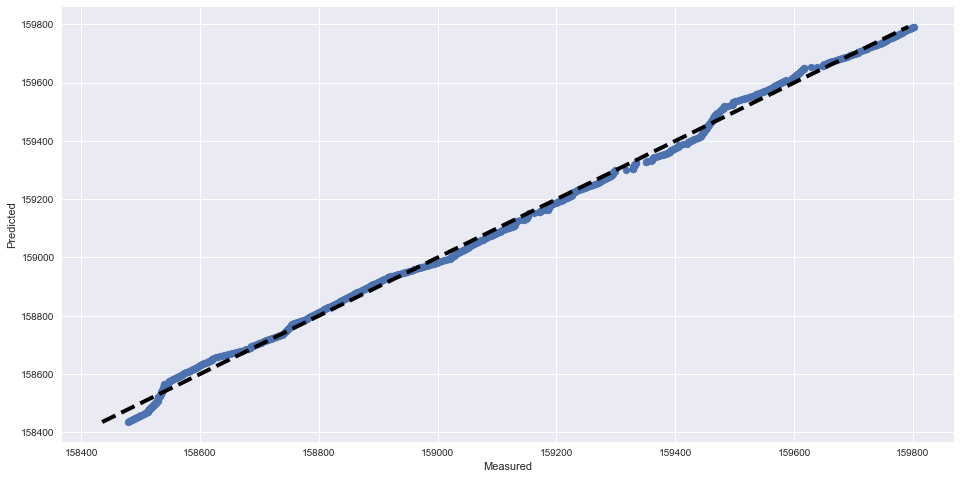

RMSE score: 19.1745786792
R2 score: 0.997610087207
---------------------------------------------------------------------------
Plotting for Meter 9849
Time series plot of the actual and predicted hourly meter readings


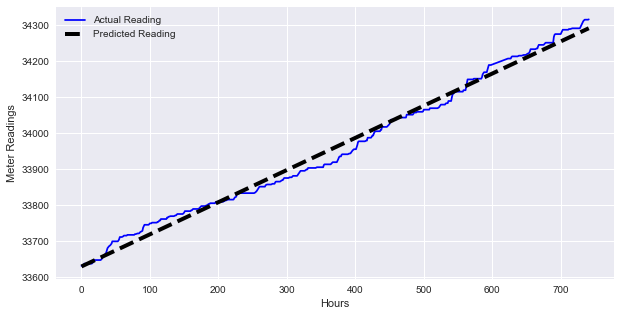

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


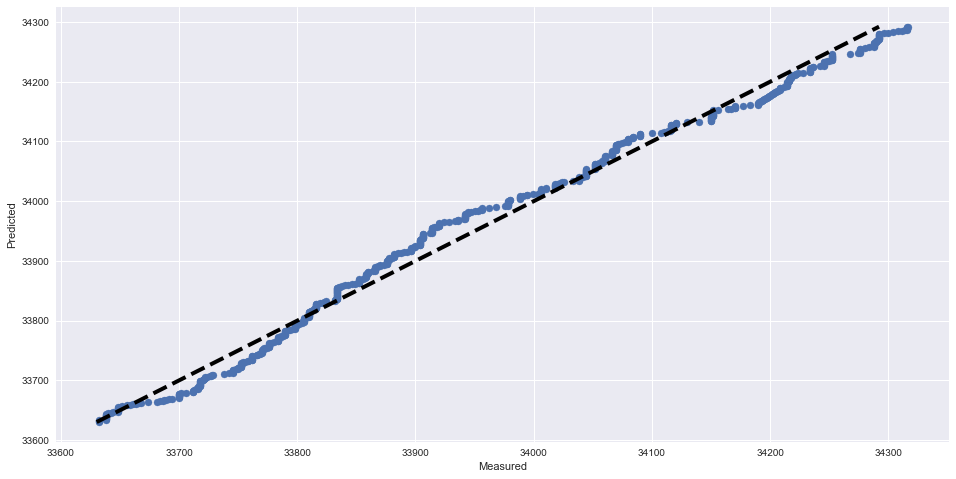

RMSE score: 19.7488537832
R2 score: 0.989484439354
---------------------------------------------------------------------------
Plotting for Meter 9956
Time series plot of the actual and predicted hourly meter readings


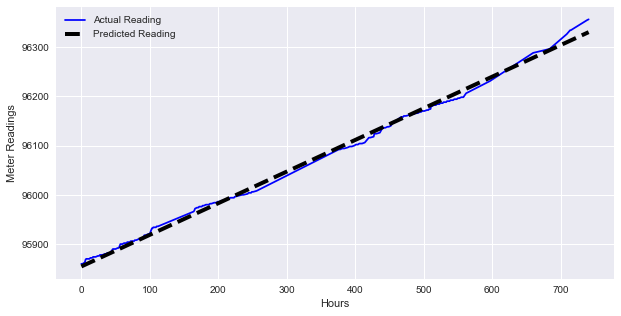

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


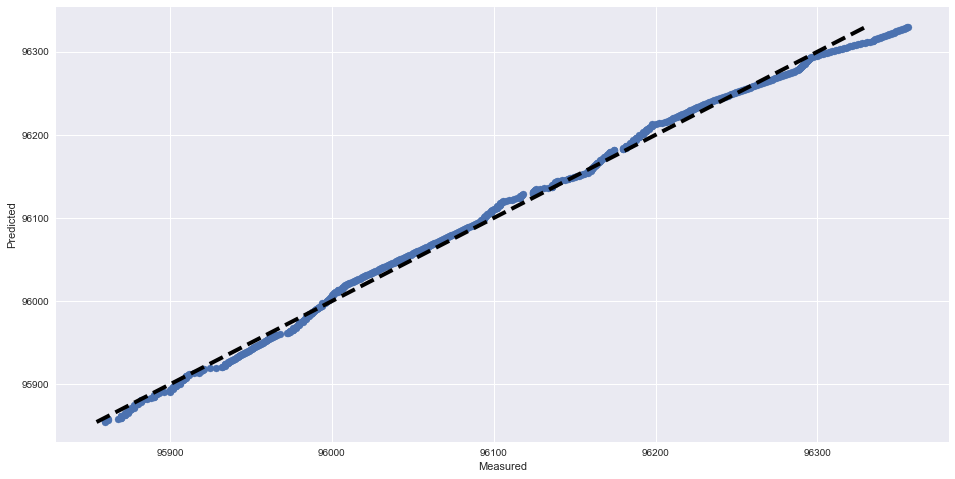

RMSE score: 8.51007797544
R2 score: 0.996180542342
---------------------------------------------------------------------------
Plotting for Meter 9982
Time series plot of the actual and predicted hourly meter readings


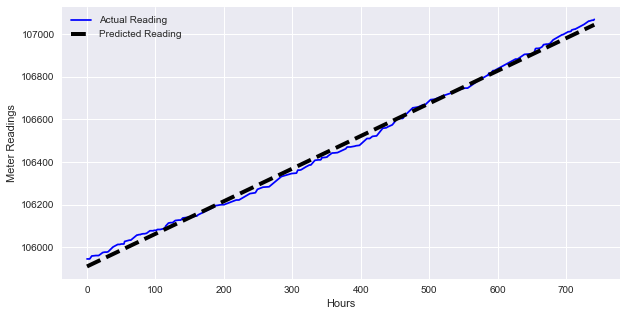

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


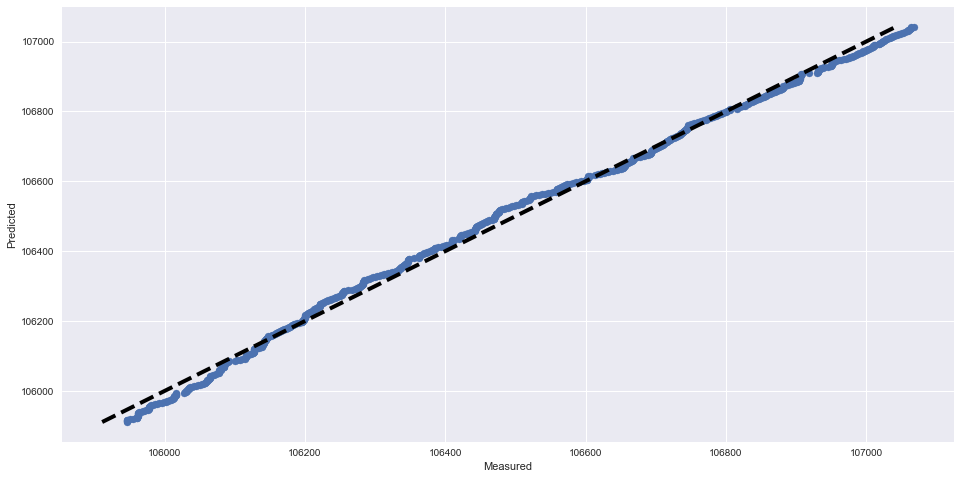

RMSE score: 20.0698731477
R2 score: 0.996255572471
---------------------------------------------------------------------------


In [100]:
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from sklearn.metrics import mean_squared_error, r2_score

for key in new_timings:
    print('Plotting for Meter', key)
    y = new_timings[key].reshape(-1,1)
    X = np.arange(len(new_timings[key])).reshape(-1,1)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
    regressor = LinearRegression()  
    regressor.fit(X_train, y_train)
    y_pred_all = regressor.predict(X)
    fig, ax = plt.subplots(figsize=(10,5))
    ax.plot(X, y,  color='blue', label='Actual Reading')
    ax.plot(X, y_pred_all, 'k--', lw=4, label='Predicted Reading')
    ax.legend()
    ax.set_xlabel('Hours')
    ax.set_ylabel('Meter Readings')
    print('Time series plot of the actual and predicted hourly meter readings')
    plt.show()
    fig, ax = plt.subplots(figsize=(16,8))
    ax.scatter(y, y_pred_all)
    ax.plot([y_pred_all.min(), y_pred_all.max()], [y_pred_all.min(), y_pred_all.max()], 'k--', lw=4)
    ax.set_xlabel('Measured')
    ax.set_ylabel('Predicted')
    print('Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)')
    
    plt.show()
    rmse = np.sqrt(mean_squared_error(y,y_pred_all))
    r2 = r2_score(y,y_pred_all)
    print("RMSE score:", rmse)
    print("R2 score:", r2)
    print('---------------------------------------------------------------------------')

Plotting SVR for Meter 35
Time series plot of the actual and predicted hourly meter readings


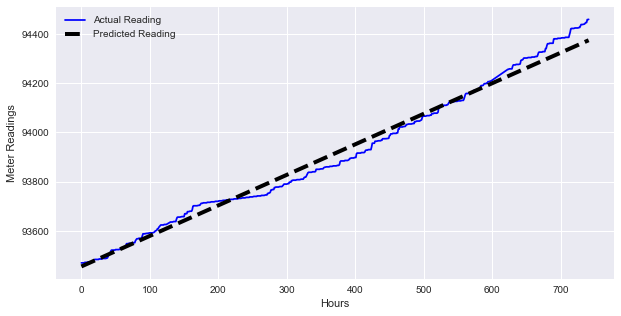

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


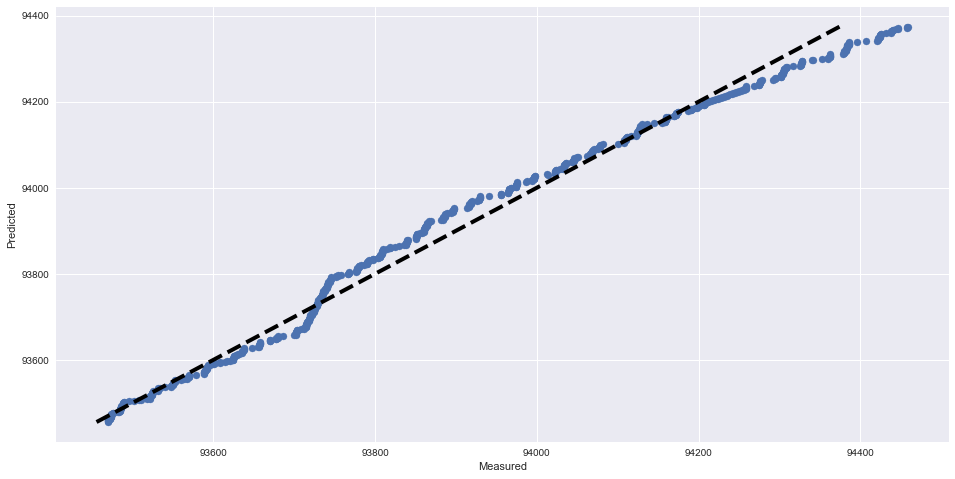

RMSE score: 32.4737177132
R2 score: 0.986194413088
---------------------------------------------------------------------------
Plotting SVR for Meter 44
Time series plot of the actual and predicted hourly meter readings


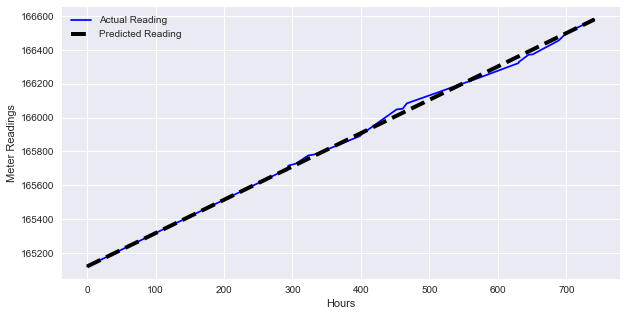

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


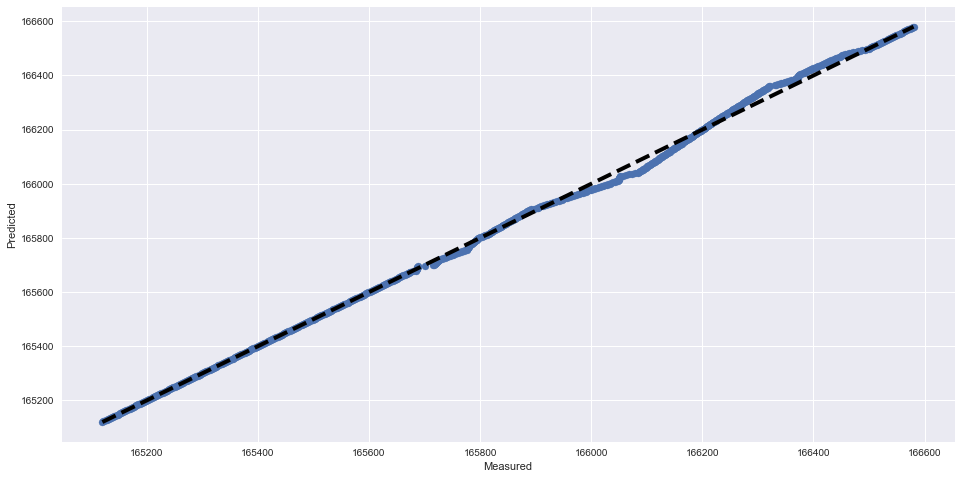

RMSE score: 15.6628820835
R2 score: 0.99860068004
---------------------------------------------------------------------------
Plotting SVR for Meter 77
Time series plot of the actual and predicted hourly meter readings


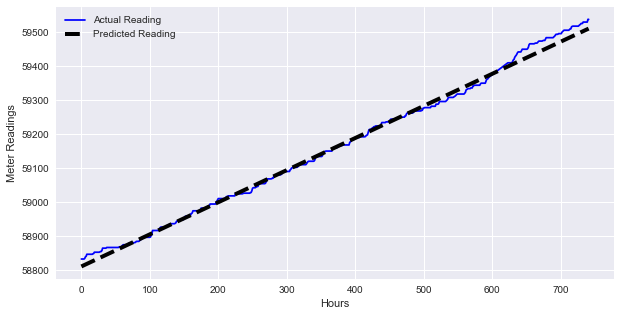

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


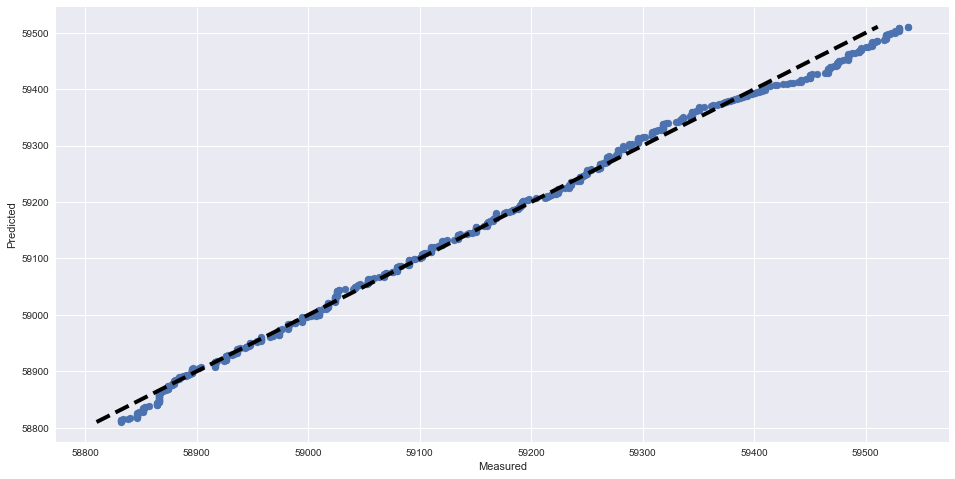

RMSE score: 13.3087272689
R2 score: 0.995799627165
---------------------------------------------------------------------------
Plotting SVR for Meter 94
Time series plot of the actual and predicted hourly meter readings


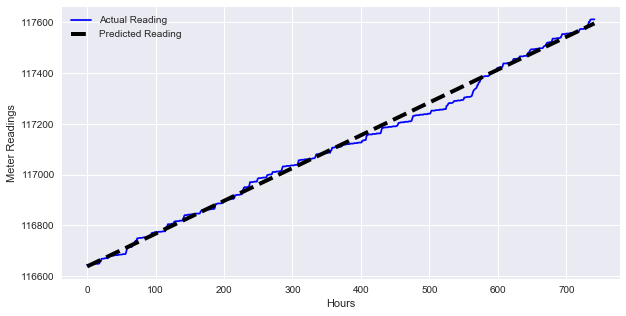

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


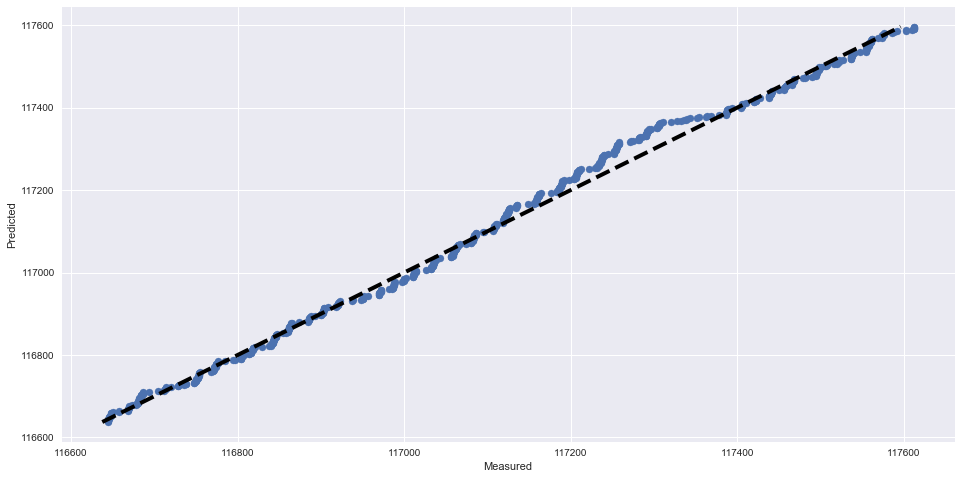

RMSE score: 19.7545282016
R2 score: 0.99481017139
---------------------------------------------------------------------------
Plotting SVR for Meter 114
Time series plot of the actual and predicted hourly meter readings


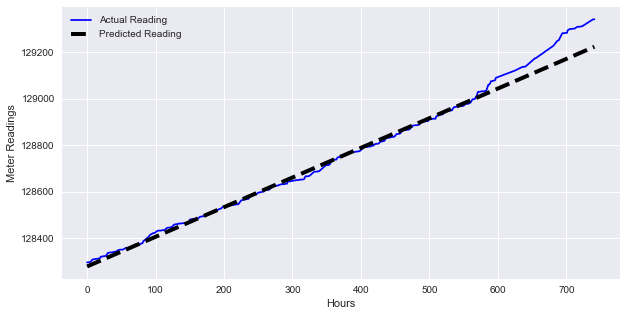

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


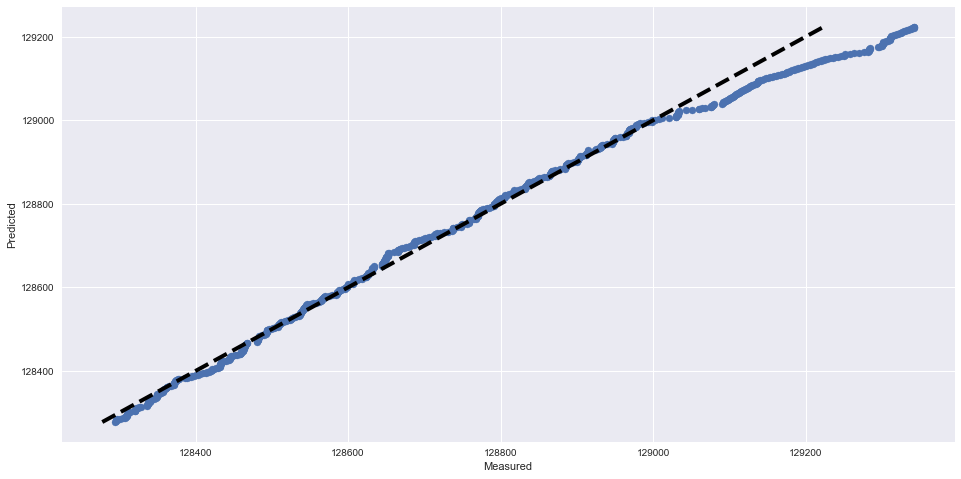

RMSE score: 38.8428784924
R2 score: 0.982698595316
---------------------------------------------------------------------------
Plotting SVR for Meter 187
Time series plot of the actual and predicted hourly meter readings


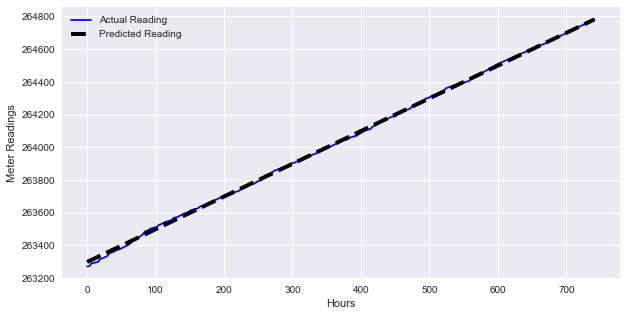

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


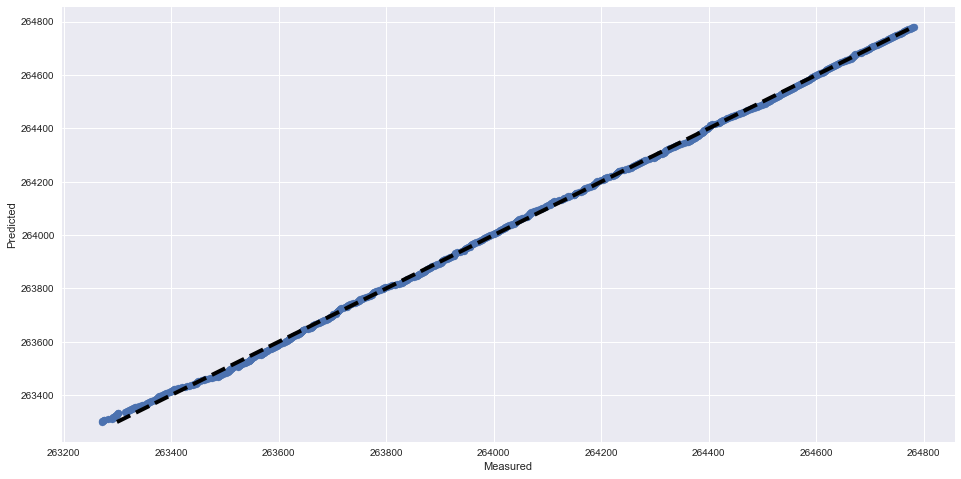

RMSE score: 9.10079020873
R2 score: 0.999552346927
---------------------------------------------------------------------------
Plotting SVR for Meter 222
Time series plot of the actual and predicted hourly meter readings


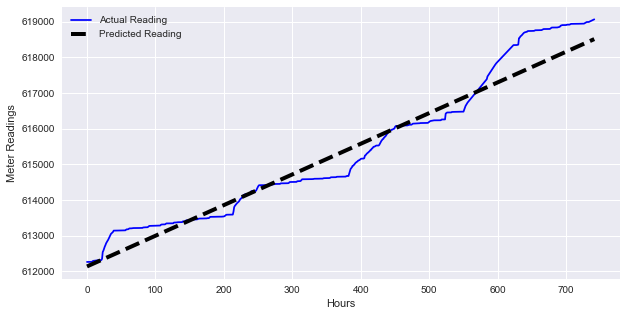

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


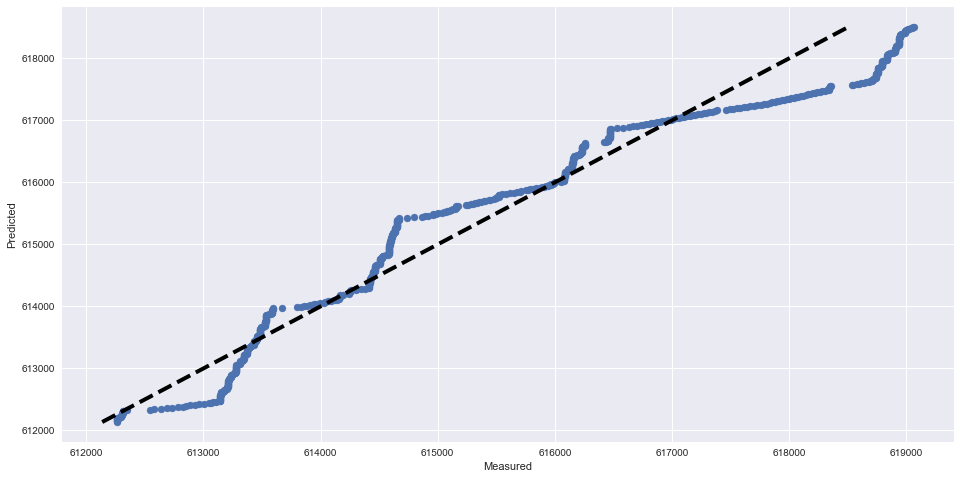

RMSE score: 454.699961215
R2 score: 0.949240313826
---------------------------------------------------------------------------
Plotting SVR for Meter 252
Time series plot of the actual and predicted hourly meter readings


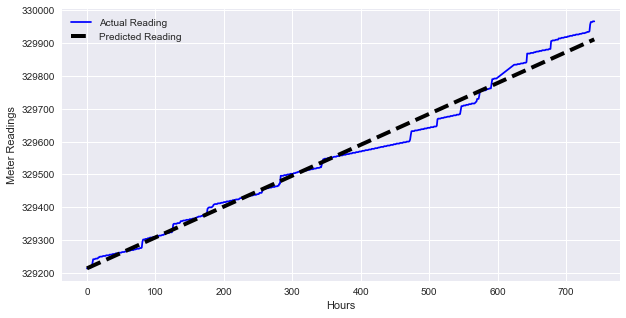

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


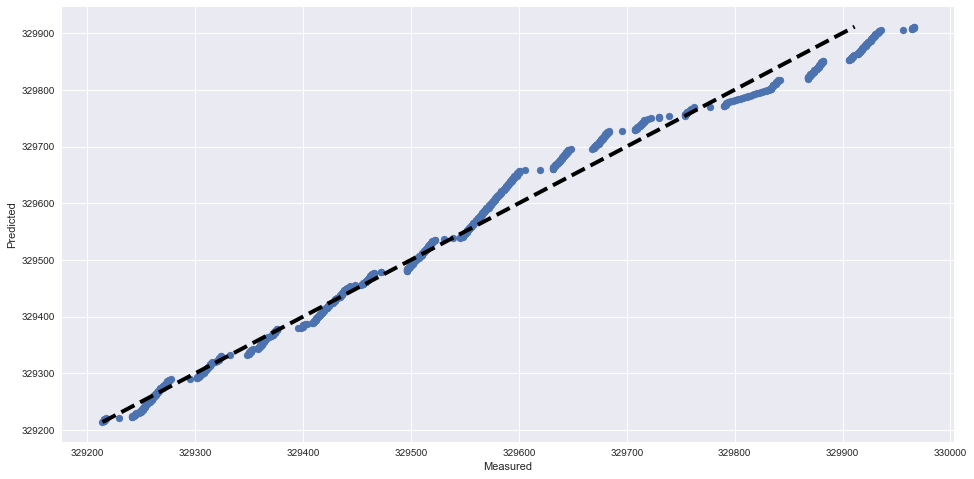

RMSE score: 25.5616556343
R2 score: 0.984750740317
---------------------------------------------------------------------------
Plotting SVR for Meter 370
Time series plot of the actual and predicted hourly meter readings


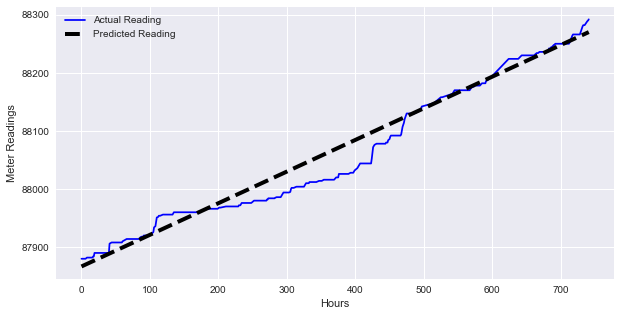

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


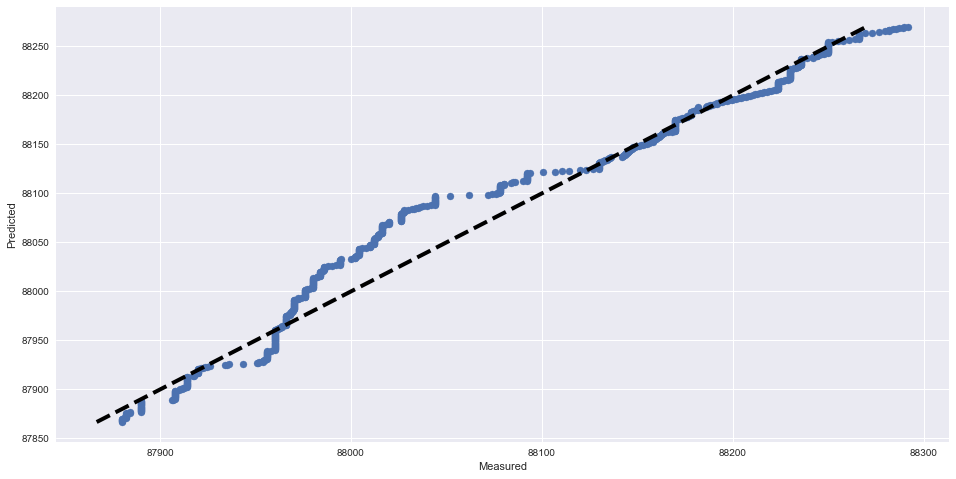

RMSE score: 22.9281551529
R2 score: 0.962657118475
---------------------------------------------------------------------------
Plotting SVR for Meter 483
Time series plot of the actual and predicted hourly meter readings


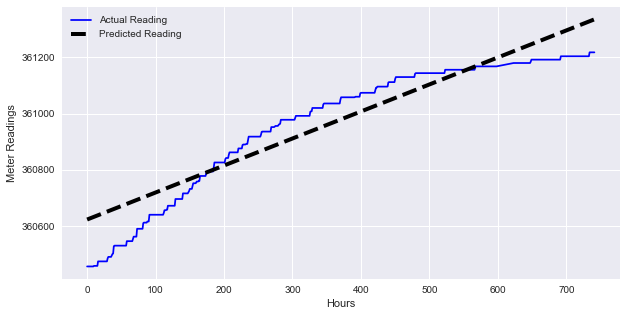

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


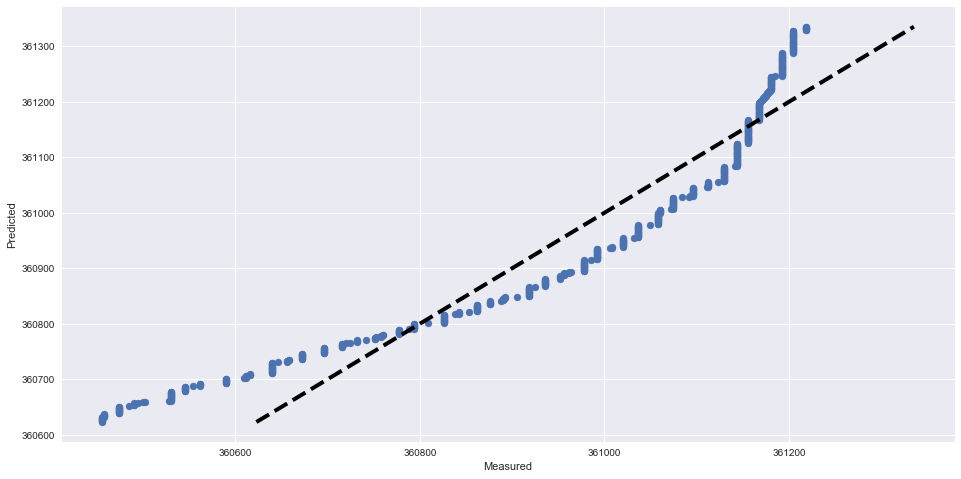

RMSE score: 76.4741873118
R2 score: 0.888750483123
---------------------------------------------------------------------------
Plotting SVR for Meter 484
Time series plot of the actual and predicted hourly meter readings


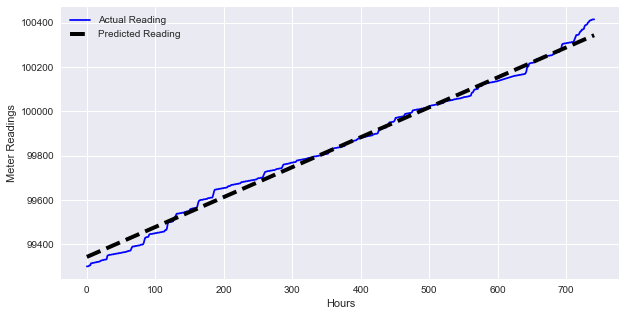

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


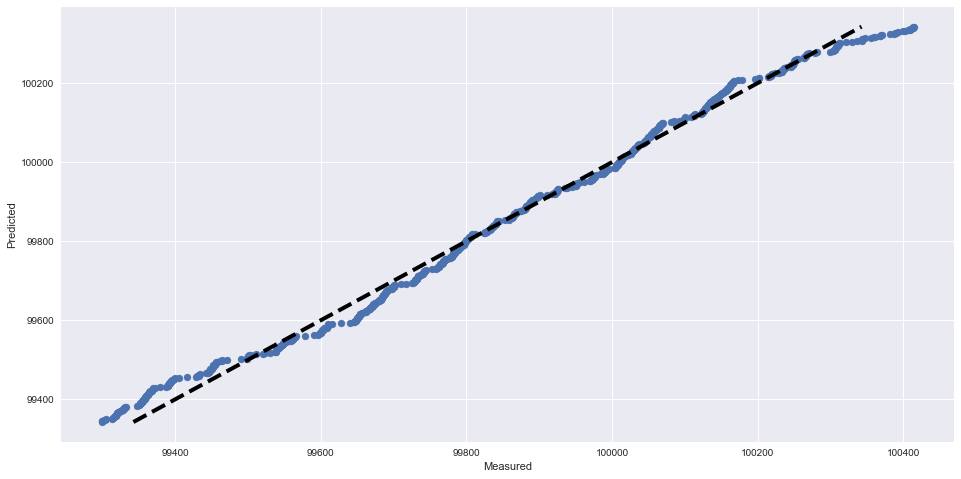

RMSE score: 26.2622069262
R2 score: 0.992190662917
---------------------------------------------------------------------------
Plotting SVR for Meter 661
Time series plot of the actual and predicted hourly meter readings


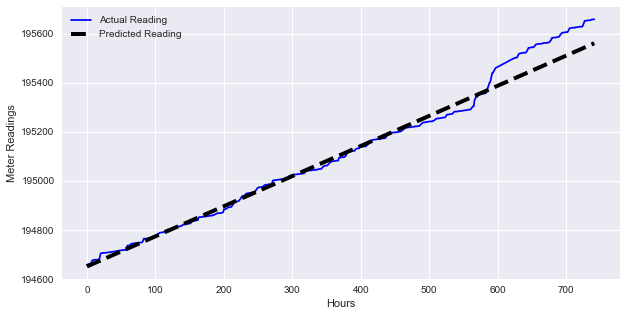

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


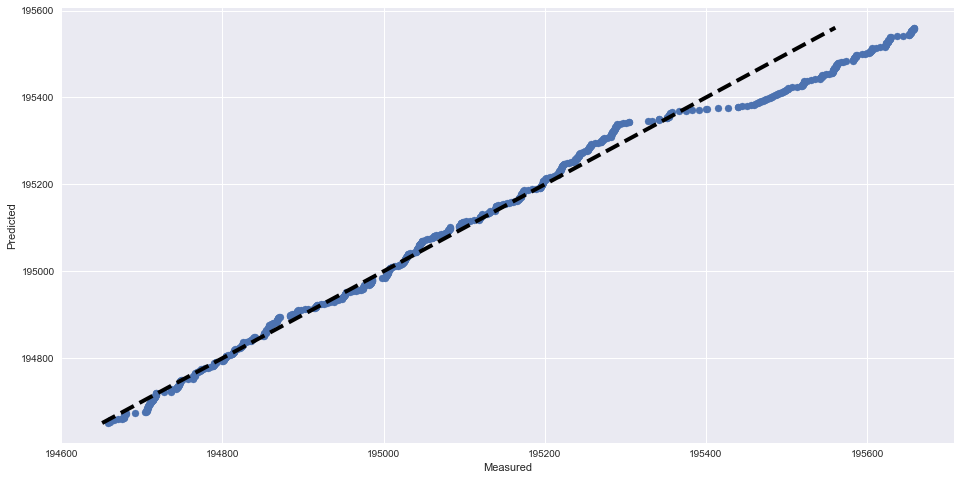

RMSE score: 43.4070969847
R2 score: 0.977080120567
---------------------------------------------------------------------------
Plotting SVR for Meter 739
Time series plot of the actual and predicted hourly meter readings


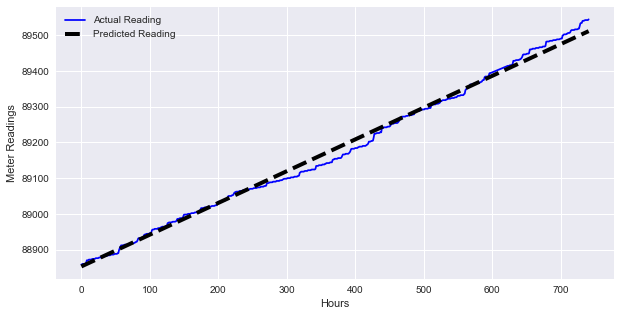

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


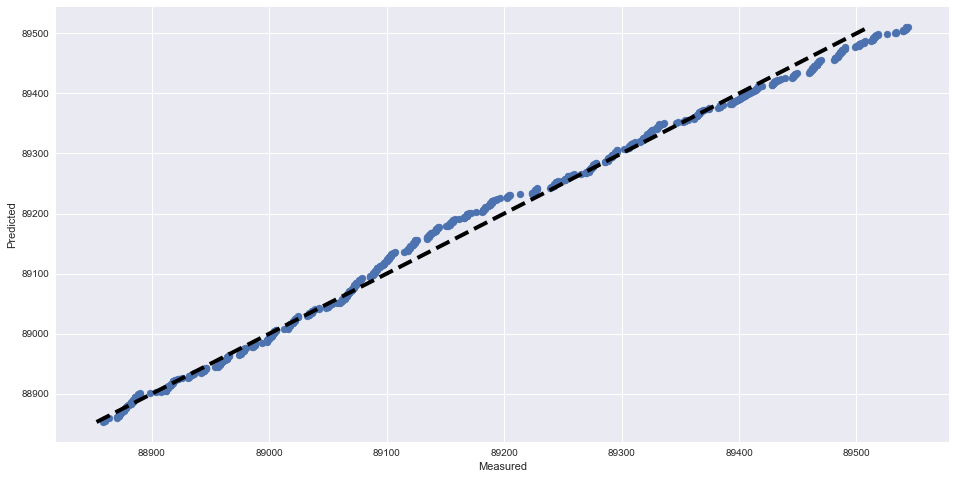

RMSE score: 15.2460584402
R2 score: 0.993864348052
---------------------------------------------------------------------------
Plotting SVR for Meter 744
Time series plot of the actual and predicted hourly meter readings


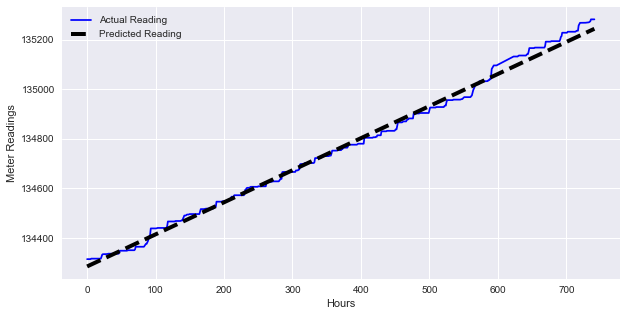

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


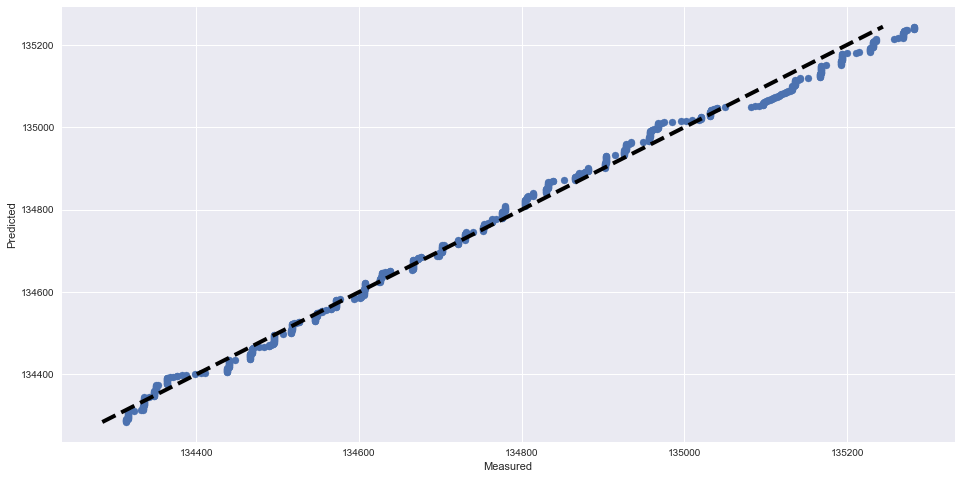

RMSE score: 21.140273406
R2 score: 0.994420925111
---------------------------------------------------------------------------
Plotting SVR for Meter 871
Time series plot of the actual and predicted hourly meter readings


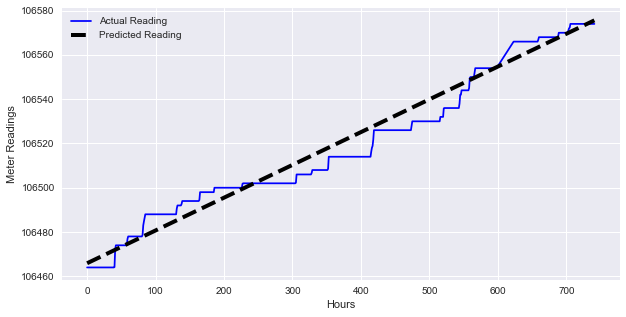

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


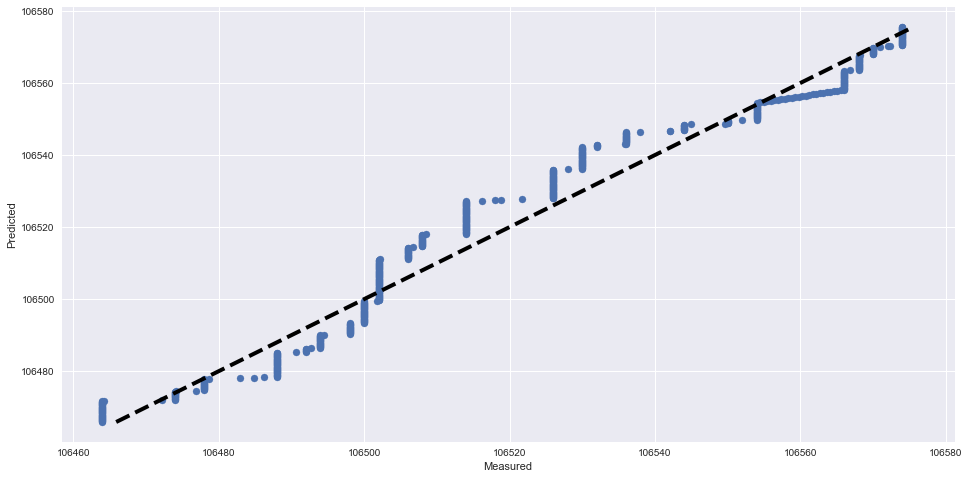

RMSE score: 5.96584504603
R2 score: 0.96437243133
---------------------------------------------------------------------------
Plotting SVR for Meter 1042
Time series plot of the actual and predicted hourly meter readings


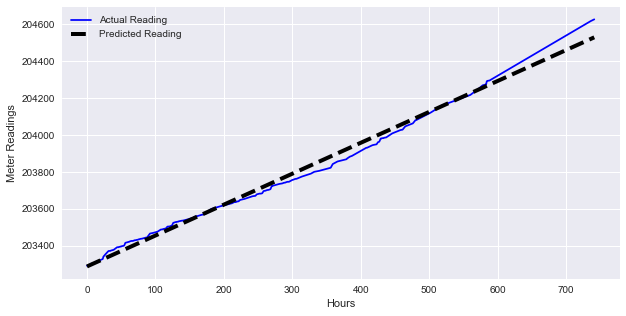

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


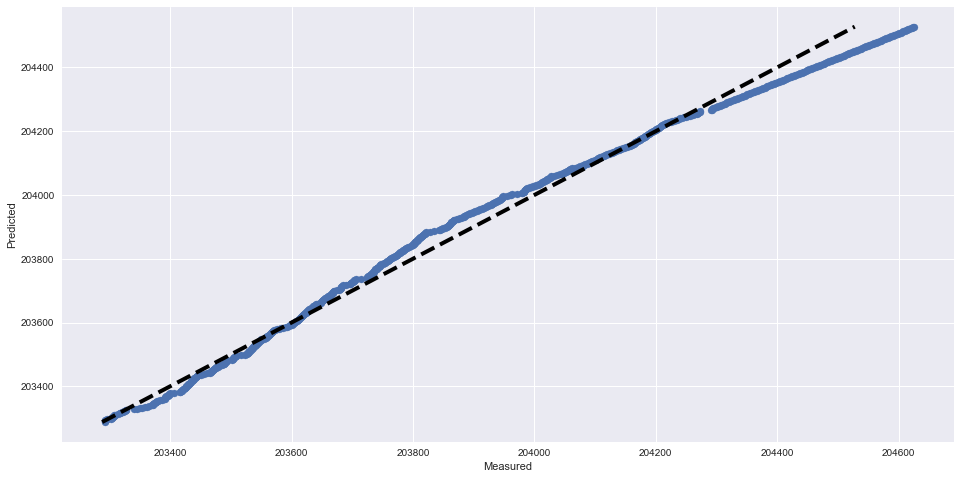

RMSE score: 38.1588247469
R2 score: 0.989609295414
---------------------------------------------------------------------------
Plotting SVR for Meter 1086
Time series plot of the actual and predicted hourly meter readings


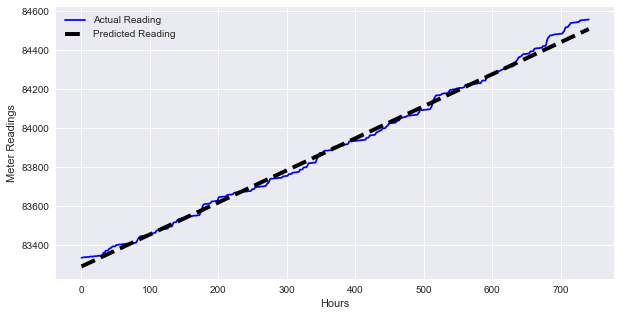

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


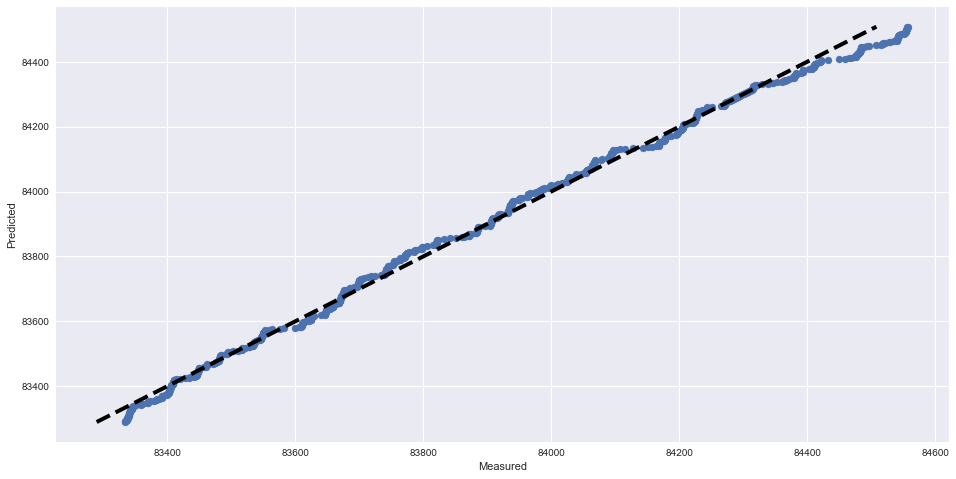

RMSE score: 23.4512255841
R2 score: 0.995728964387
---------------------------------------------------------------------------
Plotting SVR for Meter 1185
Time series plot of the actual and predicted hourly meter readings


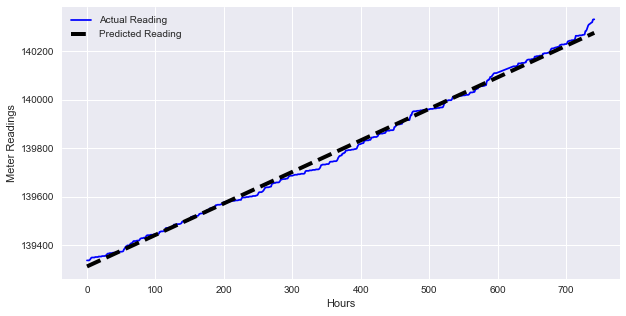

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


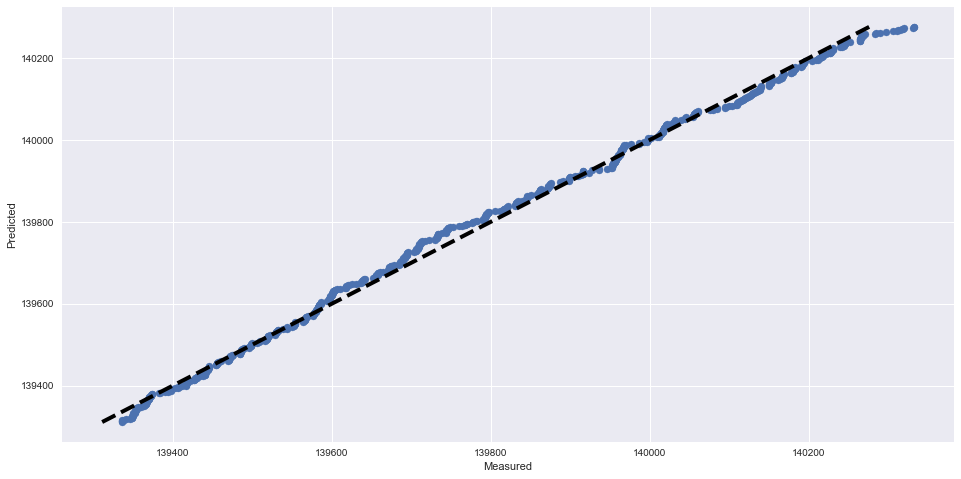

RMSE score: 16.3368795474
R2 score: 0.996650029977
---------------------------------------------------------------------------
Plotting SVR for Meter 1283
Time series plot of the actual and predicted hourly meter readings


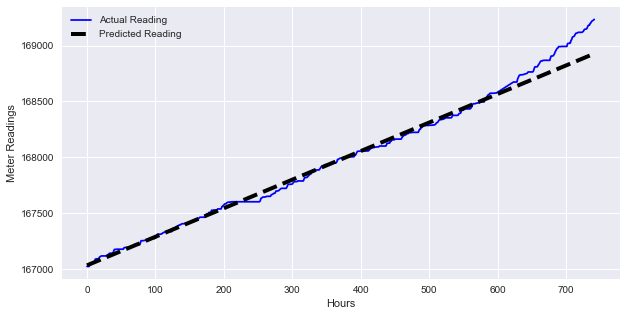

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


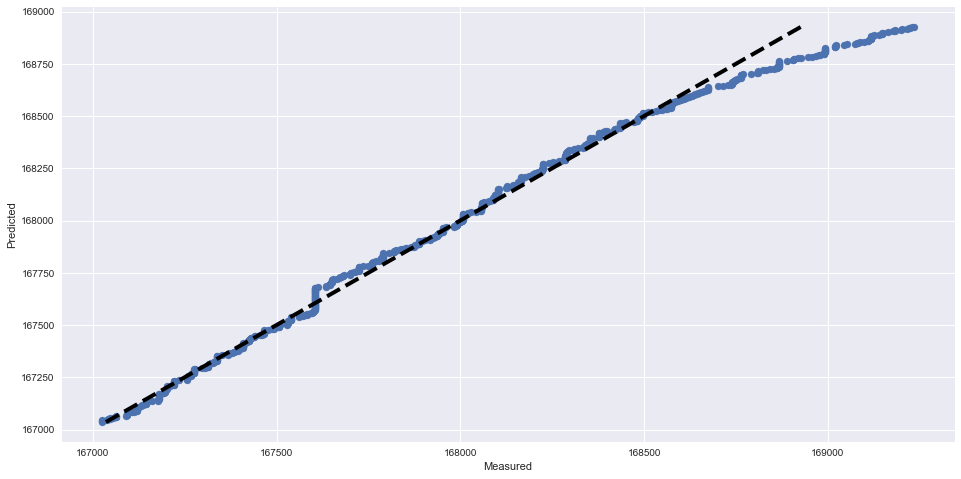

RMSE score: 74.2365552329
R2 score: 0.983981732925
---------------------------------------------------------------------------
Plotting SVR for Meter 1415
Time series plot of the actual and predicted hourly meter readings


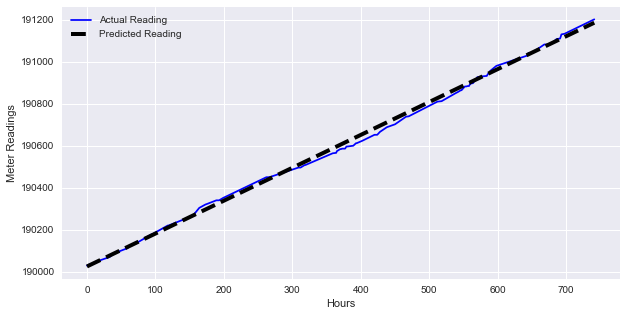

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


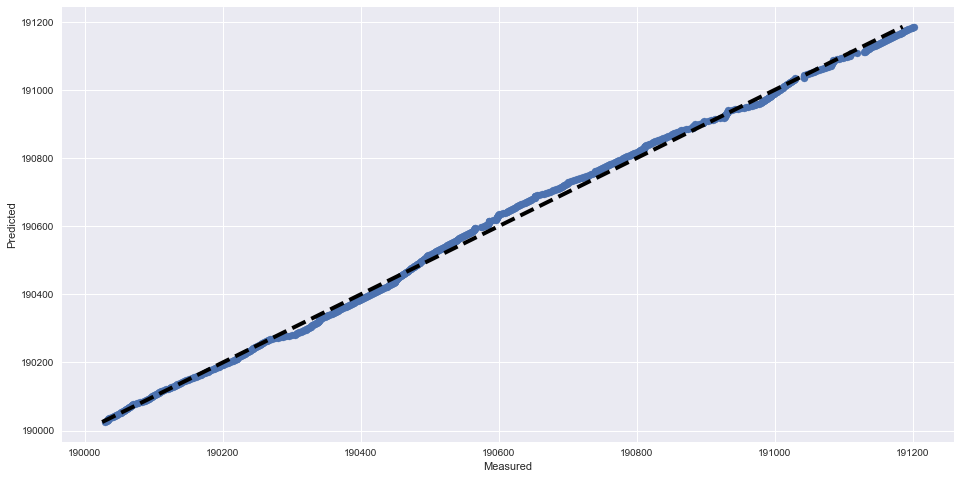

RMSE score: 15.9980645192
R2 score: 0.997710853259
---------------------------------------------------------------------------
Plotting SVR for Meter 1507
Time series plot of the actual and predicted hourly meter readings


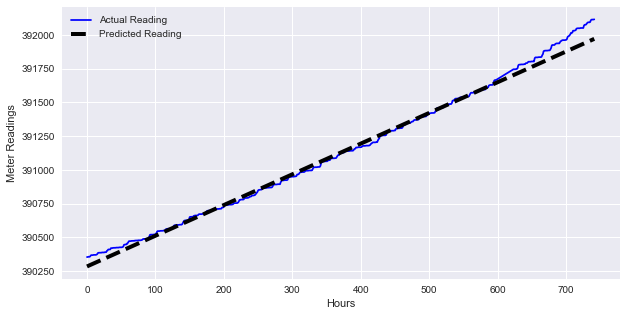

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


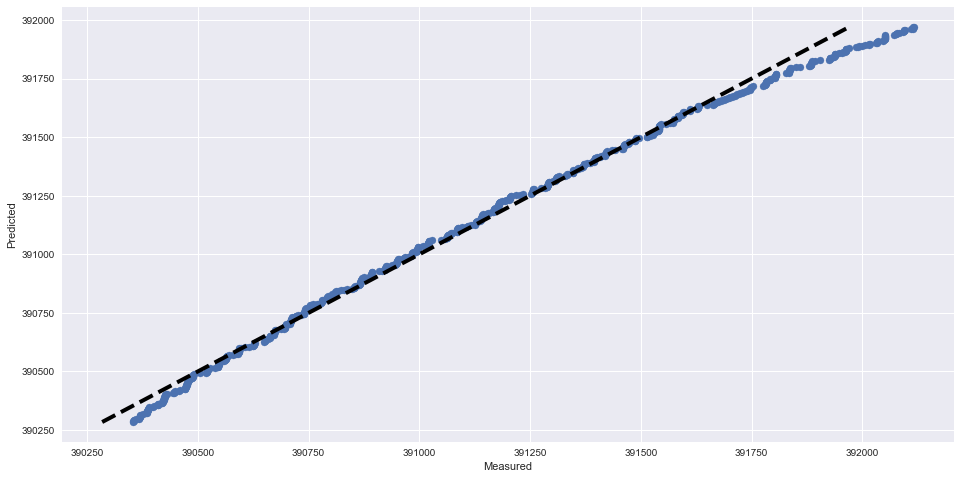

RMSE score: 43.1458829548
R2 score: 0.99264766161
---------------------------------------------------------------------------
Plotting SVR for Meter 1556
Time series plot of the actual and predicted hourly meter readings


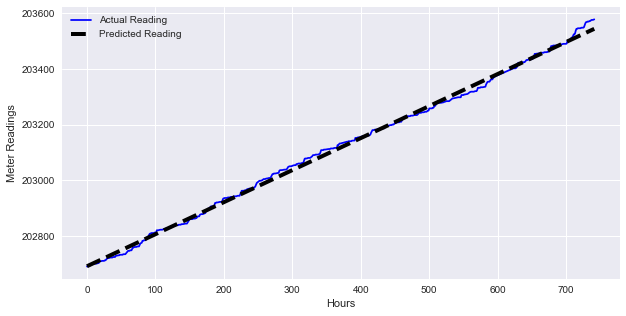

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


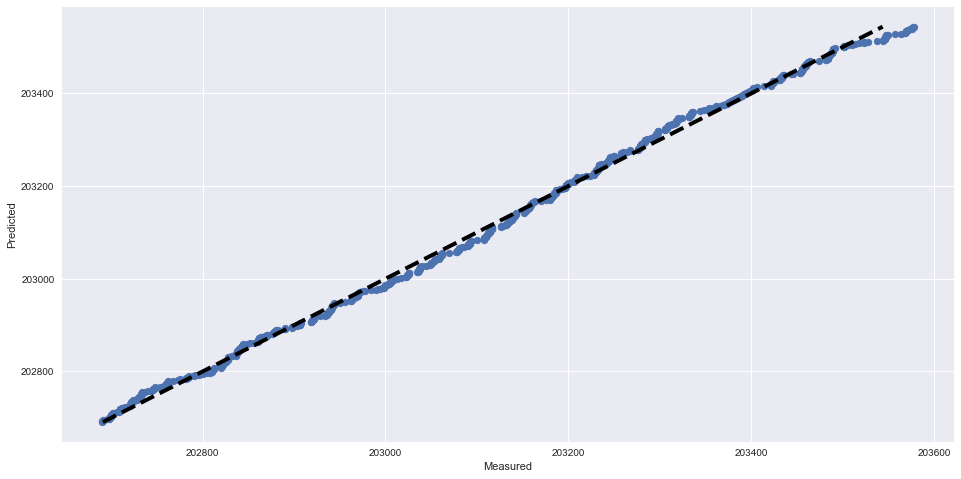

RMSE score: 12.167665889
R2 score: 0.997588741503
---------------------------------------------------------------------------
Plotting SVR for Meter 1589
Time series plot of the actual and predicted hourly meter readings


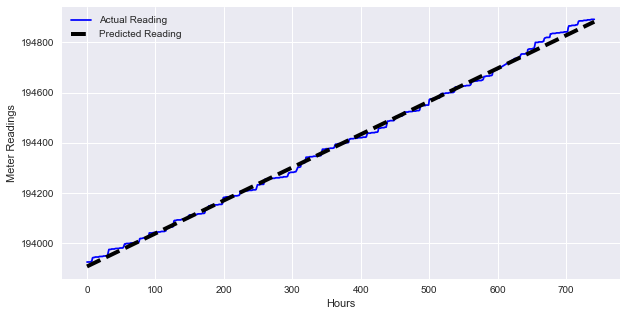

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


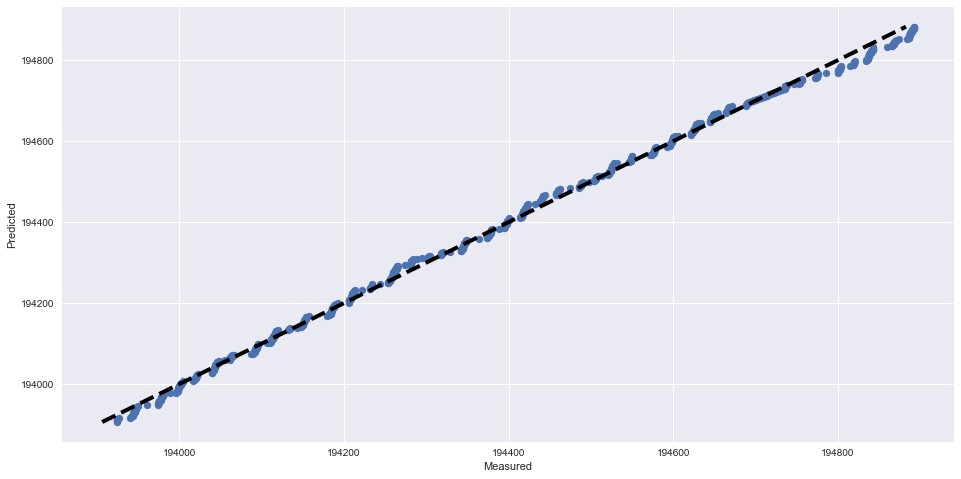

RMSE score: 12.6788197409
R2 score: 0.998012768977
---------------------------------------------------------------------------
Plotting SVR for Meter 1619
Time series plot of the actual and predicted hourly meter readings


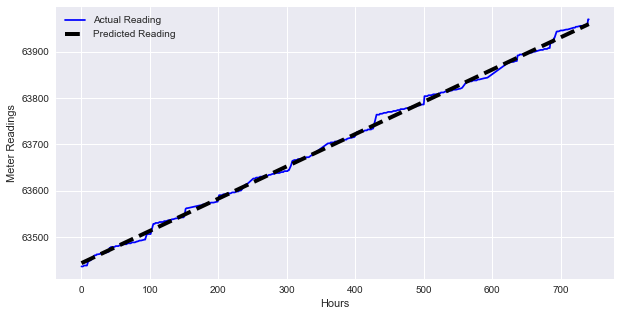

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


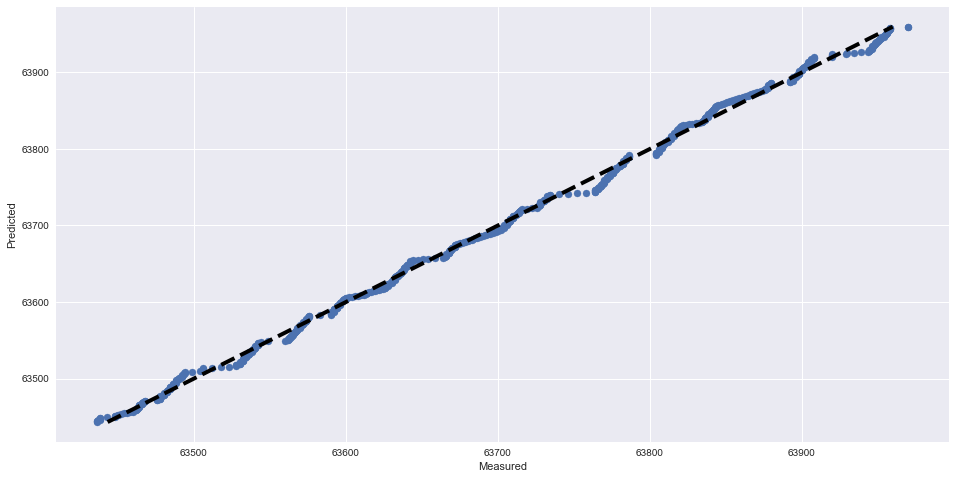

RMSE score: 6.56731289649
R2 score: 0.998077146803
---------------------------------------------------------------------------
Plotting SVR for Meter 1697
Time series plot of the actual and predicted hourly meter readings


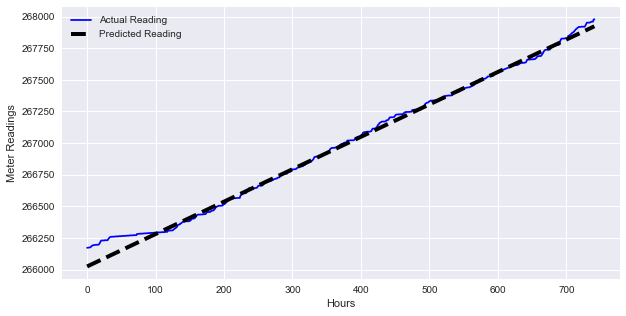

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


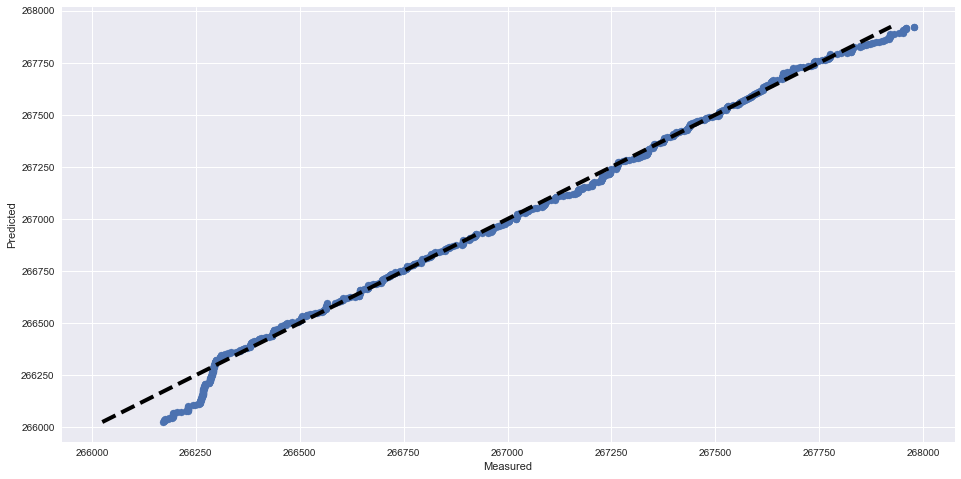

RMSE score: 43.824052673
R2 score: 0.993290917192
---------------------------------------------------------------------------
Plotting SVR for Meter 1714
Time series plot of the actual and predicted hourly meter readings


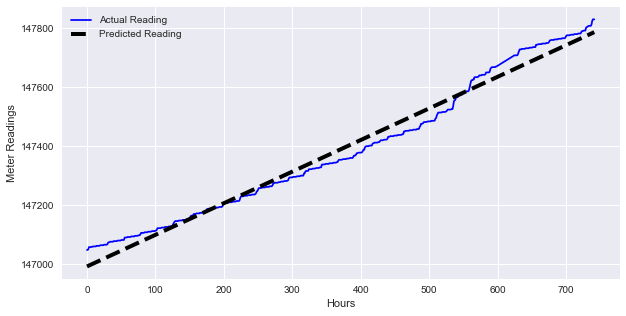

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


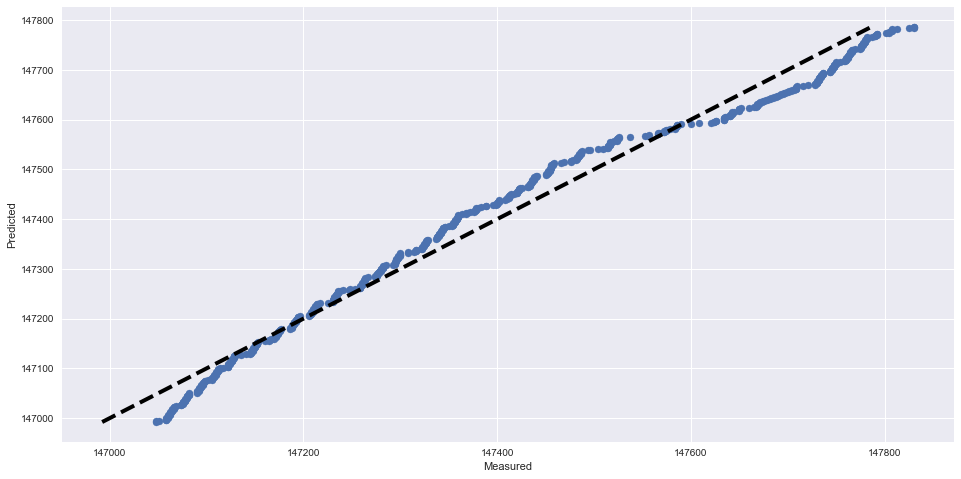

RMSE score: 31.990932179
R2 score: 0.981037809542
---------------------------------------------------------------------------
Plotting SVR for Meter 1718
Time series plot of the actual and predicted hourly meter readings


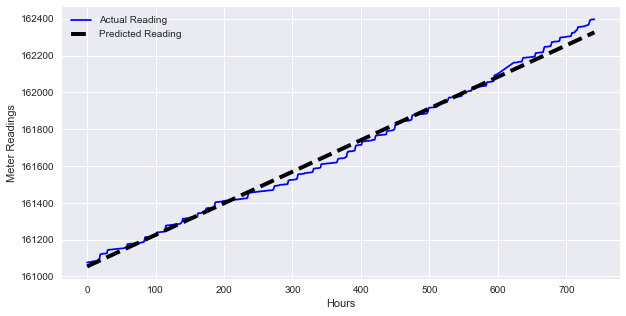

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


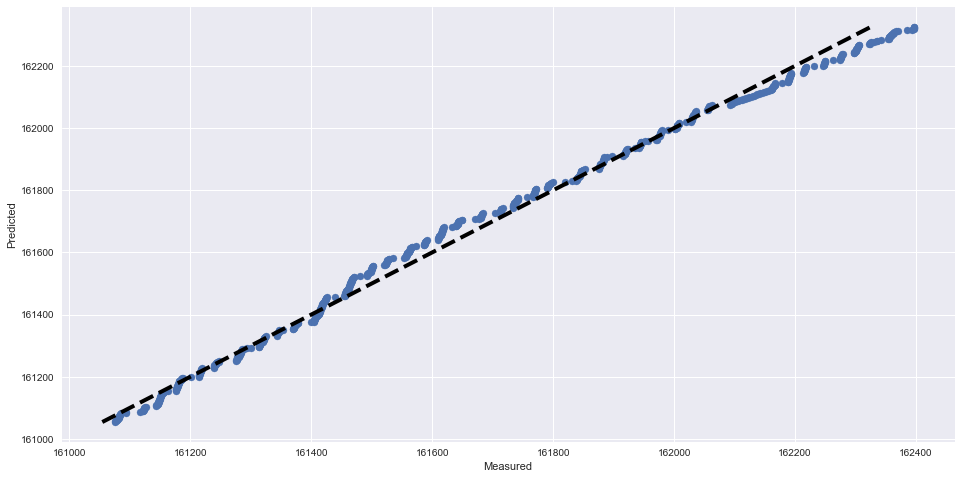

RMSE score: 29.3921801102
R2 score: 0.993939879423
---------------------------------------------------------------------------
Plotting SVR for Meter 1790
Time series plot of the actual and predicted hourly meter readings


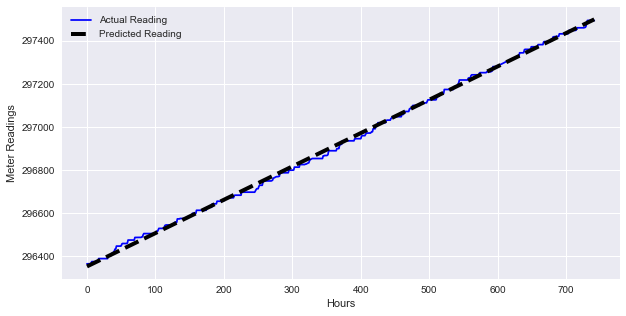

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


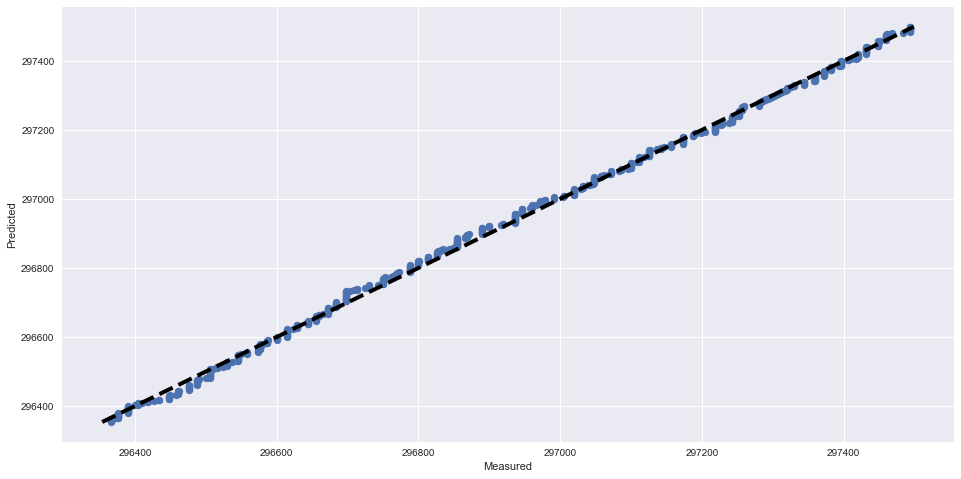

RMSE score: 12.0146011108
R2 score: 0.99867833477
---------------------------------------------------------------------------
Plotting SVR for Meter 1791
Time series plot of the actual and predicted hourly meter readings


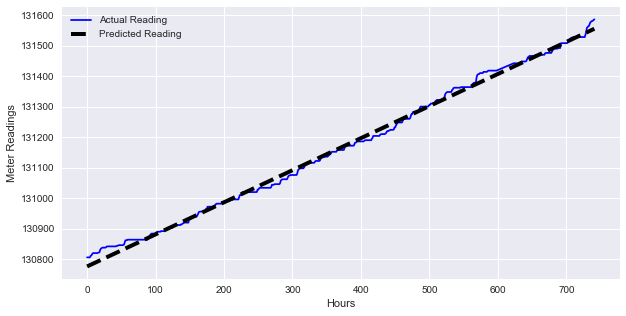

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


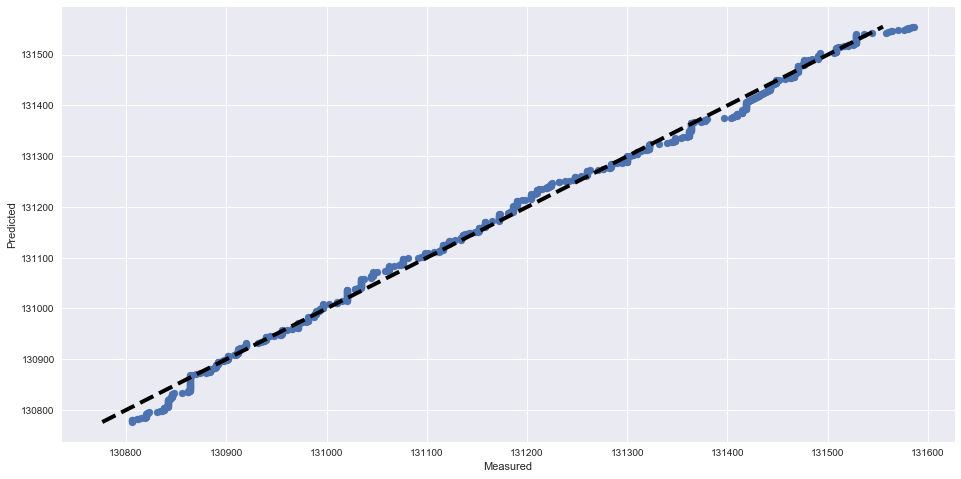

RMSE score: 13.8056825619
R2 score: 0.996208984658
---------------------------------------------------------------------------
Plotting SVR for Meter 1792
Time series plot of the actual and predicted hourly meter readings


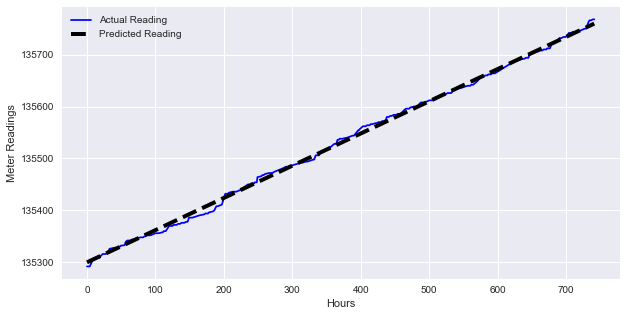

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


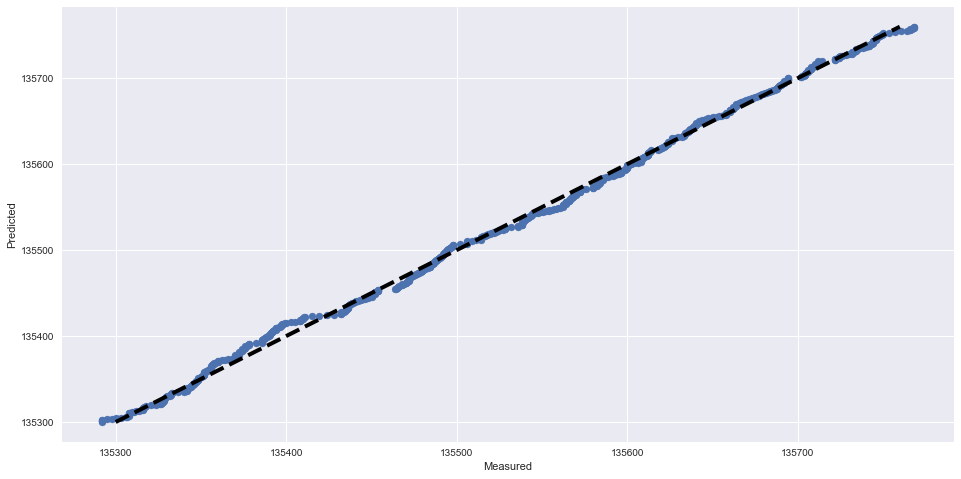

RMSE score: 5.68643597612
R2 score: 0.998204615941
---------------------------------------------------------------------------
Plotting SVR for Meter 1800
Time series plot of the actual and predicted hourly meter readings


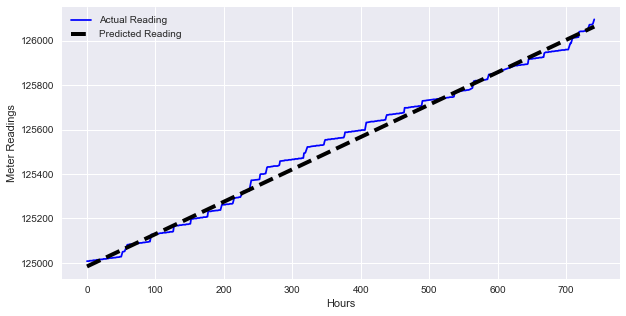

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


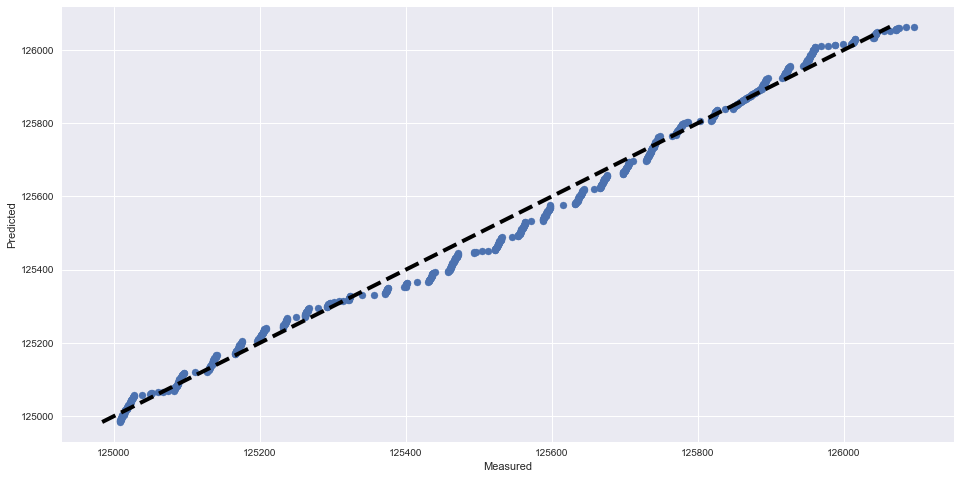

RMSE score: 28.5816838859
R2 score: 0.991591988211
---------------------------------------------------------------------------
Plotting SVR for Meter 1801
Time series plot of the actual and predicted hourly meter readings


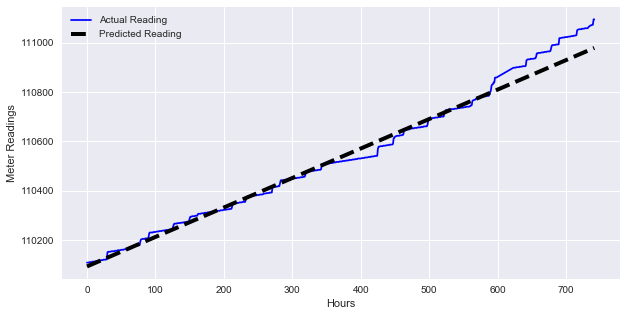

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


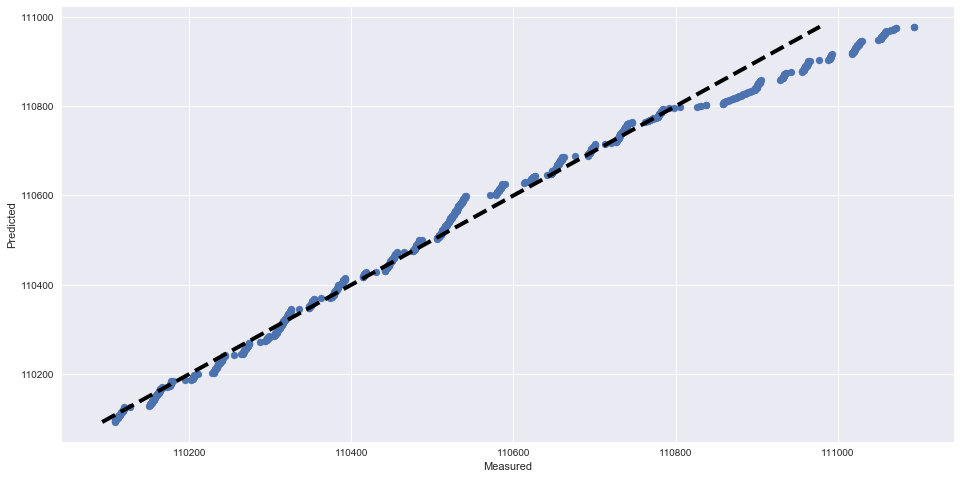

RMSE score: 37.3920002303
R2 score: 0.981515161013
---------------------------------------------------------------------------
Plotting SVR for Meter 2018
Time series plot of the actual and predicted hourly meter readings


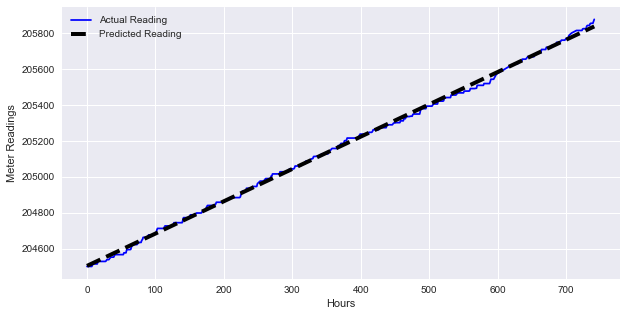

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


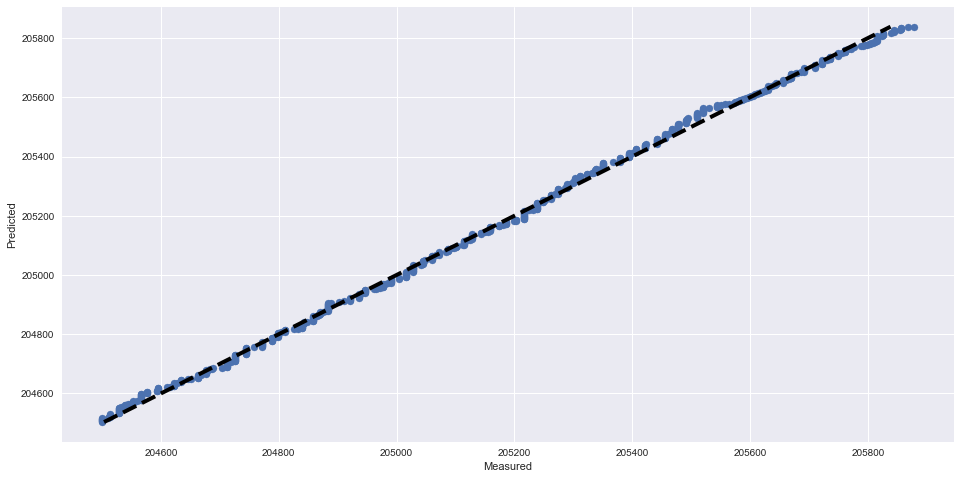

RMSE score: 13.6880274755
R2 score: 0.998745120909
---------------------------------------------------------------------------
Plotting SVR for Meter 2034
Time series plot of the actual and predicted hourly meter readings


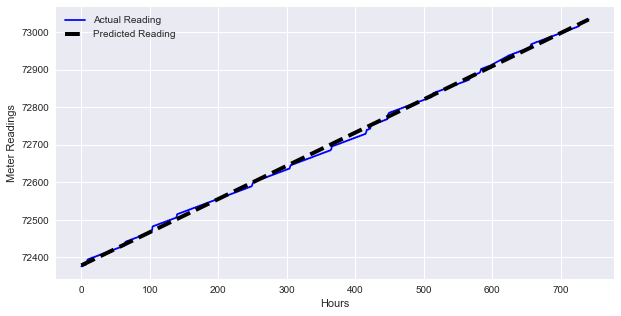

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


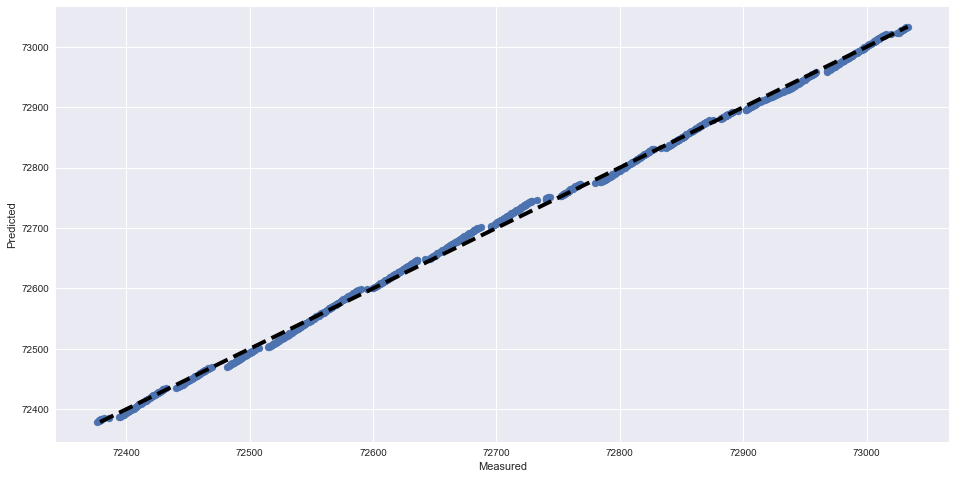

RMSE score: 6.3600630624
R2 score: 0.998867927727
---------------------------------------------------------------------------
Plotting SVR for Meter 2072
Time series plot of the actual and predicted hourly meter readings


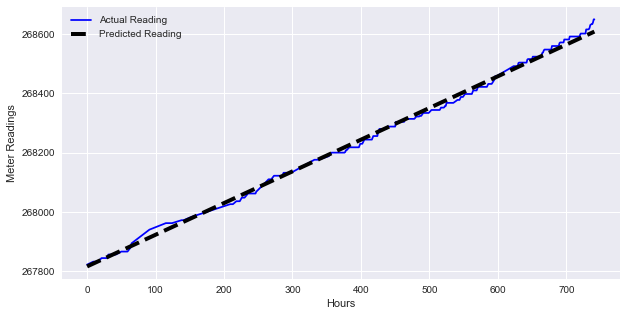

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


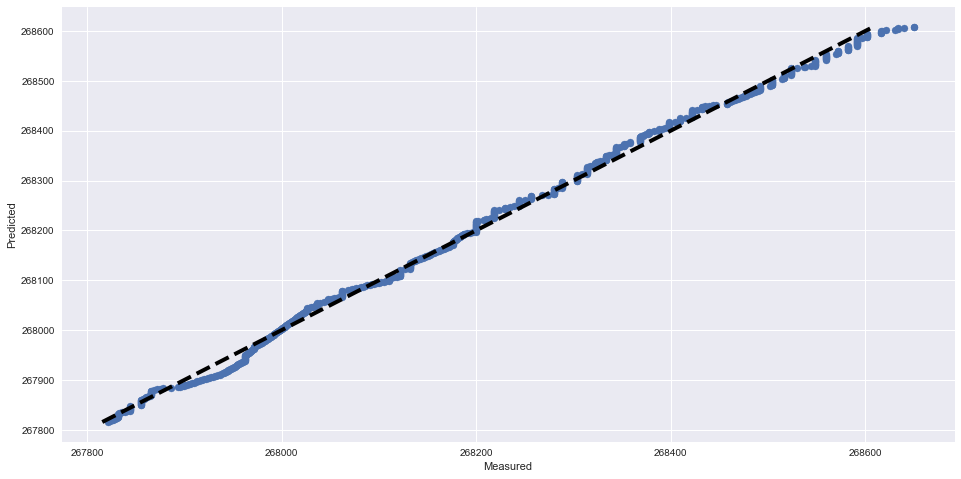

RMSE score: 11.9620763533
R2 score: 0.997272083097
---------------------------------------------------------------------------
Plotting SVR for Meter 2094
Time series plot of the actual and predicted hourly meter readings


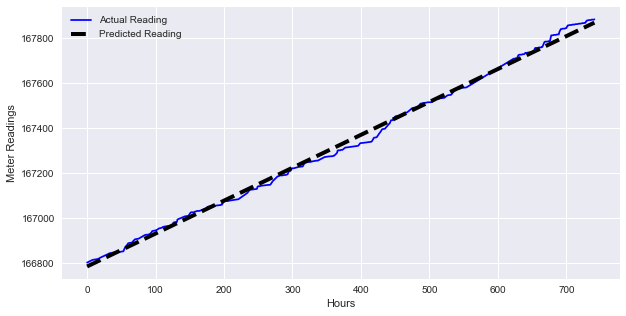

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


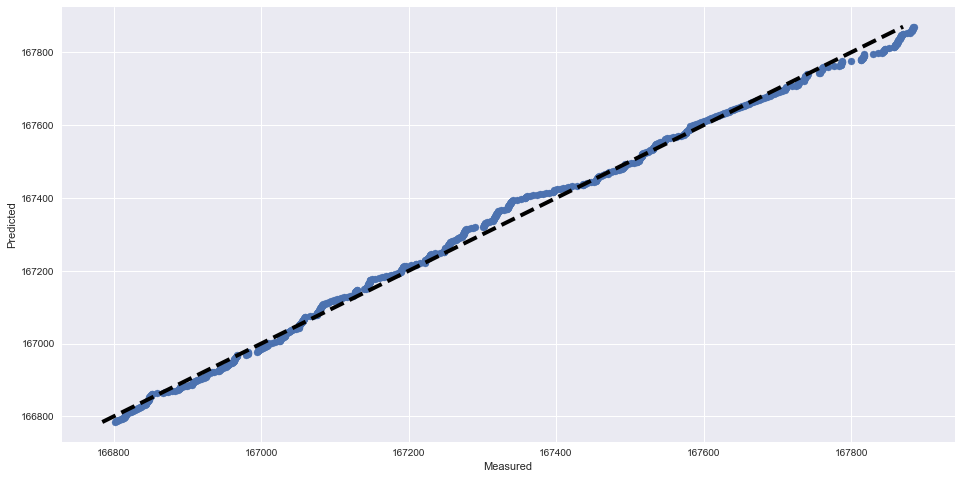

RMSE score: 18.4892723393
R2 score: 0.99659562213
---------------------------------------------------------------------------
Plotting SVR for Meter 2129
Time series plot of the actual and predicted hourly meter readings


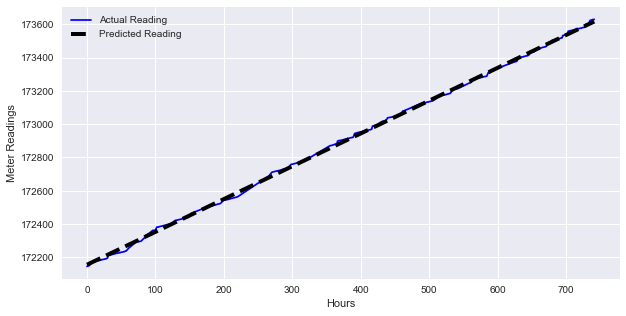

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


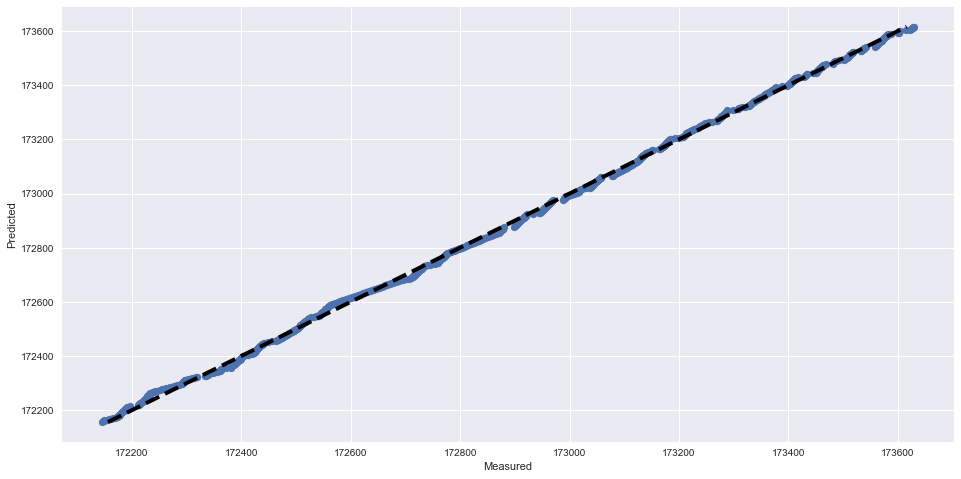

RMSE score: 10.6630443116
R2 score: 0.999365416997
---------------------------------------------------------------------------
Plotting SVR for Meter 2233
Time series plot of the actual and predicted hourly meter readings


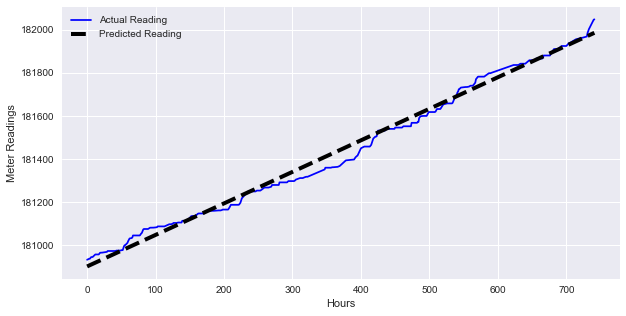

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


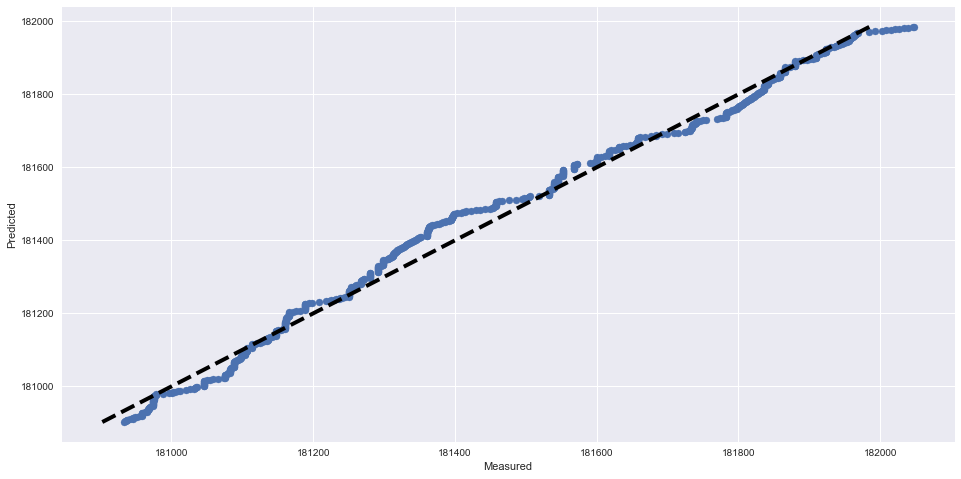

RMSE score: 31.3492615804
R2 score: 0.989985785127
---------------------------------------------------------------------------
Plotting SVR for Meter 2335
Time series plot of the actual and predicted hourly meter readings


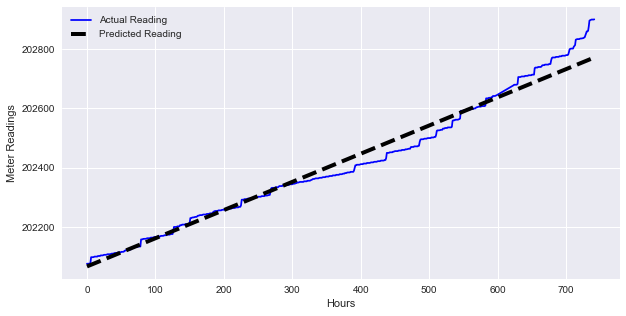

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


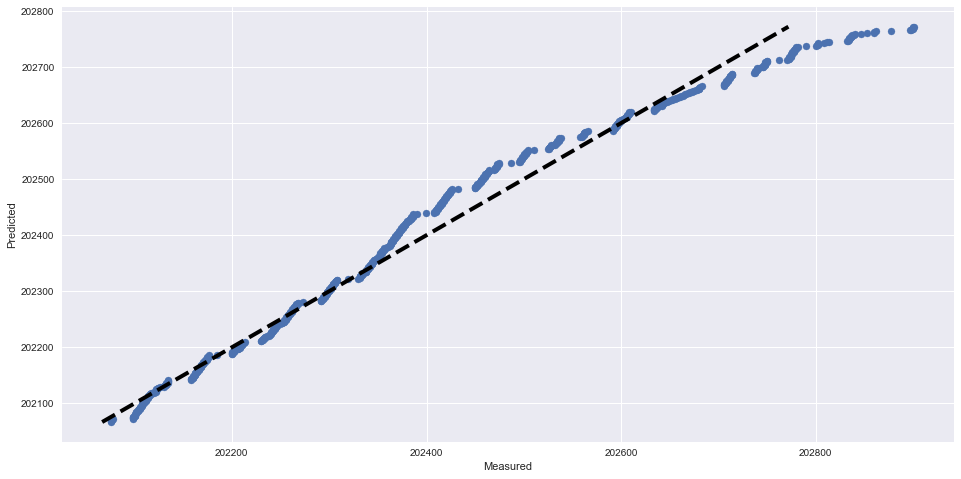

RMSE score: 33.9598849482
R2 score: 0.975035592741
---------------------------------------------------------------------------
Plotting SVR for Meter 2378
Time series plot of the actual and predicted hourly meter readings


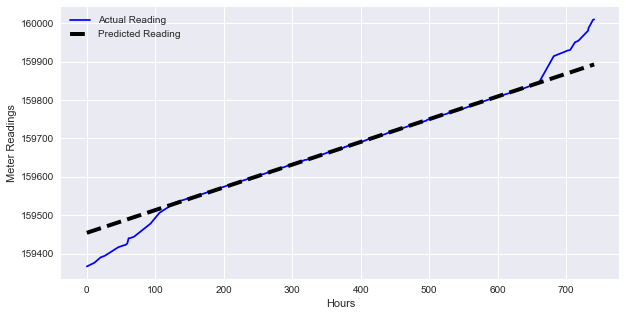

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


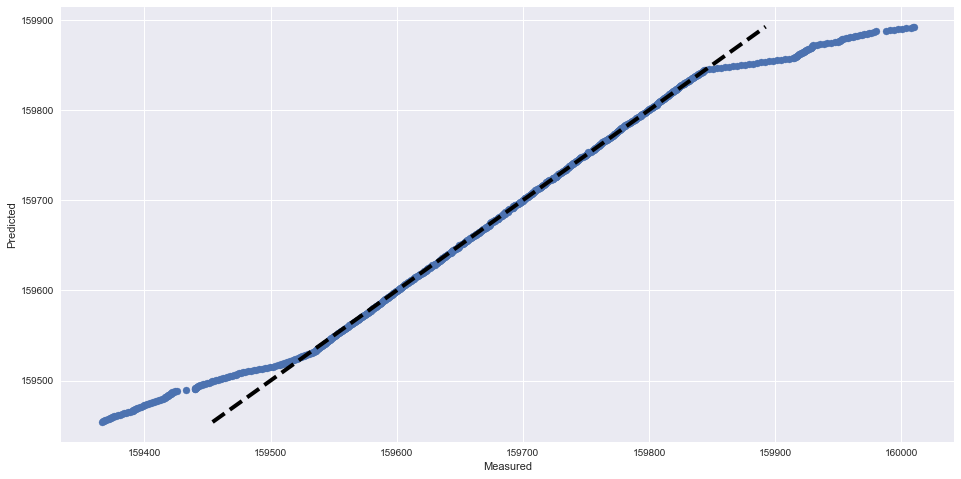

RMSE score: 32.4516958589
R2 score: 0.954243221458
---------------------------------------------------------------------------
Plotting SVR for Meter 2449
Time series plot of the actual and predicted hourly meter readings


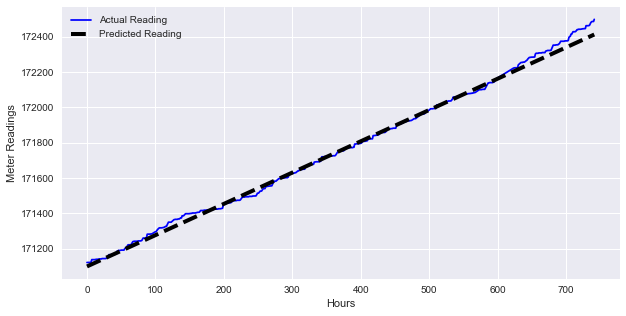

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


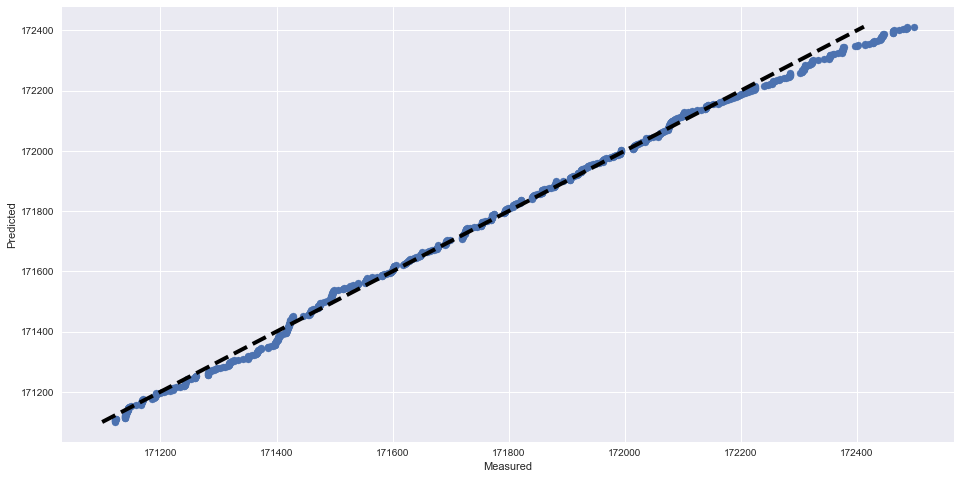

RMSE score: 23.3592998128
R2 score: 0.99633901719
---------------------------------------------------------------------------
Plotting SVR for Meter 2461
Time series plot of the actual and predicted hourly meter readings


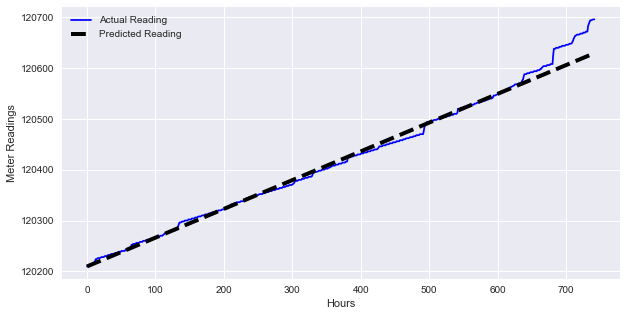

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


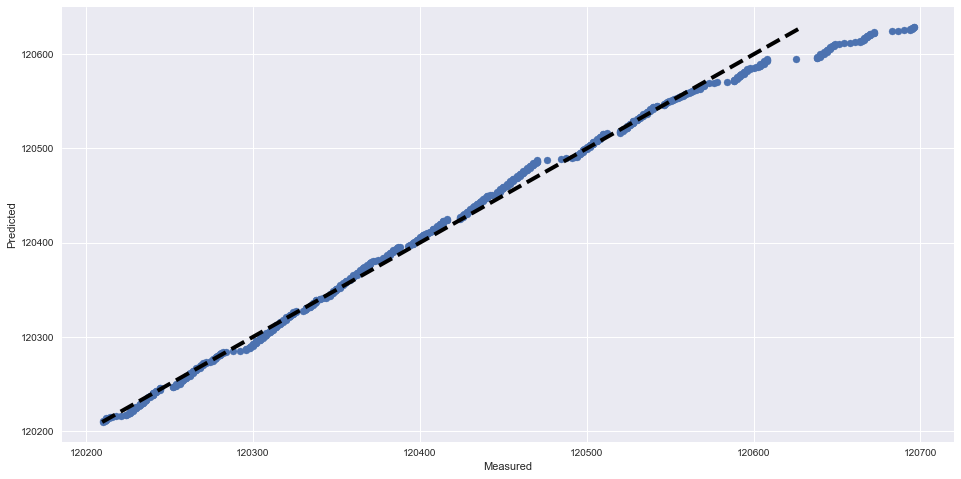

RMSE score: 15.1706023101
R2 score: 0.985983560845
---------------------------------------------------------------------------
Plotting SVR for Meter 2470
Time series plot of the actual and predicted hourly meter readings


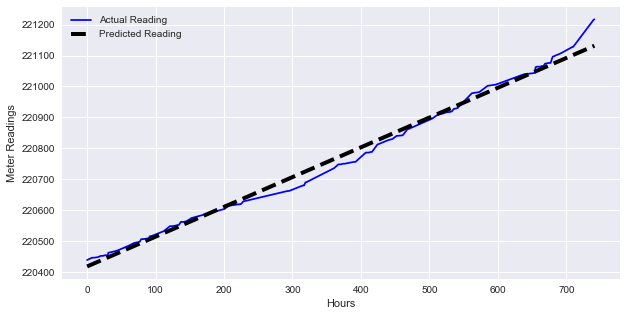

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


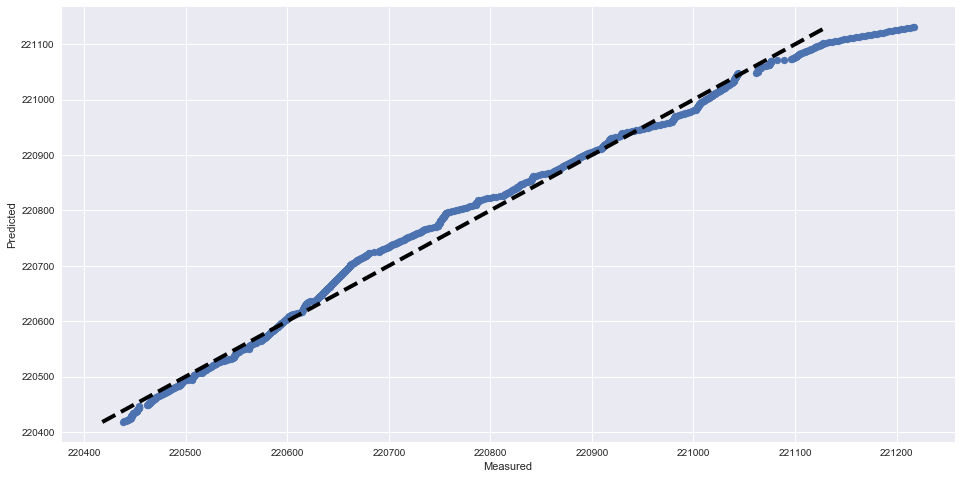

RMSE score: 22.3567250893
R2 score: 0.988968450044
---------------------------------------------------------------------------
Plotting SVR for Meter 2575
Time series plot of the actual and predicted hourly meter readings


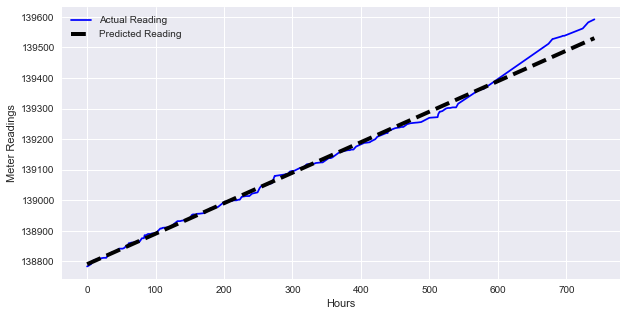

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


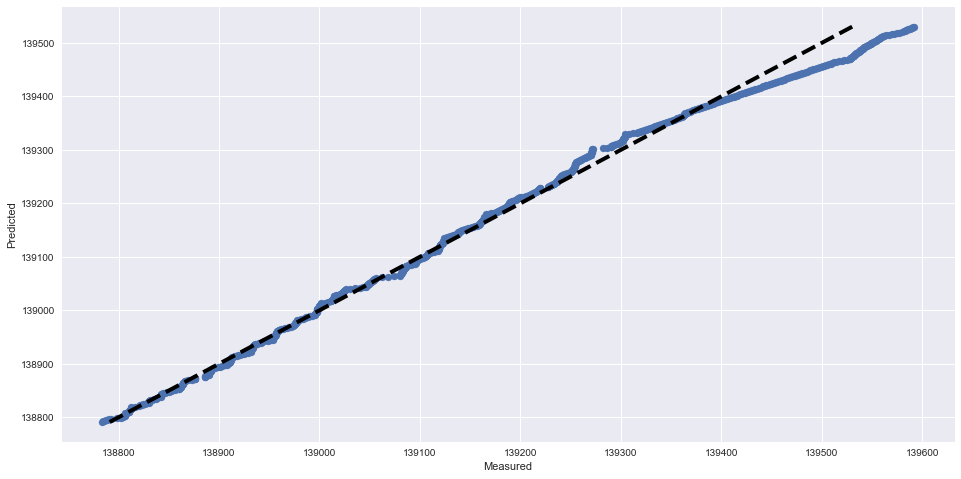

RMSE score: 20.531251188
R2 score: 0.991556409975
---------------------------------------------------------------------------
Plotting SVR for Meter 2638
Time series plot of the actual and predicted hourly meter readings


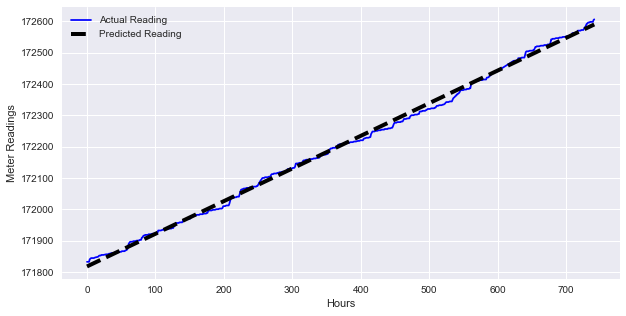

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


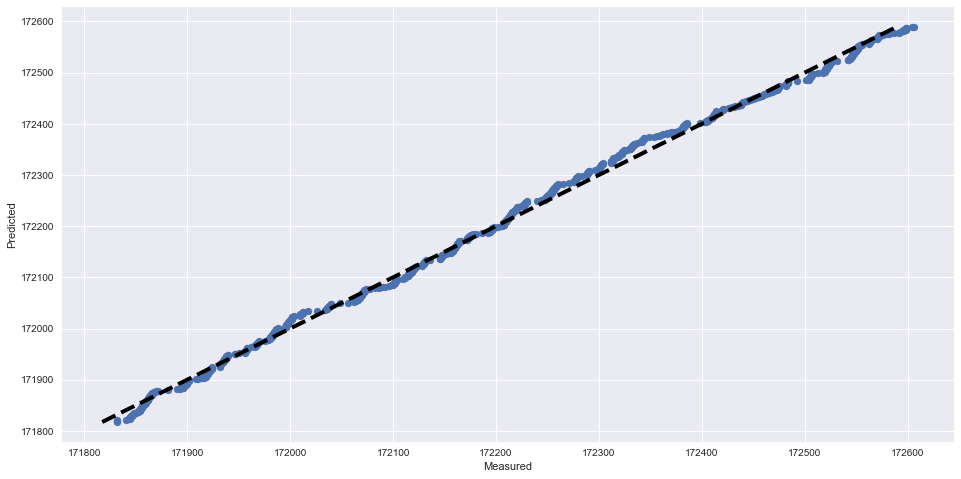

RMSE score: 10.9320063272
R2 score: 0.997587227022
---------------------------------------------------------------------------
Plotting SVR for Meter 2645
Time series plot of the actual and predicted hourly meter readings


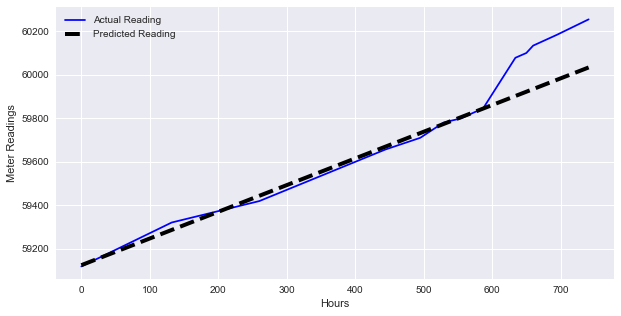

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


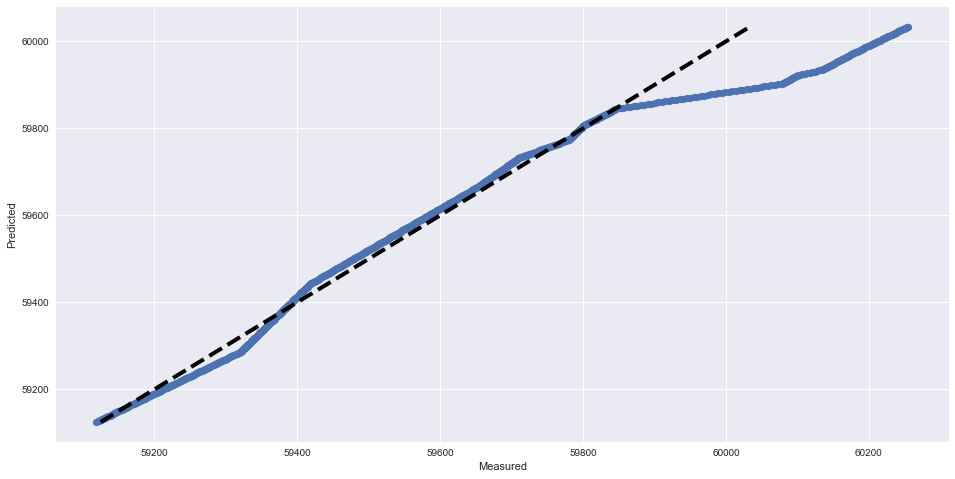

RMSE score: 82.8643598428
R2 score: 0.93051448399
---------------------------------------------------------------------------
Plotting SVR for Meter 2965
Time series plot of the actual and predicted hourly meter readings


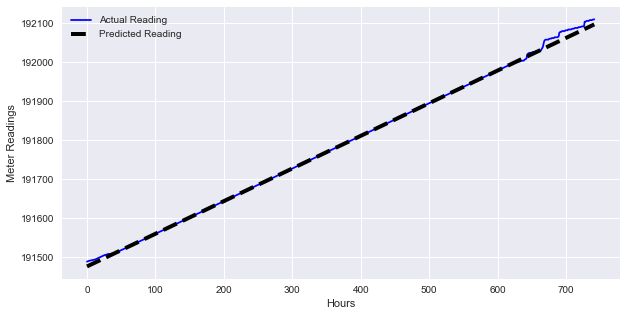

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


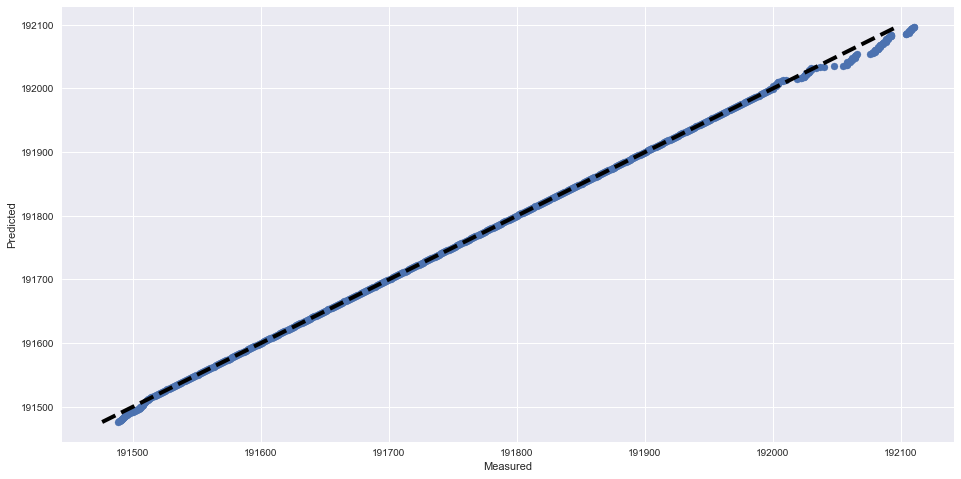

RMSE score: 5.58863554409
R2 score: 0.999050751641
---------------------------------------------------------------------------
Plotting SVR for Meter 2980
Time series plot of the actual and predicted hourly meter readings


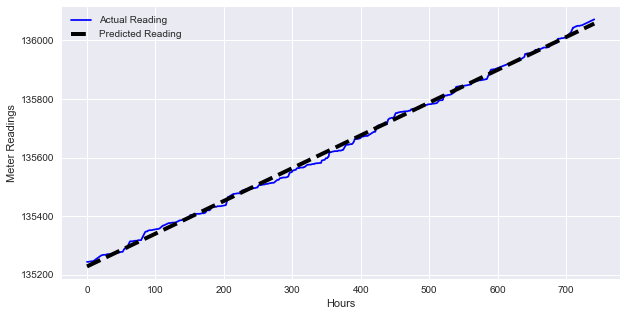

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


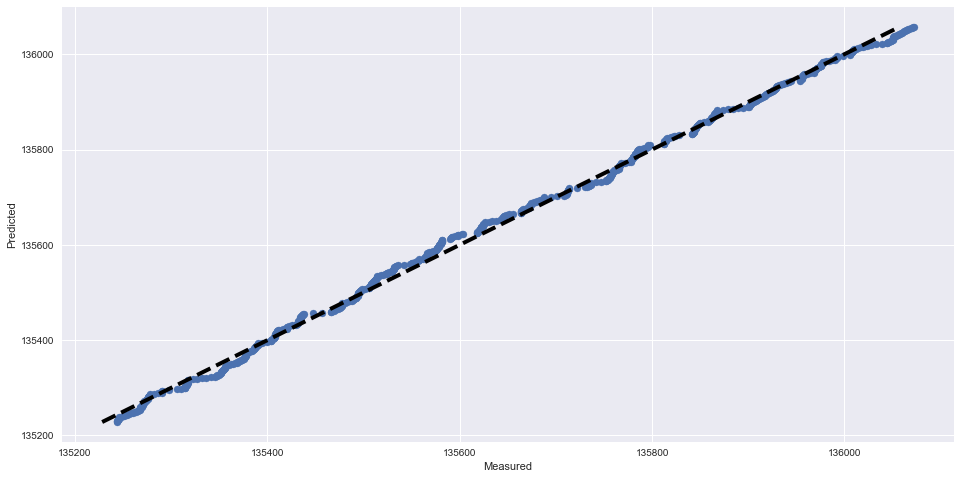

RMSE score: 10.6665230209
R2 score: 0.998023702221
---------------------------------------------------------------------------
Plotting SVR for Meter 3039
Time series plot of the actual and predicted hourly meter readings


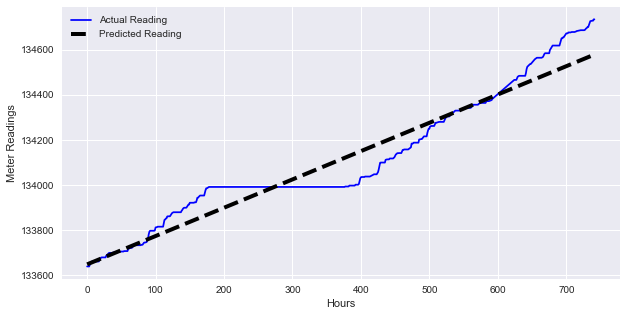

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


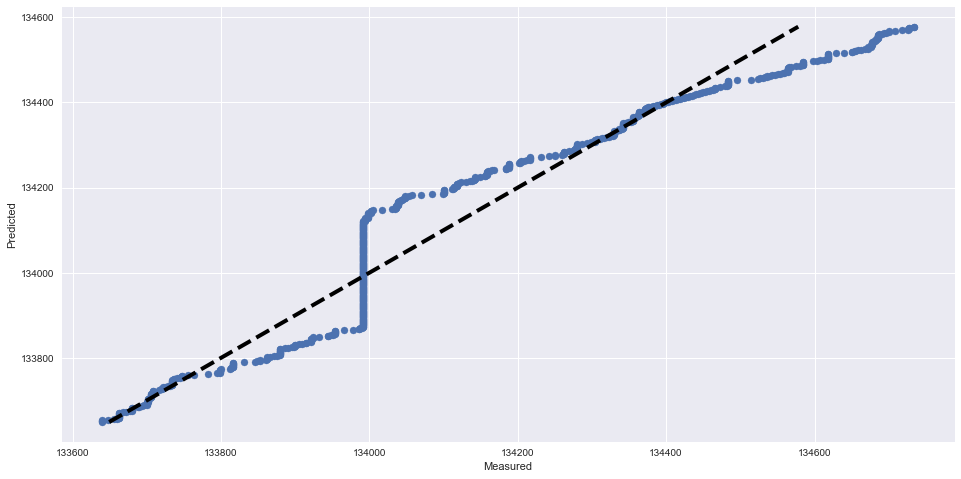

RMSE score: 74.9551006332
R2 score: 0.931523565123
---------------------------------------------------------------------------
Plotting SVR for Meter 3134
Time series plot of the actual and predicted hourly meter readings


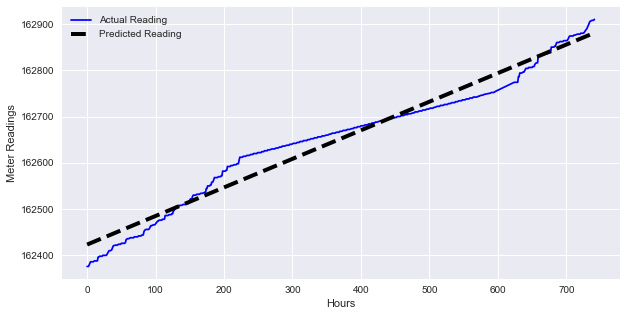

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


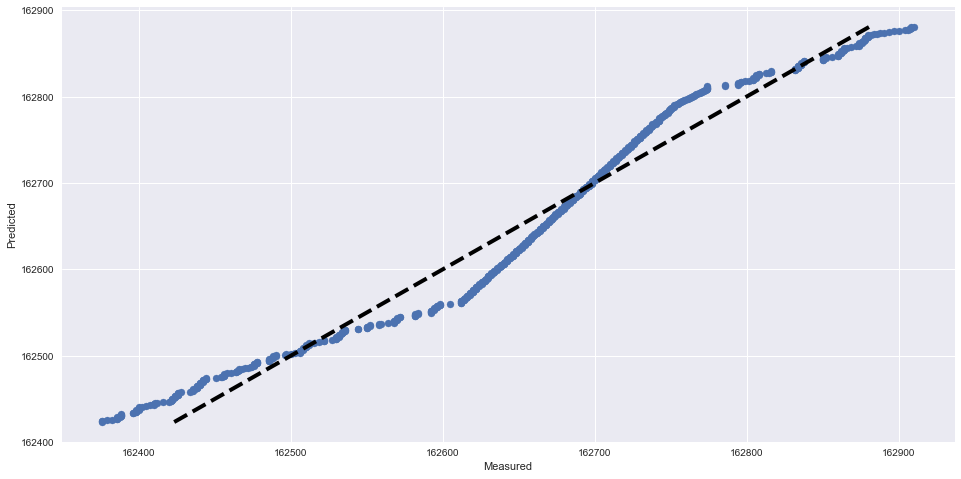

RMSE score: 25.5772655456
R2 score: 0.963028525883
---------------------------------------------------------------------------
Plotting SVR for Meter 3367
Time series plot of the actual and predicted hourly meter readings


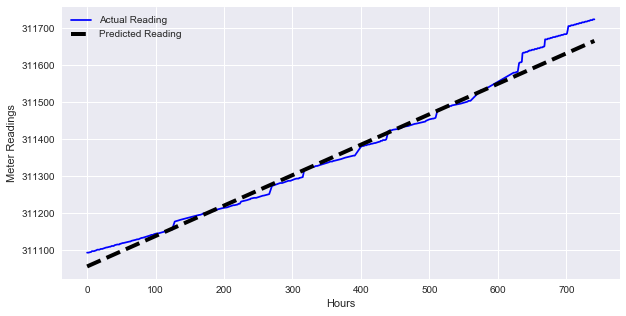

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


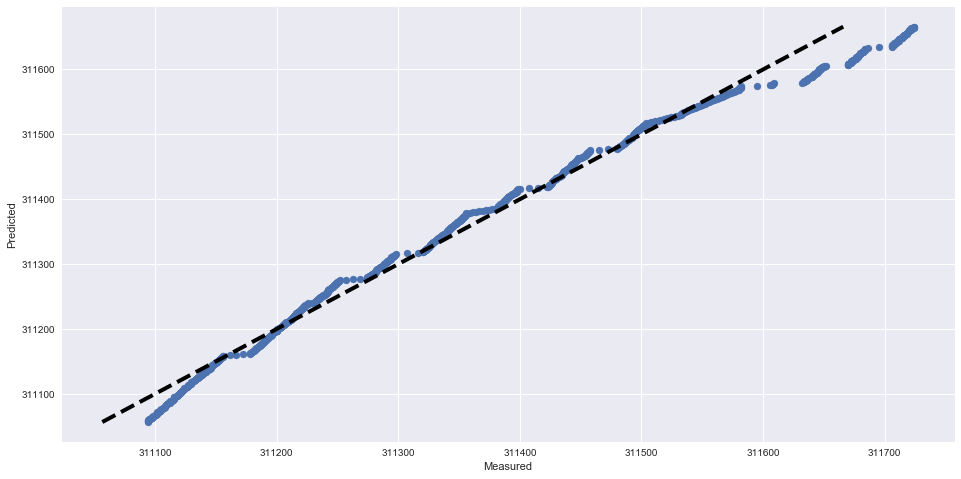

RMSE score: 25.1502421378
R2 score: 0.981644174748
---------------------------------------------------------------------------
Plotting SVR for Meter 3527
Time series plot of the actual and predicted hourly meter readings


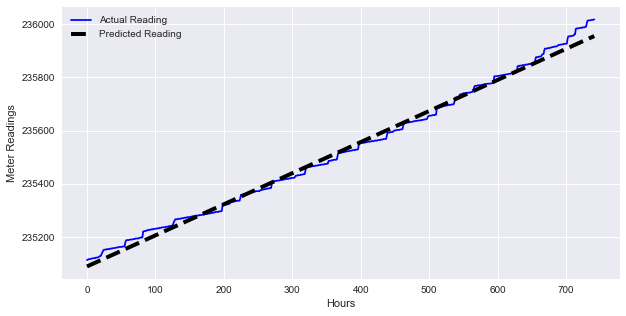

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


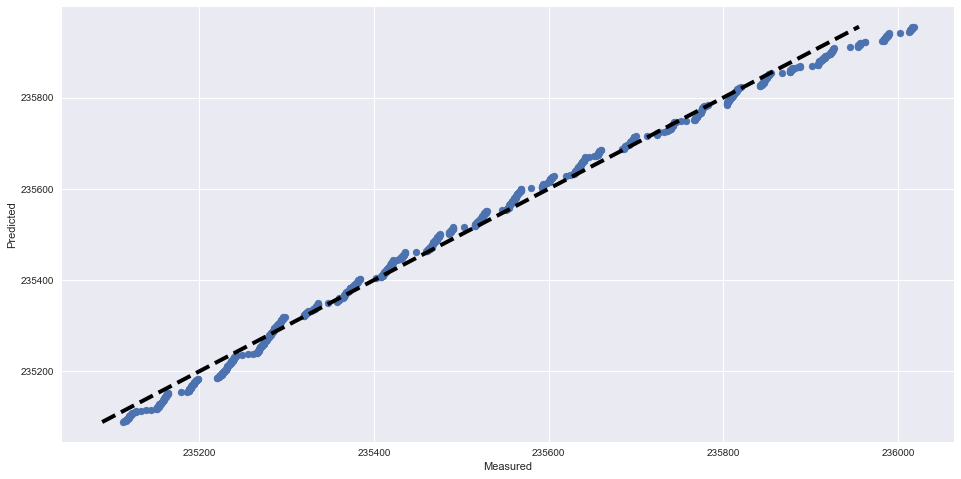

RMSE score: 20.4781613465
R2 score: 0.993445252046
---------------------------------------------------------------------------
Plotting SVR for Meter 3544
Time series plot of the actual and predicted hourly meter readings


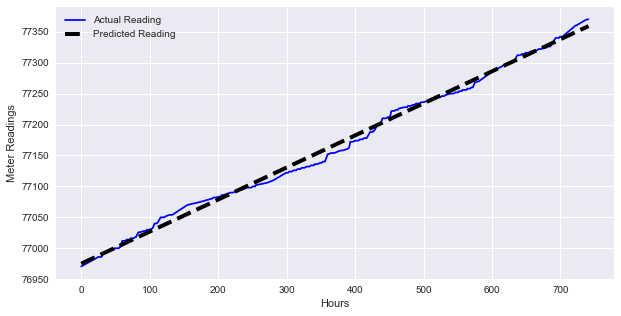

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


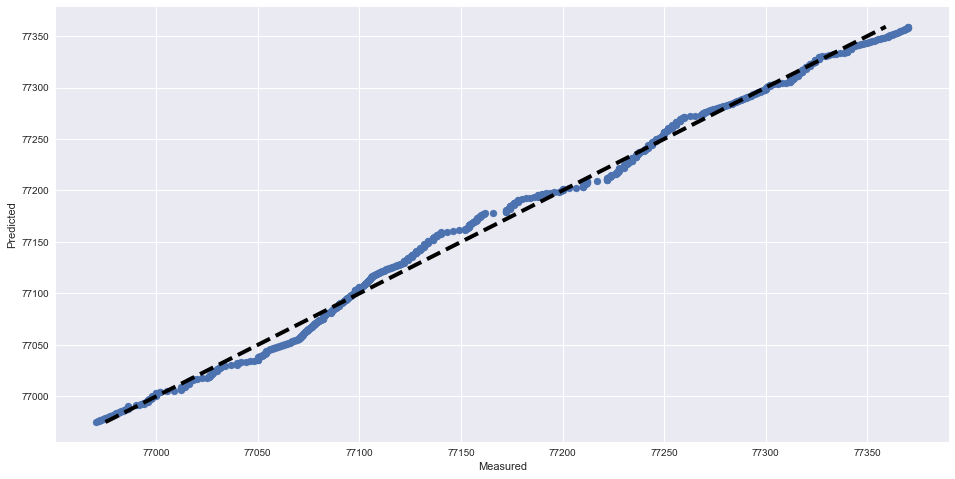

RMSE score: 8.13007140953
R2 score: 0.994625231938
---------------------------------------------------------------------------
Plotting SVR for Meter 3577
Time series plot of the actual and predicted hourly meter readings


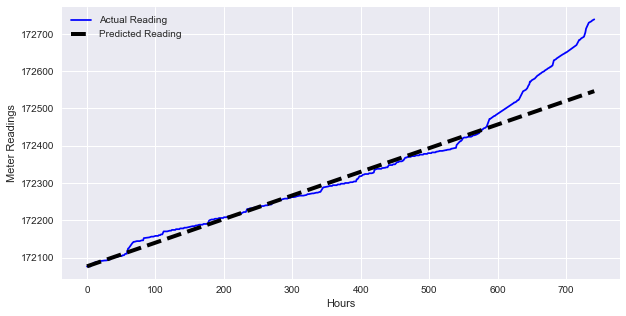

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


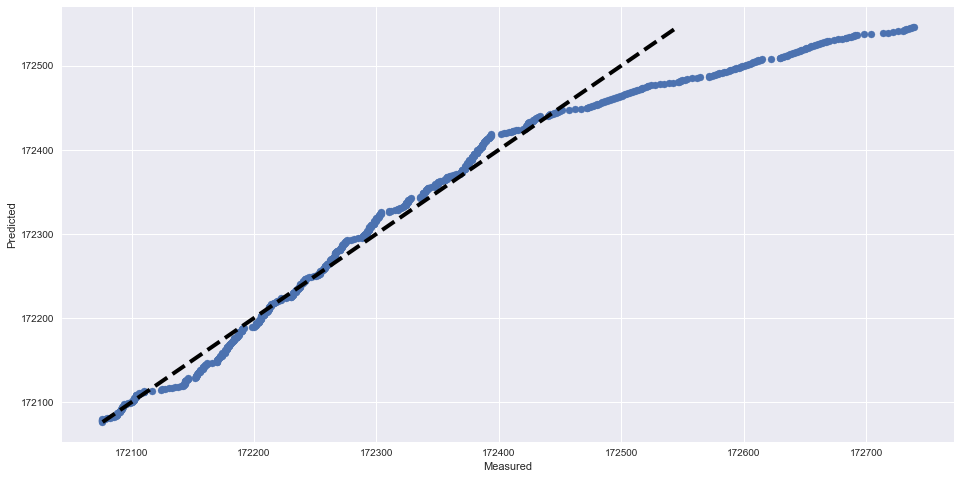

RMSE score: 50.1443661288
R2 score: 0.90840926827
---------------------------------------------------------------------------
Plotting SVR for Meter 3635
Time series plot of the actual and predicted hourly meter readings


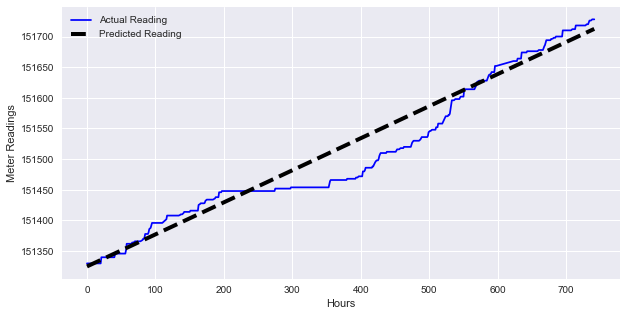

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


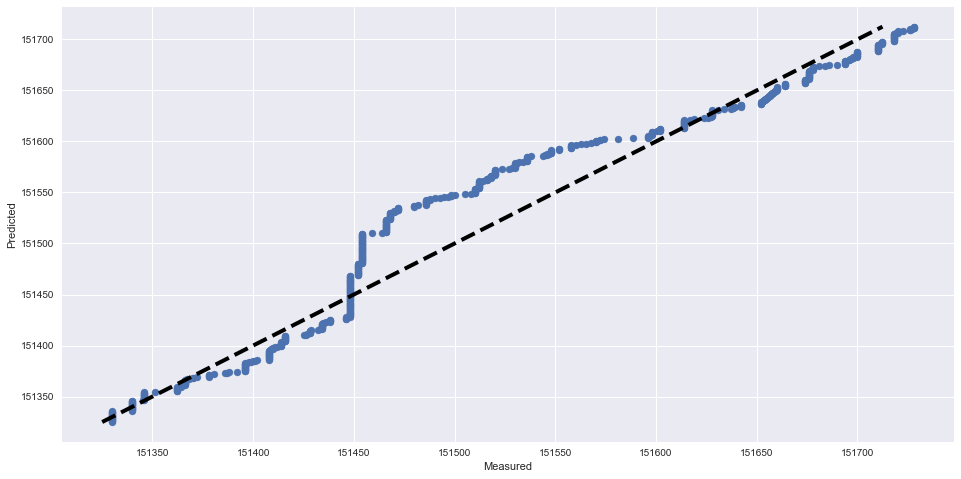

RMSE score: 28.3548890406
R2 score: 0.937656700887
---------------------------------------------------------------------------
Plotting SVR for Meter 3723
Time series plot of the actual and predicted hourly meter readings


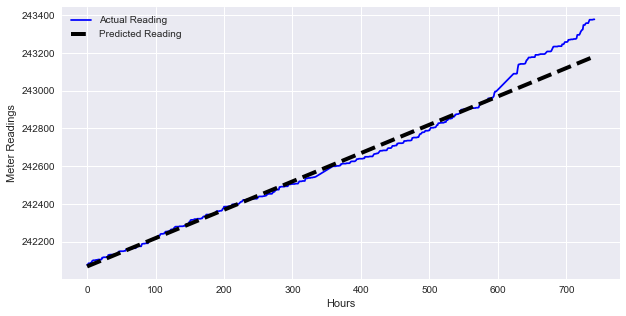

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


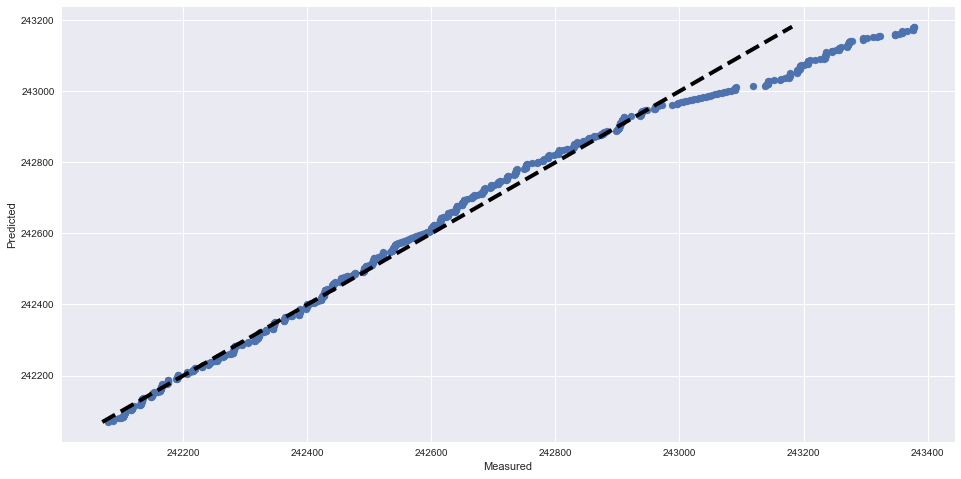

RMSE score: 60.3453204872
R2 score: 0.971337175043
---------------------------------------------------------------------------
Plotting SVR for Meter 3778
Time series plot of the actual and predicted hourly meter readings


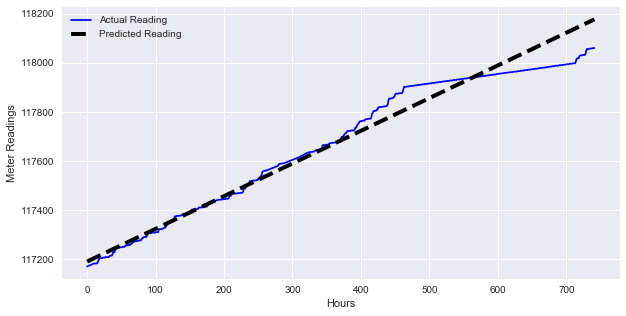

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


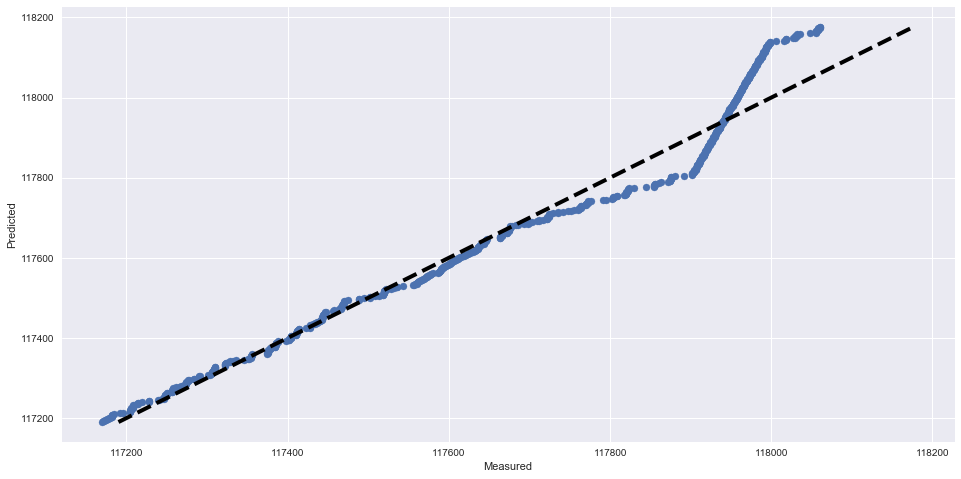

RMSE score: 52.0983395464
R2 score: 0.9629435745
---------------------------------------------------------------------------
Plotting SVR for Meter 3849
Time series plot of the actual and predicted hourly meter readings


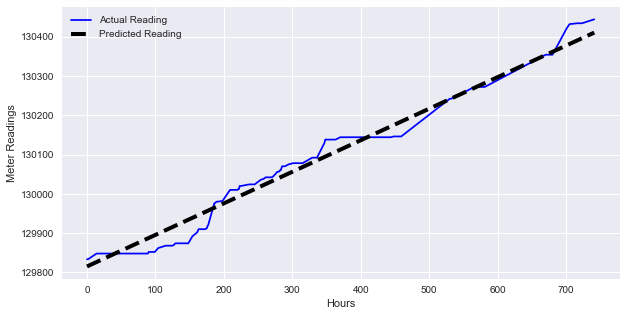

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


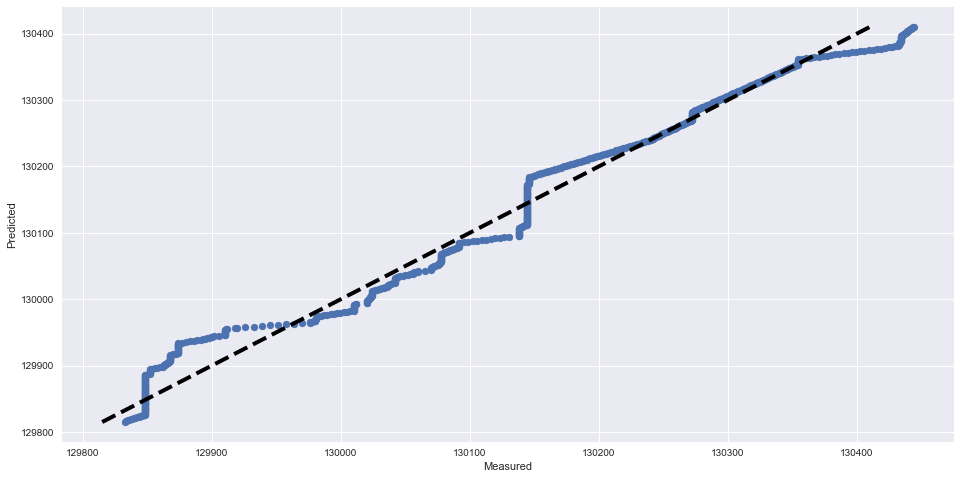

RMSE score: 24.5601568924
R2 score: 0.981498983599
---------------------------------------------------------------------------
Plotting SVR for Meter 3893
Time series plot of the actual and predicted hourly meter readings


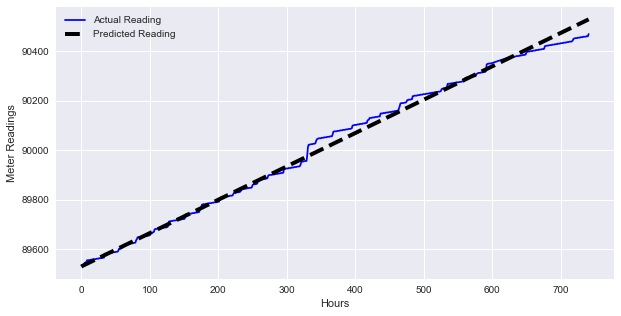

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


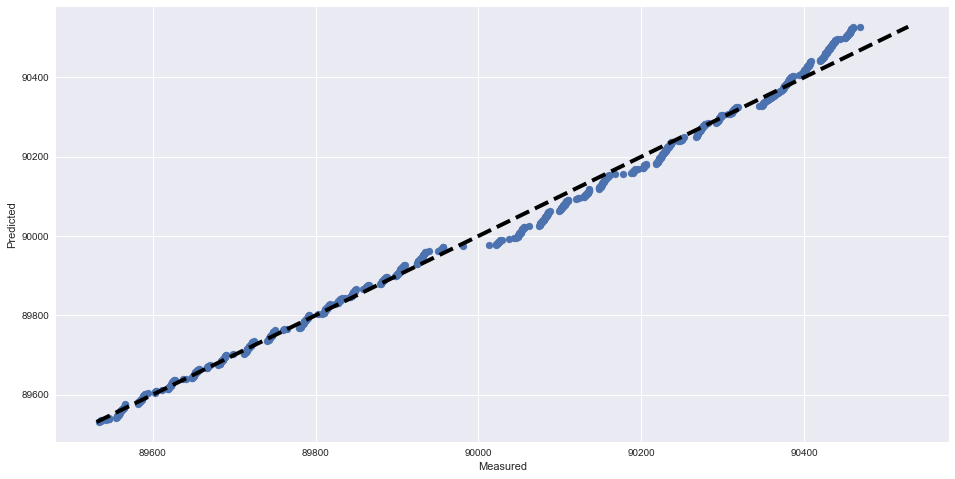

RMSE score: 22.2384578928
R2 score: 0.993876577247
---------------------------------------------------------------------------
Plotting SVR for Meter 4029
Time series plot of the actual and predicted hourly meter readings


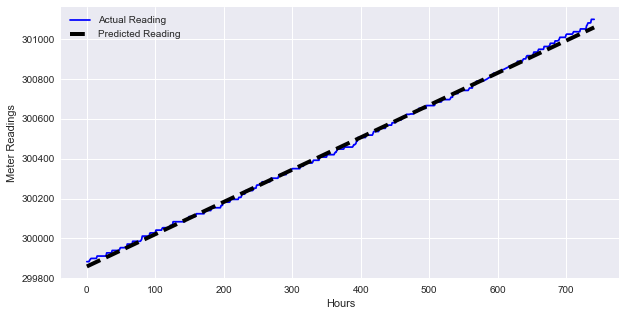

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


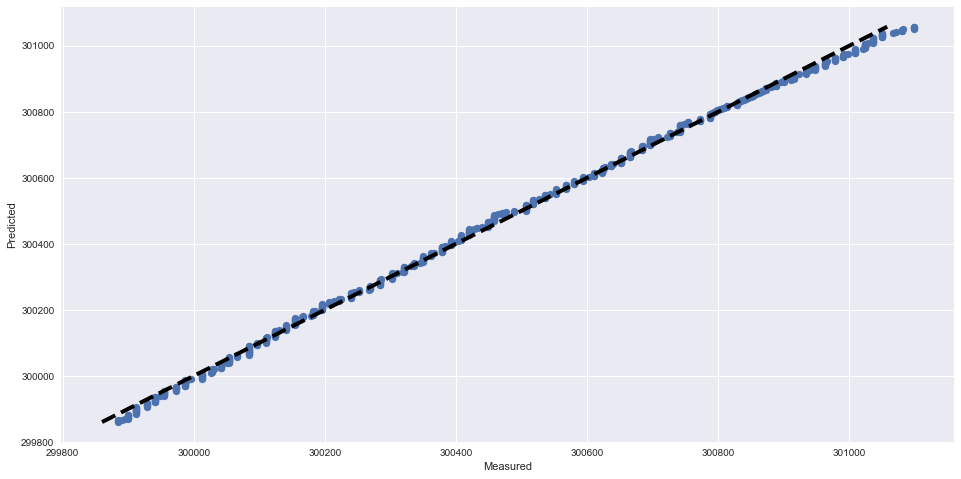

RMSE score: 12.6485477585
R2 score: 0.998675406918
---------------------------------------------------------------------------
Plotting SVR for Meter 4031
Time series plot of the actual and predicted hourly meter readings


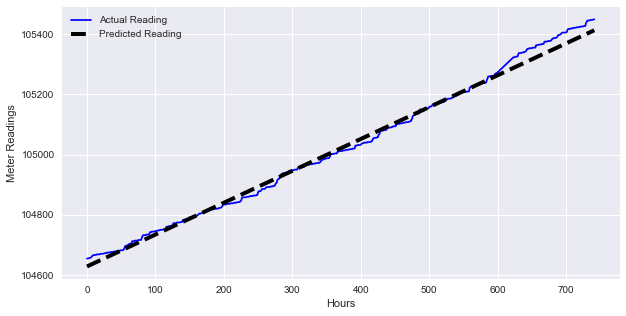

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


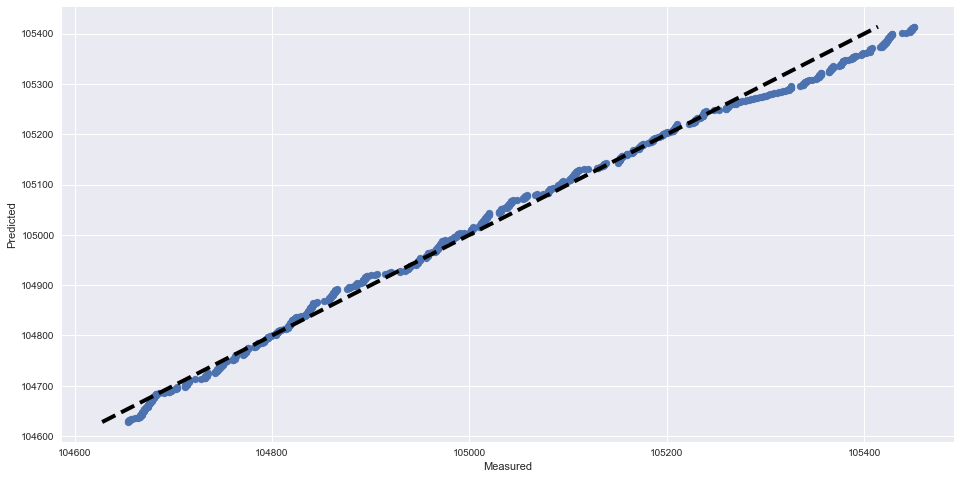

RMSE score: 18.6758304673
R2 score: 0.993673970245
---------------------------------------------------------------------------
Plotting SVR for Meter 4193
Time series plot of the actual and predicted hourly meter readings


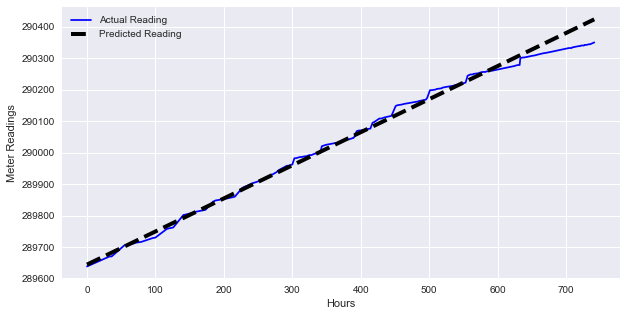

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


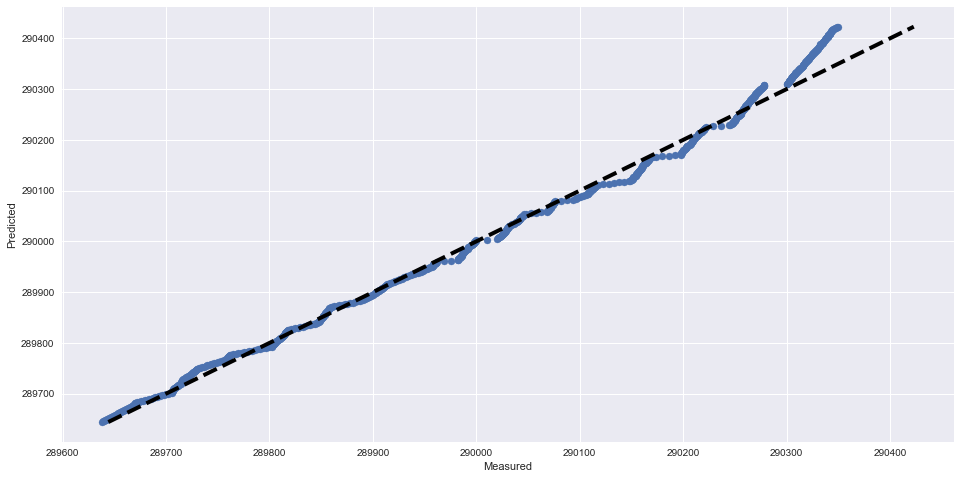

RMSE score: 20.5204410355
R2 score: 0.99118150052
---------------------------------------------------------------------------
Plotting SVR for Meter 4228
Time series plot of the actual and predicted hourly meter readings


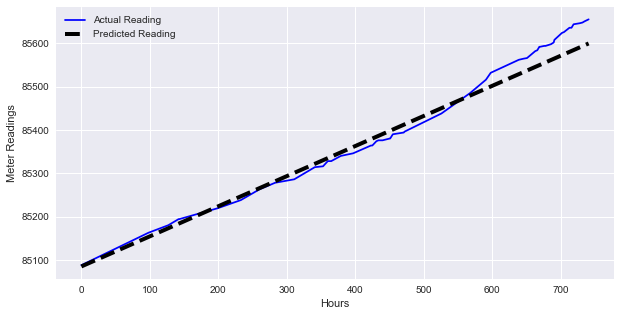

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


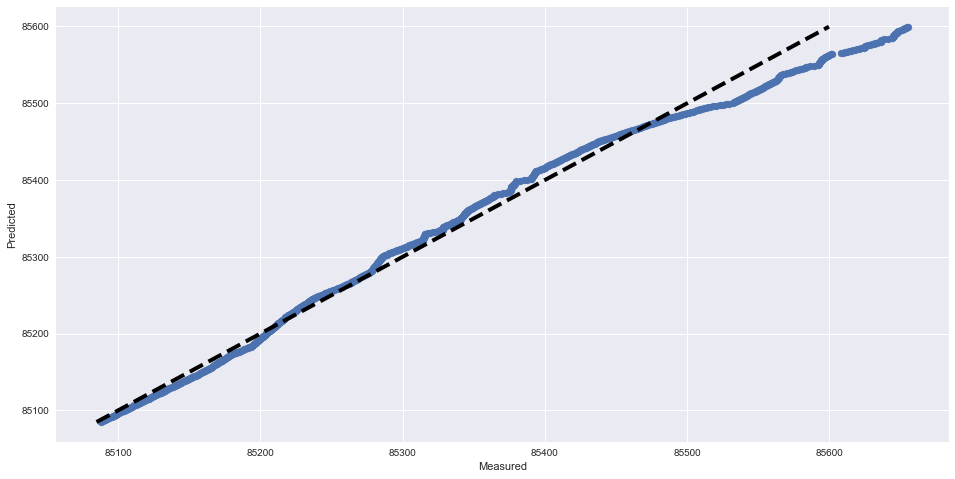

RMSE score: 20.6793091319
R2 score: 0.983127788042
---------------------------------------------------------------------------
Plotting SVR for Meter 4296
Time series plot of the actual and predicted hourly meter readings


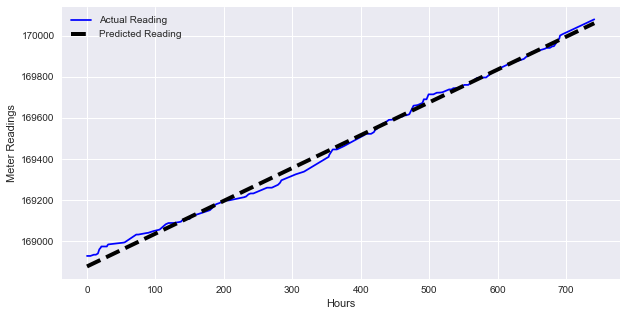

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


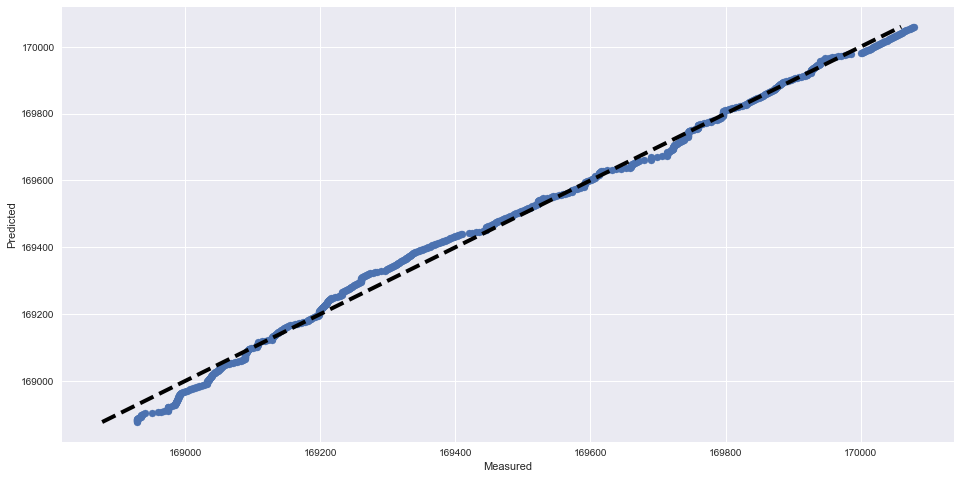

RMSE score: 24.0985539189
R2 score: 0.994965730307
---------------------------------------------------------------------------
Plotting SVR for Meter 4352
Time series plot of the actual and predicted hourly meter readings


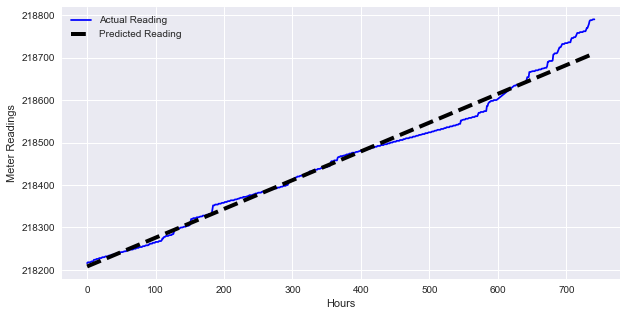

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


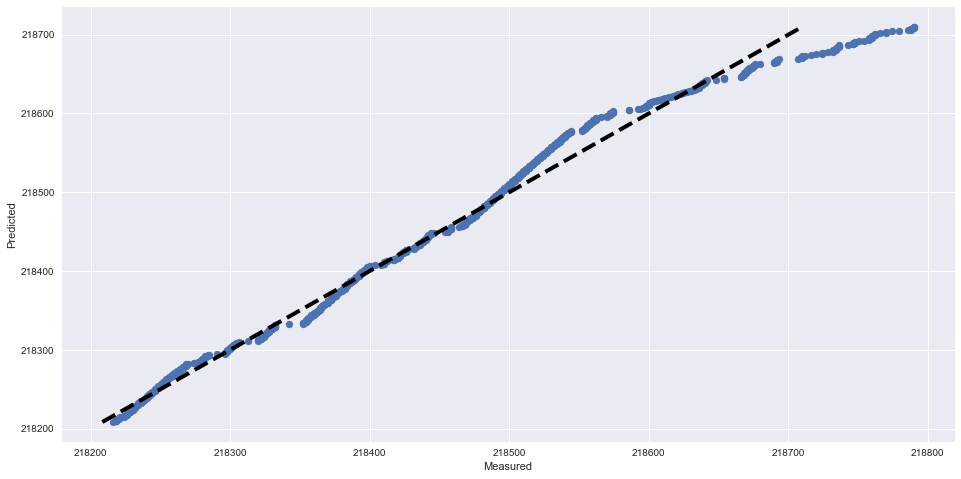

RMSE score: 21.2739763815
R2 score: 0.980240421161
---------------------------------------------------------------------------
Plotting SVR for Meter 4356
Time series plot of the actual and predicted hourly meter readings


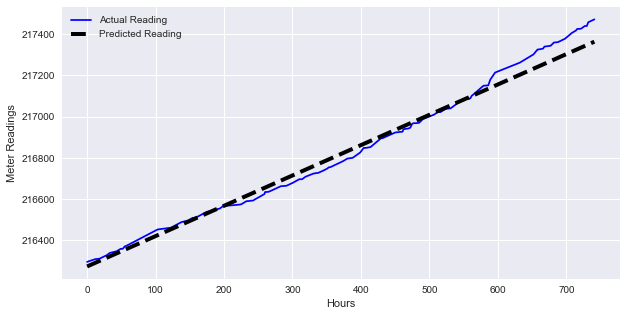

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


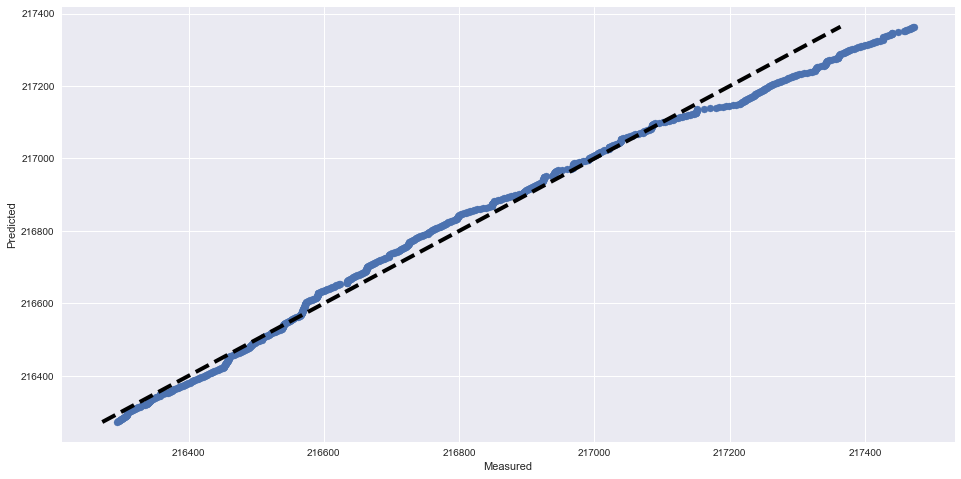

RMSE score: 40.8310399744
R2 score: 0.985279467962
---------------------------------------------------------------------------
Plotting SVR for Meter 4373
Time series plot of the actual and predicted hourly meter readings


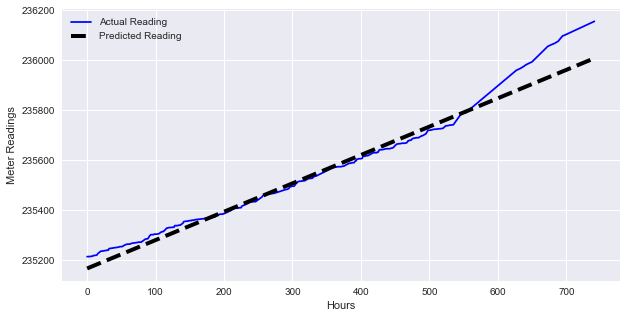

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


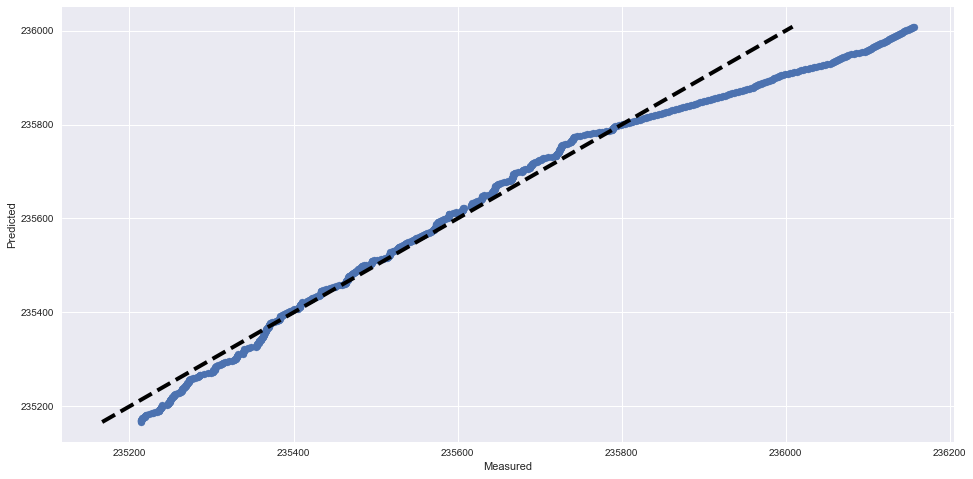

RMSE score: 53.8857798474
R2 score: 0.959856556018
---------------------------------------------------------------------------
Plotting SVR for Meter 4421
Time series plot of the actual and predicted hourly meter readings


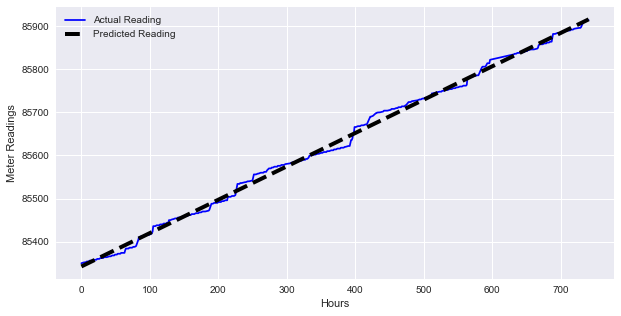

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


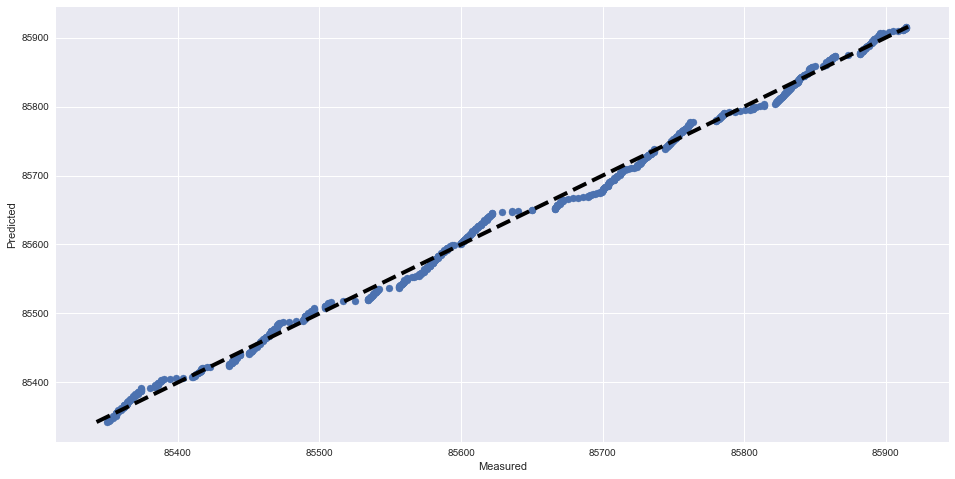

RMSE score: 9.55898215564
R2 score: 0.996716871159
---------------------------------------------------------------------------
Plotting SVR for Meter 4447
Time series plot of the actual and predicted hourly meter readings


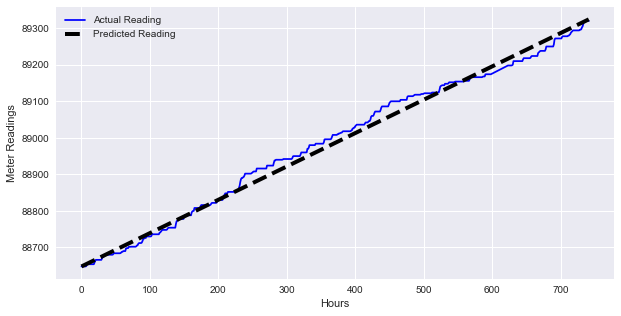

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


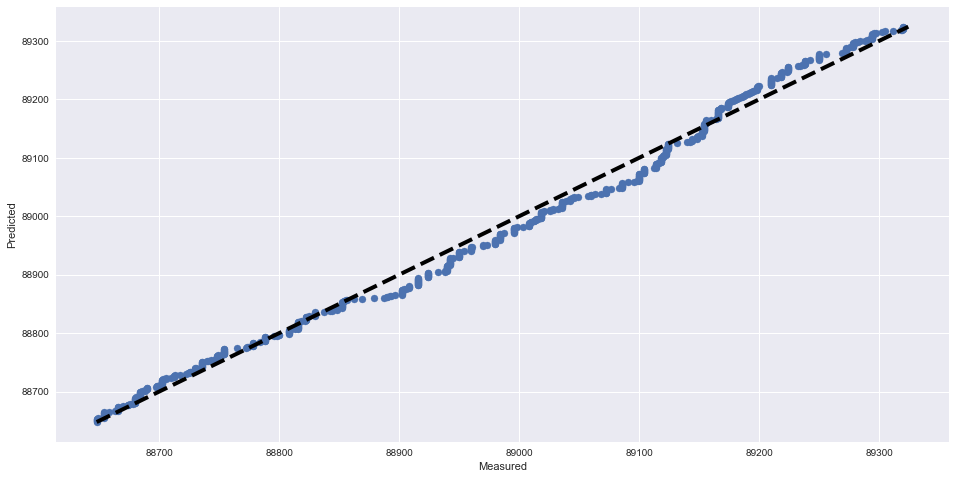

RMSE score: 18.0811842601
R2 score: 0.99126925604
---------------------------------------------------------------------------
Plotting SVR for Meter 4514
Time series plot of the actual and predicted hourly meter readings


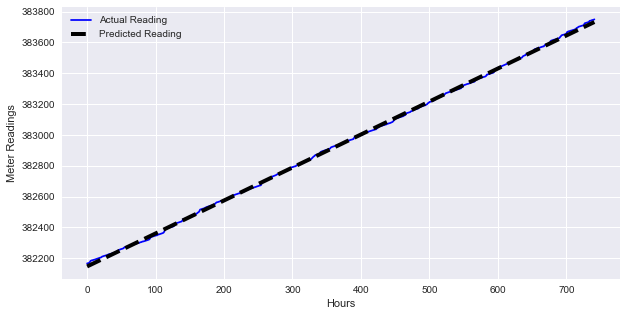

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


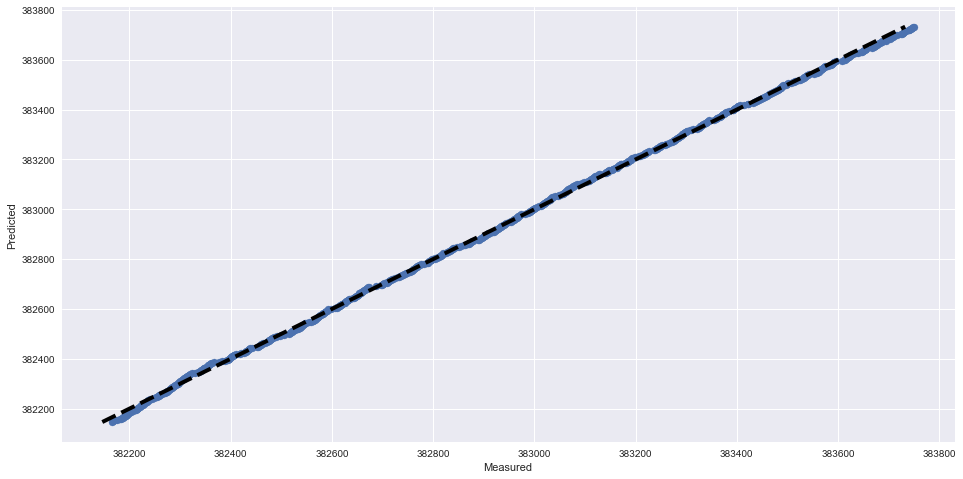

RMSE score: 9.11187207201
R2 score: 0.999606288738
---------------------------------------------------------------------------
Plotting SVR for Meter 4671
Time series plot of the actual and predicted hourly meter readings


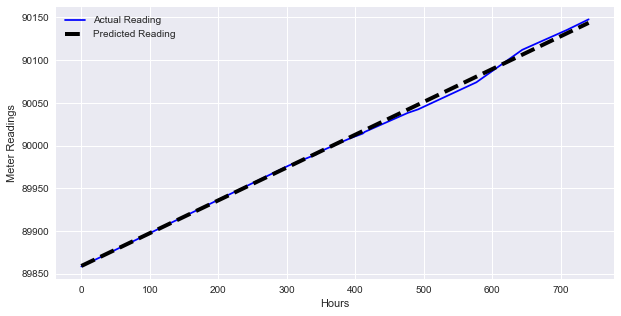

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


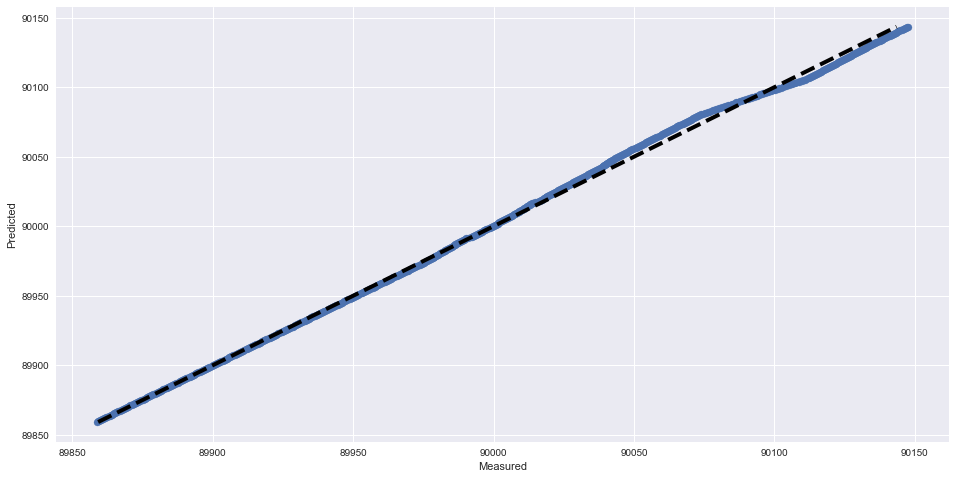

RMSE score: 3.12930895733
R2 score: 0.998556796095
---------------------------------------------------------------------------
Plotting SVR for Meter 4732
Time series plot of the actual and predicted hourly meter readings


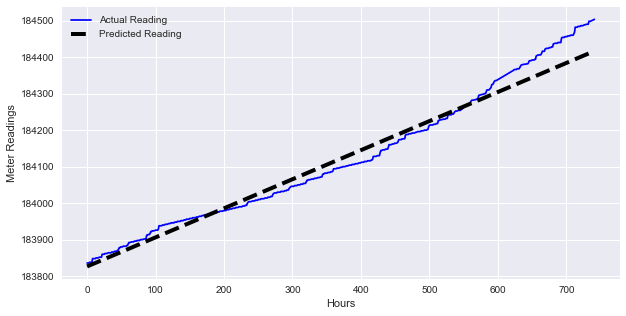

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


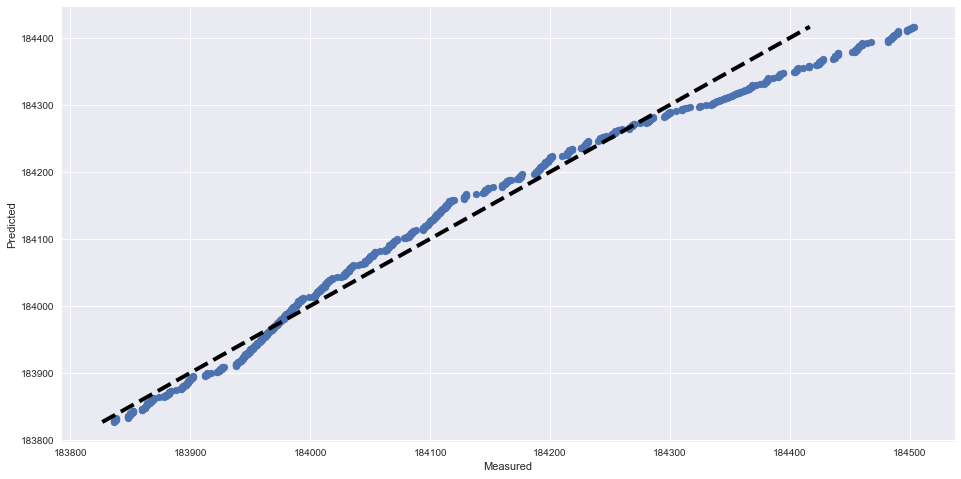

RMSE score: 31.9475857089
R2 score: 0.970498424791
---------------------------------------------------------------------------
Plotting SVR for Meter 4767
Time series plot of the actual and predicted hourly meter readings


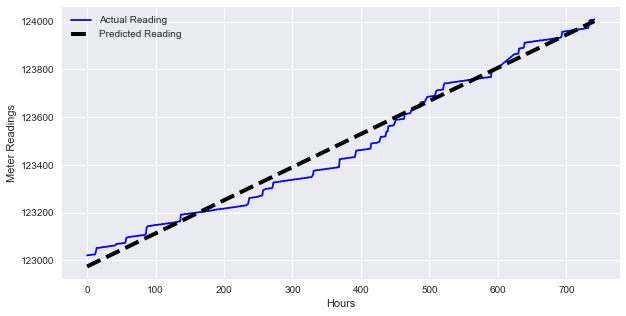

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


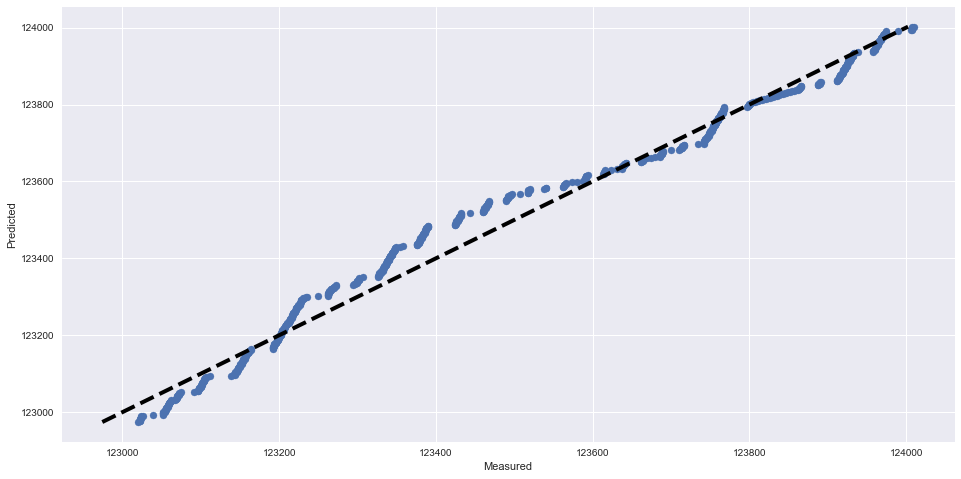

RMSE score: 40.6006004799
R2 score: 0.981673204439
---------------------------------------------------------------------------
Plotting SVR for Meter 4998
Time series plot of the actual and predicted hourly meter readings


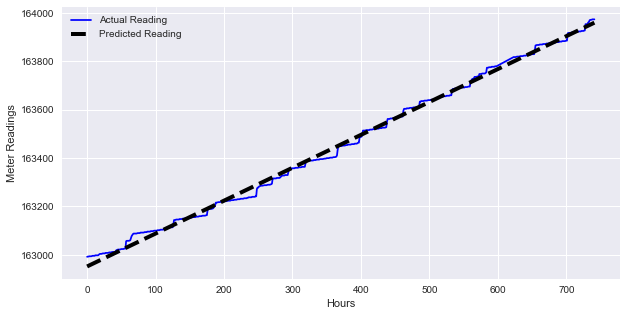

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


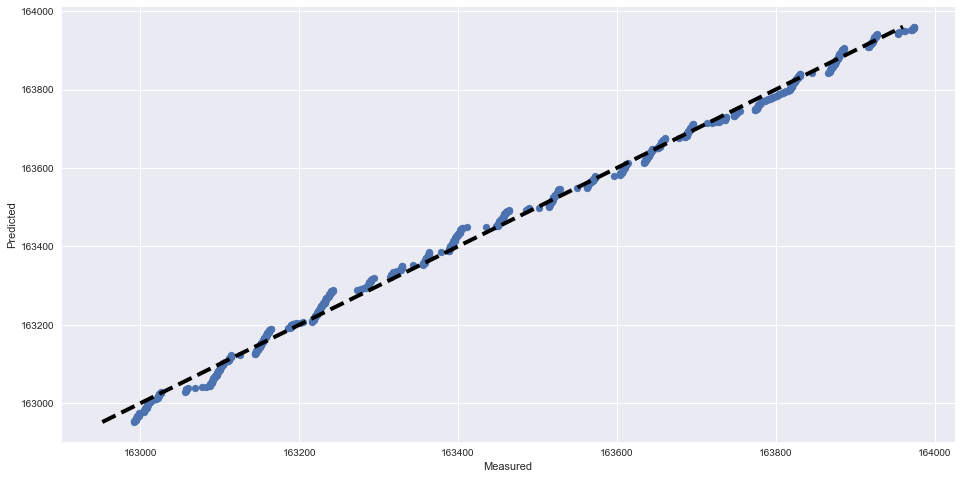

RMSE score: 16.9602113749
R2 score: 0.996609003337
---------------------------------------------------------------------------
Plotting SVR for Meter 5129
Time series plot of the actual and predicted hourly meter readings


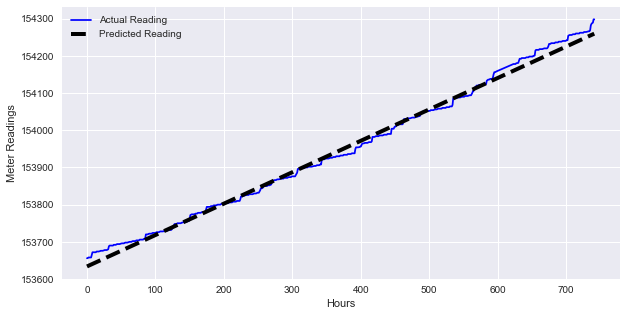

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


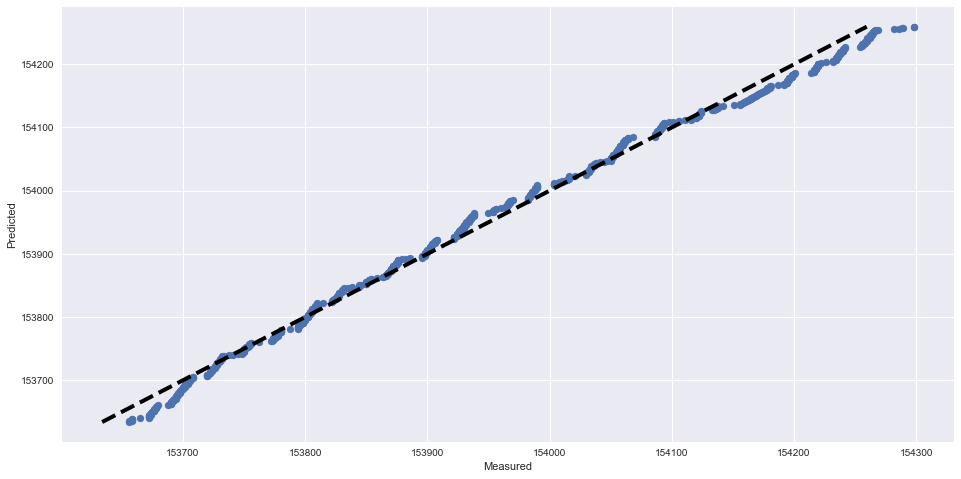

RMSE score: 13.8482160217
R2 score: 0.99426240463
---------------------------------------------------------------------------
Plotting SVR for Meter 5131
Time series plot of the actual and predicted hourly meter readings


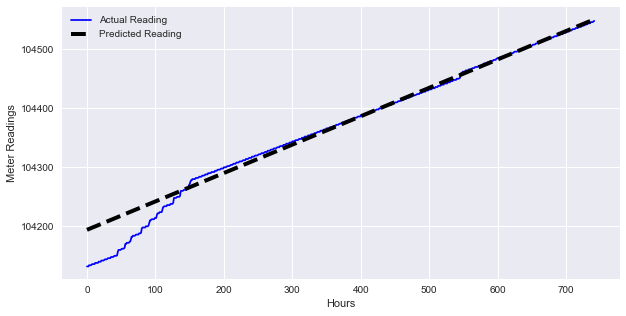

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


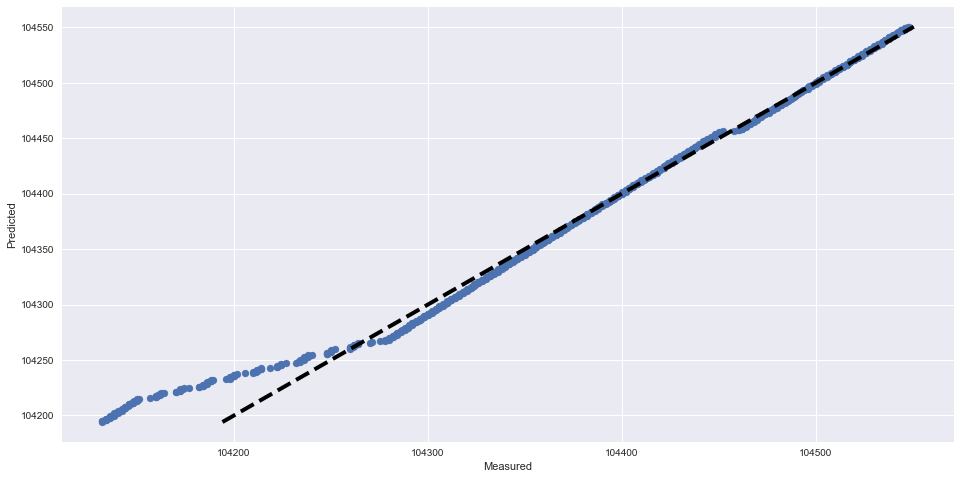

RMSE score: 20.45987368
R2 score: 0.96800519078
---------------------------------------------------------------------------
Plotting SVR for Meter 5193
Time series plot of the actual and predicted hourly meter readings


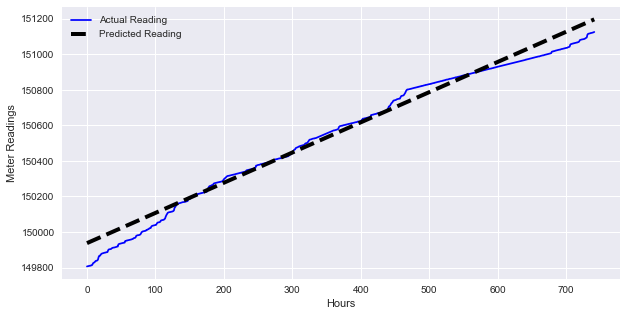

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


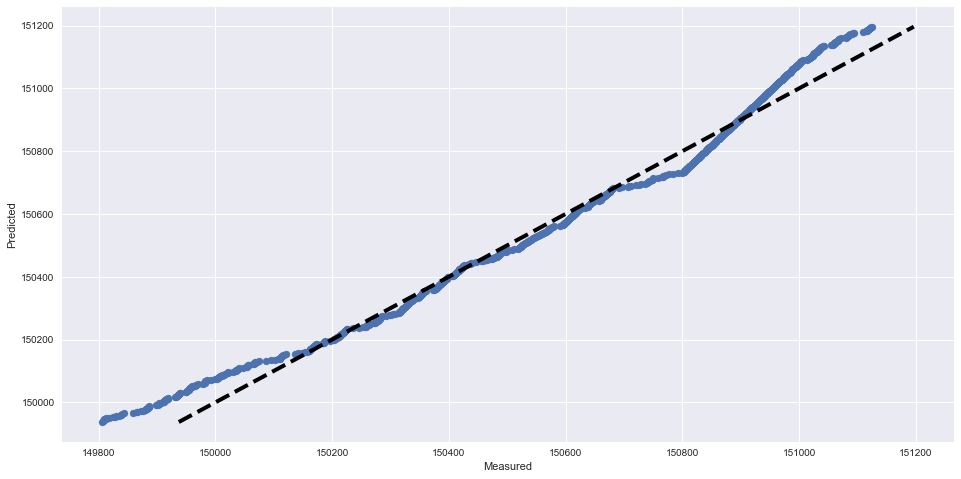

RMSE score: 51.2437917061
R2 score: 0.980950637879
---------------------------------------------------------------------------
Plotting SVR for Meter 5275
Time series plot of the actual and predicted hourly meter readings


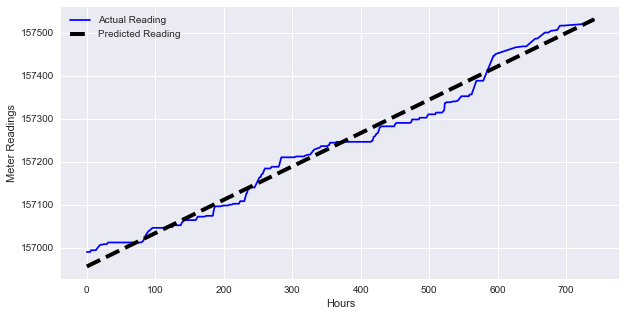

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


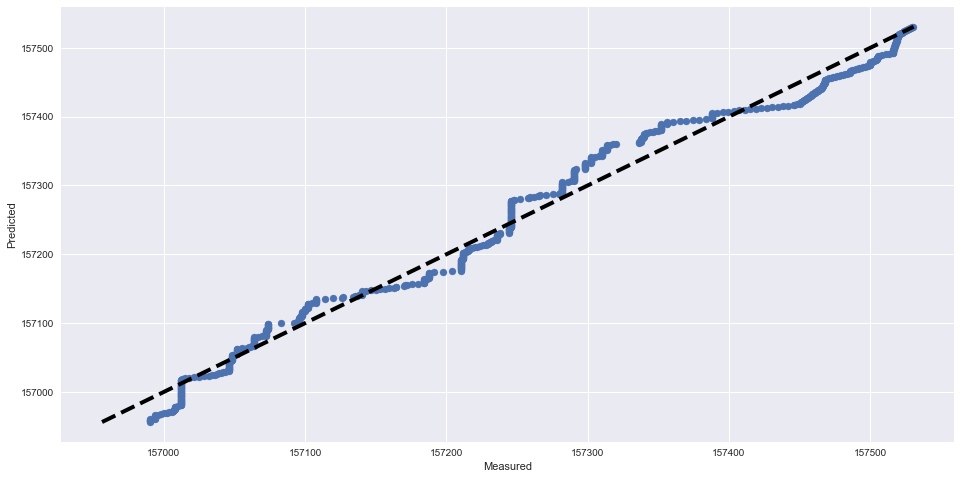

RMSE score: 20.875458494
R2 score: 0.984042993819
---------------------------------------------------------------------------
Plotting SVR for Meter 5395
Time series plot of the actual and predicted hourly meter readings


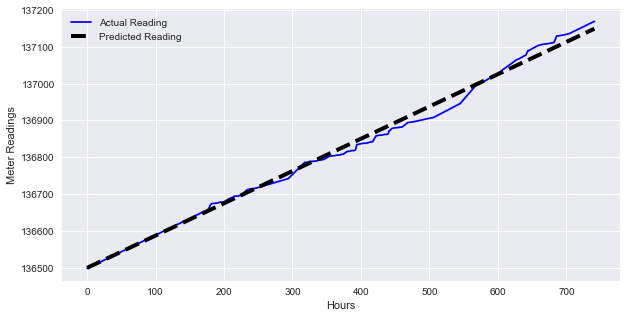

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


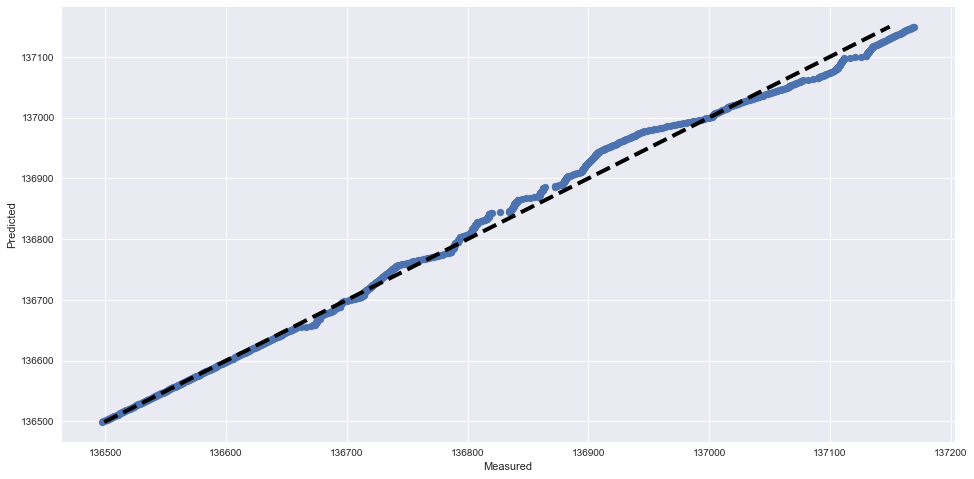

RMSE score: 15.3220909815
R2 score: 0.993517314302
---------------------------------------------------------------------------
Plotting SVR for Meter 5403
Time series plot of the actual and predicted hourly meter readings


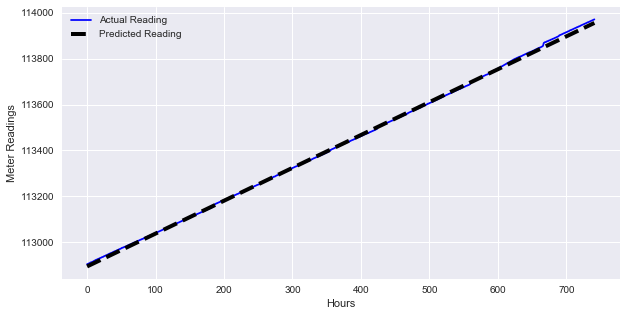

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


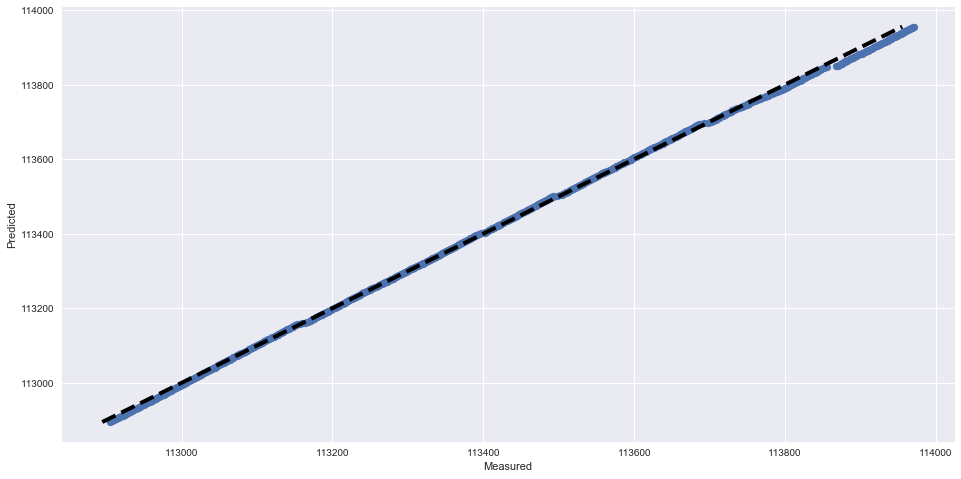

RMSE score: 7.0940915019
R2 score: 0.999470633002
---------------------------------------------------------------------------
Plotting SVR for Meter 5439
Time series plot of the actual and predicted hourly meter readings


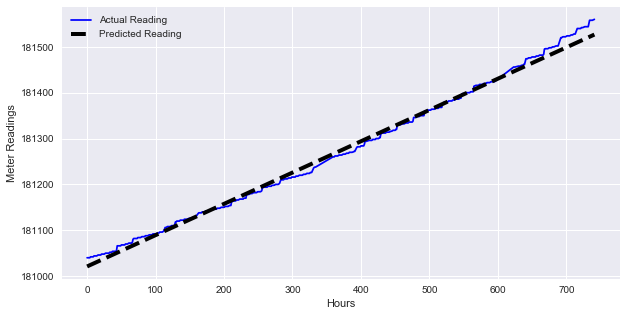

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


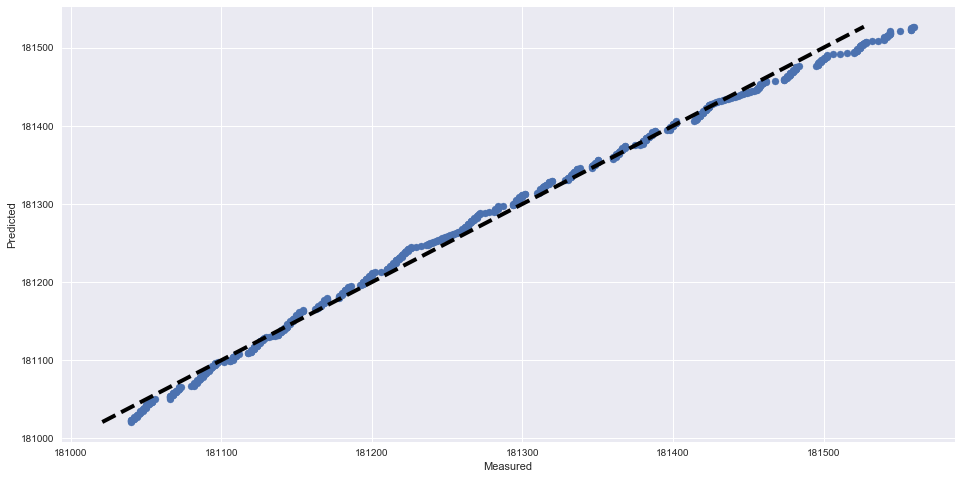

RMSE score: 10.7873559075
R2 score: 0.994755663458
---------------------------------------------------------------------------
Plotting SVR for Meter 5484
Time series plot of the actual and predicted hourly meter readings


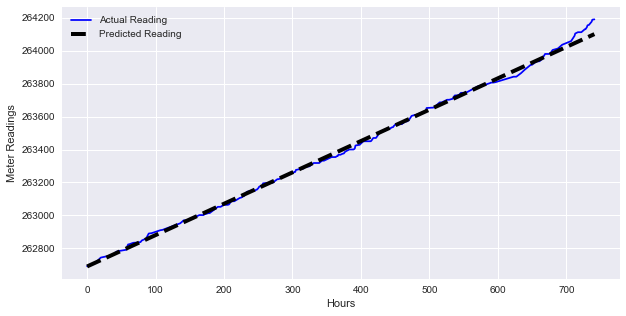

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


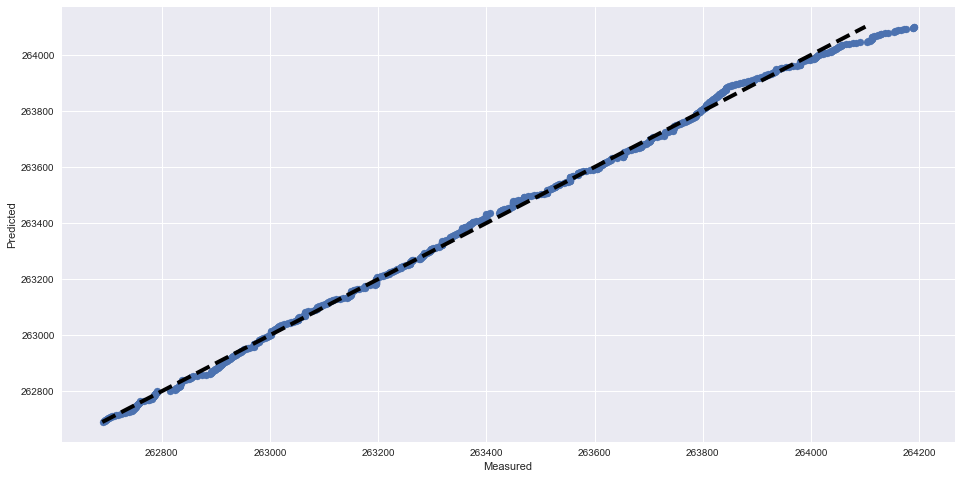

RMSE score: 18.8247865775
R2 score: 0.99789821848
---------------------------------------------------------------------------
Plotting SVR for Meter 5636
Time series plot of the actual and predicted hourly meter readings


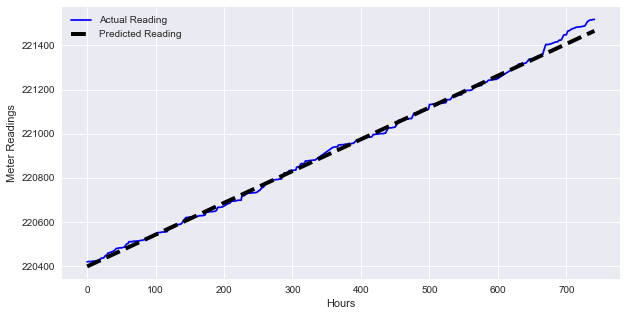

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


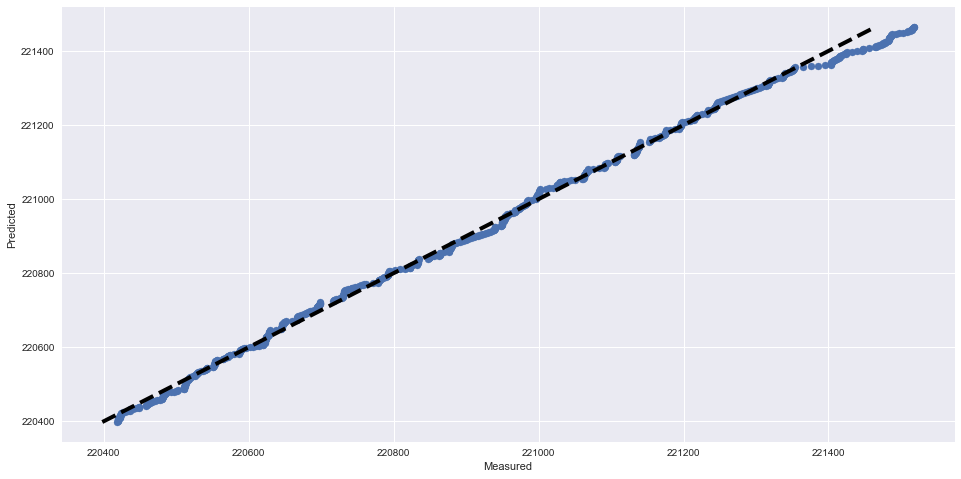

RMSE score: 17.2095315256
R2 score: 0.997004563362
---------------------------------------------------------------------------
Plotting SVR for Meter 5785
Time series plot of the actual and predicted hourly meter readings


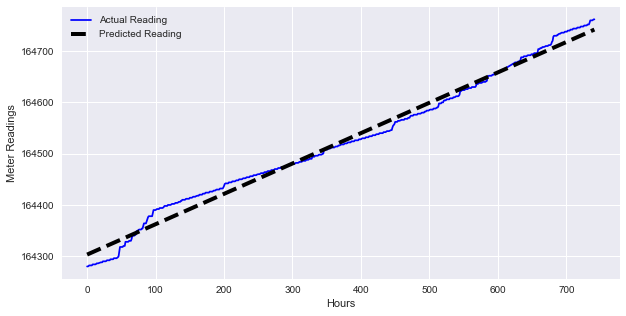

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


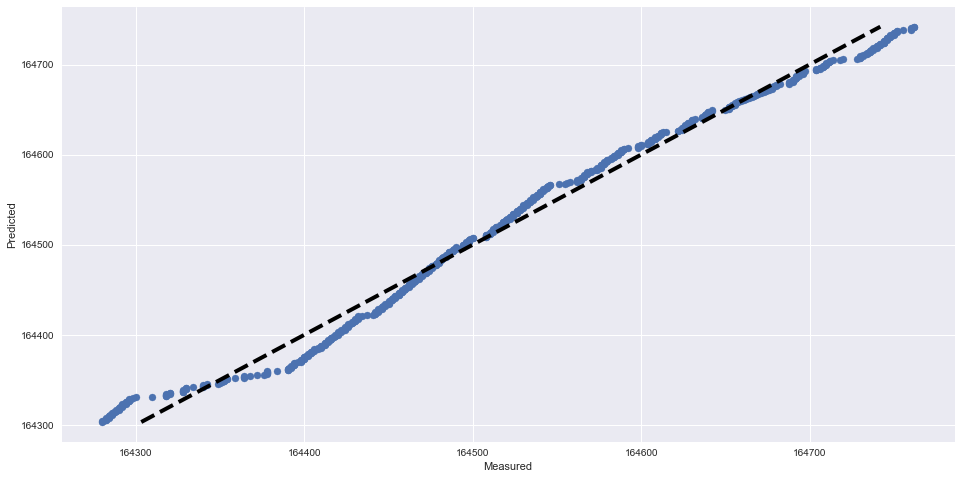

RMSE score: 14.7562164886
R2 score: 0.986828191181
---------------------------------------------------------------------------
Plotting SVR for Meter 5810
Time series plot of the actual and predicted hourly meter readings


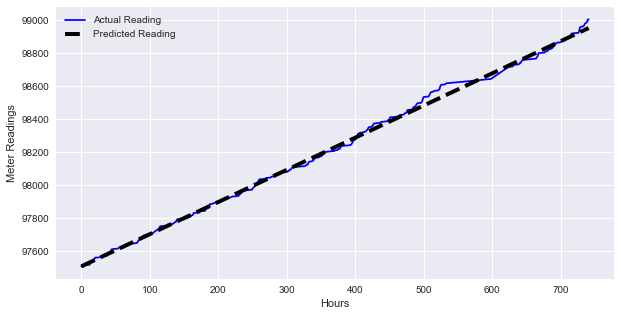

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


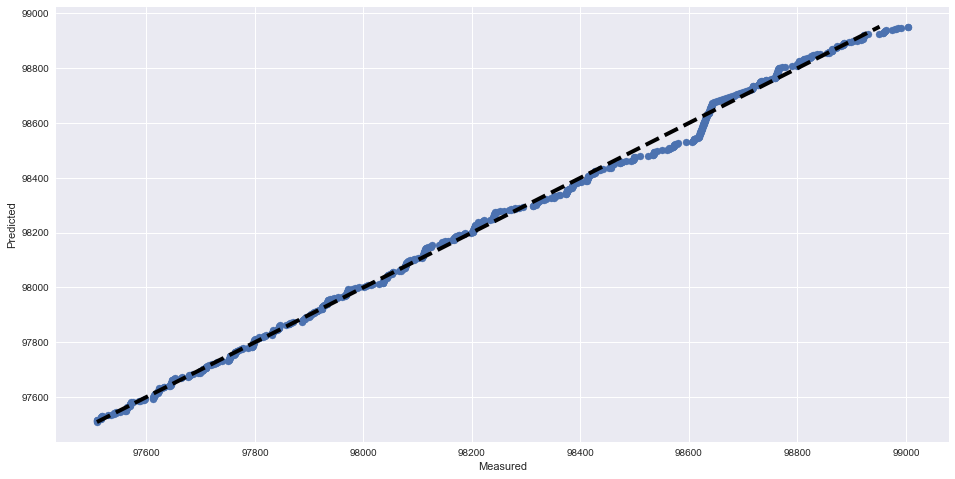

RMSE score: 21.1657223588
R2 score: 0.997462406427
---------------------------------------------------------------------------
Plotting SVR for Meter 5814
Time series plot of the actual and predicted hourly meter readings


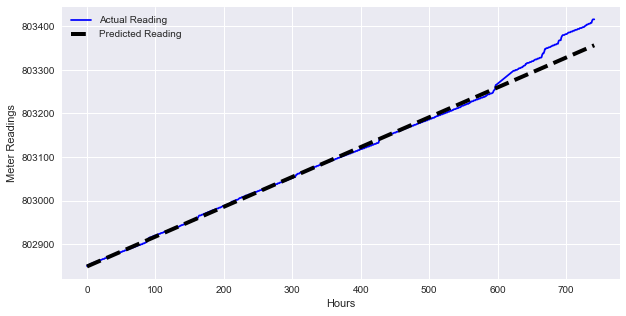

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


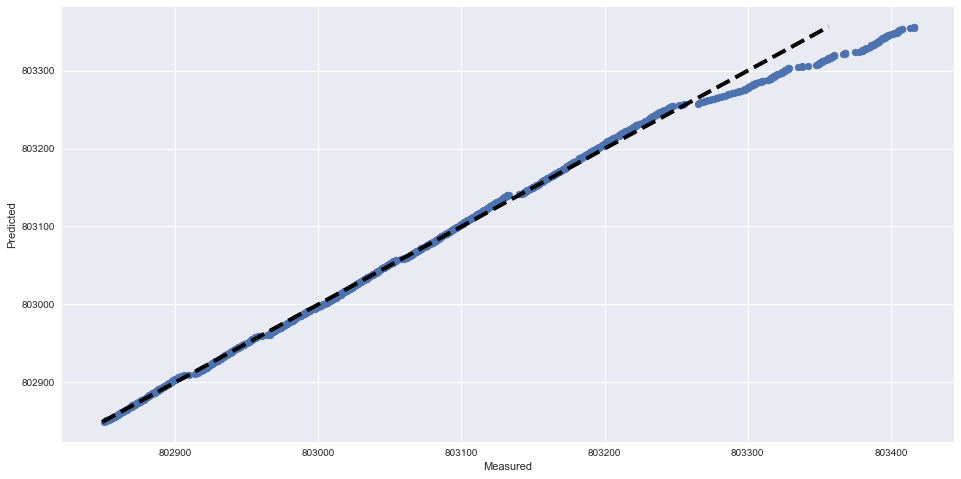

RMSE score: 17.5491674296
R2 score: 0.987423675179
---------------------------------------------------------------------------
Plotting SVR for Meter 5892
Time series plot of the actual and predicted hourly meter readings


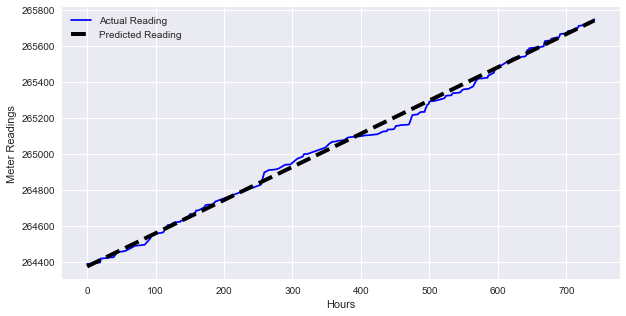

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


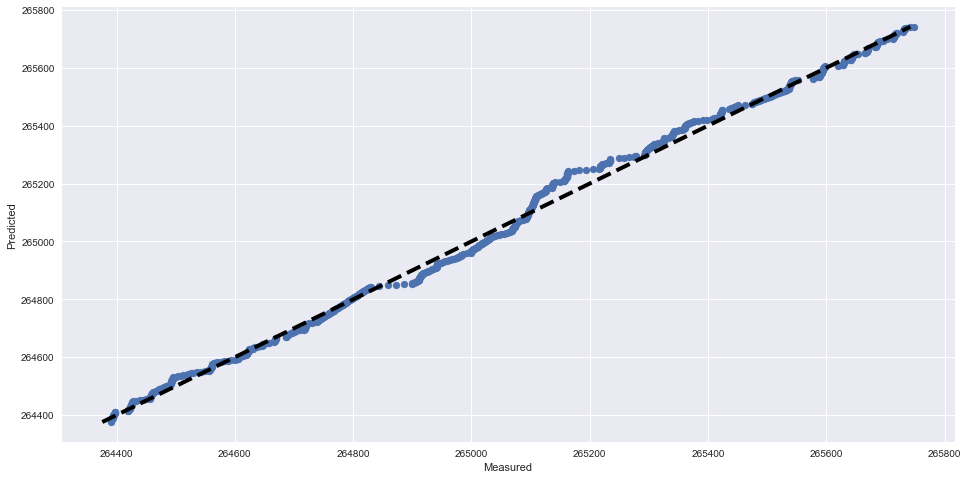

RMSE score: 24.7931276969
R2 score: 0.995997548297
---------------------------------------------------------------------------
Plotting SVR for Meter 5972
Time series plot of the actual and predicted hourly meter readings


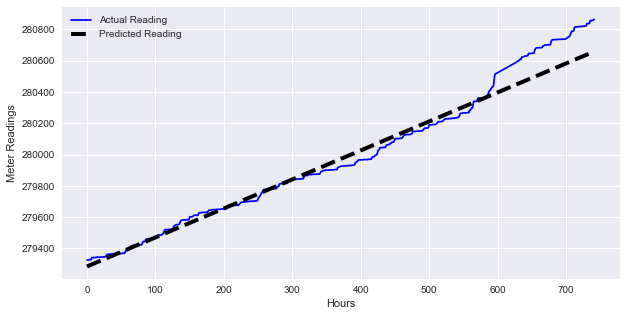

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


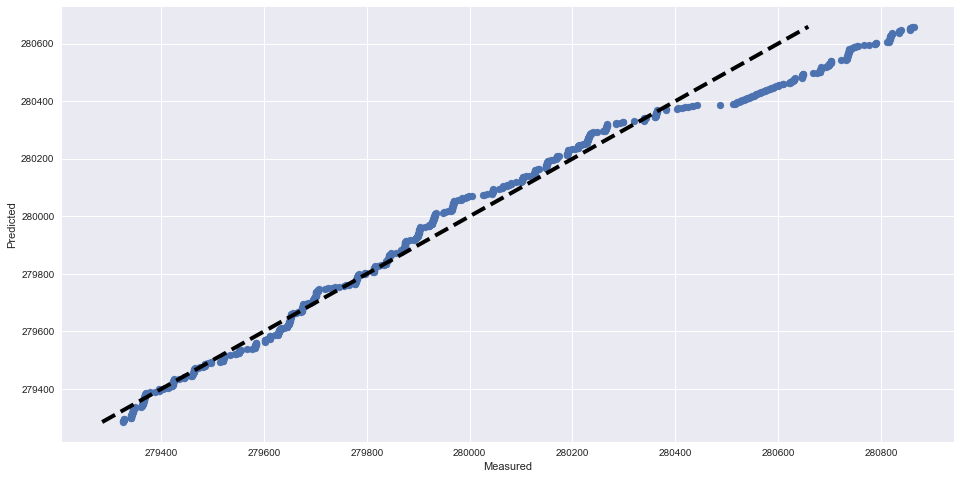

RMSE score: 79.8955292733
R2 score: 0.96712648637
---------------------------------------------------------------------------
Plotting SVR for Meter 6412
Time series plot of the actual and predicted hourly meter readings


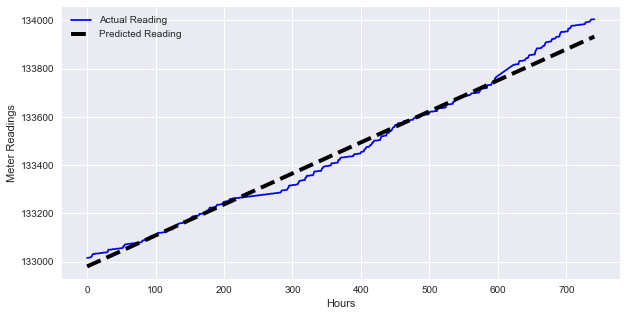

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


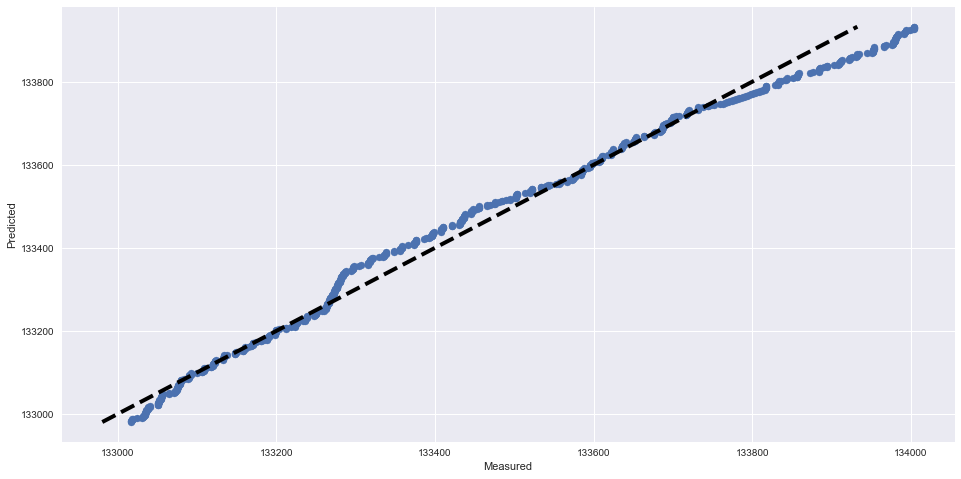

RMSE score: 34.0475657372
R2 score: 0.986207080913
---------------------------------------------------------------------------
Plotting SVR for Meter 6505
Time series plot of the actual and predicted hourly meter readings


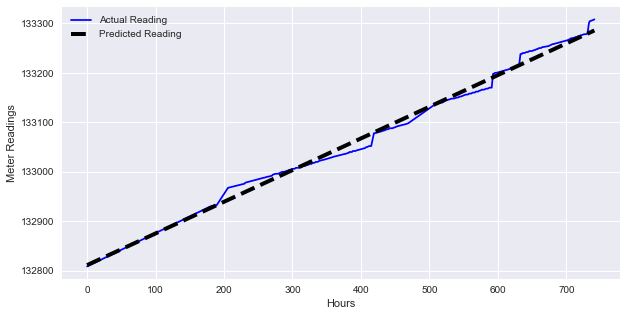

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


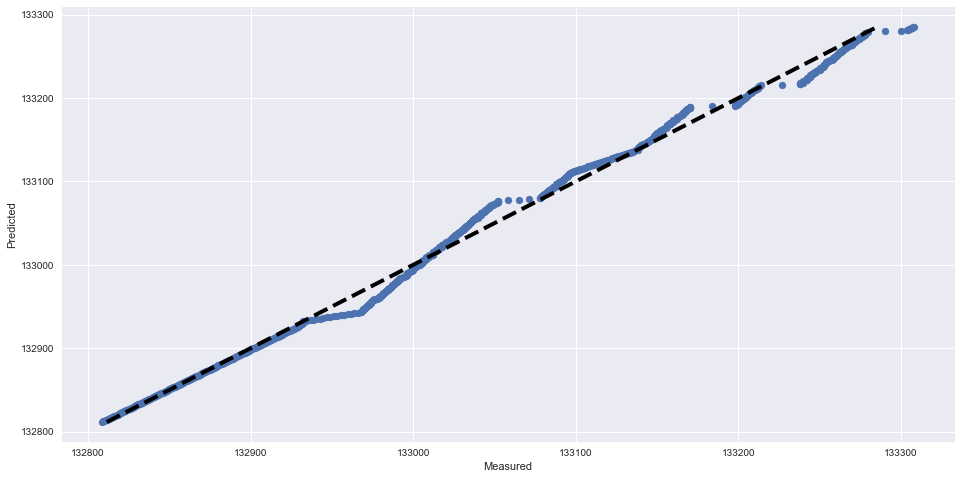

RMSE score: 10.5107535021
R2 score: 0.994146418996
---------------------------------------------------------------------------
Plotting SVR for Meter 6578
Time series plot of the actual and predicted hourly meter readings


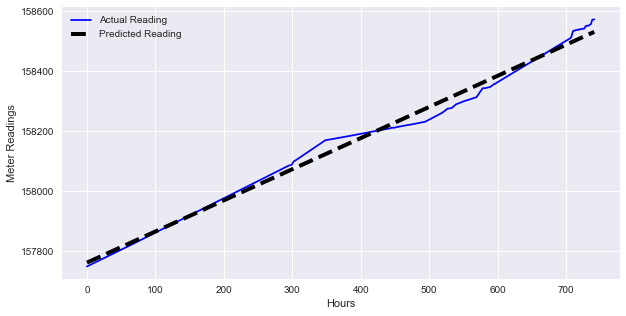

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


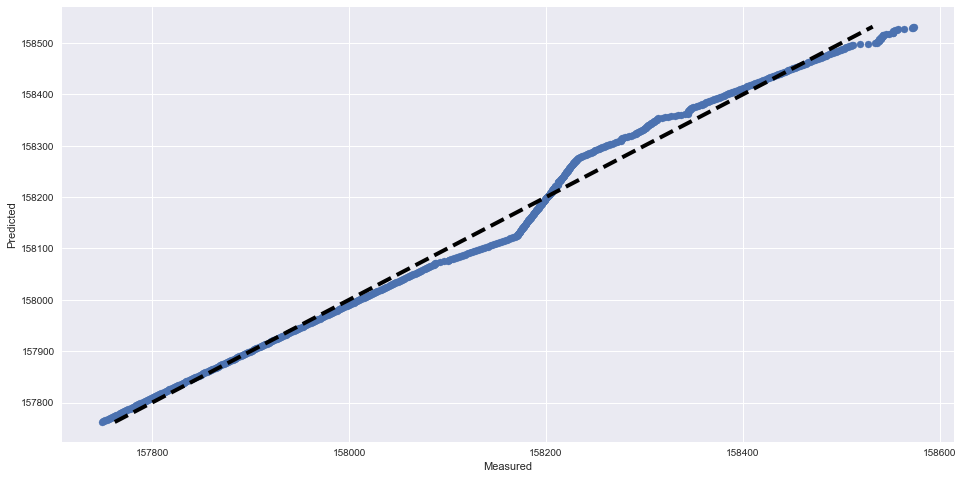

RMSE score: 21.9046482509
R2 score: 0.990195068441
---------------------------------------------------------------------------
Plotting SVR for Meter 6830
Time series plot of the actual and predicted hourly meter readings


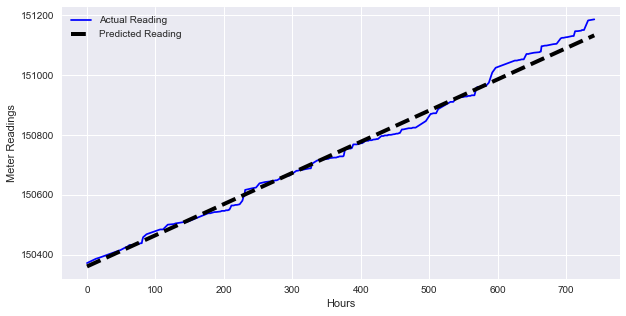

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


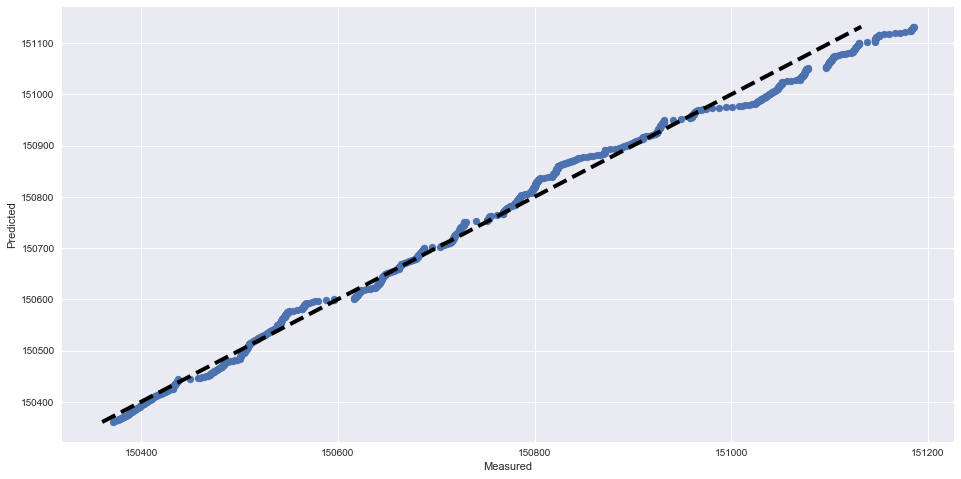

RMSE score: 21.0585406487
R2 score: 0.991722945749
---------------------------------------------------------------------------
Plotting SVR for Meter 6836
Time series plot of the actual and predicted hourly meter readings


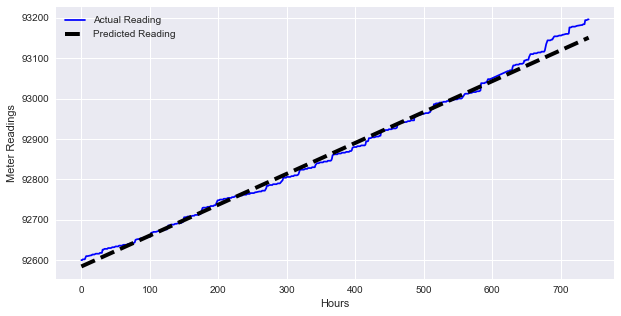

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


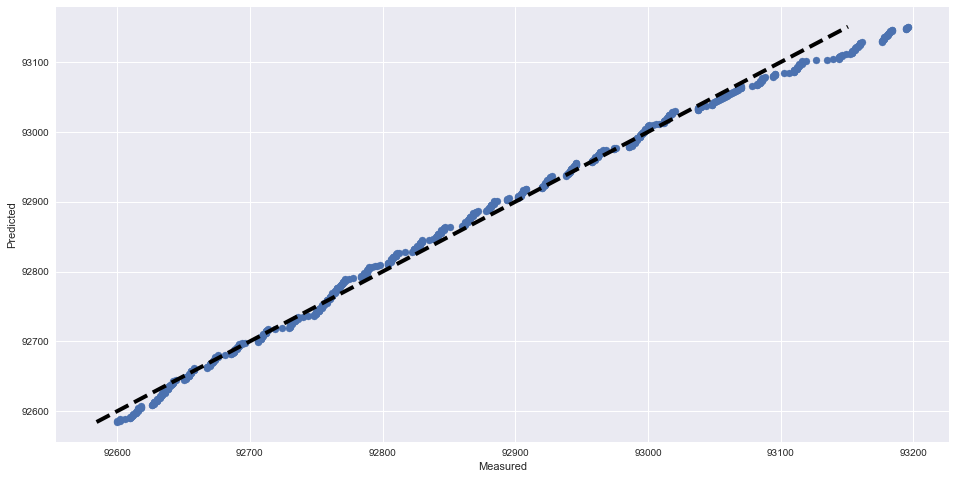

RMSE score: 14.6947608731
R2 score: 0.99244900123
---------------------------------------------------------------------------
Plotting SVR for Meter 6863
Time series plot of the actual and predicted hourly meter readings


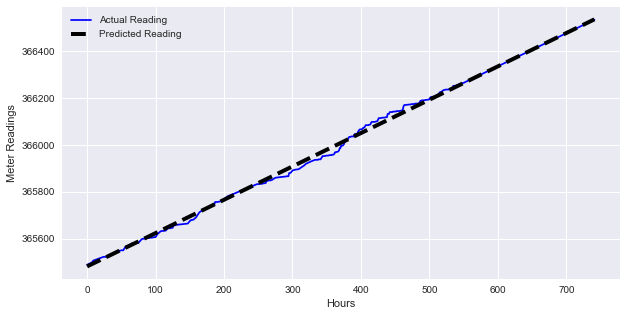

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


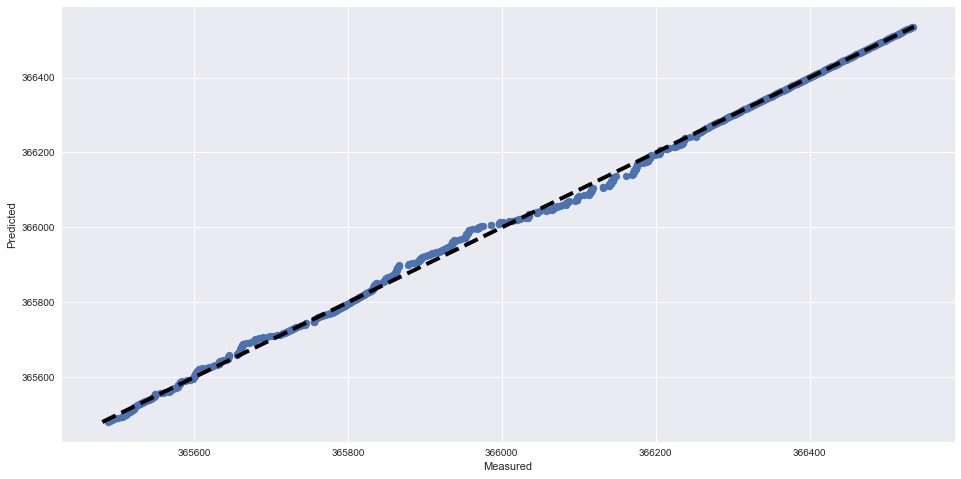

RMSE score: 12.4731896016
R2 score: 0.998355164396
---------------------------------------------------------------------------
Plotting SVR for Meter 6910
Time series plot of the actual and predicted hourly meter readings


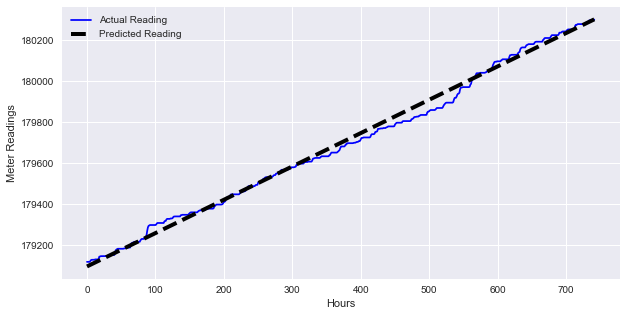

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


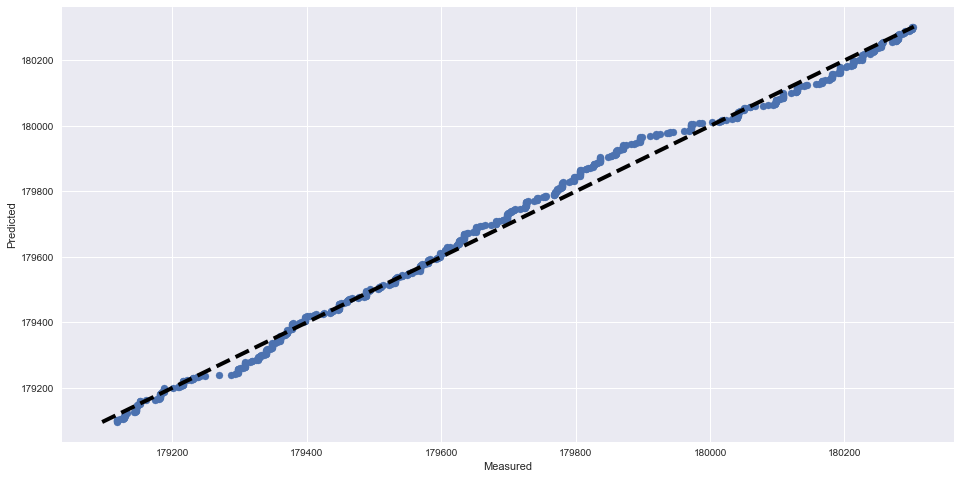

RMSE score: 27.7732891773
R2 score: 0.993527981032
---------------------------------------------------------------------------
Plotting SVR for Meter 7017
Time series plot of the actual and predicted hourly meter readings


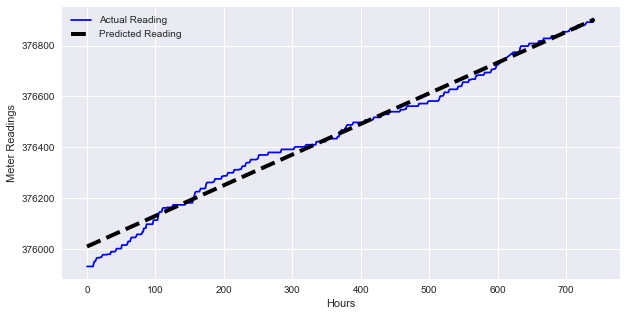

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


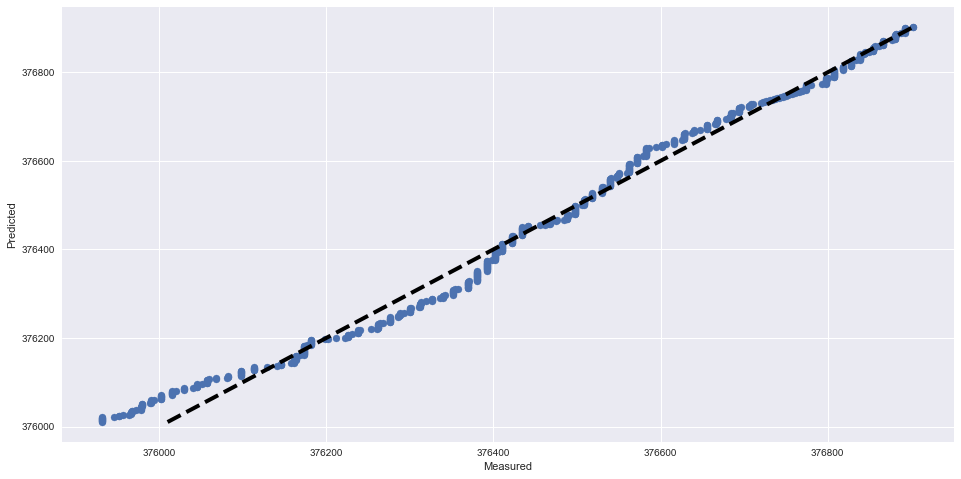

RMSE score: 30.2615883506
R2 score: 0.986860730335
---------------------------------------------------------------------------
Plotting SVR for Meter 7030
Time series plot of the actual and predicted hourly meter readings


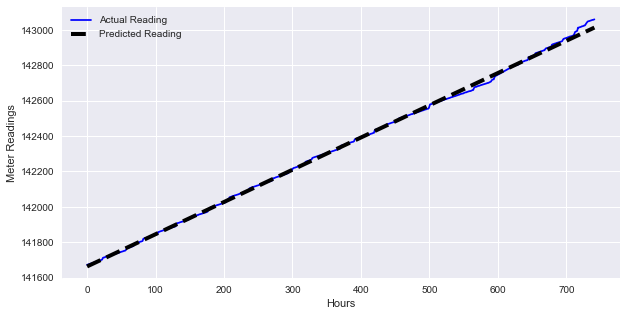

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


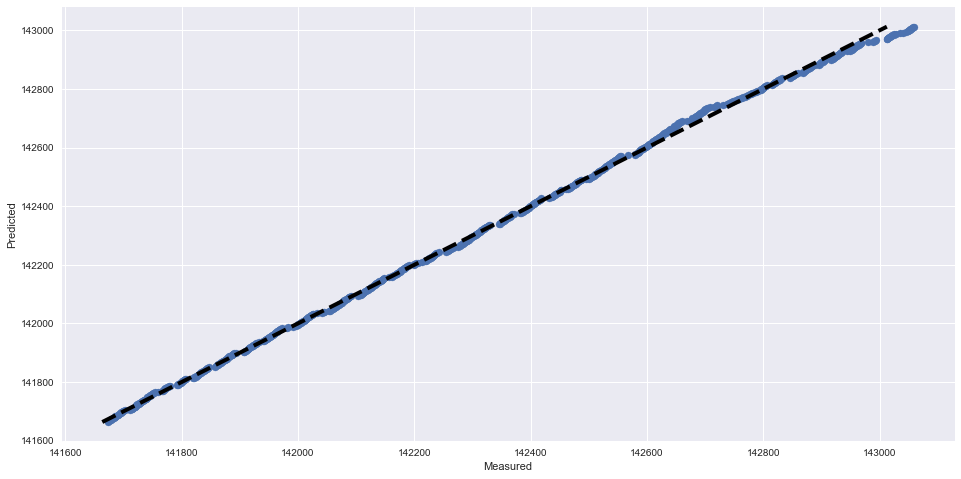

RMSE score: 12.4814975316
R2 score: 0.99898576471
---------------------------------------------------------------------------
Plotting SVR for Meter 7117
Time series plot of the actual and predicted hourly meter readings


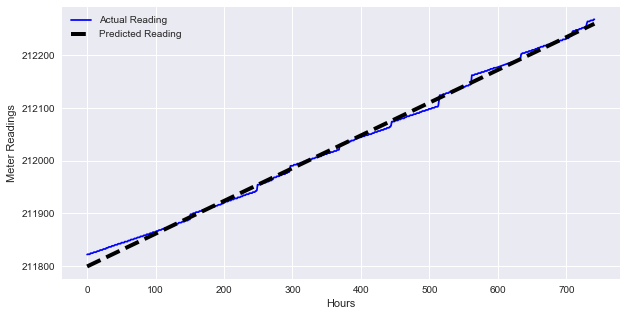

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


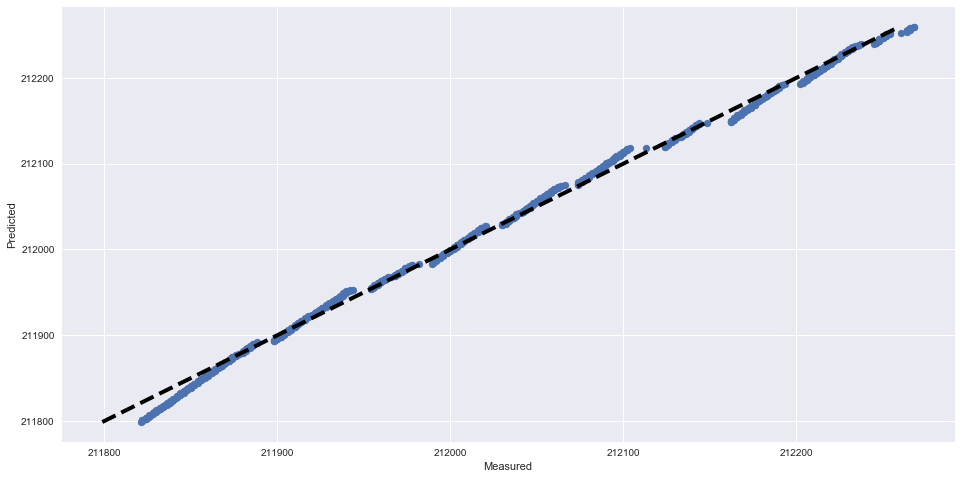

RMSE score: 7.37097790095
R2 score: 0.996870231868
---------------------------------------------------------------------------
Plotting SVR for Meter 7287
Time series plot of the actual and predicted hourly meter readings


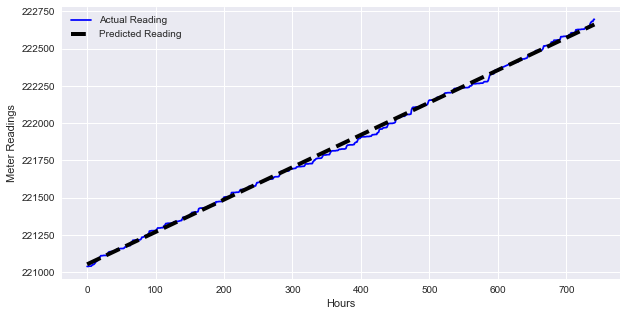

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


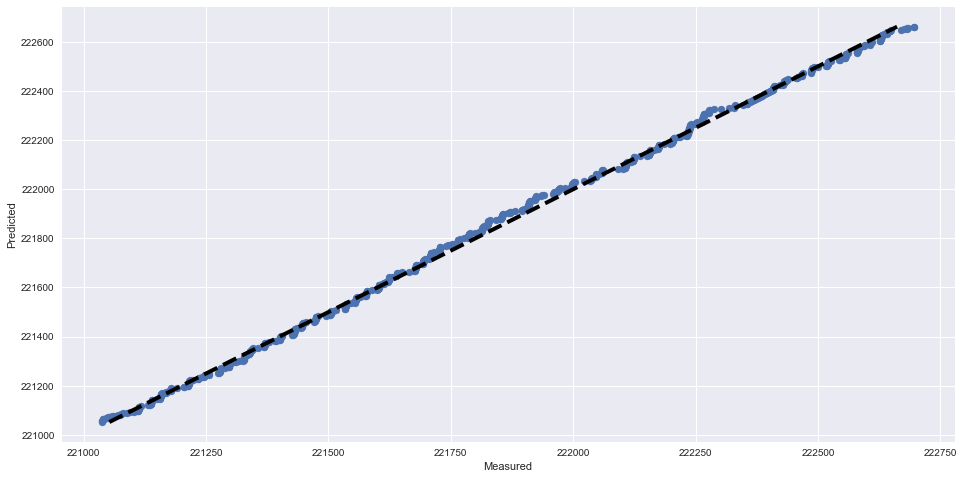

RMSE score: 16.8006631835
R2 score: 0.998694591203
---------------------------------------------------------------------------
Plotting SVR for Meter 7429
Time series plot of the actual and predicted hourly meter readings


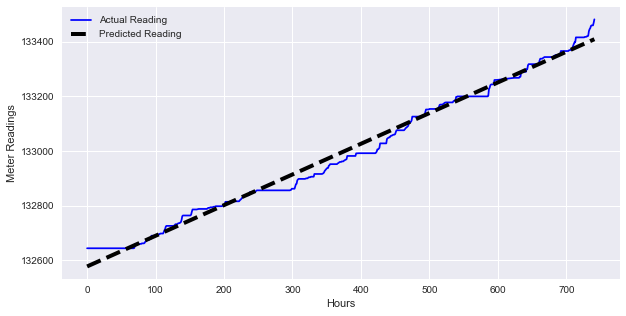

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


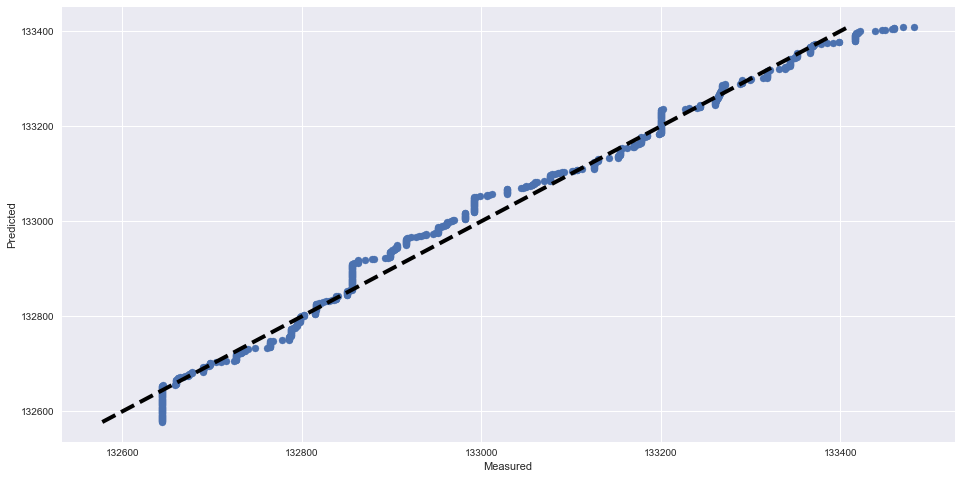

RMSE score: 25.0061216201
R2 score: 0.989076414079
---------------------------------------------------------------------------
Plotting SVR for Meter 7460
Time series plot of the actual and predicted hourly meter readings


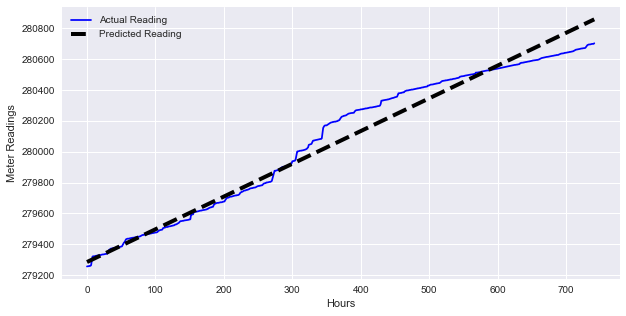

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


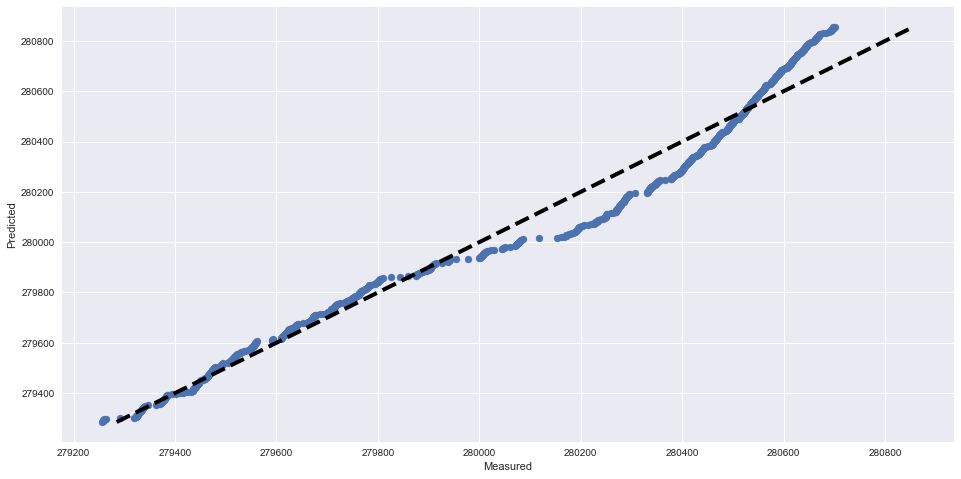

RMSE score: 78.6925847404
R2 score: 0.969070885686
---------------------------------------------------------------------------
Plotting SVR for Meter 7674
Time series plot of the actual and predicted hourly meter readings


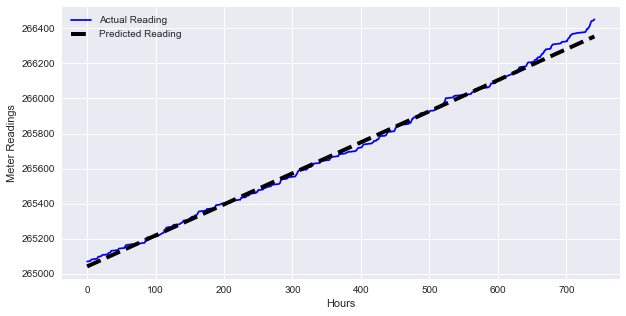

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


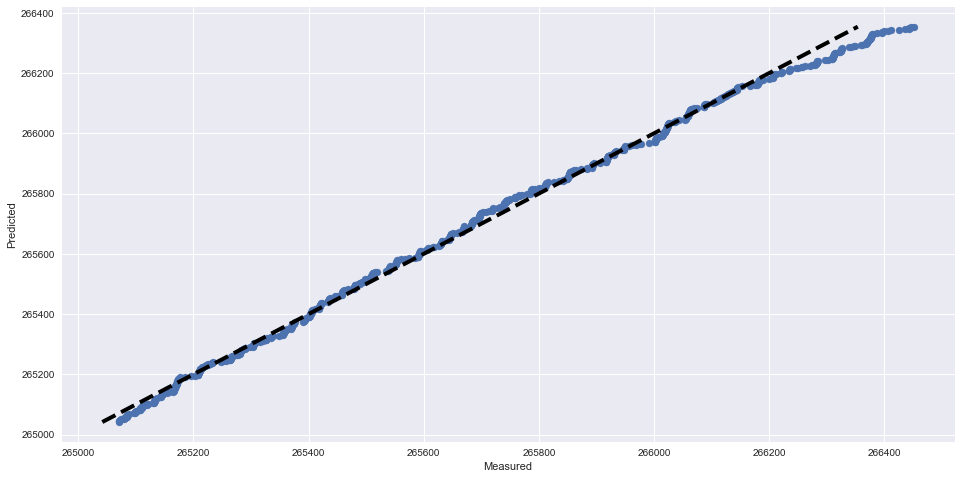

RMSE score: 23.9759574811
R2 score: 0.996164974572
---------------------------------------------------------------------------
Plotting SVR for Meter 7682
Time series plot of the actual and predicted hourly meter readings


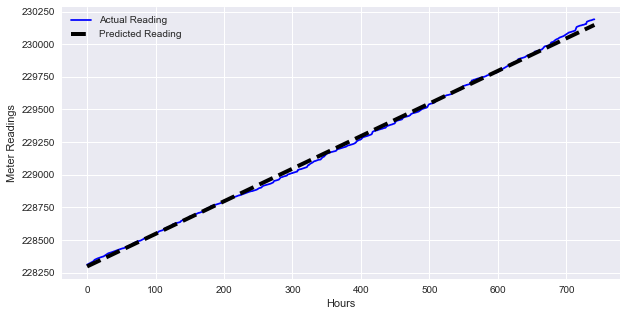

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


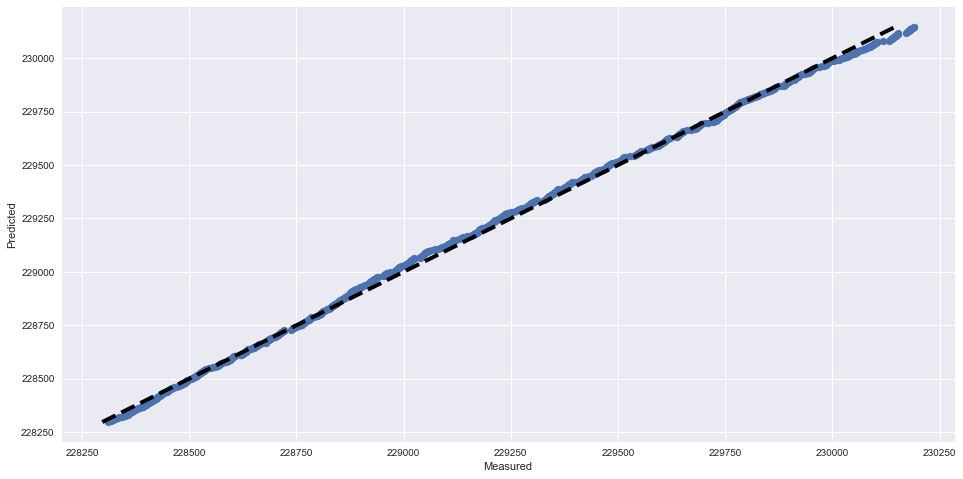

RMSE score: 19.7971347079
R2 score: 0.998652283489
---------------------------------------------------------------------------
Plotting SVR for Meter 7739
Time series plot of the actual and predicted hourly meter readings


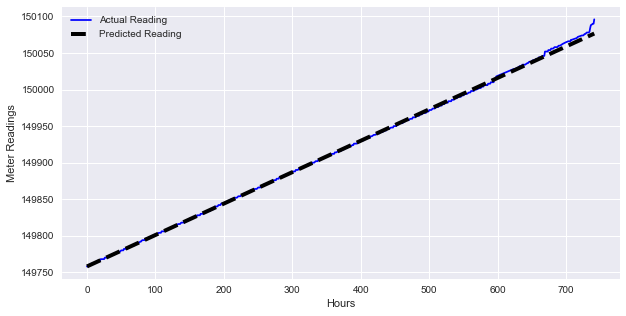

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


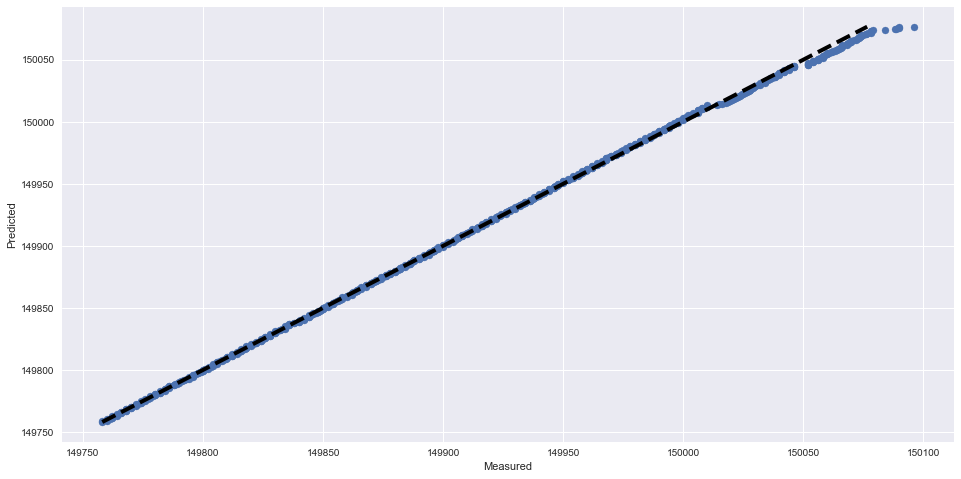

RMSE score: 2.45330033331
R2 score: 0.99930301475
---------------------------------------------------------------------------
Plotting SVR for Meter 7741
Time series plot of the actual and predicted hourly meter readings


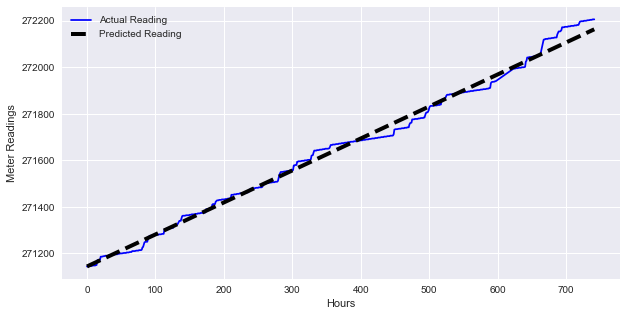

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


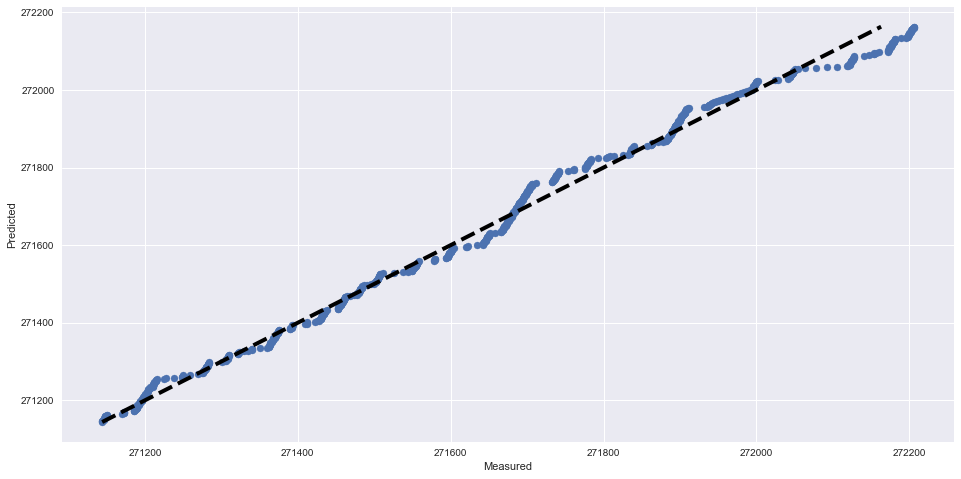

RMSE score: 26.0229639217
R2 score: 0.9925317895
---------------------------------------------------------------------------
Plotting SVR for Meter 7794
Time series plot of the actual and predicted hourly meter readings


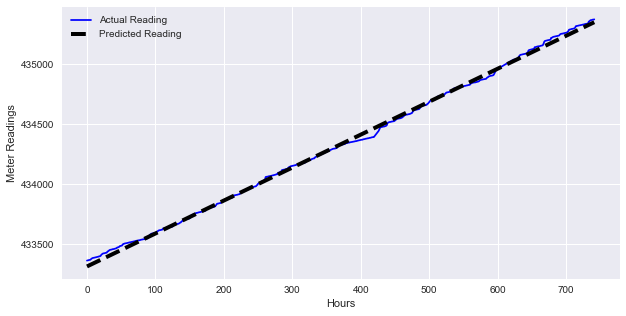

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


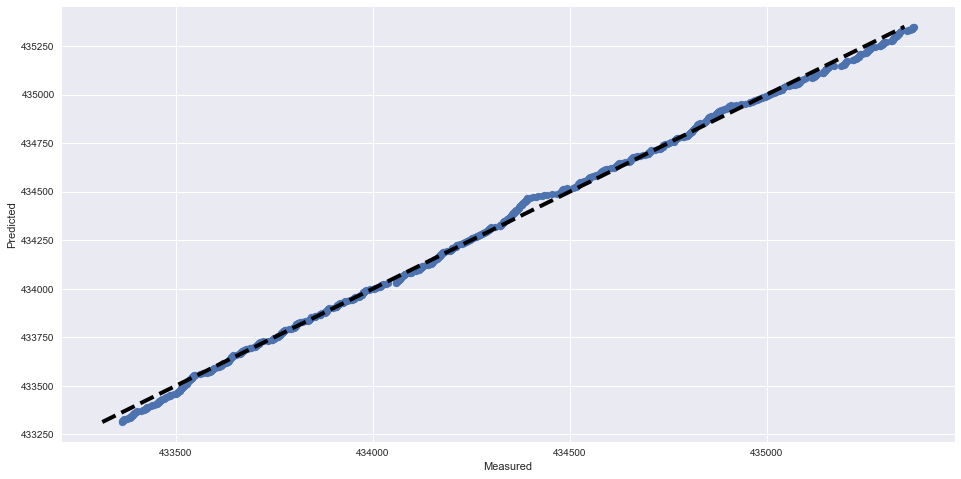

RMSE score: 23.0204934444
R2 score: 0.998462903553
---------------------------------------------------------------------------
Plotting SVR for Meter 7900
Time series plot of the actual and predicted hourly meter readings


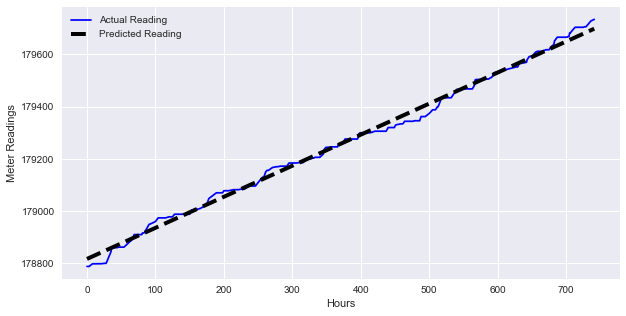

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


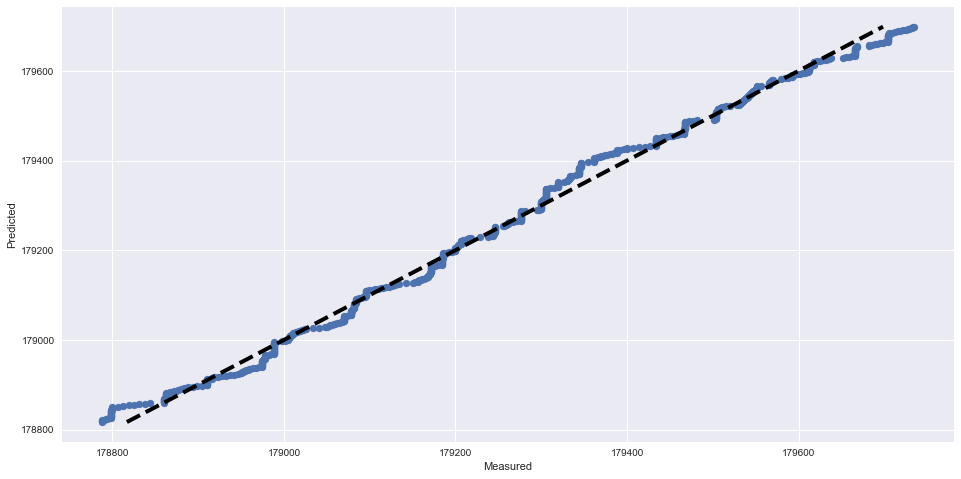

RMSE score: 19.0646030345
R2 score: 0.994506010557
---------------------------------------------------------------------------
Plotting SVR for Meter 7919
Time series plot of the actual and predicted hourly meter readings


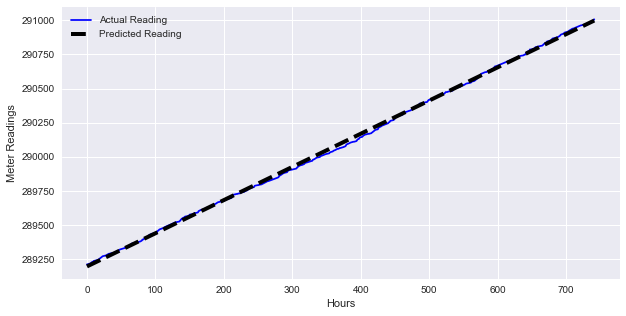

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


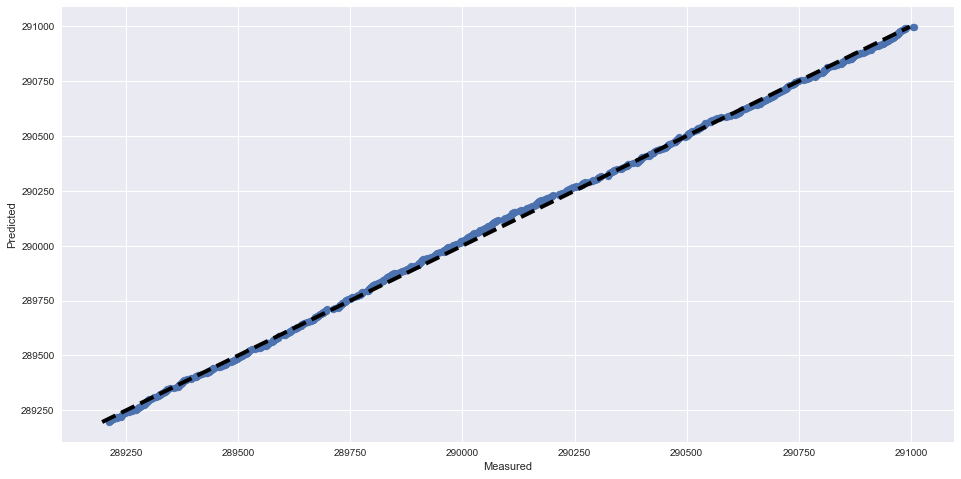

RMSE score: 14.5548793592
R2 score: 0.99922042546
---------------------------------------------------------------------------
Plotting SVR for Meter 7965
Time series plot of the actual and predicted hourly meter readings


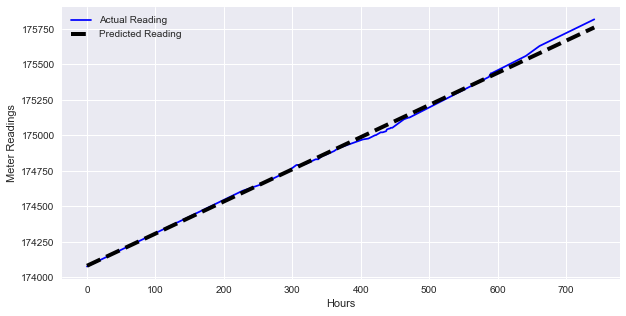

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


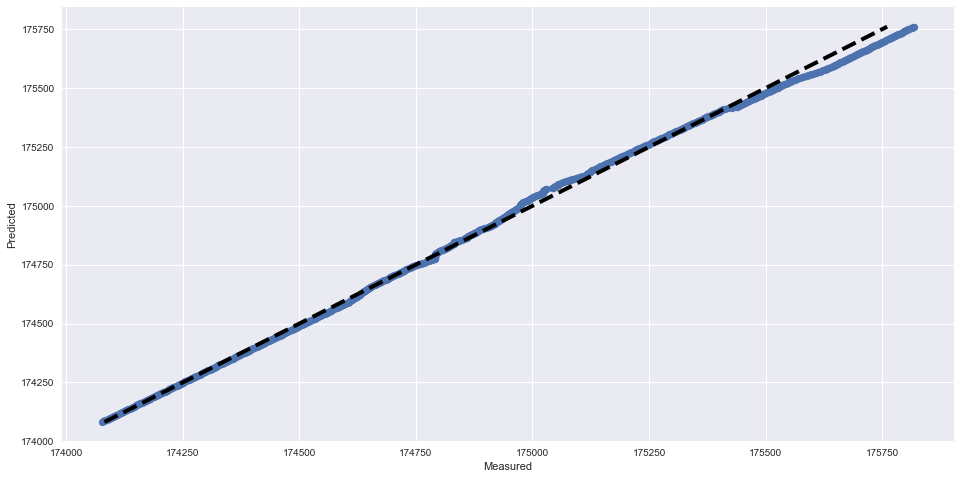

RMSE score: 23.2423108186
R2 score: 0.997791367474
---------------------------------------------------------------------------
Plotting SVR for Meter 8059
Time series plot of the actual and predicted hourly meter readings


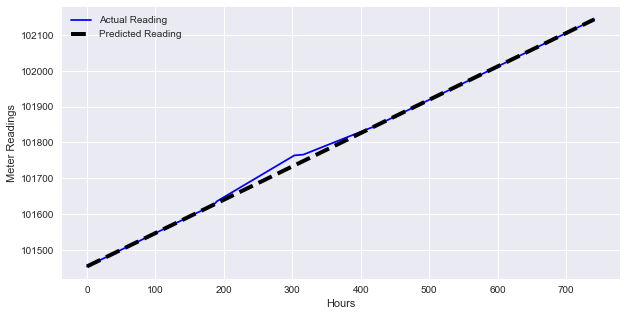

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


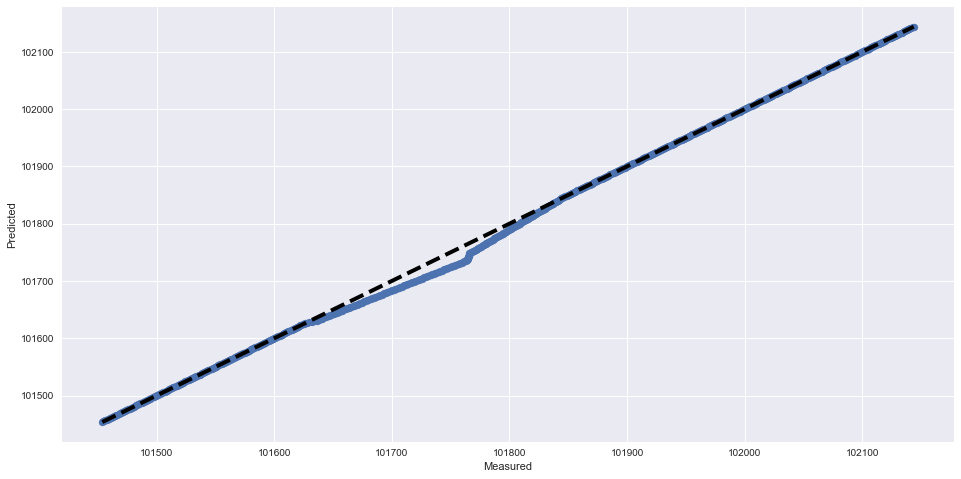

RMSE score: 8.56720363383
R2 score: 0.998127612571
---------------------------------------------------------------------------
Plotting SVR for Meter 8084
Time series plot of the actual and predicted hourly meter readings


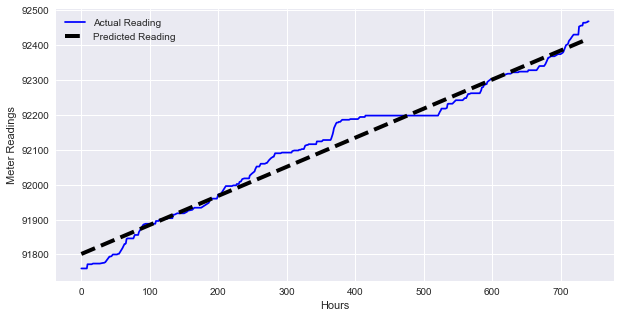

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


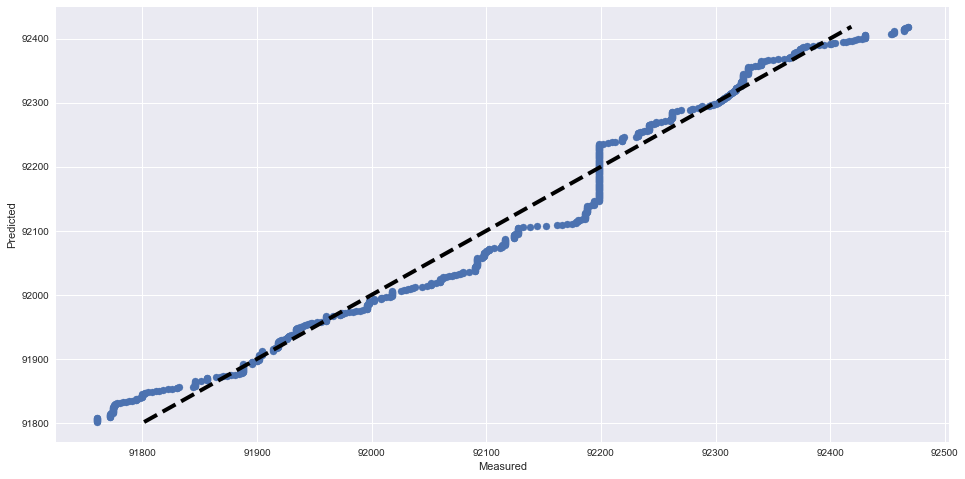

RMSE score: 29.121166753
R2 score: 0.975080423571
---------------------------------------------------------------------------
Plotting SVR for Meter 8086
Time series plot of the actual and predicted hourly meter readings


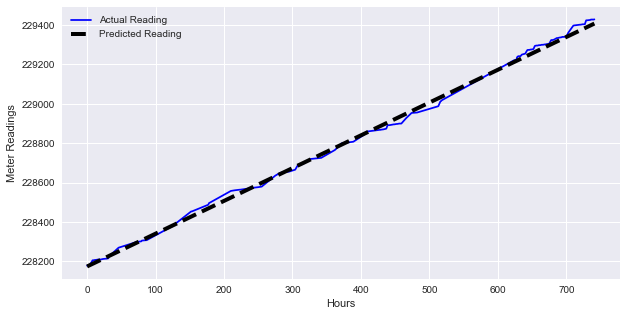

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


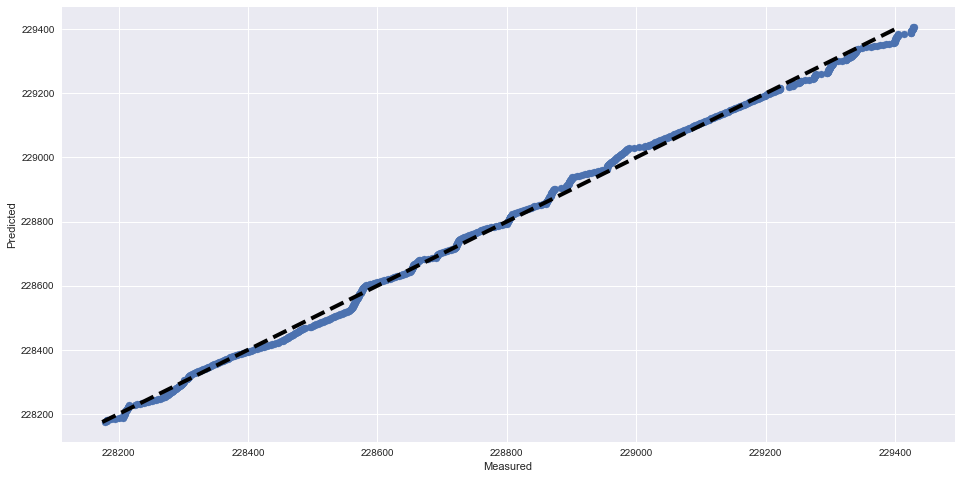

RMSE score: 17.1695790824
R2 score: 0.997682670923
---------------------------------------------------------------------------
Plotting SVR for Meter 8155
Time series plot of the actual and predicted hourly meter readings


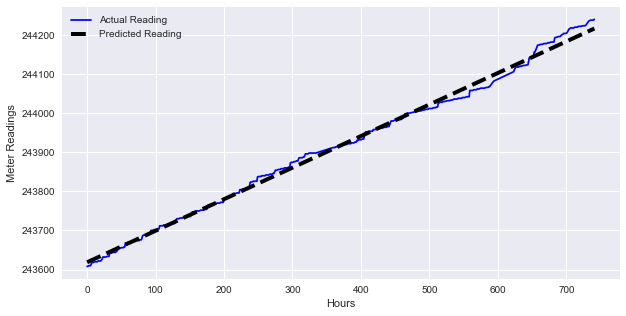

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


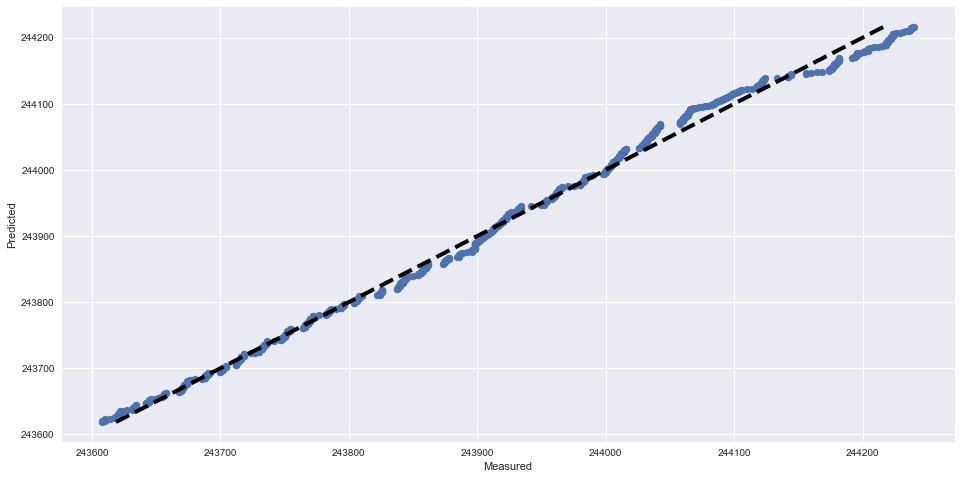

RMSE score: 12.0165871846
R2 score: 0.995250224986
---------------------------------------------------------------------------
Plotting SVR for Meter 8156
Time series plot of the actual and predicted hourly meter readings


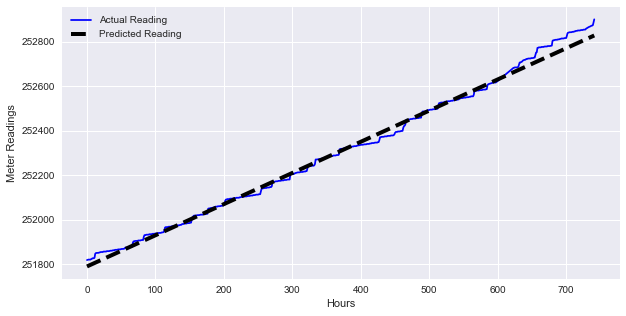

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


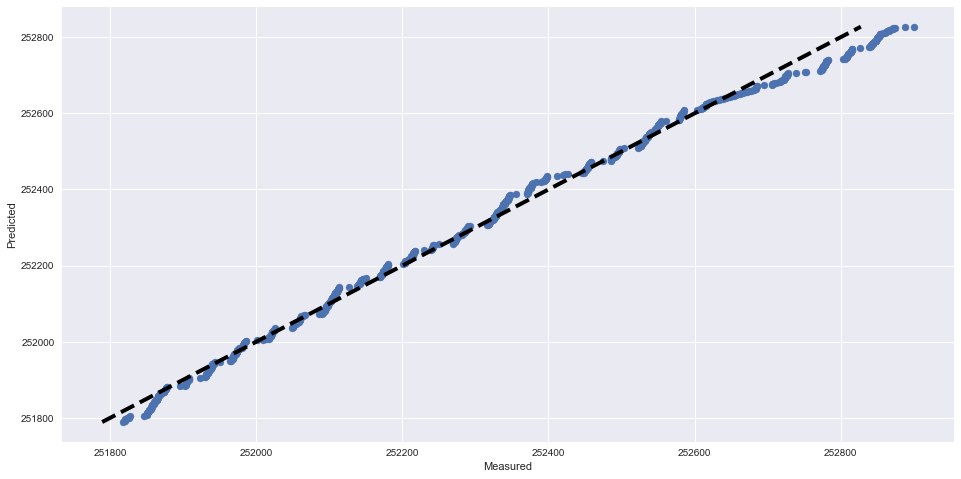

RMSE score: 23.8667575709
R2 score: 0.993967661185
---------------------------------------------------------------------------
Plotting SVR for Meter 8467
Time series plot of the actual and predicted hourly meter readings


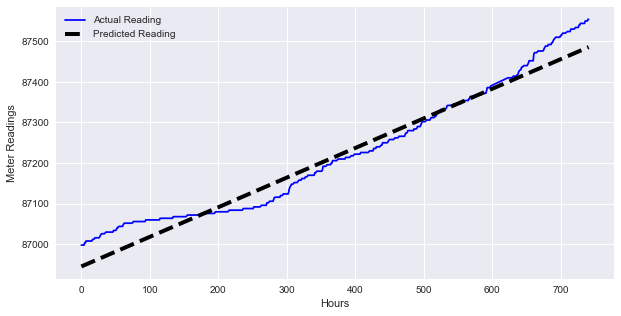

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


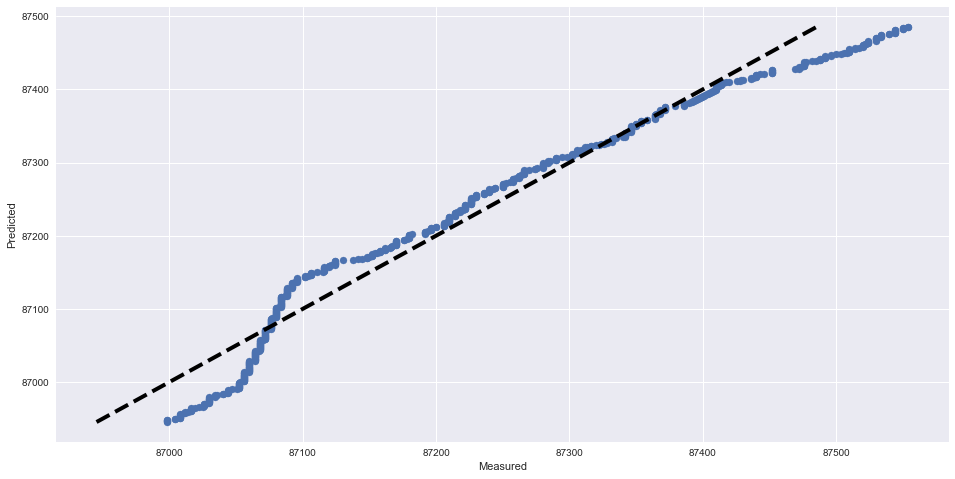

RMSE score: 32.6551139402
R2 score: 0.957731456169
---------------------------------------------------------------------------
Plotting SVR for Meter 8703
Time series plot of the actual and predicted hourly meter readings


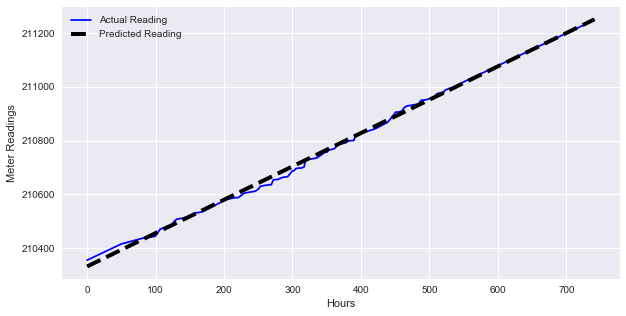

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


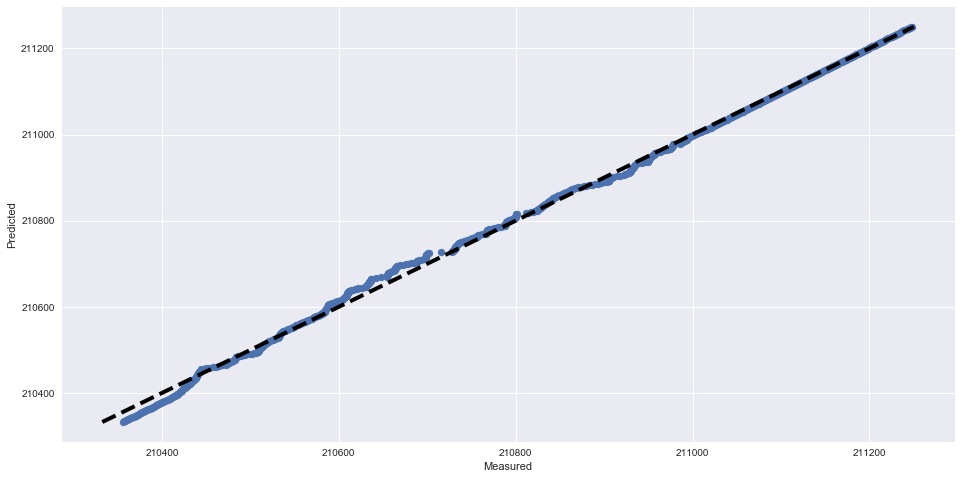

RMSE score: 11.27725527
R2 score: 0.99817920705
---------------------------------------------------------------------------
Plotting SVR for Meter 8829
Time series plot of the actual and predicted hourly meter readings


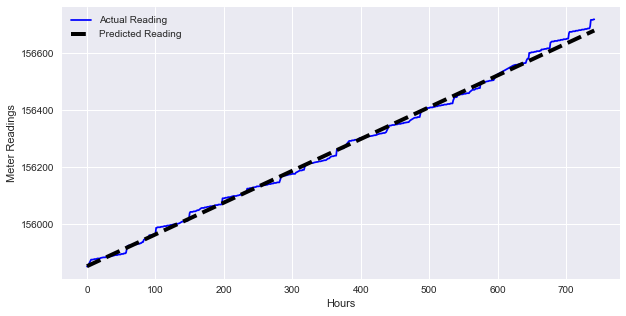

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


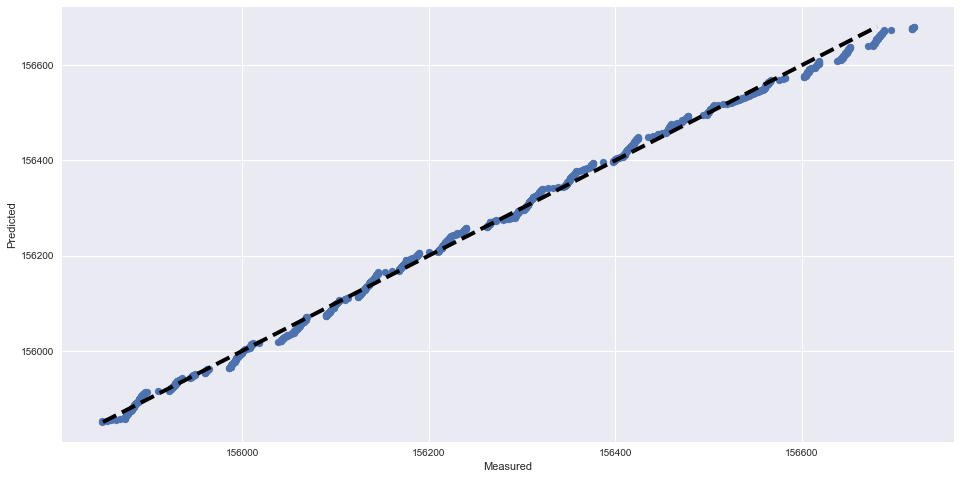

RMSE score: 12.8883881403
R2 score: 0.997177578275
---------------------------------------------------------------------------
Plotting SVR for Meter 8890
Time series plot of the actual and predicted hourly meter readings


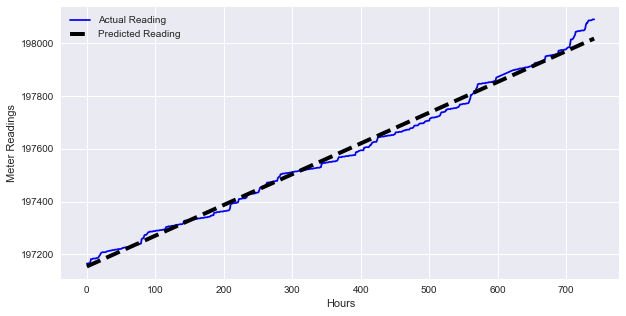

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


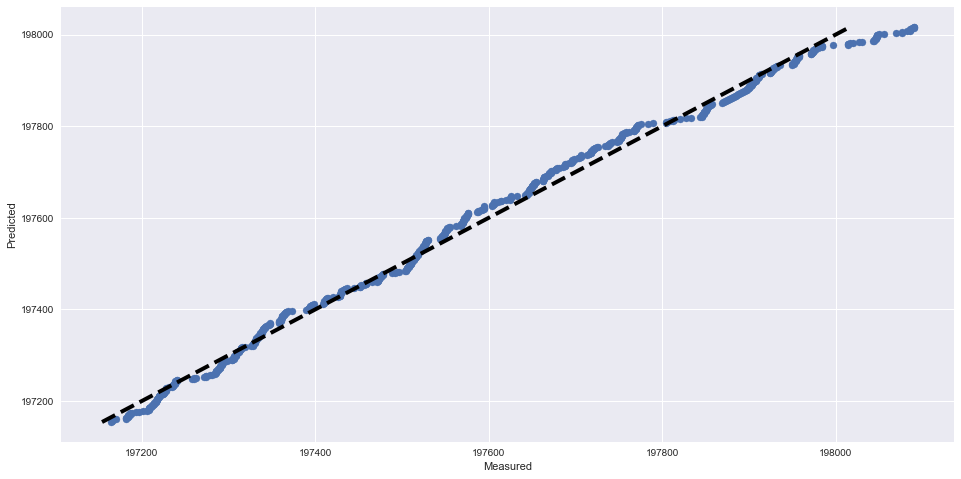

RMSE score: 21.1378313314
R2 score: 0.992999470734
---------------------------------------------------------------------------
Plotting SVR for Meter 9052
Time series plot of the actual and predicted hourly meter readings


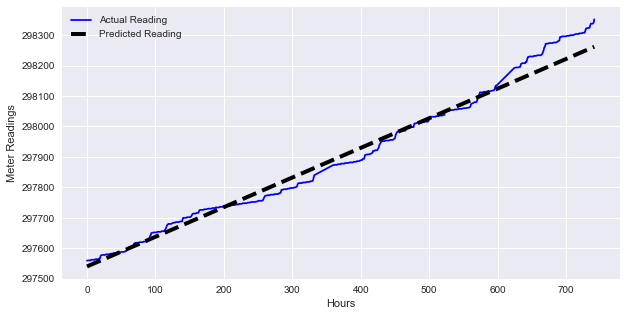

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


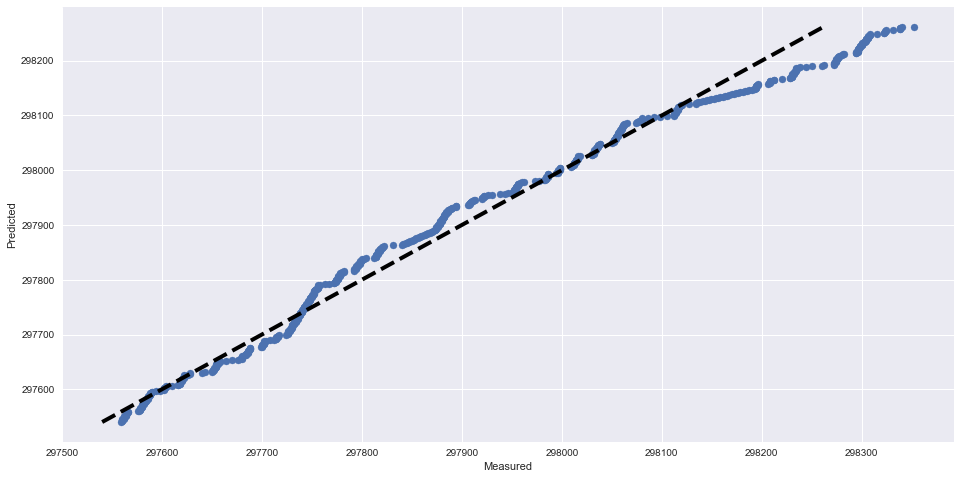

RMSE score: 31.6177043752
R2 score: 0.980027212071
---------------------------------------------------------------------------
Plotting SVR for Meter 9121
Time series plot of the actual and predicted hourly meter readings


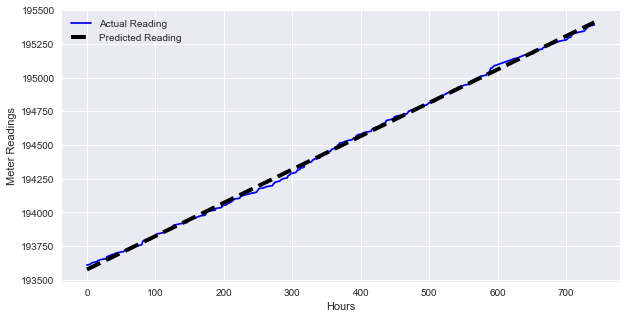

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


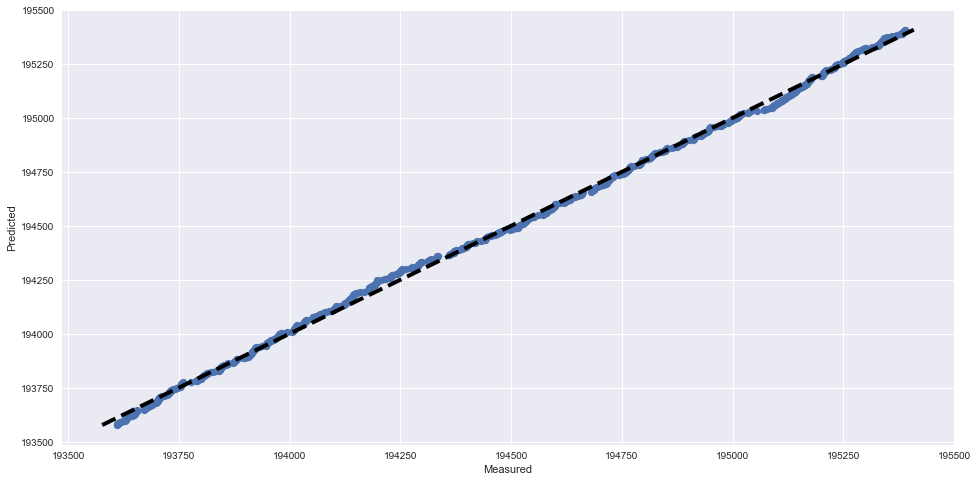

RMSE score: 17.5247120044
R2 score: 0.998909073661
---------------------------------------------------------------------------
Plotting SVR for Meter 9134
Time series plot of the actual and predicted hourly meter readings


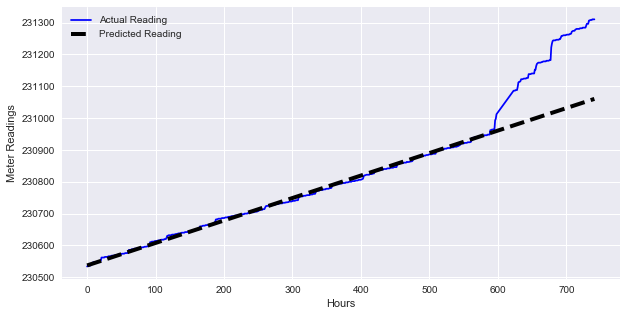

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


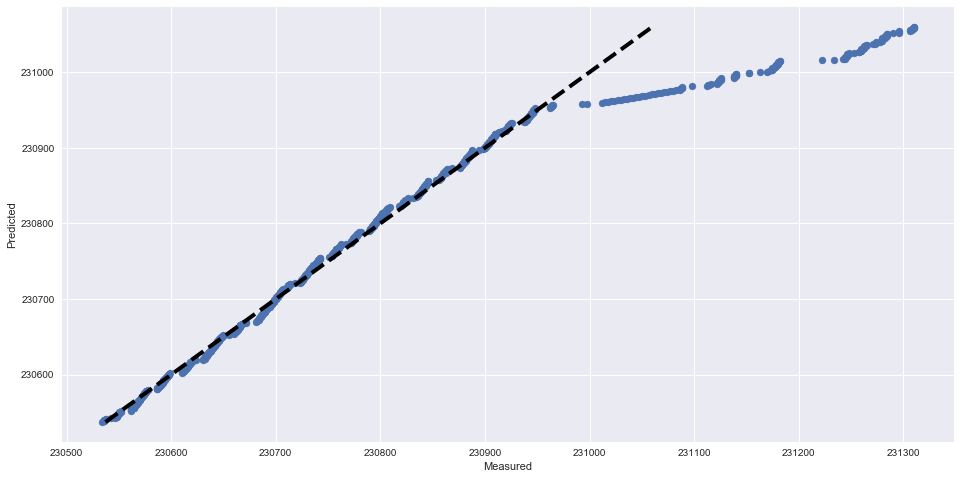

RMSE score: 81.3220686996
R2 score: 0.845940154909
---------------------------------------------------------------------------
Plotting SVR for Meter 9278
Time series plot of the actual and predicted hourly meter readings


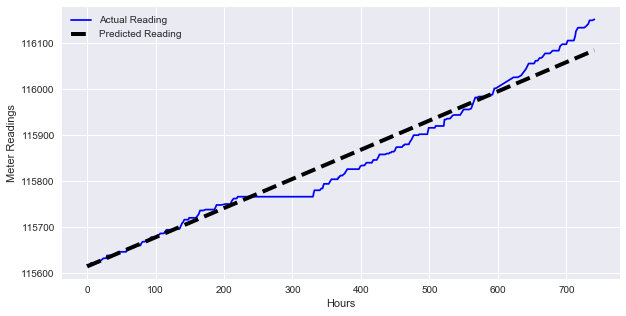

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


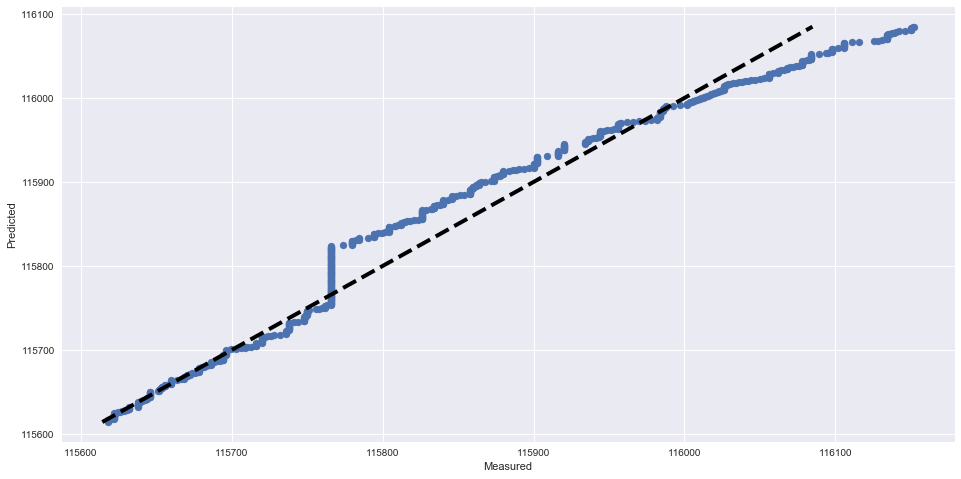

RMSE score: 27.2263285332
R2 score: 0.965310282516
---------------------------------------------------------------------------
Plotting SVR for Meter 9295
Time series plot of the actual and predicted hourly meter readings


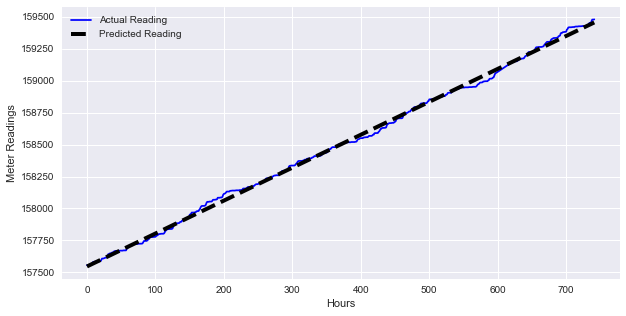

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


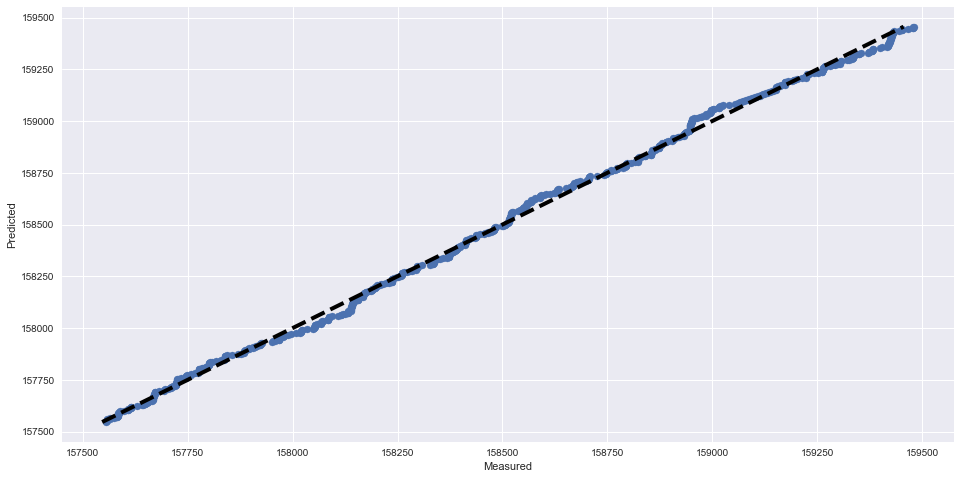

RMSE score: 23.993491013
R2 score: 0.998104181884
---------------------------------------------------------------------------
Plotting SVR for Meter 9474
Time series plot of the actual and predicted hourly meter readings


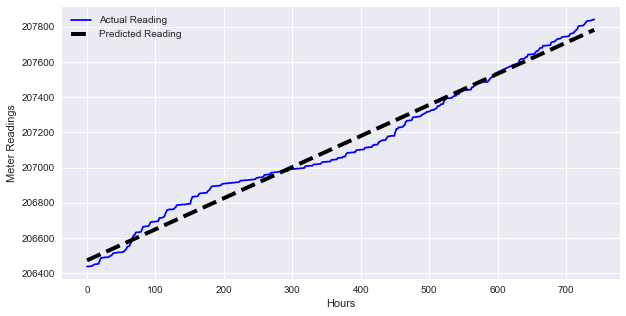

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


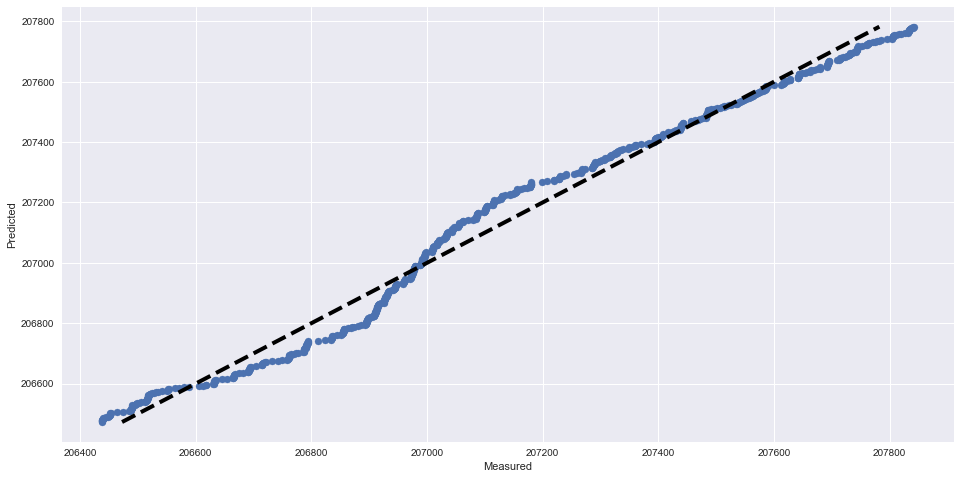

RMSE score: 49.8705947512
R2 score: 0.982507080611
---------------------------------------------------------------------------
Plotting SVR for Meter 9631
Time series plot of the actual and predicted hourly meter readings


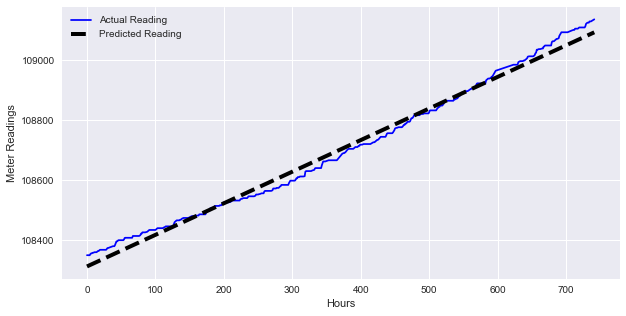

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


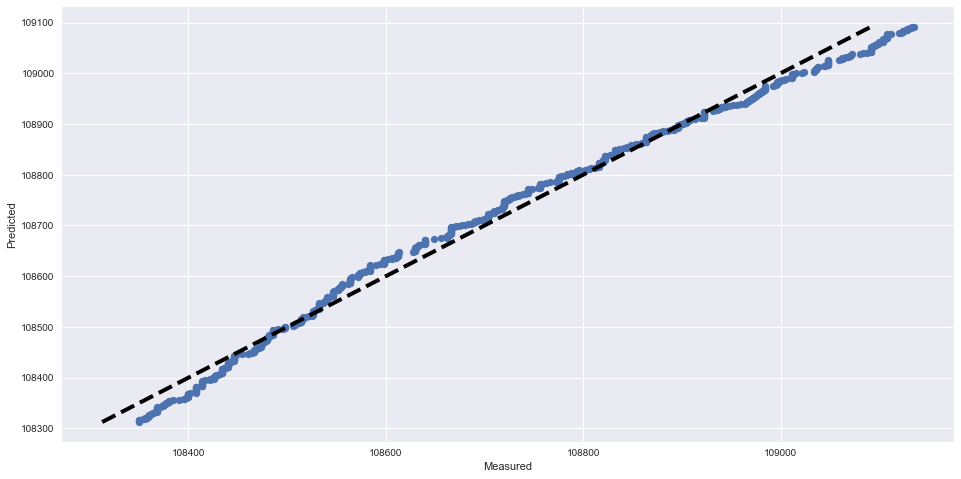

RMSE score: 22.7697381136
R2 score: 0.990071339198
---------------------------------------------------------------------------
Plotting SVR for Meter 9639
Time series plot of the actual and predicted hourly meter readings


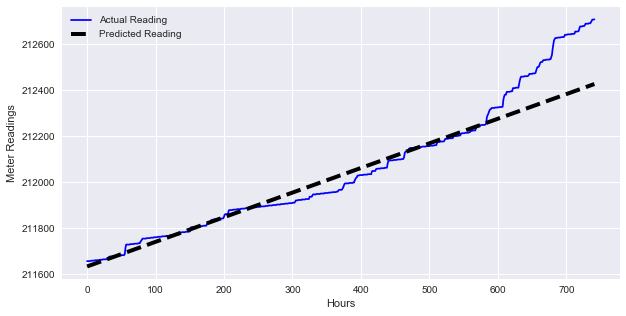

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


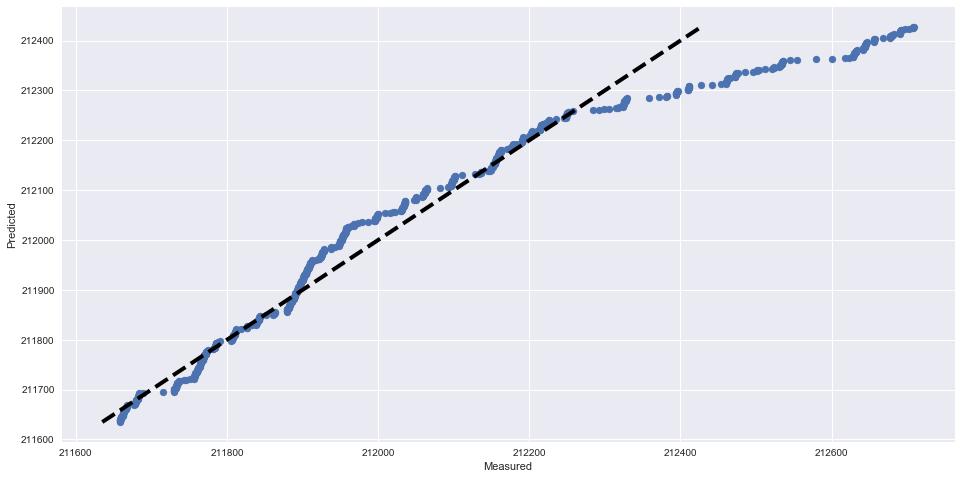

RMSE score: 91.2259843017
R2 score: 0.899749421969
---------------------------------------------------------------------------
Plotting SVR for Meter 9729
Time series plot of the actual and predicted hourly meter readings


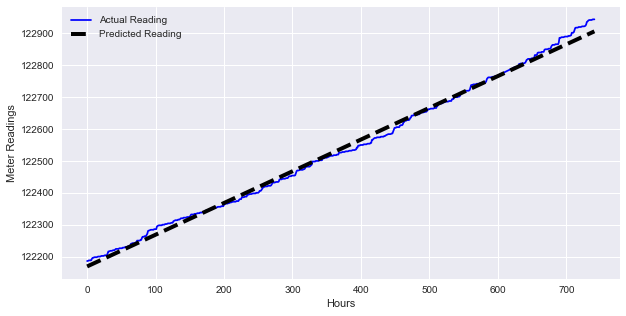

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


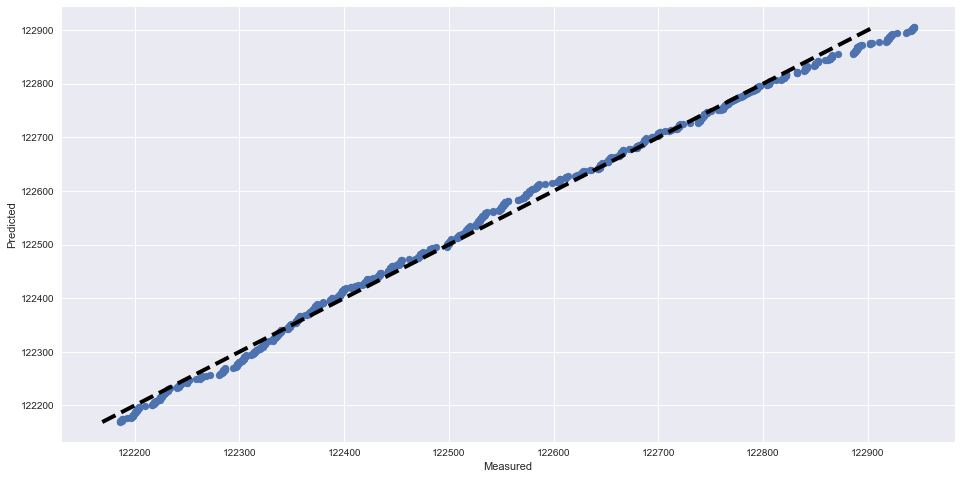

RMSE score: 14.2903946308
R2 score: 0.995587417465
---------------------------------------------------------------------------
Plotting SVR for Meter 9766
Time series plot of the actual and predicted hourly meter readings


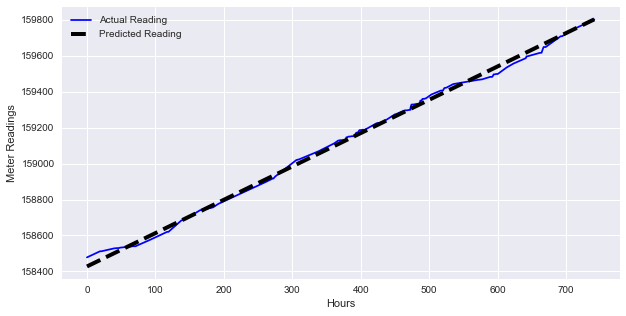

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


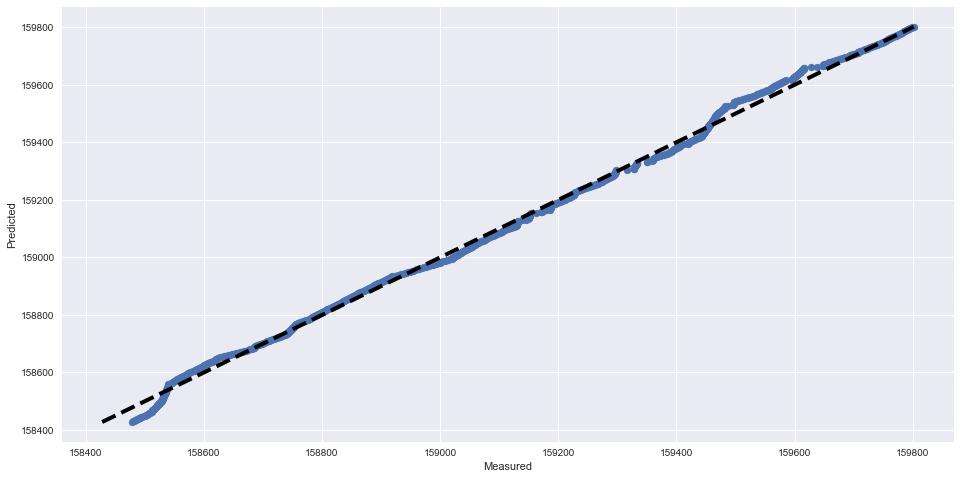

RMSE score: 19.9664268034
R2 score: 0.997408620047
---------------------------------------------------------------------------
Plotting SVR for Meter 9849
Time series plot of the actual and predicted hourly meter readings


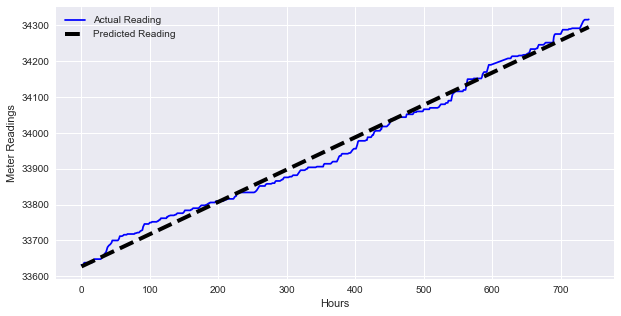

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


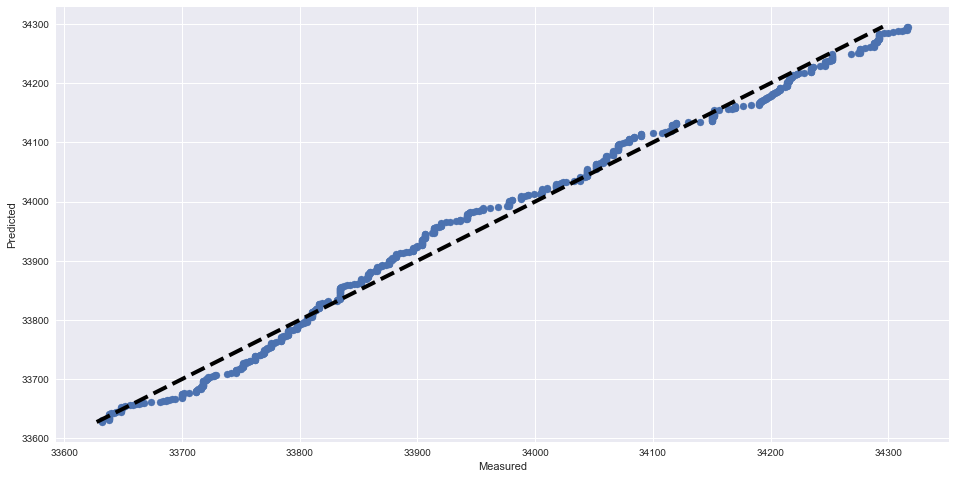

RMSE score: 19.8071941083
R2 score: 0.989422219301
---------------------------------------------------------------------------
Plotting SVR for Meter 9956
Time series plot of the actual and predicted hourly meter readings


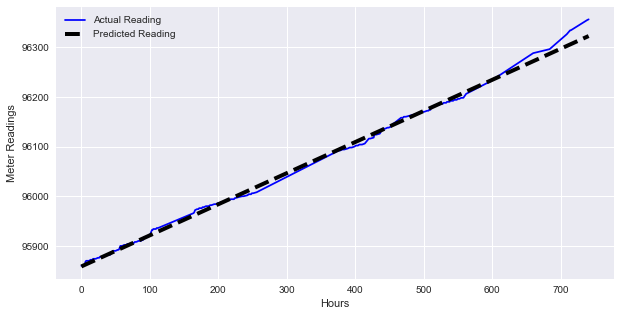

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


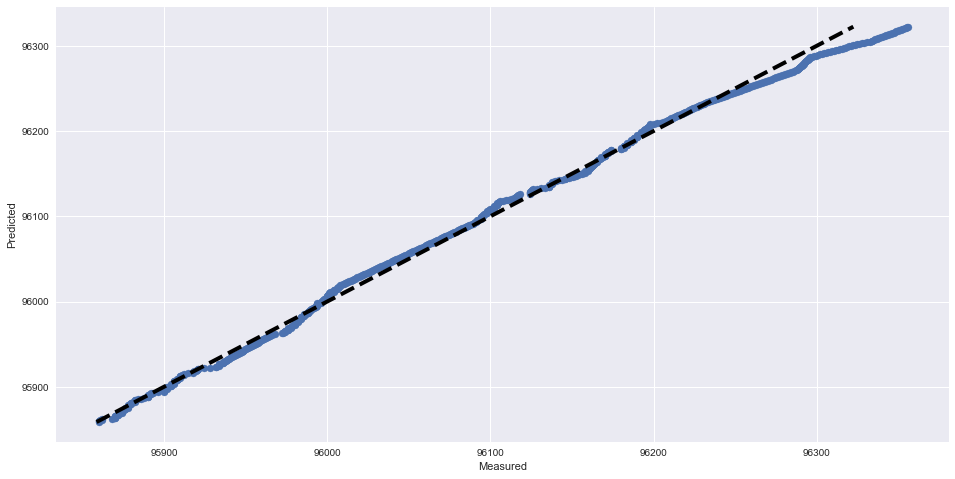

RMSE score: 9.31485670155
R2 score: 0.995423989868
---------------------------------------------------------------------------
Plotting SVR for Meter 9982
Time series plot of the actual and predicted hourly meter readings


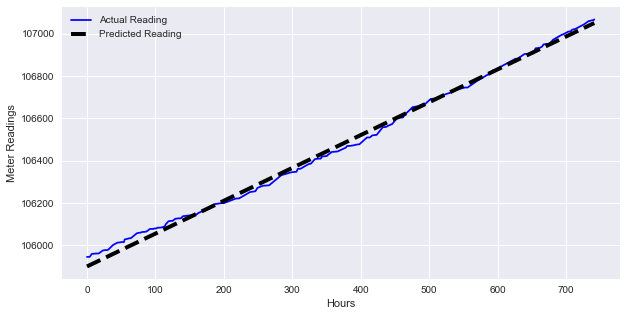

Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)


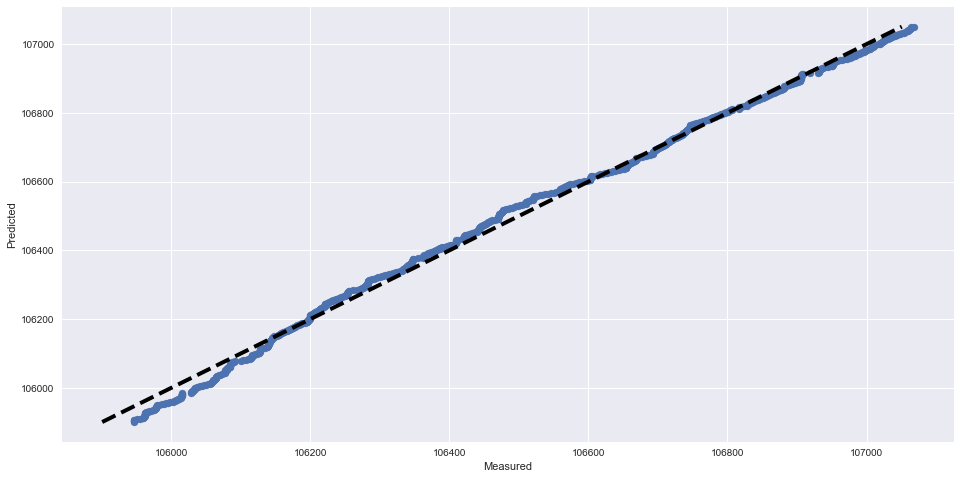

RMSE score: 20.7248013205
R2 score: 0.996007205798
---------------------------------------------------------------------------


In [101]:
from sklearn.svm import SVR

for key in new_timings:
    print('Plotting SVR for Meter', key)
    #svr_lin = SVR(kernel='linear', C=100, gamma='auto')
    svr_lin = SVR(kernel='linear')
    y = new_timings[key]
    X = np.arange(len(new_timings[key])).reshape(-1,1)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
    y_pred_SVR = svr_lin.fit(X_train, y_train).predict(X)
    fig, ax = plt.subplots(figsize=(10,5))
    ax.plot(X, y,  color='blue', label='Actual Reading')
    ax.plot(X, y_pred_SVR, 'k--', lw=4, label='Predicted Reading')
    ax.legend()
    ax.set_xlabel('Hours')
    ax.set_ylabel('Meter Readings')
    print('Time series plot of the actual and predicted hourly meter readings')
    plt.show()
    fig, ax = plt.subplots(figsize=(16,8))
    ax.scatter(y, y_pred_SVR)
    ax.plot([y_pred_SVR.min(), y_pred_SVR.max()], [y_pred_SVR.min(), y_pred_SVR.max()], 'k--', lw=4)
    ax.set_xlabel('Measured')
    ax.set_ylabel('Predicted')
    print('Scatter plot of actual vs predicted meter readings (along with the line showing how good the ﬁt is)')
    
    plt.show()
    rmse = np.sqrt(mean_squared_error(y,y_pred_SVR))
    r2 = r2_score(y,y_pred_SVR)
    print("RMSE score:", rmse)
    print("R2 score:", r2)
    print('---------------------------------------------------------------------------')

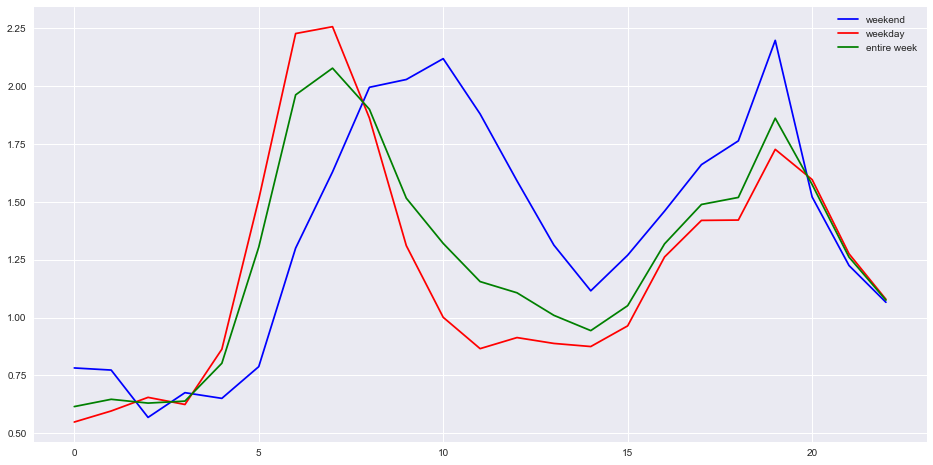

In [102]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler

sc = MinMaxScaler()
vals_temp = list(new_timings.values())
vals_temp = vals_temp[0:6]+vals_temp[7:]
###################################
vals_temp_experiment = list(map(lambda x: np.insert(x, 0, x[0]), vals_temp))
vals_temp_experiment = list(map(lambda x: np.insert(x, -1, x[-1]), vals_temp_experiment))

vals_temp_experiment = list(map(lambda x: np.split(x, 31), vals_temp_experiment))
vals_temp_experiment = list([item[0:7] for item in vals_temp_experiment]) #1st october to 7th october/ 2nd 3rd october weekends
vals_temp_experiment_weekend = list([item[2:4]for item in vals_temp_experiment])
vals_temp_experiment_weekday = list([item[0:2] + item[4:] for item in vals_temp_experiment])
vals_temp_experiment_weekend = [item for sublist in vals_temp_experiment_weekend for item in sublist]
vals_temp_experiment_weekday = [item for sublist in vals_temp_experiment_weekday for item in sublist]
vals_temp_experiment = [item for sublist in vals_temp_experiment for item in sublist]

vals_temp_experiment_weekend = list(map(lambda x: np.diff(x), vals_temp_experiment_weekend))
vals_temp_experiment_weekday = list(map(lambda x: np.diff(x), vals_temp_experiment_weekday))
vals_temp_experiment = list(map(lambda x: np.diff(x), vals_temp_experiment))

vals_temp_experiment_weekend_np = np.array(vals_temp_experiment_weekend)
vals_temp_experiment_weekday_np = np.array(vals_temp_experiment_weekday)
val_temp_experiment_np = np.array(vals_temp_experiment)

weekend_mean = np.mean(vals_temp_experiment_weekend_np, axis=0)
weekday_mean = np.mean(vals_temp_experiment_weekday_np, axis=0)
all_mean = np.mean(np.array(vals_temp_experiment), axis=0)

################

fig, ax = plt.subplots(figsize=(16,8))
hours = np.arange(len(weekend_mean))
ax.plot(hours, weekend_mean, color='blue', label = 'weekend')
ax.plot(hours, weekday_mean, color='red', label = 'weekday')
ax.plot(hours, all_mean, color='green', label = 'entire week')
ax.legend()
plt.show()


In [123]:

from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score

sillhoute_scores_weekend = []
sillhoute_scores_weekday = []
sillhoute_scores = []

n_cluster_list = np.arange(2,10).astype(int)
#sc_vals = sc.fit_transform(vals_temp_experiment)
sc_vals_weekend = MinMaxScaler().fit_transform(vals_temp_experiment_weekend)
sc_vals_weekday = MinMaxScaler().fit_transform(vals_temp_experiment_weekday)
sc_vals = MinMaxScaler().fit_transform(vals_temp_experiment)
#sc_vals_weekend = vals_temp_experiment_weekend
#sc_vals_weekday = vals_temp_experiment_weekday
#sc_vals = vals_temp_experiment
for n_cluster in n_cluster_list:
    
    kmeans = KMeans(n_clusters=n_cluster)
    cluster_found = kmeans.fit_predict(sc_vals_weekend)
    sillhoute_scores_weekend.append(silhouette_score(sc_vals_weekend, kmeans.labels_))

for n_cluster in n_cluster_list:
    
    kmeans = KMeans(n_clusters=n_cluster)
    cluster_found = kmeans.fit_predict(sc_vals_weekday)
    sillhoute_scores_weekday.append(silhouette_score(sc_vals_weekday, kmeans.labels_))

for n_cluster in n_cluster_list:
    
    kmeans = KMeans(n_clusters=n_cluster)
    cluster_found = kmeans.fit_predict(sc_vals)
    sillhoute_scores.append(silhouette_score(sc_vals, kmeans.labels_))

In [124]:
fig, ax = plt.subplots(figsize=(16,8))
plt.xticks(np.arange(2, 10, 1.0))
plt.plot(n_cluster_list, sillhoute_scores_weekend, color='blue', label='weekend')
plt.plot(n_cluster_list, sillhoute_scores_weekday, color='red',label='weekday')
plt.plot(n_cluster_list, sillhoute_scores, color='green', label='weekly')
ax.set_xlabel('Number of Clusters')
ax.set_ylabel('Silhouette Value')
plt.legend()

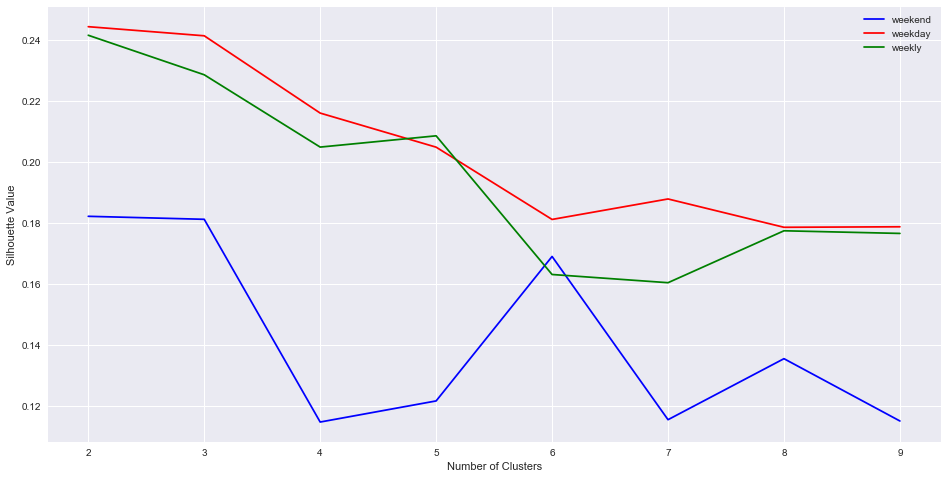

In [125]:
plt.show()

In [106]:
#sc_vals_weekday = StandardScaler().fit_transform(sc_vals_weekday)
kmeans = KMeans(n_clusters=2)
cluster_found = kmeans.fit_predict(sc_vals)
cluster_found_sr = pd.Series(cluster_found, name='cluster')
#sort into cluster 1,2,3,4
cluster_1 = []
cluster_2 = []
cluster_3 = []
cluster_4 = []
cluster_1_id = []
cluster_2_id = []
cluster_3_id = []
for i in range(len(vals_temp_experiment)):
    id_idx = i//7
    if cluster_found[i] == 0:
        cluster_1.append(vals_temp_experiment[i])
        
        cluster_1_id.append(all_id[id_idx])
    elif cluster_found[i] == 1:
        cluster_2.append(vals_temp_experiment[i])
        cluster_2_id.append(all_id[id_idx])
    elif cluster_found[i] == 2:
        cluster_3.append(vals_temp_experiment[i])
        cluster_3_id.append(all_id[id_idx])
    else:
        cluster_4.append(vals_temp_experiment[i])

cluster_1 = np.array(cluster_1)
cluster_2 = np.array(cluster_2)
cluster_3 = np.array(cluster_3)
cluster_4 = np.array(cluster_4)
cluster_1_id = list(set(cluster_1_id))
cluster_2_id = list(set(cluster_2_id))
cluster_3_id = list(set(cluster_3_id))

cluster_1_mean = np.mean(cluster_1, axis=0)
cluster_2_mean = np.mean(cluster_2, axis=0)
cluster_3_mean = np.mean(cluster_3, axis=0)
cluster_4_mean = np.mean(cluster_4, axis=0)



color_list = ['blue','red','green', 'black']
plt.figure(figsize=(16,8))
plt.title("Weekly Mean Readings")
plt.style.use('seaborn')

plt.plot(cluster_1_mean, 'g--', alpha=0.9, label = "Cluster 1 Mean Readings")
plt.plot(cluster_2_mean, 'k--', alpha=0.9, label = "Cluster 2 Mean Readings")
plt.plot(cluster_3_mean, 'r--', alpha=0.9)
plt.plot(cluster_4_mean, 'b--', alpha=0.9)
plt.legend()

[1 0 1 0 0 1 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 1 0 0
 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1 0 1 1 0 0 0 1 0 0 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 0 0 1 0 1 1 1 1 0 1 0 0 0
 1 1 1 0 1 1 1 1 0 0 1 0 0 0 0 1 0 0 0 0 1 0 1 1 0 0 0 0 0 1 1 1 0 1 1 1 1
 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 0 0 0 0 1 0 1
 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 1 0 1 1 0 0 0
 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 1 1 1 0 0 0 1 0 1 1 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1 1 0 1 1 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1
 1 1 1 1 0 1 1 1 1 1 1 0 0 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1
 0 0 1 0 1 0 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 1 0 1 0 1 1 1 1 1
 1 1 1 1 1 1 0 0 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 0 0 0 0
 0 0 1 1 1 1 1 1 1 1 1 1 

C:\Users\willi\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2909: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
C:\Users\willi\Anaconda3\lib\site-packages\numpy\core\_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


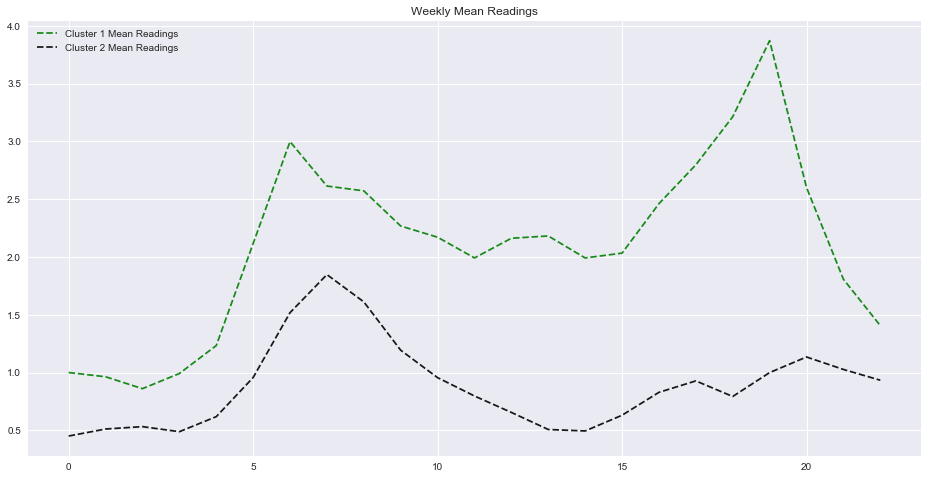

In [107]:
plt.show()

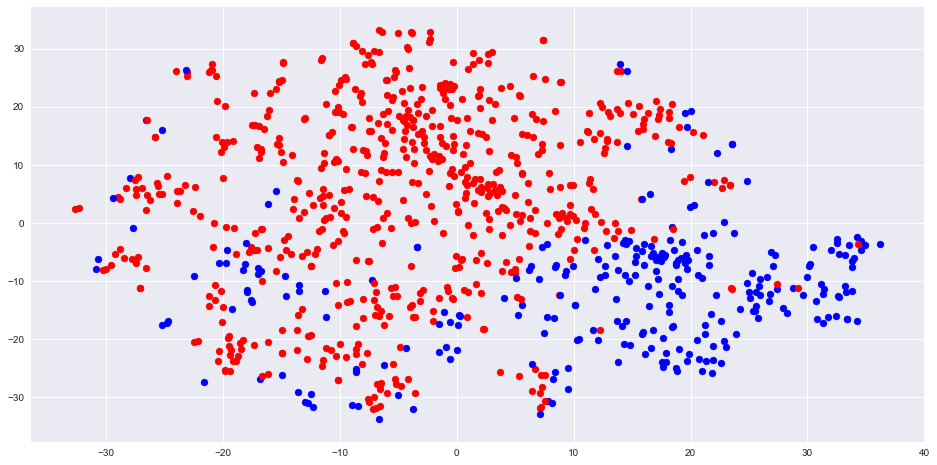

In [108]:
from sklearn.manifold import TSNE
import matplotlib.colors

tsne = TSNE()
results_tsne = tsne.fit_transform(sc_vals)
plt.figure(figsize=(16,8))
for i in range(len(results_tsne)):
    c = color_list[cluster_found[i]]
    plt.scatter(results_tsne[i][0], results_tsne[i][1], color = c)
plt.show()

C:\Users\willi\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2909: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
C:\Users\willi\Anaconda3\lib\site-packages\numpy\core\_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


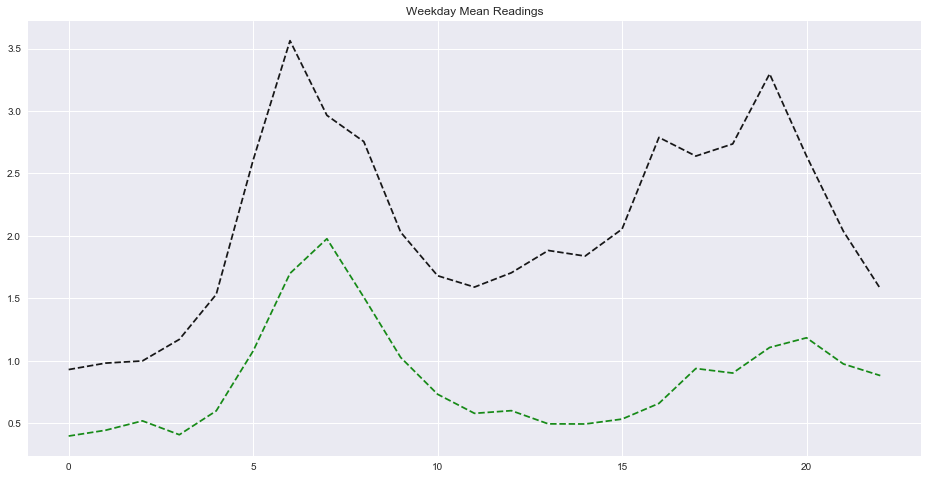

In [109]:
kmeans = KMeans(n_clusters=2)
cluster_found = kmeans.fit_predict(sc_vals_weekday)
cluster_found_sr = pd.Series(cluster_found, name='cluster')

#sort into cluster 1,2,3,4
cluster_1 = []
cluster_2 = []
cluster_3 = []
cluster_4 = []
for i in range(len(vals_temp_experiment_weekday)):
    if cluster_found[i] == 0:
        cluster_1.append(vals_temp_experiment_weekday[i])
    elif cluster_found[i] == 1:
        cluster_2.append(vals_temp_experiment_weekday[i])
    elif cluster_found[i] == 2:
        cluster_3.append(vals_temp_experiment_weekday[i])
    else:
        cluster_4.append(vals_temp_experiment_weekday[i])
    
cluster_1 = np.array(cluster_1)
cluster_2 = np.array(cluster_2)
cluster_3 = np.array(cluster_3)
cluster_4 = np.array(cluster_4)


cluster_1_mean = np.mean(cluster_1, axis=0)
cluster_2_mean = np.mean(cluster_2, axis=0)
cluster_3_mean = np.mean(cluster_3, axis=0)
cluster_4_mean = np.mean(cluster_4, axis=0)

#cluster_3_median = np.median(cluster_3, axis=0)    

color_list = ['blue','red','green', 'black']
plt.figure(figsize=(16,8))
plt.title("Weekday Mean Readings")
plt.style.use('seaborn')

#plt.plot(cluster_3_median, 'g--')
#for i in range(len(vals_temp_experiment)):
#    x = np.arange(1, len(vals_temp_experiment[i])+1)
 #   print(x)
    #plt.plot(x, sc_vals[i], color=color_list[cluster_found[i]], alpha=0.01)
    #plt.plot(x, vals_temp_experiment[i], color=color_list[cluster_found[i]], alpha=0.01)
plt.plot(cluster_1_mean, 'g--', alpha=0.9, label = "Cluster 1 Mean Readings")
plt.plot(cluster_2_mean, 'k--', alpha=0.9, label = "Cluster 2 Mean Readings")
plt.plot(cluster_3_mean, 'r--', alpha=0.9)
plt.plot(cluster_4_mean, 'b--', alpha=0.9)
plt.show()

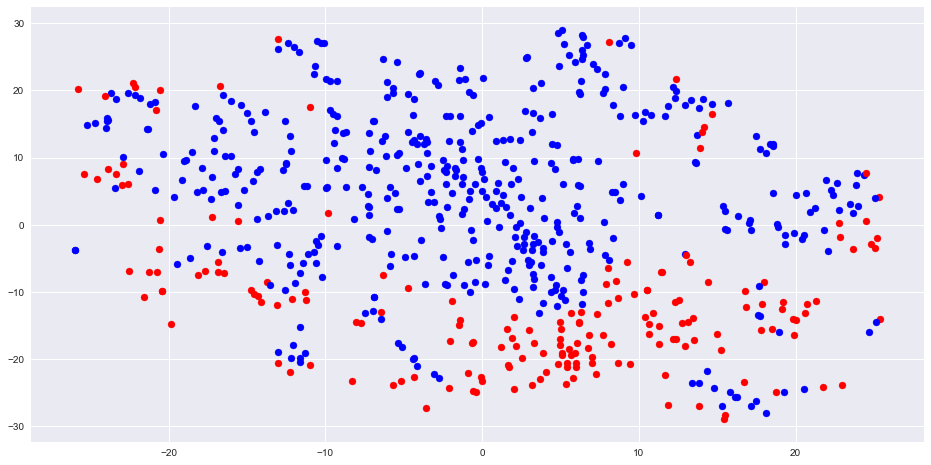

In [110]:
tsne = TSNE()
results_tsne = tsne.fit_transform(sc_vals_weekday)
plt.figure(figsize=(16,8))
for i in range(len(results_tsne)):
    c = color_list[cluster_found[i]]
    plt.scatter(results_tsne[i][0], results_tsne[i][1], color = c)
plt.show()

[0 0 0 0 1 1 0 1 1 0 0 0 1 1 1 1 1 0 0 0 1 1 1 1 1 0 1 1 1 0 1 0 0 1 0 0 0
 0 0 0 1 0 1 0 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 0 0 0 1 1 0 0 0 1 0 0 0 1
 1 1 0 0 0 1 1 1 1 1 1 0 0 1 0 0 1 1 0 0 0 0 1 1 1 1 1 1 1 1 0 1 1 1 1 0 1
 1 1 1 0 1 0 1 1 1 1 1 1 1 0 1 1 1 0 0 1 0 1 1 1 1 0 0 1 1 1 1 1 1 0 1 1 1
 1 1 0 0 1 0 1 1 0 0 1 1 0 0 1 1 0 0 1 0 1 1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1
 1 1 0 0 1 0 0 1 1 0 0 1 1 0 1 1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 1 1 0 0 1 1
 1 1 0 0 1 1 1 1 0 0 1 0 1 1 1 0 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 0 1 0 1 1 1
 1]
103
157
0
0


C:\Users\willi\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2909: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
C:\Users\willi\Anaconda3\lib\site-packages\numpy\core\_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


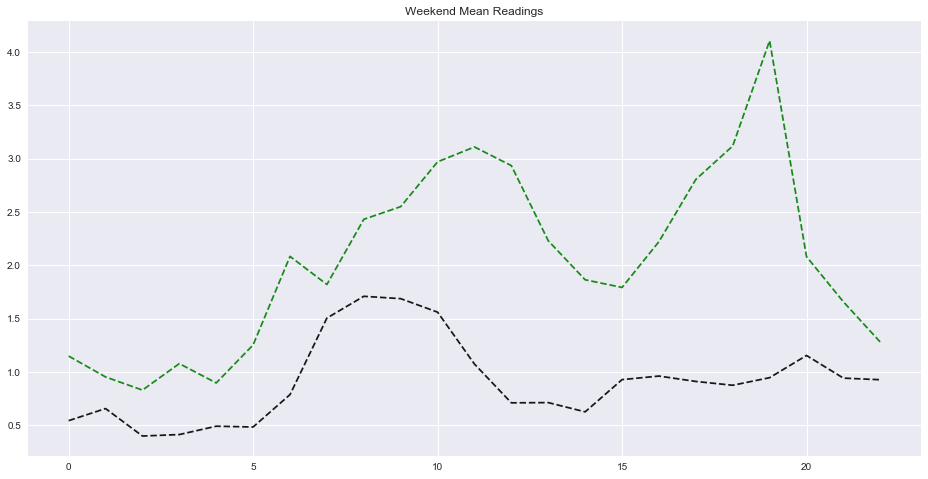

In [111]:
kmeans = KMeans(n_clusters=2)
cluster_found = kmeans.fit_predict(sc_vals_weekend)
cluster_found_sr = pd.Series(cluster_found, name='cluster')
print(cluster_found)
#sort into cluster 1,2,3,4
cluster_1 = []
cluster_2 = []
cluster_3 = []
cluster_4 = []
for i in range(len(vals_temp_experiment_weekend)):
    if cluster_found[i] == 0:
        cluster_1.append(vals_temp_experiment_weekend[i])
    elif cluster_found[i] == 1:
        cluster_2.append(vals_temp_experiment_weekend[i])
    elif cluster_found[i] == 2:
        cluster_3.append(vals_temp_experiment_weekend[i])
    else:
        cluster_4.append(vals_temp_experiment_weekend[i])
    
cluster_1 = np.array(cluster_1)
cluster_2 = np.array(cluster_2)
cluster_3 = np.array(cluster_3)
cluster_4 = np.array(cluster_4)

print(len(cluster_1))
print(len(cluster_2))
print(len(cluster_3))
print(len(cluster_4))
#cluster_3 = np.array(cluster_3)
cluster_1_mean = np.mean(cluster_1, axis=0)
cluster_2_mean = np.mean(cluster_2, axis=0)
cluster_3_mean = np.mean(cluster_3, axis=0)
cluster_4_mean = np.mean(cluster_4, axis=0)

#cluster_3_median = np.median(cluster_3, axis=0)    

color_list = ['blue','red','green', 'black']
plt.figure(figsize=(16,8))
plt.title("Weekend Mean Readings")
plt.style.use('seaborn')

#plt.plot(cluster_3_median, 'g--')
#for i in range(len(vals_temp_experiment)):
#    x = np.arange(1, len(vals_temp_experiment[i])+1)
 #   print(x)
    #plt.plot(x, sc_vals[i], color=color_list[cluster_found[i]], alpha=0.01)
    #plt.plot(x, vals_temp_experiment[i], color=color_list[cluster_found[i]], alpha=0.01)
plt.plot(cluster_1_mean, 'g--', alpha=0.9, label = "Cluster 1 Mean Readings")
plt.plot(cluster_2_mean, 'k--', alpha=0.9, label = "Cluster 2 Mean Readings")
plt.plot(cluster_3_mean, 'r--', alpha=0.9)
plt.plot(cluster_4_mean, 'b--', alpha=0.9)
plt.show()

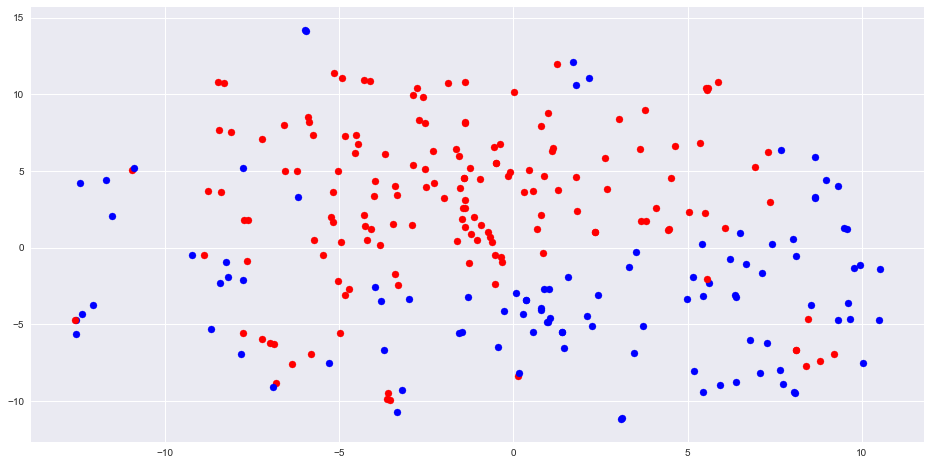

In [112]:
tsne = TSNE()
results_tsne = tsne.fit_transform(sc_vals_weekend)
plt.figure(figsize=(16,8))
for i in range(len(results_tsne)):
    c = color_list[cluster_found[i]]
    plt.scatter(results_tsne[i][0], results_tsne[i][1], color = c)
plt.show()

In [113]:
i = 0
count_C1 = 0
count_C2 = 0
count_NC = 0
for key in all_id:
    temp = []
    corr_top_5 = correlation_matrix[i].argsort()[-5:][::-1]
    for idx in corr_top_5:
        temp.append(all_id[idx])
    print("House Meter", key, " Clustering")
    if set(temp).issubset(cluster_1_id):
        print(key, "and top 5 correlated houses are in cluster 1")
        count_C1 = count_C1 + 1
    elif set(temp).issubset(cluster_2_id):
        print(key, "and top 5 correlated houses are in cluster 2")
        count_C2 = count_C2 + 1
    else:
        print("Key is not clustered with top 5 most correlated")
        count_NC = count_NC + 1
    print("+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++")
    print("\n")
    i = i+1

House Meter 35  Clustering
Key is not clustered with top 5 most correlated
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


House Meter 44  Clustering
44 and top 5 correlated houses are in cluster 2
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


House Meter 77  Clustering
77 and top 5 correlated houses are in cluster 1
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


House Meter 94  Clustering
94 and top 5 correlated houses are in cluster 2
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


House Meter 114  Clustering
114 and top 5 correlated houses are in cluster 2
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


House Meter 187  Clustering
187 and top 5 correlated houses are in cluster 2
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


House Meter 222  Clustering
222 and top 5 correlated houses are in cluster 1
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


House Meter 252  Clustering
252 and

IndexError: index 131 is out of bounds for axis 0 with size 131

In [128]:
print("Number of Houses and Correlated Houses in Cluster 1: ",count_C1)
print("Number of Houses and Correlated Houses in Cluster 2: ",count_C2)
print("Number of Houses and Correlated Houses unclustered: ", count_NC)

Number of Houses and Correlated Houses in Cluster 1:  19
Number of Houses and Correlated Houses in Cluster 2:  76
Number of Houses and Correlated Houses unclustered:  36
